
 ## DeePlexiCon
 ### Analyse and demultiplex Oxford Nanopore RNA barcoded with DNA Adaptors Directly from the Signal
 
 Supplement Jupyter Notebook for the paper "Barcoding and demultiplexing Oxford Nanopore direct RNA sequencing reads using deep learning"
 
Preparation:


In [3]:
# System support
from __future__ import print_function
import os
import platform
from copy import deepcopy
import re
import csv
import time
import configparser
# Math,Numpy and plot
import math
import numpy as np
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
#import PIL
#from PIL import Image
# Time series to 2D
import pyts
# Tensorflow - Keras
import tensorflow as tf
import keras
from keras.layers import Dense, Conv2D, BatchNormalization, Activation
from keras.layers import AveragePooling2D, Input, Flatten
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler
from keras.callbacks import ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import multi_gpu_model
from keras.regularizers import l2
from keras import backend as K
from keras.models import Model
# Datasets, train test split
import pandas as pd
import sklearn
from sklearn import datasets, linear_model
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import pandas as pd

import seaborn as sn

Using TensorFlow backend.


In [4]:
def version_from_system(package):
    pkg_info=!pip show {package}
    return(pkg_info[1][9:])   

print("Python       version :",platform.python_version())
print("pip          version :",version_from_system('pip'))
print("Tensorflow   version :",tf.__version__)
print("Keras        version :",keras.__version__)
print("Numpy        version :",np.__version__)
print("Matplotlib   version :",matplotlib.__version__)
print("Pandas       version :",pd.__version__)
print("PyTs         version :",pyts.__version__)
print("Scikit-learn version :",sklearn.__version__)
#print("PIL          version :",PIL.__version__)
print("Seaborn      version :",sn.__version__)
print("PYCM         version :",version_from_system('pycm'))

Python       version : 3.7.3
pip          version : 19.1.1
Tensorflow   version : 1.14.0
Keras        version : 2.2.4
Numpy        version : 1.16.4
Matplotlib   version : 3.1.0
Pandas       version : 0.25.0
PyTs         version : 0.8.0
Scikit-learn version : 0.21.2
Seaborn      version : 0.9.0
PYCM         version : 2.4


In [5]:
# Parameters

input_cut=70000
input_data_paths=['/data/nanopore/James/Barcodes/final-07-19/tsv']
input_segment_paths=['/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split','/data/nanopore/James/Barcodes/final-07-19/seg/rep2-split']
squiggle_max=199.0
squiggle_min=10
print_details_for=20
max_sample=45000
read_max=65000
smooth_by=1
num_classes=4
label_index=1


In [4]:
"""
from skpy import Skype
config = configparser.ConfigParser()
config.read('skype.cfg')

skype_info=config['skype']

def connect_skype(user, pwd, token):
    s = Skype(connect=False)
    s.conn.setTokenFile(token)
    try:
        s.conn.readToken()
    except SkypeAuthException:
        s.conn.setUserPwd(user, pwd)
        s.conn.getSkypeToken()
        s.conn.writeToken()
    finally:
        sk = Skype(user, pwd, tokenFile=token)
    return sk

sk = connect_skype(skype_info['account_id'], skype_info['access_token'],'skypetoken.txt') # connect to Skype

def send_message_to(contact,message):
    ch = sk.contacts.contact[contact].chat 
    ch.sendMsg(message) 
    
def let_tansel_know(message):
    send_message_to(skype_info['tansel'],message)
"""

def let_tansel_know(message):
    print(message)

In [5]:
let_tansel_know('hello')

hello


In [87]:
10# Python timeseries interface
from pyts.image import MarkovTransitionField, GramianAngularField, RecurrencePlot
font = {'family': 'serif',
        'color':  'black',
        'weight': 'normal',
        'size': 6,
        }
# Python timeseries interface
times={'GramianAngularField-difference':[],'GramianAngularField-summation':[],'RecurrencePlot':[],'MarkovTransitionField':[] }
def pyts_transform(name,transform,data,image_size,show=False,cmap='rainbow',img_index=0):
    tcn=transform.__class__.__name__
    if hasattr(transform, 'method'):
        tcn=tcn+'-'+transform.method
        print(transform.method)
    try:
        t_start=time.time()
        X_transform = transform.fit_transform(data)
        delta=time.time()-t_start
        times[tcn].append(delta)
        print(delta, ' seconds') 
        if (show):
            plt.figure(figsize=(4, 4))
            plt.grid(b=None)
            plt.title(name,fontdict=font)
            plt.imshow(X_transform[0], cmap=cmap, origin='lower')
            plt.savefig(name+'-'+tcn+"_image_"+ str(img_index)+".svg", format="svg")
            plt.show()
        return(X_transform)
    except Exception as e:
        print('Error:', str(e))
        return([])
        
def mtf_transform(name,data,image_size = 500,show=False,img_index=0):
    transform = MarkovTransitionField(image_size)    
    return(name,pyts_transform(name,transform,data,image_size = image_size,show=show,cmap='rainbow',img_index=img_index))
    
def rp_transform(name,data,image_size = 500,show=False,img_index=0):
    # RP transformation
    transform = RecurrencePlot(dimension=1, 
                    threshold='percentage_points',
                    percentage=30)
    return(pyts_transform(name,transform,data,image_size = image_size,show=show,cmap='binary',img_index=img_index))
    
def gasf_transform(name,data,image_size = 500,show=False,img_index=0):
    # GAF transformation
    transform = GramianAngularField(image_size, method='summation')
    return(pyts_transform(name,transform,data,image_size = image_size,show=show,cmap='rainbow',img_index=img_index))

def gadf_transform(name,data,image_size = 500,show=False,img_index=0):
    # GAF transformation
    transform = GramianAngularField(image_size, method='difference')
    return(name,pyts_transform(name,transform,data,image_size = image_size,show=show,cmap='rainbow',img_index=img_index))
     


In [88]:
def all_files_in_path(input_path,prefix, extension):
    return([f for f in os.listdir(input_path) if f.startswith(prefix) & f.endswith(extension)])

def full_paths_for_files_in_path(input_path,prefix, extension):
    return([input_path+'/'+f for f in os.listdir(input_path) if f.startswith(prefix) & f.endswith(extension)])

def labels_for(file_name):
    segments=re.split(r'[_\-\.]+', file_name)
    return(segments)

def label_for(file_name):
    return('BC'+labels_for(file_name)[label_index][-1])

def max_in_sequence(sequence):   
    return(max(np.amax([list(d.values()) for d in sequence]),0.01))

In [89]:
for file_name in all_files_in_path(input_segment_paths[0],'', '.tsv'):
    print(file_name,label_for(file_name))

rep1-SH4_segments.tsv BC4
rep1-SH3_segments.tsv BC3
rep1-SH2_segments.tsv BC2
rep1-SH1_segments.tsv BC1


In [90]:
def read_segment_files(paths,postfix,usecols=[0,1,2,3],index_column=1, names=['source','read_id', 'segment_start','segment_end']):
    all_segment_files=[]
    for path in paths:
        all_segment_files=all_segment_files+full_paths_for_files_in_path(path,'',postfix)
    print("Reading segment files:", all_segment_files)
    segments=[]
    for f in all_segment_files:
        segment_label=label_for(os.path.basename(f)) # Assuming Linux, may fail with Windows
        segment=pd.read_table(f, usecols=usecols, names=names, index_col=index_column, header=None, sep=' ')
        segment['label']=segment_label
        segments.append(segment)
    segments=pd.concat(segments)
    print(len(segments))
    segments = segments[~segments.index.duplicated(keep='first')]
    print(len(segments))
    return(segments)

In [91]:
print(full_paths_for_files_in_path(input_segment_paths[0],'', '.tsv'))

['/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH4_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH3_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH2_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH1_segments.tsv']


In [92]:
segments=read_segment_files(input_segment_paths, '.tsv')
segments

Reading segment files: ['/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH4_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH3_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH2_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep1-split/rep1-SH1_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep2-split/rep2-SH2_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep2-split/rep2-SH1_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep2-split/rep2-SH3_segments.tsv', '/data/nanopore/James/Barcodes/final-07-19/seg/rep2-split/rep2-SH4_segments.tsv']
457452
457452


,source,segment_start,segment_end,label
read_id,,,,
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_6786_ch_180_strand.fast5,0003f155-77f8-4a2e-8331-ebcaf3bc94f5,5047,11068,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_6570_ch_417_strand.fast5,0007d4a0-86f1-41d5-ba80-07695c4e81e9,4147,9538,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_14002_ch_72_strand.fast5,000a8689-5b00-4689-8129-6f4392907945,3900,8403,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_20590_ch_388_strand.fast5,000c1e97-3927-4a6d-ac3c-cbb651f66380,5416,9917,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_28283_ch_410_strand.fast5,000d8999-23e5-4e04-9415-0034f97aaccc,5667,14121,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_7697_ch_499_strand.fast5,001a0440-2ccb-42f9-bac0-0c5edfba74a6,2795,5807,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_3781_ch_455_strand.fast5,001c74e4-27fe-4abf-a6a9-b0b7c1b63465,3081,9825,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_9296_ch_175_strand.fast5,001d7b98-ecba-417b-a23e-0bd86bc9bc32,3486,9225,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_6454_ch_383_strand.fast5,001e69f2-7f0e-4f81-a90a-46fef2d9f9ab,7619,16654,BC4


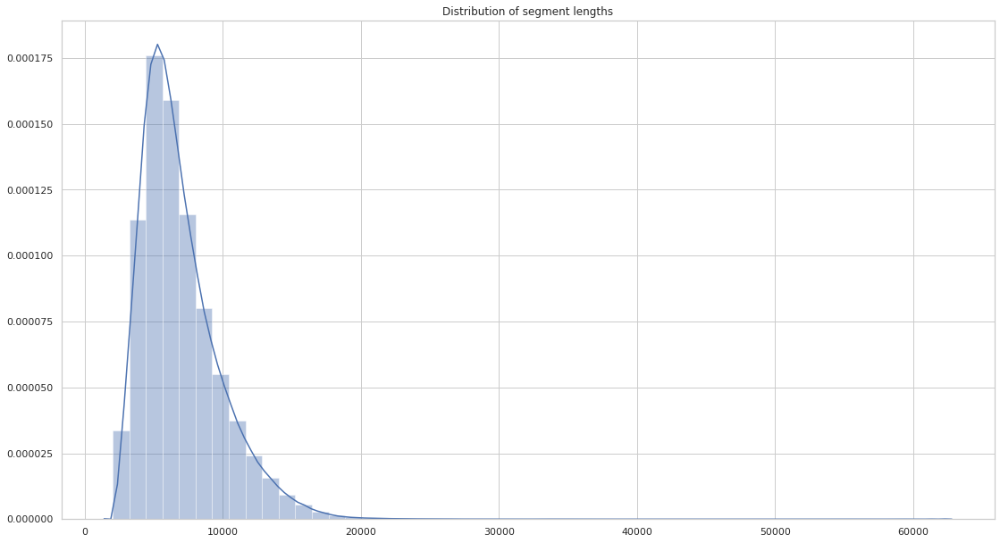

In [93]:
from matplotlib.ticker import FuncFormatter

seg_lengths=segments['segment_end']-segments['segment_start']+1
#seg_lengths=seg_lengths[seg_lengths<20000]
#print(seg_lengths[0:20])

plt.figure("Distribution of segment lengths")
plt.title("Distribution of segment lengths")
sn.set(rc={'figure.figsize':(18.7,10.27)})
sn.set_style("whitegrid")
sn.distplot(seg_lengths)#, bins=100, kde=False, color="blue", label="S1")
#plt.legend()
plt.savefig("seglengthdist1.svg", format="svg")
plt.show()
seg_lengths=None


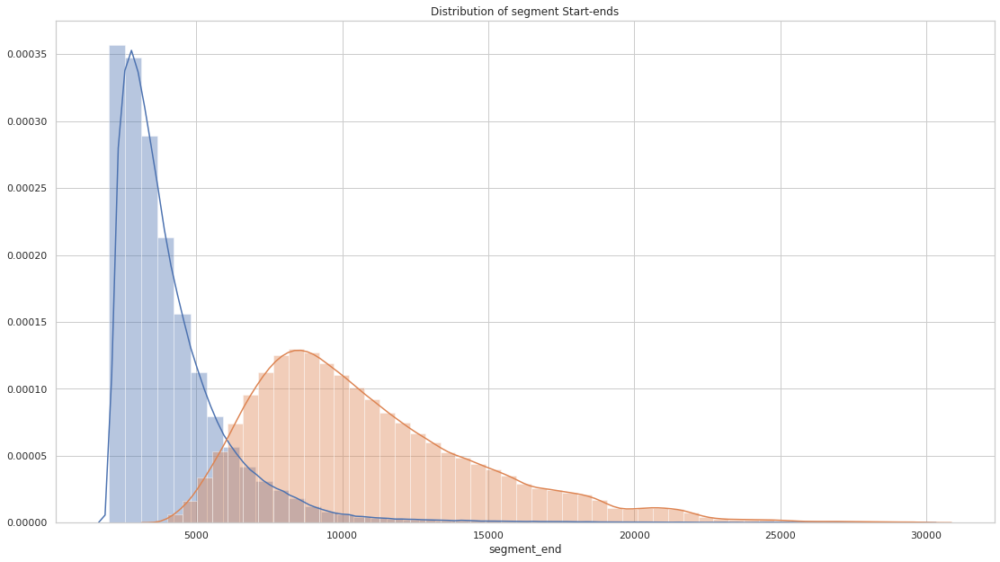

In [94]:

plt.figure("Distribution of segment Start-ends")
plt.title("Distribution of segment Start-ends")
sn.set(rc={'figure.figsize':(18.7,10.27)})
sn.set_style("whitegrid")
sn.distplot(segments['segment_start'][segments['segment_start']<30000])#, bins=100, kde=False, color="blue", label="S1")
sn.distplot(segments['segment_end'][segments['segment_end']<30000])#, bins=100, kde=False, color="blue", label="S1")
#plt.legend()
plt.savefig("segst-end-dist1.svg", format="svg")
plt.show()



In [95]:
segments.loc['MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_10454_ch_182_strand.fast5']

source           425a2d71-c621-4e22-98b8-bbb2ec5db2b4
segment_start                                    7497
segment_end                                     11931
label                                             BC4
Name: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_10454_ch_182_strand.fast5, dtype: object

In [96]:
segments.describe()

,segment_start,segment_end
count,457452.000000,457452.000000
mean,4086.703683,10979.909051
std,2437.102147,4219.442002
min,1999.000000,3999.000000
25%,2701.000000,8016.000000
50%,3469.000000,10047.000000
75%,4708.000000,13054.000000
max,85177.000000,98760.000000


In [97]:
far_ends= segments[segments['segment_end']>30000]

In [98]:
long_segments= segments[(segments['segment_end']-segments['segment_start'])>30000]

In [99]:
far_ends

,source,segment_start,segment_end,label
read_id,,,,
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_61995_ch_24_strand.fast5,00898253-ff64-494c-bd61-ea37bfcb0ac9,22662,31324,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_46268_ch_329_strand.fast5,01026a03-b0c2-4f8f-b3bf-258c068554e0,18634,30315,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_26314_ch_217_strand.fast5,01292a0d-811e-43da-b784-c98b09ff4647,37966,44859,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_6170_ch_504_strand.fast5,0160dfc1-72e3-40ac-a675-e47ea46f5b2d,12051,32806,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_7735_ch_179_strand.fast5,023b06ea-a450-4deb-8283-1e6e59c10aa2,8829,32269,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_13072_ch_499_strand.fast5,02b12220-7d32-4af8-abf1-c6fb2a8c2094,3653,38304,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_40411_ch_85_strand.fast5,03dd490a-cba7-4564-b299-d25e4ab5f422,26096,38985,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_3642_ch_409_strand.fast5,04b7088e-582c-422c-9b1a-56119d4cf0d5,7496,30817,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_44090_ch_119_strand.fast5,05cbda84-a9c9-4bfd-9bd5-cd42da864ef3,9059,32528,BC4


In [100]:
long_segments

,source,segment_start,segment_end,label
read_id,,,,
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_13072_ch_499_strand.fast5,02b12220-7d32-4af8-abf1-c6fb2a8c2094,3653,38304,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_53672_ch_476_strand.fast5,0c12a9d0-f1f7-4e5a-92f8-10e58a6170ac,19253,72979,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_59189_ch_73_strand.fast5,2671688b-80e8-40b9-b177-db89a6c8ddf7,23636,64488,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_8222_ch_110_strand.fast5,28c65d59-9607-4cb2-9e78-27e3bb944522,9417,58203,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_27865_ch_157_strand.fast5,31d990b6-6ad7-4bf6-9bf3-9305cb7bd948,12734,46592,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_11212_ch_448_strand.fast5,3a232e6d-6285-4cf3-8db6-0fdef9fce85a,10536,41162,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_13216_ch_502_strand.fast5,53744f19-6f0f-4487-8eb6-5d544db90c3d,24396,75017,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_258423_ch_15_strand.fast5,565317be-cccd-4031-9d5d-2662a4481246,10625,42105,BC4
gru_20171207_FAH30963_MN20855_sequencing_run_RNA_Unlabeled_Barcoded_80746_read_18437_ch_290_strand.fast5,58af0e76-39b9-42bb-82b6-a18f0ec7025c,7443,38676,BC4


In [101]:
fe_csv = far_ends.to_csv (r'far_ends.csv',  header=True)
ls_csv = long_segments.to_csv (r'long_segments.csv',  header=True)

In [102]:
offset=-1050
buffer=150
def segment_by_read_name(read_name):
    try:
        seg=segments.loc[read_name]
        return(seg['segment_start']+offset-buffer,seg['segment_end']+offset+buffer,seg['label'])
    except:
        return(None,None, None)

In [103]:
segment_by_read_name('MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_10015_ch_376_strand.fast5')

(4010, 19479, 'BC4')

In [104]:
files_to_process=[]
for path in input_data_paths:
    files_to_process=files_to_process+all_files_in_path(path,'','.tsv')

print (len(files_to_process))
for f in files_to_process:
    print(labels_for(f))

14
['rep2', 'squiggles', '13', 'tsv']
['rep2', 'squiggles', '09', 'tsv']
['rep2', 'squiggles', '11', 'tsv']
['rep1', 'squiggles', 'tsv']
['rep2', 'squiggles', '10', 'tsv']
['rep2', 'squiggles', '05', 'tsv']
['rep2', 'squiggles', '01', 'tsv']
['rep2', 'squiggles', '07', 'tsv']
['rep2', 'squiggles', '03', 'tsv']
['rep2', 'squiggles', '06', 'tsv']
['rep2', 'squiggles', '02', 'tsv']
['rep2', 'squiggles', '12', 'tsv']
['rep2', 'squiggles', '04', 'tsv']
['rep2', 'squiggles', '08', 'tsv']


In [105]:
#%matplotlib inline
#import mpld3
#mpld3.enable_notebook()
image_size=224
samples={'BC1':0,'BC2':0,'BC3':0,'BC4':0}
selected_cut='James'
def compress_squiggle(squiggle,compress_factor):
    squiggle_len=len(squiggle)
    rem=squiggle_len%compress_factor
    if rem>0:
        return(np.mean(squiggle[0:squiggle_len-rem].reshape(-1,compress_factor), axis=1))
    return(squiggle)
    
def show_graph(squiggle_label,squiggle, trimmed_squiggle,segments=[], img_index=0):
    squiggle_for_plot=pd.DataFrame(np.trim_zeros(squiggle))
    plt.figure(figsize=(15,2))
    plt.grid(True)
    for seg in segments:
        plt.axvline(x=seg[0]/smooth_by, color=seg[2])
        plt.axvline(x=seg[1]/smooth_by, color=seg[2])
#    plt.plot(squiggle_for_plot.mask(squiggle_for_plot.apply(lambda x: x.index < segment_start))[0], color='red')
#    plt.plot(squiggle_for_plot.mask(squiggle_for_plot.apply(lambda x: x.index > segment_end))[0], color='green')
    plt.plot(squiggle_for_plot, linewidth=0.1, color='black')
    plt.title(squiggle_label)
    plt.savefig(squiggle_label+"-squiggle"+ str(img_index)+".svg", format="svg")
    plt.show()
    plt.figure(figsize=(15,2))
    plt.plot(trimmed_squiggle, linewidth=0.2, color='black')
    plt.title(squiggle_label)
    plt.grid(True)
    plt.savefig(squiggle_label+"-seg-squiggle-"+str(img_index)+".svg", format="svg")
    plt.show()
    
def process_file(data_path,file_to_process,  pos_from, pos_to):
    print('Processing file:', file_to_process)
    squiggles=[]
    squiggle_labels=[]
    start_from=5
    start=time.time()
    printed_details=0
    image_index=0
    labels=[]
    result=[]
    lines_read=0
    with open(data_path+'/'+file_to_process) as tsv:
        for line in csv.reader(tsv, dialect="excel-tab"):
#            try:
                squiggle_label=line[0]
                segment_start,segment_end, label=segment_by_read_name(squiggle_label)
                segments=[[segment_start, segment_end, 'r']]
                if segment_start is not None:
                    squiggle=np.array(line[start_from:], dtype=np.float32)
                    if len(squiggle)>=image_size:
                        lines_read=lines_read+1
                        #take average of every n points to compress by n
                        if (smooth_by > 1) and (len(squiggle)> smooth_by * image_size):
                            squiggle=compress_squiggle(squiggle,smooth_by) 
                            segment_start=int(segment_start/smooth_by)
                            segment_end=int(segment_end/smooth_by)
                        trimmed_squiggle=squiggle[segment_start:segment_end+1]
                        squiggle=squiggle[squiggle <= squiggle_max]
                        squiggle=squiggle[squiggle > squiggle_min]
                        trimmed_squiggle=trimmed_squiggle[trimmed_squiggle <= squiggle_max]
                        trimmed_squiggle=trimmed_squiggle[trimmed_squiggle > squiggle_min]
                        trimmed_squiggle=np.trim_zeros(trimmed_squiggle)
                        display_graph=printed_details<print_details_for
                        name=label+'-'+squiggle_label
                        if (display_graph):
                            print("Reading:", squiggle_label)
                            show_graph(name,squiggle,trimmed_squiggle,segments=segments,img_index=image_index)
                            image_index=image_index+1
                            printed_details=printed_details+1
                        transformed_squiggle=mtf_transform(name,trimmed_squiggle.reshape(1,-1),image_size=image_size, show=display_graph,img_index=image_index)
                        transformed_squiggle=rp_transform(name,trimmed_squiggle.reshape(1,-1),image_size=image_size, show=display_graph,img_index=image_index)
                        transformed_squiggle=gadf_transform(name,trimmed_squiggle.reshape(1,-1),image_size=image_size, show=display_graph,img_index=image_index)
                        transformed_squiggle=gasf_transform(name,trimmed_squiggle.reshape(1,-1),image_size=image_size, show=display_graph,img_index=image_index)
                        if (display_graph):
                            image_index=image_index+1
                        if len(transformed_squiggle)>0:
                            if samples[label]<max_sample:
                                transformed_squiggle=transformed_squiggle[None,...]
                                result.append([label,squiggle_label, transformed_squiggle])
                                samples[label]=samples[label]+1
#                            labels.append(label)
#                            squiggle_labels.append(squiggle_label)
#                            squiggles.append(transformed_squiggle)

                        else:
                            print("Transformation fails:", squiggle_label,len(transformed_squiggle))
                    else:
                        print("Short:", squiggle_label,len(squiggle))
                else:
                    print("No segment info for:", squiggle_label)
                if (lines_read>=read_max) or (len(result)>=max_sample):
                    break
#            except Exception as e:
#               print('Error:', str(e),segment_start)
    print( "Number of Squiggles=", len(result))
    print(time.time()-start, ' seconds') 
    return(result)#[labels, squiggle_labels,squiggles])


/data/nanopore/James/Barcodes/final-07-19/tsv
File name= /data/nanopore/James/Barcodes/final-07-19/tsv/rep2-squiggles-13.tsv
Processing file: rep2-squiggles-13.tsv
Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31372_ch_488_strand.fast5


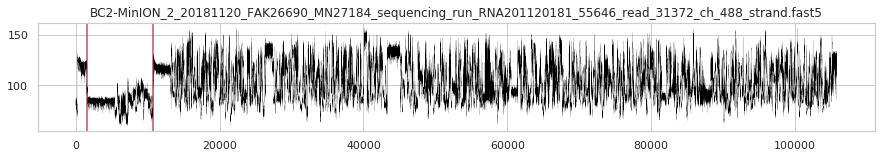

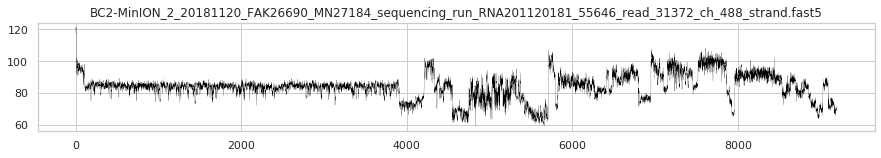

1.5132842063903809  seconds


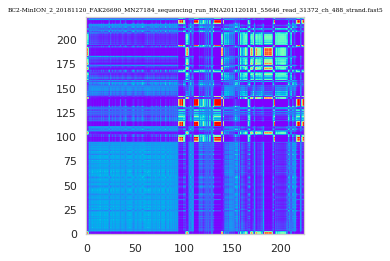

2.018423080444336  seconds


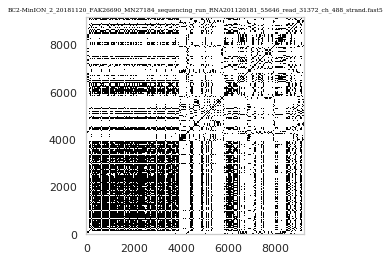

difference
0.0023140907287597656  seconds


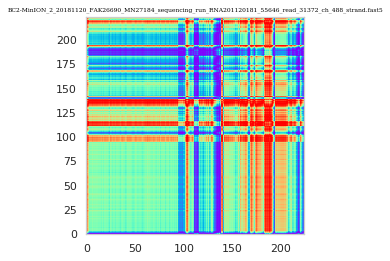

summation
0.0033311843872070312  seconds


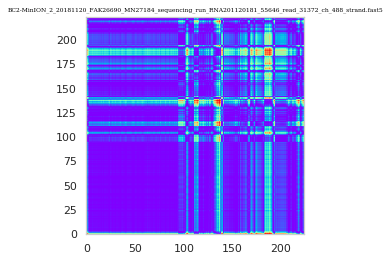

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31373_ch_44_strand.fast5


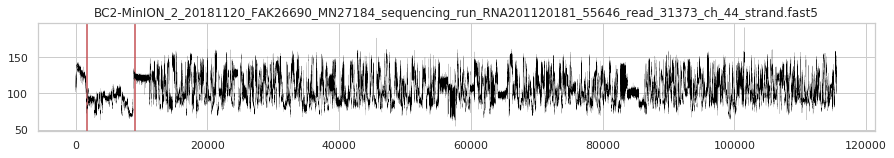

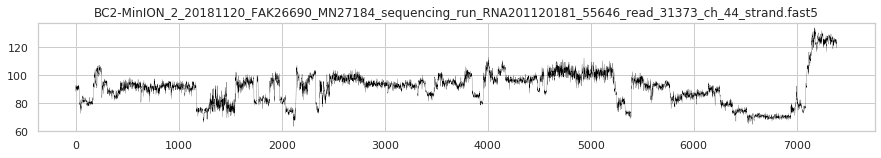

0.7316820621490479  seconds


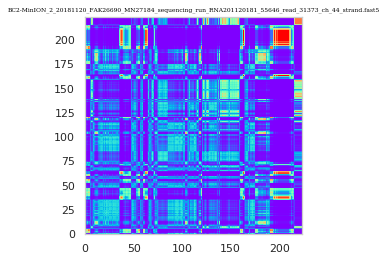

1.2343382835388184  seconds


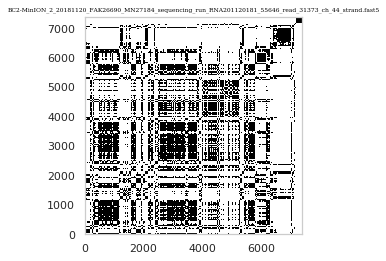

difference
0.004435539245605469  seconds


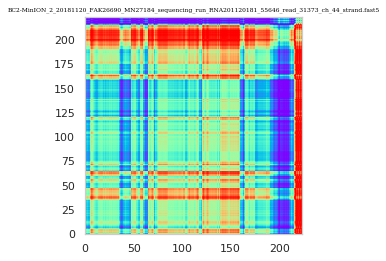

summation
0.0019371509552001953  seconds


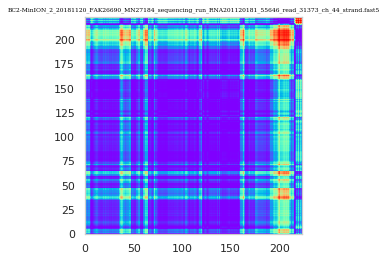

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31376_ch_406_strand.fast5


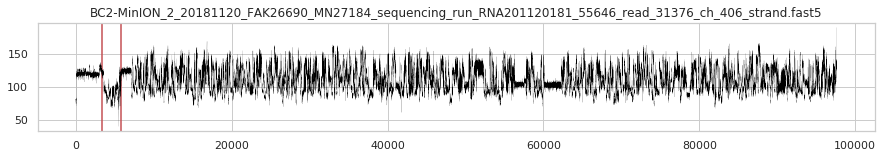

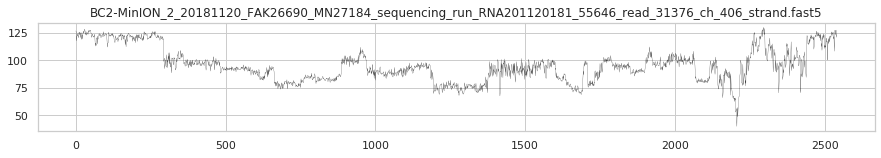

0.07437658309936523  seconds


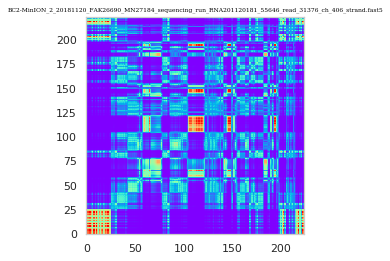

0.16880130767822266  seconds


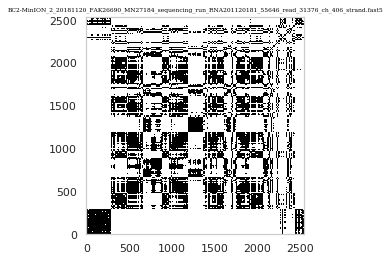

difference
0.0015778541564941406  seconds


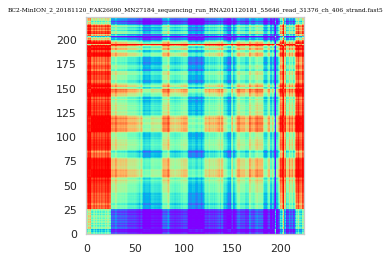

summation
0.0017693042755126953  seconds


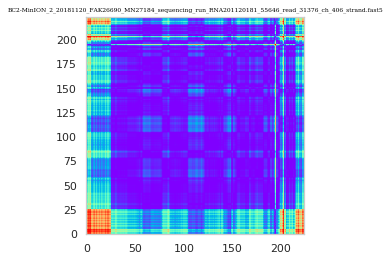

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31376_ch_481_strand.fast5


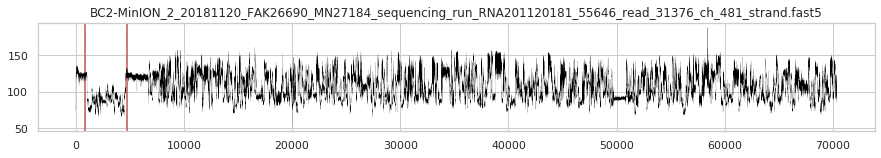

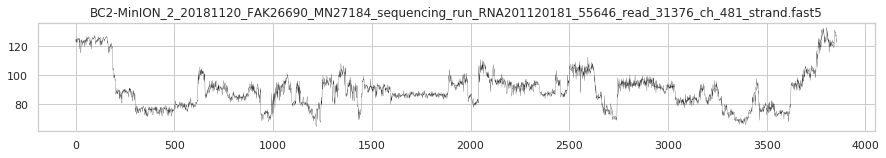

0.1673886775970459  seconds


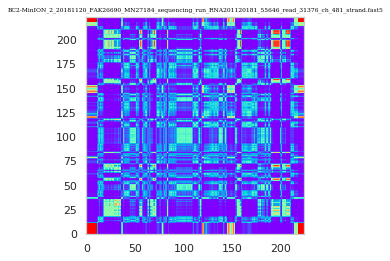

0.36867475509643555  seconds


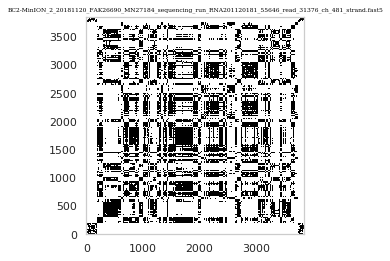

difference
0.004937171936035156  seconds


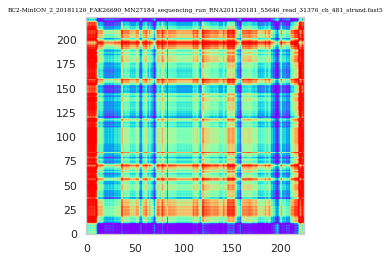

summation
0.0015556812286376953  seconds


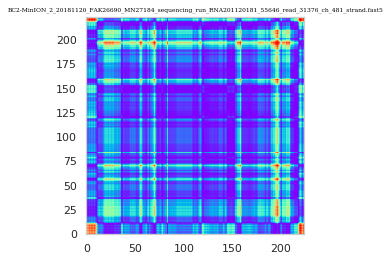

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31380_ch_377_strand.fast5


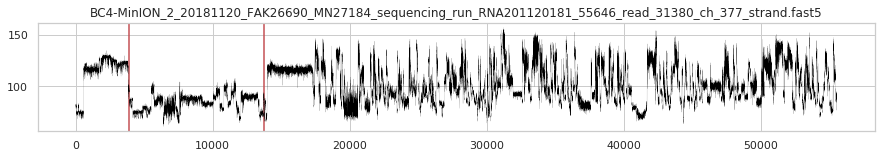

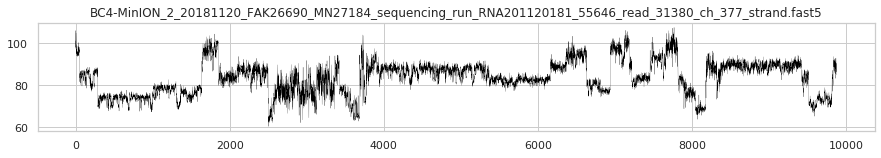

1.184269666671753  seconds


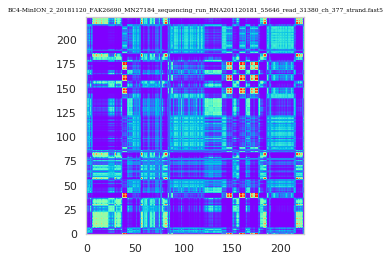

1.9563004970550537  seconds


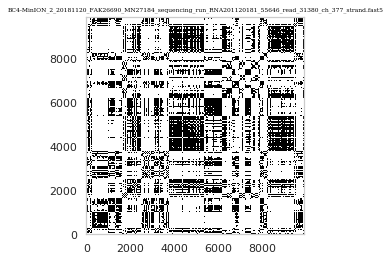

difference
0.004643440246582031  seconds


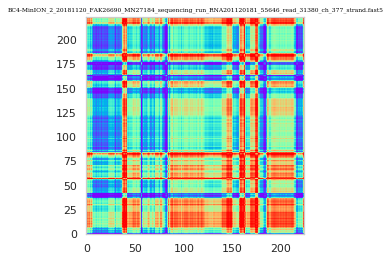

summation
0.008642196655273438  seconds


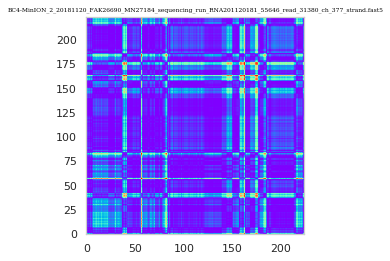

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31381_ch_350_strand.fast5


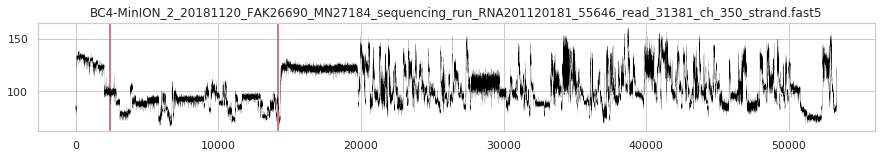

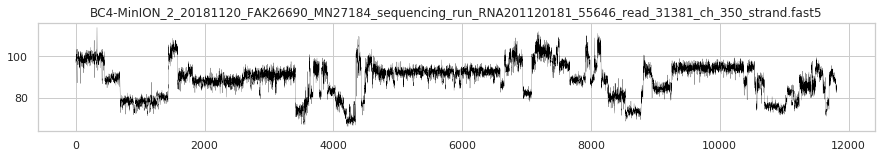

1.617048978805542  seconds


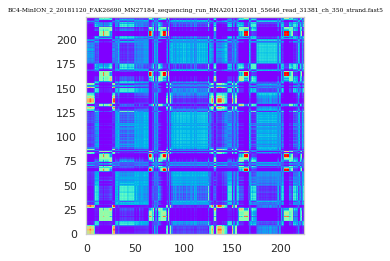

2.959846019744873  seconds


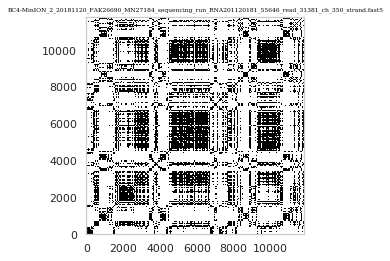

difference
0.004934072494506836  seconds


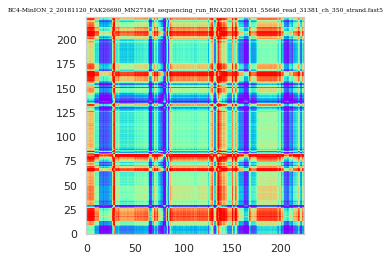

summation
0.008826017379760742  seconds


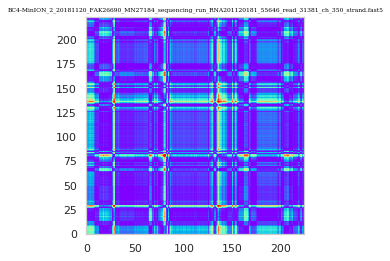

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31382_ch_248_strand.fast5


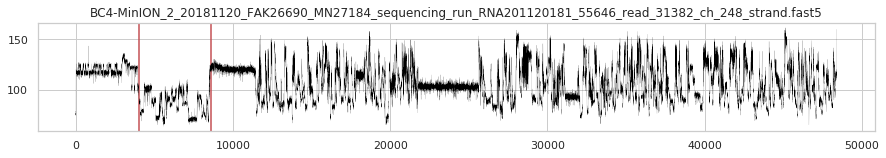

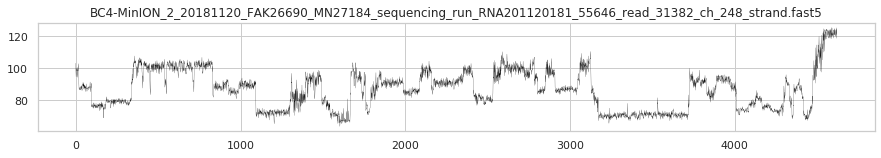

0.20666885375976562  seconds


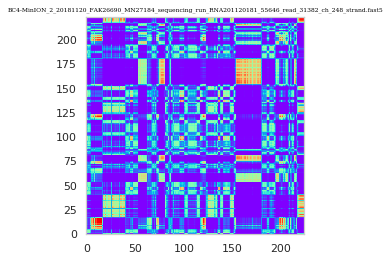

0.48328709602355957  seconds


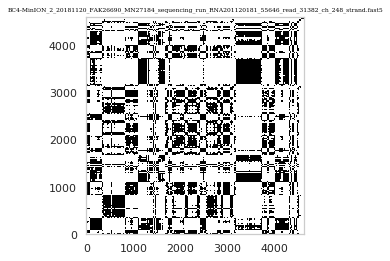

difference
0.0016586780548095703  seconds


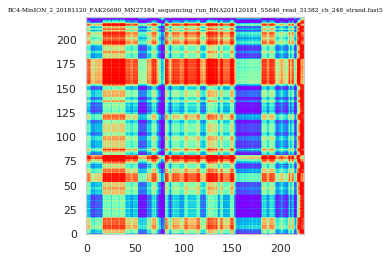

summation
0.008111000061035156  seconds


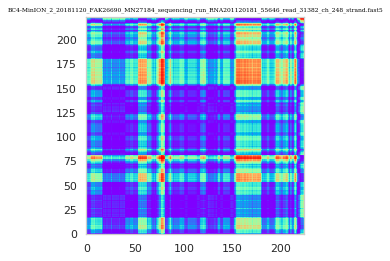

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31382_ch_377_strand.fast5


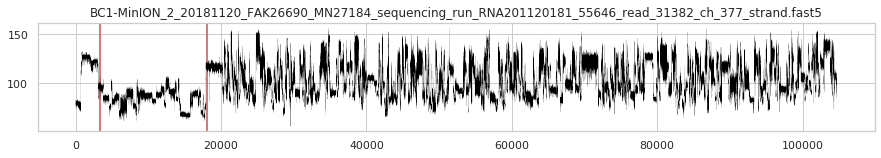

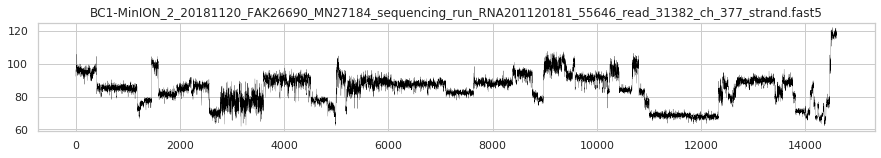

2.5447452068328857  seconds


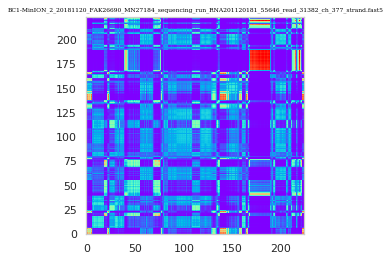

4.636142253875732  seconds


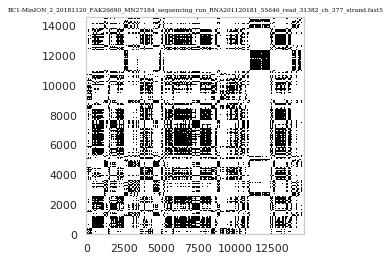

difference
0.004633188247680664  seconds


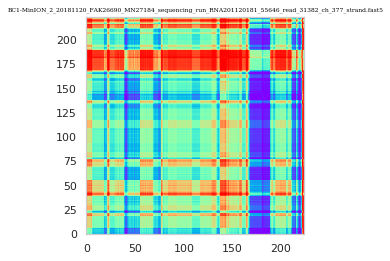

summation
0.008026838302612305  seconds


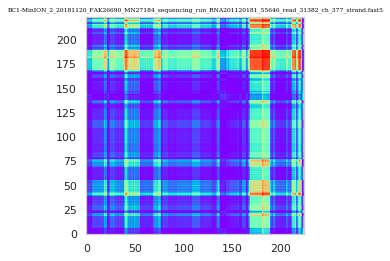

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31383_ch_350_strand.fast5


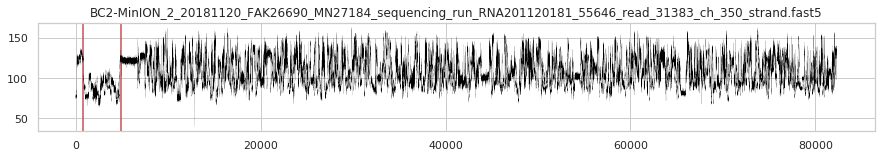

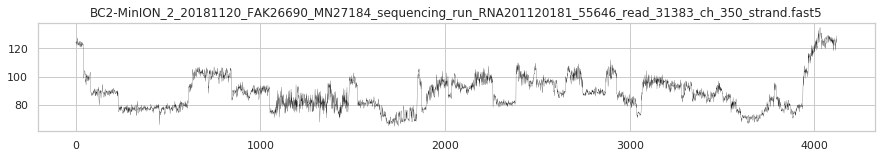

0.16924118995666504  seconds


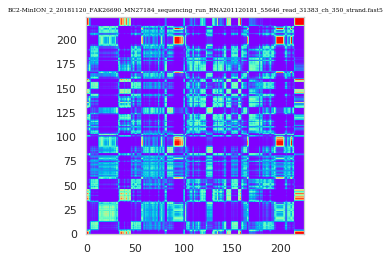

0.3700883388519287  seconds


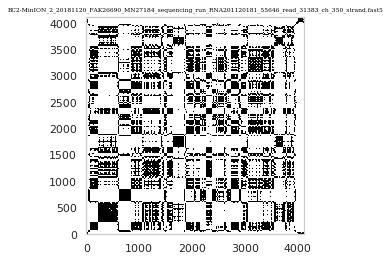

difference
0.001817941665649414  seconds


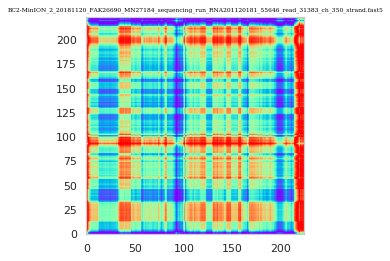

summation
0.0060236454010009766  seconds


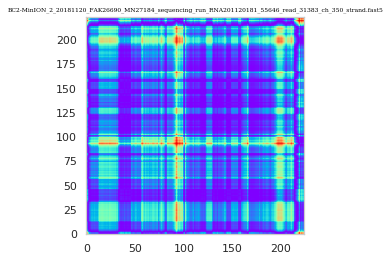

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31383_ch_483_strand.fast5


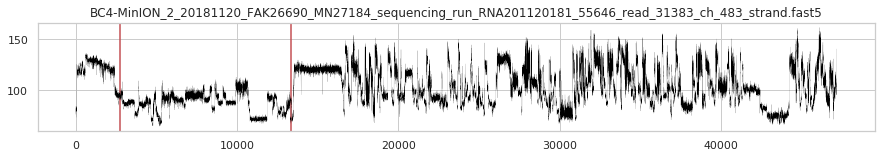

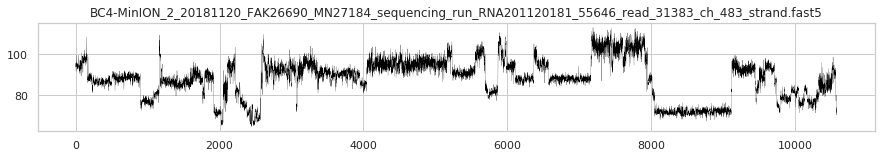

1.432755470275879  seconds


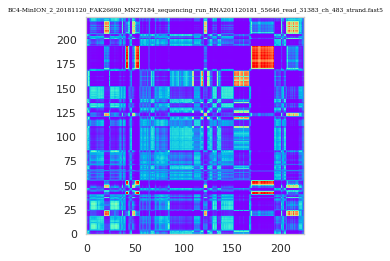

2.5533151626586914  seconds


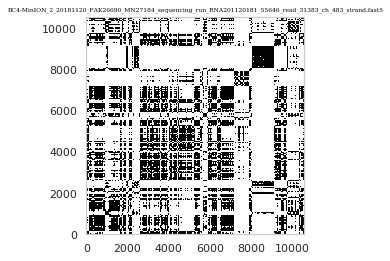

difference
0.004845380783081055  seconds


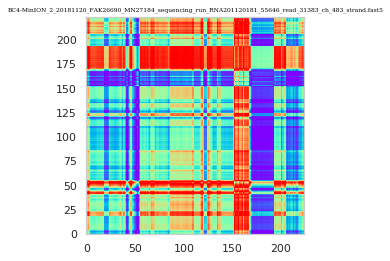

summation
0.007826089859008789  seconds


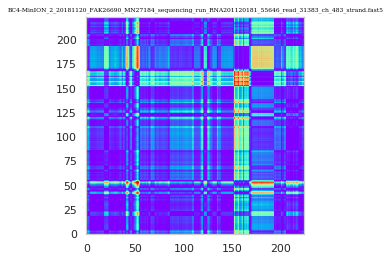

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31384_ch_377_strand.fast5


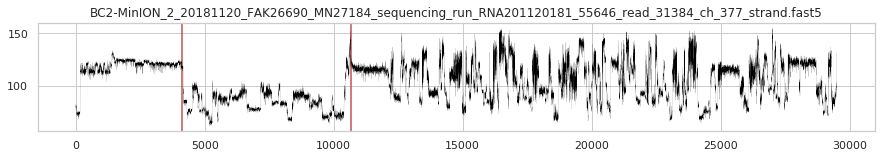

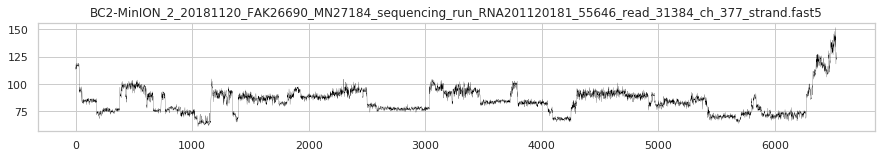

0.45336222648620605  seconds


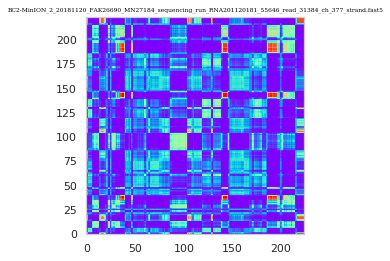

0.9005553722381592  seconds


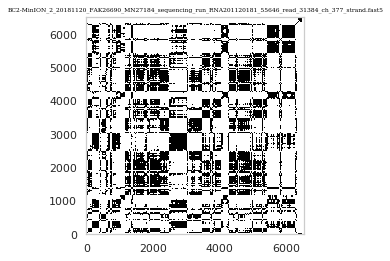

difference
0.005005836486816406  seconds


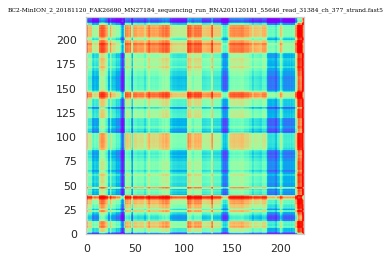

summation
0.008033037185668945  seconds


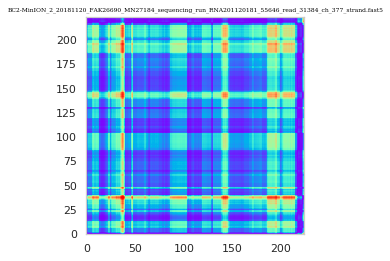

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31388_ch_156_strand.fast5


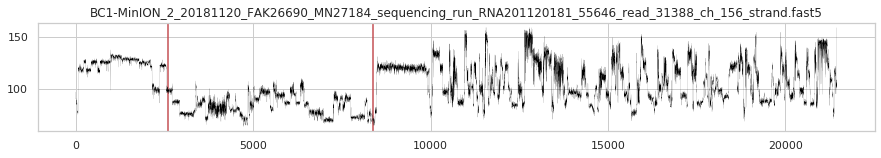

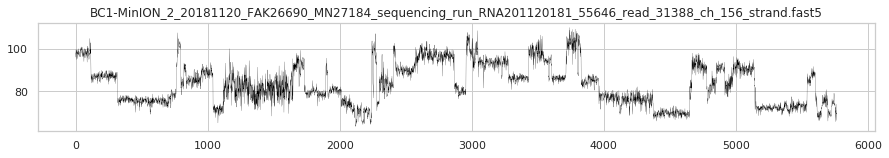

0.3288431167602539  seconds


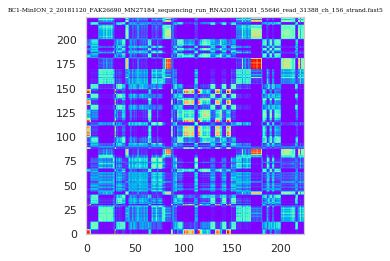

0.7673072814941406  seconds


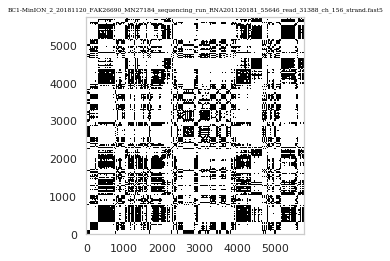

difference
0.0017578601837158203  seconds


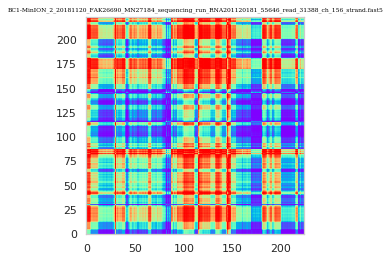

summation
0.008258819580078125  seconds


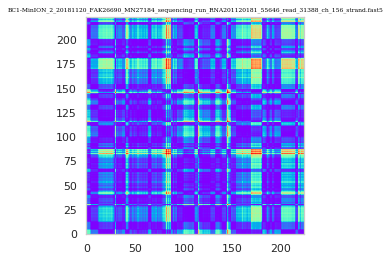

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31393_ch_280_strand.fast5


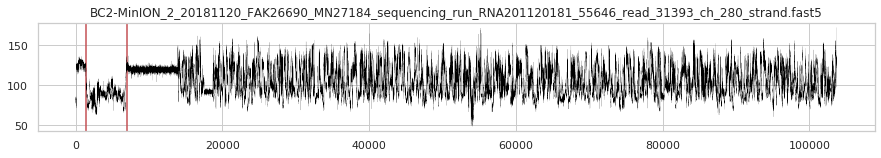

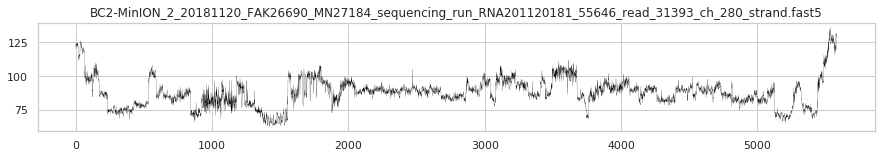

0.35209107398986816  seconds


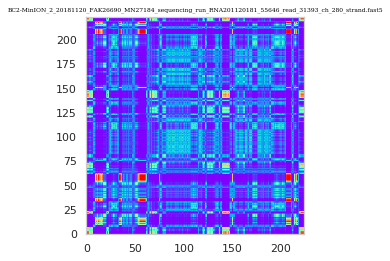

0.7434437274932861  seconds


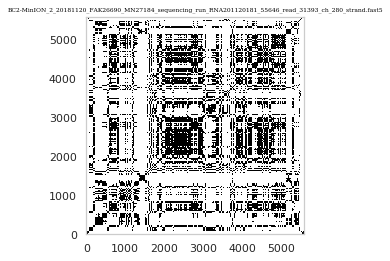

difference
0.004192829132080078  seconds


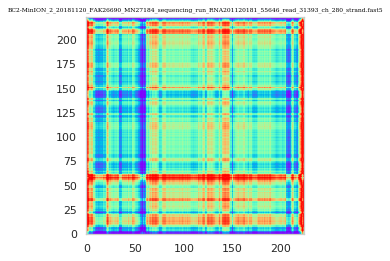

summation
0.009658336639404297  seconds


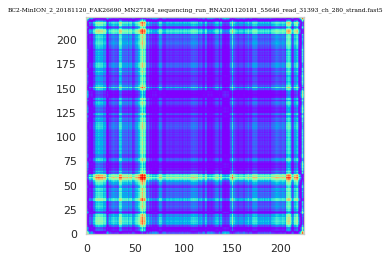

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31395_ch_174_strand.fast5


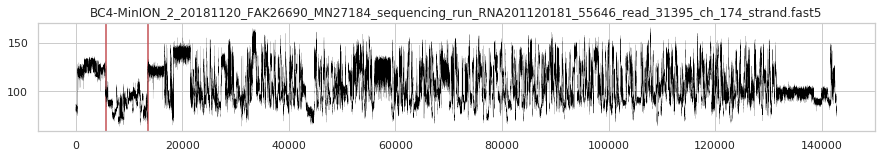

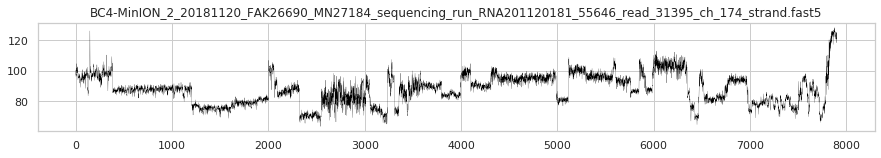

0.833665132522583  seconds


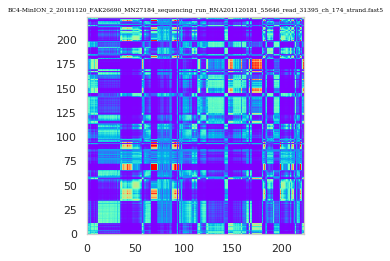

1.5650081634521484  seconds


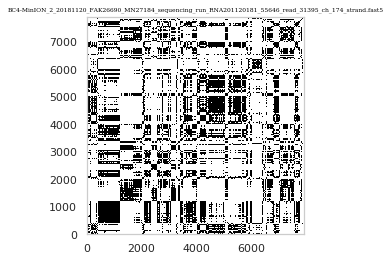

difference
0.0053558349609375  seconds


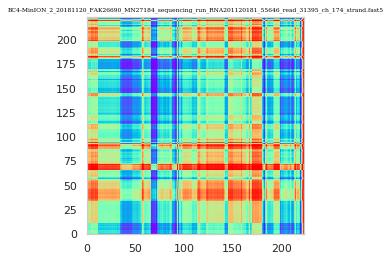

summation
0.008176326751708984  seconds


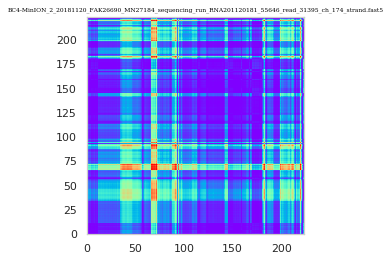

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31395_ch_48_strand.fast5


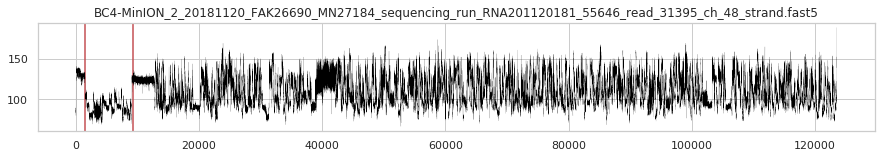

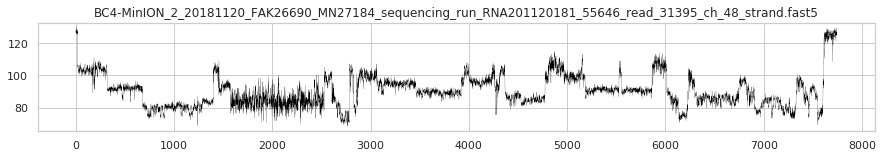

0.7784442901611328  seconds


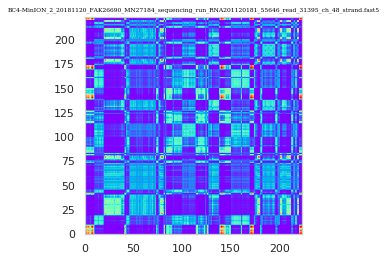

1.3782768249511719  seconds


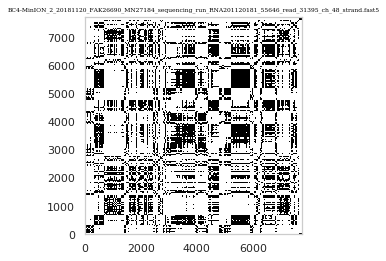

difference
0.004815101623535156  seconds


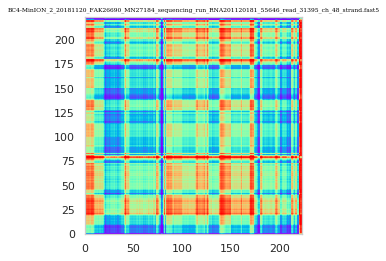

summation
0.001445770263671875  seconds


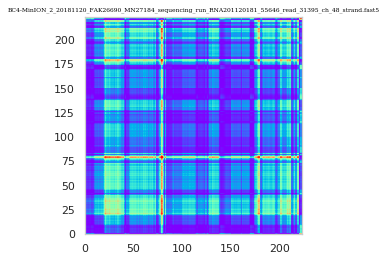

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31397_ch_253_strand.fast5


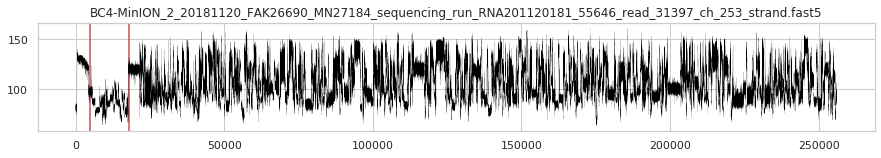

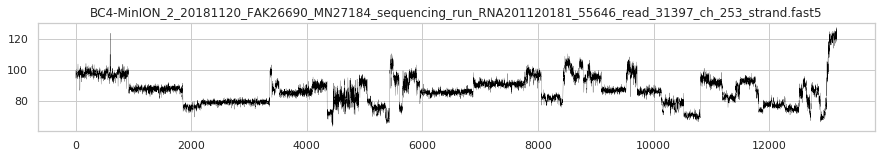

2.2124879360198975  seconds


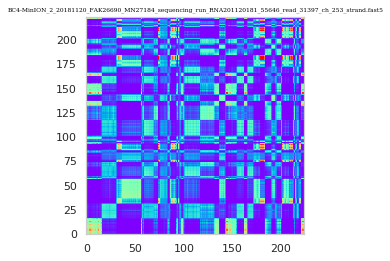

3.6390018463134766  seconds


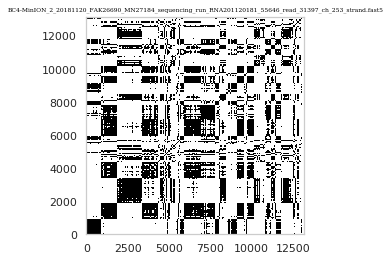

difference
0.004866600036621094  seconds


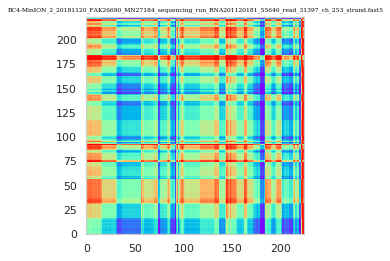

summation
0.008307218551635742  seconds


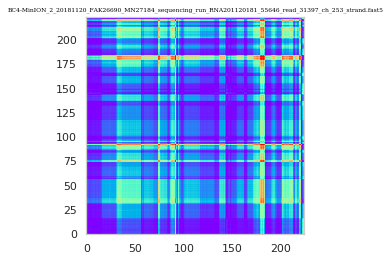

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31398_ch_174_strand.fast5


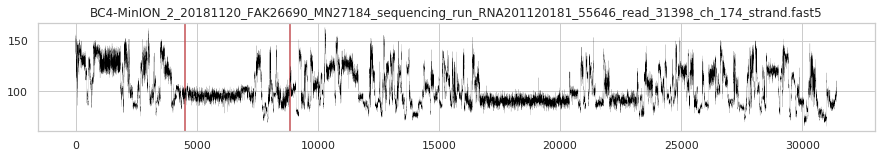

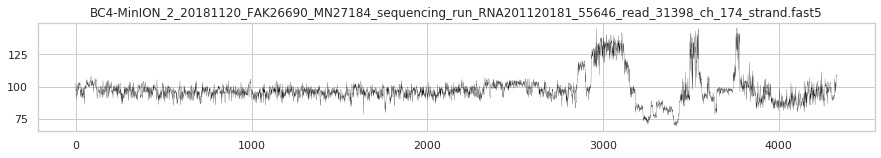

0.196547269821167  seconds


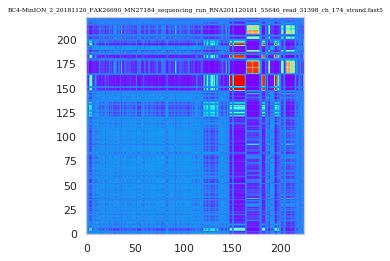

0.4879319667816162  seconds


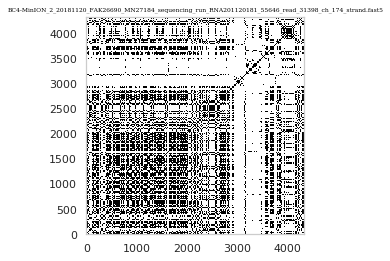

difference
0.0047643184661865234  seconds


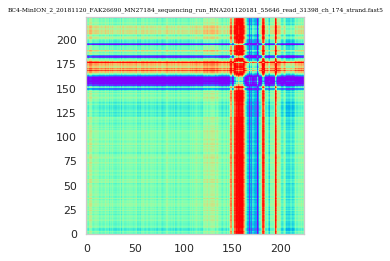

summation
0.007787942886352539  seconds


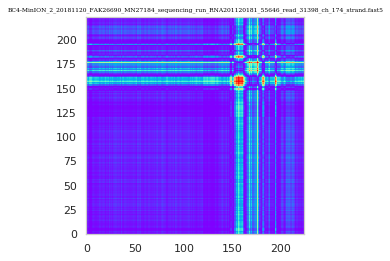

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31398_ch_450_strand.fast5


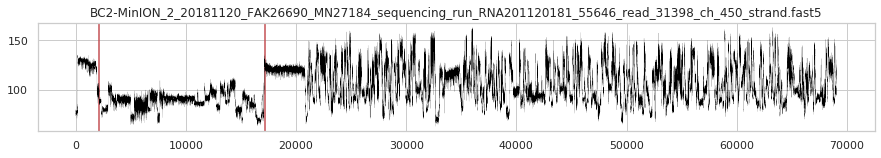

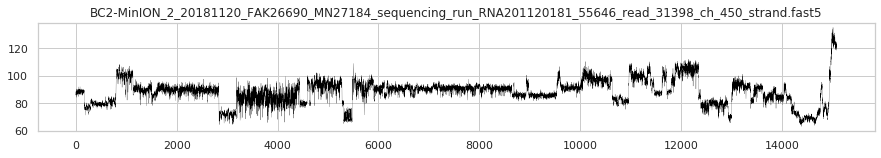

2.8391637802124023  seconds


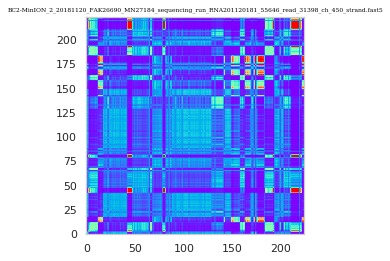

5.080681800842285  seconds


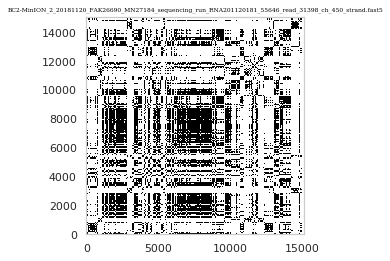

difference
0.00490117073059082  seconds


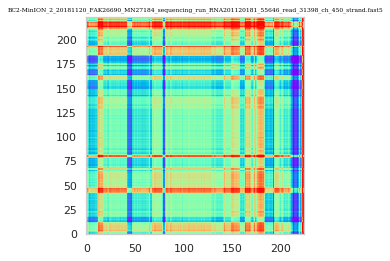

summation
0.006468057632446289  seconds


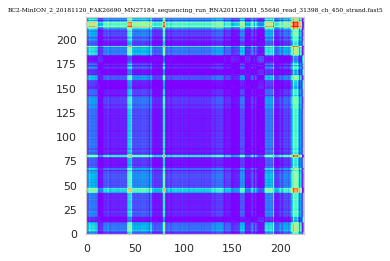

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31399_ch_377_strand.fast5


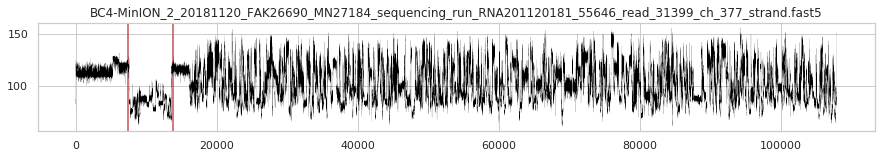

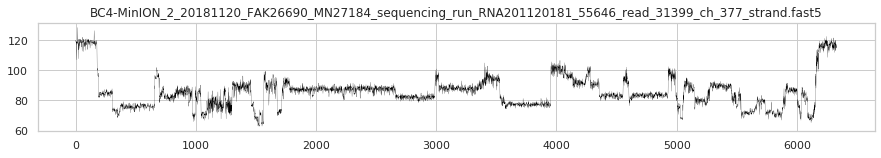

0.49774599075317383  seconds


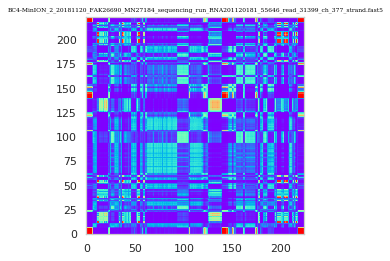

0.9470424652099609  seconds


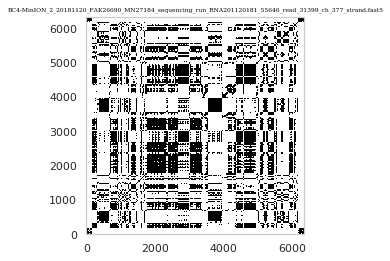

difference
0.004982471466064453  seconds


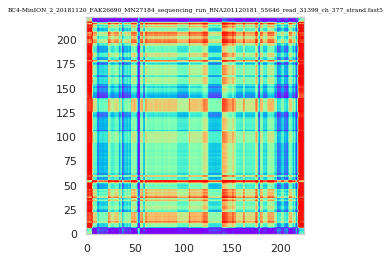

summation
0.007568836212158203  seconds


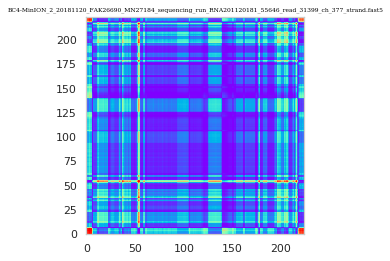

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_31400_ch_174_strand.fast5


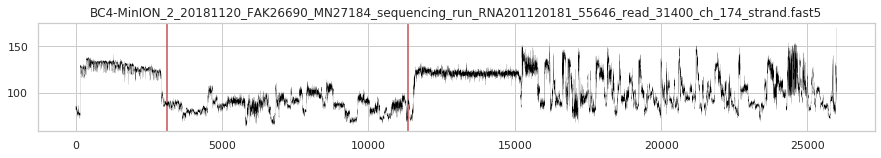

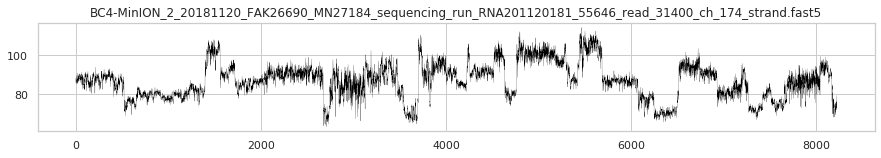

0.8793251514434814  seconds


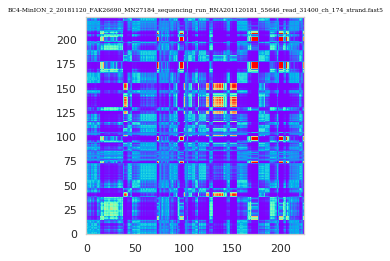

1.5953037738800049  seconds


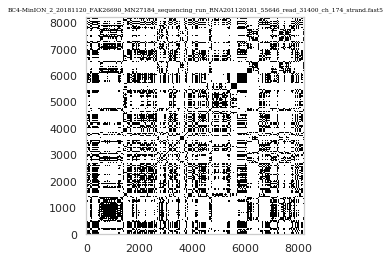

difference
0.005036354064941406  seconds


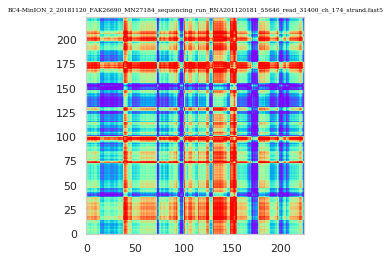

summation
0.008700132369995117  seconds


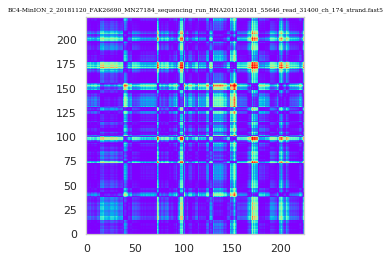

0.29096508026123047  seconds
0.6231558322906494  seconds
difference
0.0020020008087158203  seconds
summation
0.0013592243194580078  seconds
0.6734814643859863  seconds
1.3056633472442627  seconds
difference
0.001886129379272461  seconds
summation
0.0012695789337158203  seconds
0.6618828773498535  seconds
1.4149835109710693  seconds
difference
0.021770715713500977  seconds
summation
0.0013017654418945312  seconds
0.19791769981384277  seconds
0.4189333915710449  seconds
difference
0.0022301673889160156  seconds
summation
0.0015268325805664062  seconds
0.15176033973693848  seconds
0.2971608638763428  seconds
difference
0.0044231414794921875  seconds
summation
0.0015263557434082031  seconds
0.30089616775512695  seconds
0.6384985446929932  seconds
difference
0.004384756088256836  seconds
summation
0.002633810043334961  seconds
0.2371675968170166  seconds
0.5238323211669922  seconds
difference
0.004677295684814453  seconds
summation
0.0017099380493164062  seconds
0.25501108169555664  seconds

0.3409733772277832  seconds
0.7230021953582764  seconds
difference
0.0021495819091796875  seconds
summation
0.0016047954559326172  seconds
0.3703114986419678  seconds
0.8881731033325195  seconds
difference
0.0019059181213378906  seconds
summation
0.0011179447174072266  seconds
0.0717167854309082  seconds
0.16844606399536133  seconds
difference
0.002013683319091797  seconds
summation
0.006875753402709961  seconds
0.1397860050201416  seconds
0.3391690254211426  seconds
difference
0.002115964889526367  seconds
summation
0.0013434886932373047  seconds
0.7555582523345947  seconds
1.4156901836395264  seconds
difference
0.0035915374755859375  seconds
summation
0.001604318618774414  seconds
0.22770166397094727  seconds
0.5013267993927002  seconds
difference
0.0021076202392578125  seconds
summation
0.001468658447265625  seconds
1.063901662826538  seconds
1.7764830589294434  seconds
difference
0.0044460296630859375  seconds
summation
0.0015878677368164062  seconds
1.327031135559082  seconds
2.27

0.21593976020812988  seconds
0.4502246379852295  seconds
difference
0.004121541976928711  seconds
summation
0.0013620853424072266  seconds
1.1457507610321045  seconds
1.961059331893921  seconds
difference
0.0019383430480957031  seconds
summation
0.0013637542724609375  seconds
1.4121298789978027  seconds
2.4033851623535156  seconds
difference
0.0022864341735839844  seconds
summation
0.001664876937866211  seconds
2.0242514610290527  seconds
3.7264773845672607  seconds
difference
0.0022814273834228516  seconds
summation
0.0013718605041503906  seconds
0.23360514640808105  seconds
0.5009186267852783  seconds
difference
0.004444122314453125  seconds
summation
0.001369476318359375  seconds
0.7517108917236328  seconds
1.2812213897705078  seconds
difference
0.0023839473724365234  seconds
summation
0.001665353775024414  seconds
0.7289268970489502  seconds
1.1021428108215332  seconds
difference
0.00945138931274414  seconds
summation
0.0012984275817871094  seconds
1.5768442153930664  seconds
2.563

0.5273244380950928  seconds
1.2234601974487305  seconds
difference
0.009981870651245117  seconds
summation
0.003131866455078125  seconds
0.1765761375427246  seconds
0.38660550117492676  seconds
difference
0.0019071102142333984  seconds
summation
0.0013058185577392578  seconds
1.8025717735290527  seconds
3.966080904006958  seconds
difference
0.0022439956665039062  seconds
summation
0.0013315677642822266  seconds
0.2436983585357666  seconds
0.5252082347869873  seconds
difference
0.004964351654052734  seconds
summation
0.0015285015106201172  seconds
3.1886215209960938  seconds
4.815151691436768  seconds
difference
0.0022041797637939453  seconds
summation
0.001379251480102539  seconds
0.7649683952331543  seconds
1.5254170894622803  seconds
difference
0.00999593734741211  seconds
summation
0.0016624927520751953  seconds
0.6116800308227539  seconds
1.1182289123535156  seconds
difference
0.006621122360229492  seconds
summation
0.0012125968933105469  seconds
0.4259786605834961  seconds
0.88024

0.4064037799835205  seconds
0.8530323505401611  seconds
difference
0.002046346664428711  seconds
summation
0.0013895034790039062  seconds
1.3206250667572021  seconds
1.9774980545043945  seconds
difference
0.0019309520721435547  seconds
summation
0.001482248306274414  seconds
0.5673673152923584  seconds
1.2573206424713135  seconds
difference
0.003795623779296875  seconds
summation
0.0012791156768798828  seconds
0.9897184371948242  seconds
1.6237545013427734  seconds
difference
0.008792400360107422  seconds
summation
0.0016241073608398438  seconds
1.3972105979919434  seconds
2.358347177505493  seconds
difference
0.0017251968383789062  seconds
summation
0.0014121532440185547  seconds
0.32938361167907715  seconds
0.7841031551361084  seconds
difference
0.006493568420410156  seconds
summation
0.0014772415161132812  seconds
1.6244137287139893  seconds
2.6990368366241455  seconds
difference
0.0021355152130126953  seconds
summation
0.0016474723815917969  seconds
1.8687043190002441  seconds
3.61

1.3003506660461426  seconds
2.3304378986358643  seconds
difference
0.0018267631530761719  seconds
summation
0.0017268657684326172  seconds
1.5768835544586182  seconds
3.059934139251709  seconds
difference
0.001775503158569336  seconds
summation
0.0013592243194580078  seconds
0.2201824188232422  seconds
0.5061917304992676  seconds
difference
0.001980304718017578  seconds
summation
0.0013842582702636719  seconds
0.1439070701599121  seconds
0.2824690341949463  seconds
difference
0.002131223678588867  seconds
summation
0.0013816356658935547  seconds
2.484484910964966  seconds
4.2825047969818115  seconds
difference
0.0017604827880859375  seconds
summation
0.0014362335205078125  seconds
0.388866662979126  seconds
0.8591859340667725  seconds
difference
0.020934581756591797  seconds
summation
0.0014278888702392578  seconds
2.3866939544677734  seconds
3.944478750228882  seconds
difference
0.0024788379669189453  seconds
summation
0.0013782978057861328  seconds
0.45643091201782227  seconds
1.0857

0.5486617088317871  seconds
1.0233101844787598  seconds
difference
0.0022497177124023438  seconds
summation
0.0016710758209228516  seconds
0.3852357864379883  seconds
0.8372700214385986  seconds
difference
0.002488374710083008  seconds
summation
0.001453399658203125  seconds
0.13253235816955566  seconds
0.29952573776245117  seconds
difference
0.002195119857788086  seconds
summation
0.0012912750244140625  seconds
0.8512694835662842  seconds
1.4140336513519287  seconds
difference
0.002222299575805664  seconds
summation
0.00164794921875  seconds
0.426774263381958  seconds
0.9731864929199219  seconds
difference
0.0020618438720703125  seconds
summation
0.0014715194702148438  seconds
0.4299898147583008  seconds
0.956500768661499  seconds
difference
0.002096891403198242  seconds
summation
0.0014598369598388672  seconds
0.9461159706115723  seconds
1.46158766746521  seconds
difference
0.002299070358276367  seconds
summation
0.0017735958099365234  seconds
0.7991516590118408  seconds
1.4600834846

0.9345452785491943  seconds
1.328282356262207  seconds
difference
0.0022292137145996094  seconds
summation
0.0016438961029052734  seconds
0.3262002468109131  seconds
0.7205209732055664  seconds
difference
0.002094745635986328  seconds
summation
0.0013744831085205078  seconds
0.3679826259613037  seconds
0.7320773601531982  seconds
difference
0.0020596981048583984  seconds
summation
0.0012679100036621094  seconds
0.38962268829345703  seconds
0.8174235820770264  seconds
difference
0.021661043167114258  seconds
summation
0.0012271404266357422  seconds
2.660659074783325  seconds
4.68396520614624  seconds
difference
0.002032756805419922  seconds
summation
0.0016016960144042969  seconds
0.3565845489501953  seconds
0.7830483913421631  seconds
difference
0.0018072128295898438  seconds
summation
0.0014481544494628906  seconds
0.9868581295013428  seconds
1.7100658416748047  seconds
difference
0.005193471908569336  seconds
summation
0.00164794921875  seconds
0.8672976493835449  seconds
1.363059043

0.20542621612548828  seconds
0.45047640800476074  seconds
difference
0.0018172264099121094  seconds
summation
0.0013325214385986328  seconds
1.7111194133758545  seconds
3.214346408843994  seconds
difference
0.002185344696044922  seconds
summation
0.0014634132385253906  seconds
0.7064898014068604  seconds
1.3498256206512451  seconds
difference
0.008788585662841797  seconds
summation
0.001256704330444336  seconds
1.8287525177001953  seconds
2.696993827819824  seconds
difference
0.0019428730010986328  seconds
summation
0.0017507076263427734  seconds
1.1839392185211182  seconds
2.049529790878296  seconds
difference
0.0021200180053710938  seconds
summation
0.0017359256744384766  seconds
0.5974018573760986  seconds
1.1389625072479248  seconds
difference
0.002215147018432617  seconds
summation
0.0015957355499267578  seconds
0.8076670169830322  seconds
1.5117626190185547  seconds
difference
0.001888275146484375  seconds
summation
0.0012938976287841797  seconds
0.3003575801849365  seconds
0.648

0.2474820613861084  seconds
0.5486390590667725  seconds
difference
0.002279043197631836  seconds
summation
0.0014111995697021484  seconds
0.325977087020874  seconds
0.750659704208374  seconds
difference
0.0021059513092041016  seconds
summation
0.0014574527740478516  seconds
0.7267544269561768  seconds
1.596738338470459  seconds
difference
0.0017218589782714844  seconds
summation
0.001455068588256836  seconds
0.814110279083252  seconds
1.6869893074035645  seconds
difference
0.0028989315032958984  seconds
summation
0.0014009475708007812  seconds
1.7426812648773193  seconds
2.851511001586914  seconds
difference
0.0021004676818847656  seconds
summation
0.0014581680297851562  seconds
0.14432406425476074  seconds
0.2996339797973633  seconds
difference
0.001867055892944336  seconds
summation
0.0013060569763183594  seconds
0.30005431175231934  seconds
0.6565923690795898  seconds
difference
0.002256631851196289  seconds
summation
0.0014348030090332031  seconds
0.14406275749206543  seconds
0.234

0.3712127208709717  seconds
0.8431234359741211  seconds
difference
0.0097503662109375  seconds
summation
0.0014889240264892578  seconds
0.20892333984375  seconds
0.3880445957183838  seconds
difference
0.0019521713256835938  seconds
summation
0.0012326240539550781  seconds
4.718260049819946  seconds
8.580709218978882  seconds
difference
0.009890317916870117  seconds
summation
0.0015425682067871094  seconds
1.0590381622314453  seconds
1.7341580390930176  seconds
difference
0.009438037872314453  seconds
summation
0.0013401508331298828  seconds
0.6841931343078613  seconds
1.3574464321136475  seconds
difference
0.009584426879882812  seconds
summation
0.0013022422790527344  seconds
0.3497169017791748  seconds
0.7798111438751221  seconds
difference
0.0018835067749023438  seconds
summation
0.001251220703125  seconds
1.0281448364257812  seconds
1.9760165214538574  seconds
difference
0.002274036407470703  seconds
summation
0.0013637542724609375  seconds
0.7328298091888428  seconds
1.309357166290

0.5166501998901367  seconds
0.9683651924133301  seconds
difference
0.006639242172241211  seconds
summation
0.0015327930450439453  seconds
1.1894340515136719  seconds
2.2019081115722656  seconds
difference
0.002105712890625  seconds
summation
0.0017015933990478516  seconds
0.4433598518371582  seconds
1.0449001789093018  seconds
difference
0.0021631717681884766  seconds
summation
0.0015192031860351562  seconds
0.6413843631744385  seconds
1.2936358451843262  seconds
difference
0.0018107891082763672  seconds
summation
0.0012371540069580078  seconds
0.5678987503051758  seconds
1.0891923904418945  seconds
difference
0.0021250247955322266  seconds
summation
0.0014946460723876953  seconds
2.0189037322998047  seconds
3.2776753902435303  seconds
difference
0.002111673355102539  seconds
summation
0.0017001628875732422  seconds
0.33415675163269043  seconds
0.6996545791625977  seconds
difference
0.0021753311157226562  seconds
summation
0.0013949871063232422  seconds
1.0875000953674316  seconds
2.18

0.7490196228027344  seconds
1.5226287841796875  seconds
difference
0.009548425674438477  seconds
summation
0.0012538433074951172  seconds
1.684753656387329  seconds
2.6536922454833984  seconds
difference
0.002229928970336914  seconds
summation
0.0013737678527832031  seconds
0.482926607131958  seconds
1.0922939777374268  seconds
difference
0.0021419525146484375  seconds
summation
0.0015134811401367188  seconds
0.2678258419036865  seconds
0.5935142040252686  seconds
difference
0.002165555953979492  seconds
summation
0.0012748241424560547  seconds
0.24556612968444824  seconds
0.5899310111999512  seconds
difference
0.0019385814666748047  seconds
summation
0.0013124942779541016  seconds
0.26270461082458496  seconds
0.5536582469940186  seconds
difference
0.0018444061279296875  seconds
summation
0.0012328624725341797  seconds
1.0835494995117188  seconds
1.8552219867706299  seconds
difference
0.005769491195678711  seconds
summation
0.0015685558319091797  seconds
0.951688289642334  seconds
1.55

0.42684459686279297  seconds
0.889592170715332  seconds
difference
0.0019223690032958984  seconds
summation
0.0014529228210449219  seconds
0.362872838973999  seconds
0.8552274703979492  seconds
difference
0.014913797378540039  seconds
summation
0.0014824867248535156  seconds
0.1957402229309082  seconds
0.4078817367553711  seconds
difference
0.0027425289154052734  seconds
summation
0.0012869834899902344  seconds
0.5486059188842773  seconds
1.0888688564300537  seconds
difference
0.0023844242095947266  seconds
summation
0.0015606880187988281  seconds
1.1427521705627441  seconds
1.9343080520629883  seconds
difference
0.007472991943359375  seconds
summation
0.0013391971588134766  seconds
0.6454041004180908  seconds
1.1458568572998047  seconds
difference
0.009977340698242188  seconds
summation
0.00164031982421875  seconds
0.2965090274810791  seconds
0.7556908130645752  seconds
difference
0.0020084381103515625  seconds
summation
0.0014061927795410156  seconds
1.1372003555297852  seconds
1.679

0.32689881324768066  seconds
0.7912843227386475  seconds
difference
0.002220630645751953  seconds
summation
0.0015158653259277344  seconds
0.9748494625091553  seconds
1.589829683303833  seconds
difference
0.0022592544555664062  seconds
summation
0.001682281494140625  seconds
0.2738652229309082  seconds
0.6458323001861572  seconds
difference
0.002091646194458008  seconds
summation
0.0014891624450683594  seconds
2.3118247985839844  seconds
3.62117600440979  seconds
difference
0.0018317699432373047  seconds
summation
0.0017247200012207031  seconds
1.5808448791503906  seconds
2.9162685871124268  seconds
difference
0.0023555755615234375  seconds
summation
0.0016472339630126953  seconds
0.7133715152740479  seconds
1.3501629829406738  seconds
difference
0.009687662124633789  seconds
summation
0.0012319087982177734  seconds
0.35608458518981934  seconds
0.7877392768859863  seconds
difference
0.0018126964569091797  seconds
summation
0.0013899803161621094  seconds
0.6695599555969238  seconds
1.14

1.1535611152648926  seconds
difference
0.002234935760498047  seconds
summation
0.0016491413116455078  seconds
0.3185133934020996  seconds
0.7962019443511963  seconds
difference
0.002133607864379883  seconds
summation
0.0015380382537841797  seconds
0.21342992782592773  seconds
0.36031675338745117  seconds
difference
0.001992464065551758  seconds
summation
0.0013034343719482422  seconds
0.8686285018920898  seconds
1.514263391494751  seconds
difference
0.002132892608642578  seconds
summation
0.001590728759765625  seconds
0.14343881607055664  seconds
0.31806325912475586  seconds
difference
0.0019428730010986328  seconds
summation
0.0010576248168945312  seconds
0.3739488124847412  seconds
0.7695088386535645  seconds
difference
0.0018413066864013672  seconds
summation
0.001481771469116211  seconds
1.6429336071014404  seconds
3.2575411796569824  seconds
difference
0.001894235610961914  seconds
summation
0.001756429672241211  seconds
0.6174638271331787  seconds
1.1431784629821777  seconds
diff

0.3149449825286865  seconds
0.665684700012207  seconds
difference
0.001976490020751953  seconds
summation
0.0011649131774902344  seconds
1.1034650802612305  seconds
2.0411460399627686  seconds
difference
0.002390623092651367  seconds
summation
0.0013623237609863281  seconds
1.0419559478759766  seconds
1.9547317028045654  seconds
difference
0.007035017013549805  seconds
summation
0.001352548599243164  seconds
0.3491096496582031  seconds
0.8222136497497559  seconds
difference
0.0024569034576416016  seconds
summation
0.0014824867248535156  seconds
0.5040843486785889  seconds
1.109865665435791  seconds
difference
0.0018322467803955078  seconds
summation
0.0015742778778076172  seconds
0.8297238349914551  seconds
1.2770216464996338  seconds
difference
0.004612922668457031  seconds
summation
0.0013997554779052734  seconds
0.8883457183837891  seconds
1.4482910633087158  seconds
difference
0.004622936248779297  seconds
summation
0.00145721435546875  seconds
1.3937115669250488  seconds
2.5667943

0.30745673179626465  seconds
difference
0.002184629440307617  seconds
summation
0.0012822151184082031  seconds
1.8412420749664307  seconds
3.328355550765991  seconds
difference
0.0020301342010498047  seconds
summation
0.0014293193817138672  seconds
1.2678310871124268  seconds
2.362795829772949  seconds
difference
0.009813308715820312  seconds
summation
0.001577138900756836  seconds
0.9756085872650146  seconds
1.8271102905273438  seconds
difference
0.0021064281463623047  seconds
summation
0.0017037391662597656  seconds
0.4928162097930908  seconds
1.044743537902832  seconds
difference
0.009828567504882812  seconds
summation
0.0014979839324951172  seconds
0.3213942050933838  seconds
0.8041291236877441  seconds
difference
0.002001047134399414  seconds
summation
0.0012788772583007812  seconds
1.0180854797363281  seconds
1.5500788688659668  seconds
difference
0.0021753311157226562  seconds
summation
0.0015392303466796875  seconds
0.3431966304779053  seconds
0.587604284286499  seconds
differe

0.27005457878112793  seconds
0.6089200973510742  seconds
difference
0.0018646717071533203  seconds
summation
0.0010497570037841797  seconds
0.14967727661132812  seconds
0.25689005851745605  seconds
difference
0.001958608627319336  seconds
summation
0.0013005733489990234  seconds
0.5537564754486084  seconds
1.0467698574066162  seconds
difference
0.0022842884063720703  seconds
summation
0.0015099048614501953  seconds
0.2576789855957031  seconds
0.47840261459350586  seconds
difference
0.002112865447998047  seconds
summation
0.0013806819915771484  seconds
0.7766990661621094  seconds
1.281801462173462  seconds
difference
0.009581565856933594  seconds
summation
0.0013039112091064453  seconds
0.4323105812072754  seconds
0.935258150100708  seconds
difference
0.0018963813781738281  seconds
summation
0.0011453628540039062  seconds
1.0686829090118408  seconds
1.998274326324463  seconds
difference
0.002081632614135742  seconds
summation
0.0015354156494140625  seconds
0.26871585845947266  seconds
0

0.3168795108795166  seconds
0.6605632305145264  seconds
difference
0.0018644332885742188  seconds
summation
0.0011458396911621094  seconds
0.32667970657348633  seconds
0.7306749820709229  seconds
difference
0.002133607864379883  seconds
summation
0.001514434814453125  seconds
0.9313783645629883  seconds
1.5320847034454346  seconds
difference
0.0020401477813720703  seconds
summation
0.001257181167602539  seconds
0.2579982280731201  seconds
0.4751741886138916  seconds
difference
0.0021224021911621094  seconds
summation
0.001397848129272461  seconds
0.21901750564575195  seconds
0.4722113609313965  seconds
difference
0.001912832260131836  seconds
summation
0.0010876655578613281  seconds
0.3634963035583496  seconds
0.8634843826293945  seconds
difference
0.0017266273498535156  seconds
summation
0.0012977123260498047  seconds
0.26028990745544434  seconds
0.6505253314971924  seconds
difference
0.002067089080810547  seconds
summation
0.0013544559478759766  seconds
0.7026181221008301  seconds
1.

0.7653579711914062  seconds
difference
0.0021779537200927734  seconds
summation
0.0014843940734863281  seconds
0.41724562644958496  seconds
0.8197641372680664  seconds
difference
0.006558418273925781  seconds
summation
0.0013875961303710938  seconds
0.6687991619110107  seconds
1.17393159866333  seconds
difference
0.0022459030151367188  seconds
summation
0.0016782283782958984  seconds
0.16858601570129395  seconds
0.3053433895111084  seconds
difference
0.00217437744140625  seconds
summation
0.0013189315795898438  seconds
0.3175811767578125  seconds
0.7232544422149658  seconds
difference
0.005688667297363281  seconds
summation
0.0011157989501953125  seconds
0.8880271911621094  seconds
1.490354299545288  seconds
difference
0.009057998657226562  seconds
summation
0.0016169548034667969  seconds
0.915367841720581  seconds
1.438737154006958  seconds
difference
0.0020248889923095703  seconds
summation
0.0013477802276611328  seconds
0.37967371940612793  seconds
0.6558678150177002  seconds
differ

1.0213401317596436  seconds
1.5737903118133545  seconds
difference
0.0022559165954589844  seconds
summation
0.001459360122680664  seconds
0.4397435188293457  seconds
1.360990047454834  seconds
difference
0.00225067138671875  seconds
summation
0.0020492076873779297  seconds
0.3734269142150879  seconds
0.7921788692474365  seconds
difference
0.0021800994873046875  seconds
summation
0.0014464855194091797  seconds
0.4269235134124756  seconds
0.9260647296905518  seconds
difference
0.0022039413452148438  seconds
summation
0.0014352798461914062  seconds
0.7274866104125977  seconds
1.2850489616394043  seconds
difference
0.010813236236572266  seconds
summation
0.001216888427734375  seconds
1.4069023132324219  seconds
2.6916491985321045  seconds
difference
0.0020170211791992188  seconds
summation
0.0014257431030273438  seconds
0.2921268939971924  seconds
0.6374166011810303  seconds
difference
0.0022003650665283203  seconds
summation
0.0014050006866455078  seconds
1.065021276473999  seconds
1.8788

0.25391197204589844  seconds
0.5411832332611084  seconds
difference
0.0016710758209228516  seconds
summation
0.0011434555053710938  seconds
0.8826508522033691  seconds
1.471170425415039  seconds
difference
0.0020363330841064453  seconds
summation
0.0012781620025634766  seconds
0.39398884773254395  seconds
0.8777594566345215  seconds
difference
0.002179861068725586  seconds
summation
0.0014216899871826172  seconds
0.8388705253601074  seconds
1.4646337032318115  seconds
difference
0.002025604248046875  seconds
summation
0.0016007423400878906  seconds
0.8562161922454834  seconds
1.5247907638549805  seconds
difference
0.0018565654754638672  seconds
summation
0.0018763542175292969  seconds
0.4775660037994385  seconds
0.895963191986084  seconds
difference
0.002112150192260742  seconds
summation
0.0014438629150390625  seconds
0.23597216606140137  seconds
0.4936251640319824  seconds
difference
0.0020771026611328125  seconds
summation
0.0012731552124023438  seconds
0.9969863891601562  seconds
1

1.1003780364990234  seconds
1.7993237972259521  seconds
difference
0.009083986282348633  seconds
summation
0.0015645027160644531  seconds
0.4910600185394287  seconds
1.055103063583374  seconds
difference
0.0021550655364990234  seconds
summation
0.0014920234680175781  seconds
0.2286386489868164  seconds
0.45837974548339844  seconds
difference
0.001991748809814453  seconds
summation
0.0012993812561035156  seconds
0.4142584800720215  seconds
1.0317623615264893  seconds
difference
0.0018622875213623047  seconds
summation
0.0014066696166992188  seconds
0.19159150123596191  seconds
0.3494739532470703  seconds
difference
0.002191781997680664  seconds
summation
0.0013811588287353516  seconds
0.27779650688171387  seconds
0.5751943588256836  seconds
difference
0.002040863037109375  seconds
summation
0.001512765884399414  seconds
0.4151177406311035  seconds
0.8146662712097168  seconds
difference
0.002437591552734375  seconds
summation
0.0014772415161132812  seconds
0.3353385925292969  seconds
0.7

1.3760132789611816  seconds
2.4628868103027344  seconds
difference
0.007371425628662109  seconds
summation
0.0013244152069091797  seconds
0.12010693550109863  seconds
0.3247387409210205  seconds
difference
0.0020122528076171875  seconds
summation
0.0012297630310058594  seconds
0.23463129997253418  seconds
0.5895142555236816  seconds
difference
0.0018341541290283203  seconds
summation
0.001094818115234375  seconds
0.9714772701263428  seconds
1.6542985439300537  seconds
difference
0.007937908172607422  seconds
summation
0.0013589859008789062  seconds
1.4494009017944336  seconds
2.5466716289520264  seconds
difference
0.0019681453704833984  seconds
summation
0.0014081001281738281  seconds
0.48221302032470703  seconds
1.0171477794647217  seconds
difference
0.006669759750366211  seconds
summation
0.001455545425415039  seconds
0.7557368278503418  seconds
1.3832457065582275  seconds
difference
0.005498647689819336  seconds
summation
0.001218557357788086  seconds
0.7018566131591797  seconds
1.1

0.41671323776245117  seconds
1.0100243091583252  seconds
difference
0.0023038387298583984  seconds
summation
0.0015344619750976562  seconds
1.6348354816436768  seconds
2.960665702819824  seconds
difference
0.002175569534301758  seconds
summation
0.0014333724975585938  seconds
0.22173237800598145  seconds
0.5081870555877686  seconds
difference
0.005138397216796875  seconds
summation
0.0013649463653564453  seconds
0.22568321228027344  seconds
0.44800662994384766  seconds
difference
0.0018684864044189453  seconds
summation
0.0012316703796386719  seconds
1.3326570987701416  seconds
2.3823959827423096  seconds
difference
0.0019986629486083984  seconds
summation
0.0014443397521972656  seconds
0.2891991138458252  seconds
0.7615950107574463  seconds
difference
0.009673118591308594  seconds
summation
0.0012674331665039062  seconds
0.2866532802581787  seconds
0.6873531341552734  seconds
difference
0.011331558227539062  seconds
summation
0.0012264251708984375  seconds
0.4165513515472412  seconds


0.3648717403411865  seconds
0.8470938205718994  seconds
difference
0.0022389888763427734  seconds
summation
0.0014917850494384766  seconds
0.26302528381347656  seconds
0.624981164932251  seconds
difference
0.0020461082458496094  seconds
summation
0.0011336803436279297  seconds
0.7377238273620605  seconds
1.3814396858215332  seconds
difference
0.0143280029296875  seconds
summation
0.0015876293182373047  seconds
0.6442418098449707  seconds
1.185969591140747  seconds
difference
0.0019605159759521484  seconds
summation
0.0012791156768798828  seconds
0.26581740379333496  seconds
0.6176965236663818  seconds
difference
0.0018155574798583984  seconds
summation
0.0013828277587890625  seconds
0.3719916343688965  seconds
0.7993099689483643  seconds
difference
0.00603485107421875  seconds
summation
0.0014722347259521484  seconds
0.4199545383453369  seconds
0.9185066223144531  seconds
difference
0.0019795894622802734  seconds
summation
0.001455545425415039  seconds
0.41396069526672363  seconds
0.98

0.37859654426574707  seconds
0.8651764392852783  seconds
difference
0.002336740493774414  seconds
summation
0.0016062259674072266  seconds
0.15523338317871094  seconds
0.30878400802612305  seconds
difference
0.0017998218536376953  seconds
summation
0.0011475086212158203  seconds
0.284867525100708  seconds
0.615699052810669  seconds
difference
0.0023119449615478516  seconds
summation
0.0015306472778320312  seconds
0.22863268852233887  seconds
0.47257161140441895  seconds
difference
0.0022177696228027344  seconds
summation
0.001397848129272461  seconds
1.3824262619018555  seconds
2.369366407394409  seconds
difference
0.002082347869873047  seconds
summation
0.0016596317291259766  seconds
0.4728529453277588  seconds
0.9687423706054688  seconds
difference
0.009638309478759766  seconds
summation
0.0010707378387451172  seconds
0.43342113494873047  seconds
0.9951379299163818  seconds
difference
0.002225160598754883  seconds
summation
0.0016331672668457031  seconds
0.14111566543579102  seconds


0.26517558097839355  seconds
difference
0.0018439292907714844  seconds
summation
0.0011491775512695312  seconds
0.5671906471252441  seconds
1.1552586555480957  seconds
difference
0.00966787338256836  seconds
summation
0.0011413097381591797  seconds
0.28669309616088867  seconds
0.651421308517456  seconds
difference
0.0021517276763916016  seconds
summation
0.0013413429260253906  seconds
0.797659158706665  seconds
1.6179463863372803  seconds
difference
0.0021772384643554688  seconds
summation
0.0012364387512207031  seconds
0.2155909538269043  seconds
0.4429595470428467  seconds
difference
0.002257108688354492  seconds
summation
0.0013289451599121094  seconds
0.35384106636047363  seconds
0.703892707824707  seconds
difference
0.0023102760314941406  seconds
summation
0.0014081001281738281  seconds
0.29656529426574707  seconds
0.6447412967681885  seconds
difference
0.009748697280883789  seconds
summation
0.0013346672058105469  seconds
0.36211490631103516  seconds
0.767099142074585  seconds
di

0.15279579162597656  seconds
difference
0.0018622875213623047  seconds
summation
0.0010390281677246094  seconds
0.7980215549468994  seconds
1.4617505073547363  seconds
difference
0.002302885055541992  seconds
summation
0.0016281604766845703  seconds
0.7304437160491943  seconds
1.4362382888793945  seconds
difference
0.001996755599975586  seconds
summation
0.001260519027709961  seconds
1.412247657775879  seconds
2.305194139480591  seconds
difference
0.002237081527709961  seconds
summation
0.0016777515411376953  seconds
0.6091463565826416  seconds
1.0177273750305176  seconds
difference
0.008869409561157227  seconds
summation
0.0015735626220703125  seconds
0.7795379161834717  seconds
1.5315663814544678  seconds
difference
0.00999903678894043  seconds
summation
0.001528024673461914  seconds
0.16565847396850586  seconds
0.3120877742767334  seconds
difference
0.001821756362915039  seconds
summation
0.00102996826171875  seconds
0.43654513359069824  seconds
0.8930351734161377  seconds
differenc

0.19009160995483398  seconds
0.39455175399780273  seconds
difference
0.003931522369384766  seconds
summation
0.001195669174194336  seconds
0.41416501998901367  seconds
1.11464262008667  seconds
difference
0.009871721267700195  seconds
summation
0.001489400863647461  seconds
0.20740556716918945  seconds
0.4682927131652832  seconds
difference
0.0018851757049560547  seconds
summation
0.0013041496276855469  seconds
0.37665390968322754  seconds
0.9034867286682129  seconds
difference
0.002317667007446289  seconds
summation
0.001634836196899414  seconds
0.2509956359863281  seconds
0.5284295082092285  seconds
difference
0.0021245479583740234  seconds
summation
0.0013082027435302734  seconds
0.48248744010925293  seconds
0.9314491748809814  seconds
difference
0.0025534629821777344  seconds
summation
0.0014066696166992188  seconds
1.8977067470550537  seconds
3.4336085319519043  seconds
difference
0.009808778762817383  seconds
summation
0.0016858577728271484  seconds
0.13898563385009766  seconds
0

0.3500833511352539  seconds
0.8398013114929199  seconds
difference
0.0020754337310791016  seconds
summation
0.00139617919921875  seconds
0.27823543548583984  seconds
0.6377124786376953  seconds
difference
0.0018434524536132812  seconds
summation
0.0014109611511230469  seconds
0.23781323432922363  seconds
0.5101747512817383  seconds
difference
0.0018744468688964844  seconds
summation
0.0010573863983154297  seconds
0.4441556930541992  seconds
1.0351216793060303  seconds
difference
0.00217437744140625  seconds
summation
0.0014543533325195312  seconds
0.6887521743774414  seconds
1.2982535362243652  seconds
difference
0.002290964126586914  seconds
summation
0.0012404918670654297  seconds
0.2811446189880371  seconds
0.5204145908355713  seconds
difference
0.0021207332611083984  seconds
summation
0.0013747215270996094  seconds
0.8380577564239502  seconds
1.3838698863983154  seconds
difference
0.002308368682861328  seconds
summation
0.0015442371368408203  seconds
0.16865754127502441  seconds
0.

0.3330094814300537  seconds
0.7333106994628906  seconds
difference
0.0018398761749267578  seconds
summation
0.001436471939086914  seconds
0.2493607997894287  seconds
0.5234458446502686  seconds
difference
0.0020067691802978516  seconds
summation
0.001405477523803711  seconds
0.2381439208984375  seconds
0.5092451572418213  seconds
difference
0.002024412155151367  seconds
summation
0.0013778209686279297  seconds
0.38329482078552246  seconds
0.8212110996246338  seconds
difference
0.0018079280853271484  seconds
summation
0.0011310577392578125  seconds
0.8851666450500488  seconds
1.4405722618103027  seconds
difference
0.0024352073669433594  seconds
summation
0.0015883445739746094  seconds
2.7368414402008057  seconds
4.065650463104248  seconds
difference
0.0020842552185058594  seconds
summation
0.00147247314453125  seconds
0.7490603923797607  seconds
1.4573349952697754  seconds
difference
0.0034356117248535156  seconds
summation
0.001280069351196289  seconds
0.2413492202758789  seconds
0.467

0.20613956451416016  seconds
0.4336676597595215  seconds
difference
0.0016965866088867188  seconds
summation
0.0010683536529541016  seconds
0.3881502151489258  seconds
1.0278916358947754  seconds
difference
0.001940011978149414  seconds
summation
0.0014562606811523438  seconds
0.9906926155090332  seconds
1.7519137859344482  seconds
difference
0.003759145736694336  seconds
summation
0.0015478134155273438  seconds
1.0692813396453857  seconds
1.8233528137207031  seconds
difference
0.0018124580383300781  seconds
summation
0.0015666484832763672  seconds
2.614297866821289  seconds
4.320549726486206  seconds
difference
0.002437114715576172  seconds
summation
0.0013284683227539062  seconds
0.31246376037597656  seconds
0.6458399295806885  seconds
difference
0.0023148059844970703  seconds
summation
0.0015246868133544922  seconds
0.23077034950256348  seconds
0.5272231101989746  seconds
difference
0.0021071434020996094  seconds
summation
0.001432180404663086  seconds
0.20600008964538574  seconds
0

0.9266519546508789  seconds
1.868234634399414  seconds
difference
0.011508464813232422  seconds
summation
0.0016243457794189453  seconds
0.502845048904419  seconds
1.0321297645568848  seconds
difference
0.003214597702026367  seconds
summation
0.0014138221740722656  seconds
0.289081335067749  seconds
0.5869512557983398  seconds
difference
0.002033710479736328  seconds
summation
0.001323699951171875  seconds
0.2685506343841553  seconds
0.7014472484588623  seconds
difference
0.0055468082427978516  seconds
summation
0.0013871192932128906  seconds
0.70261549949646  seconds
1.4271328449249268  seconds
difference
0.002353191375732422  seconds
summation
0.0015804767608642578  seconds
1.6417195796966553  seconds
3.277052402496338  seconds
difference
0.0021169185638427734  seconds
summation
0.001443624496459961  seconds
0.31922197341918945  seconds
0.7612073421478271  seconds
difference
0.0022635459899902344  seconds
summation
0.0014879703521728516  seconds
0.6961007118225098  seconds
1.40443539

0.27661752700805664  seconds
0.5999977588653564  seconds
difference
0.0021975040435791016  seconds
summation
0.0013871192932128906  seconds
0.3907768726348877  seconds
0.8422582149505615  seconds
difference
0.00197601318359375  seconds
summation
0.0011639595031738281  seconds
0.2175006866455078  seconds
0.4317471981048584  seconds
difference
0.004235029220581055  seconds
summation
0.0011608600616455078  seconds
0.2297830581665039  seconds
0.4458191394805908  seconds
difference
0.002007007598876953  seconds
summation
0.0014407634735107422  seconds
0.6300818920135498  seconds
0.9517769813537598  seconds
difference
0.0019023418426513672  seconds
summation
0.0019273757934570312  seconds
0.4266676902770996  seconds
0.9084987640380859  seconds
difference
0.0021257400512695312  seconds
summation
0.0014917850494384766  seconds
0.8990719318389893  seconds
1.4574956893920898  seconds
difference
0.009910821914672852  seconds
summation
0.001596212387084961  seconds
0.18448662757873535  seconds
0.4

0.18030238151550293  seconds
0.34038519859313965  seconds
difference
0.002106904983520508  seconds
summation
0.0013327598571777344  seconds
0.2567868232727051  seconds
0.5343277454376221  seconds
difference
0.0021119117736816406  seconds
summation
0.0014150142669677734  seconds
0.1991739273071289  seconds
0.4112224578857422  seconds
difference
0.022672414779663086  seconds
summation
0.0013477802276611328  seconds
0.25456953048706055  seconds
0.548497200012207  seconds
difference
0.0020995140075683594  seconds
summation
0.001386880874633789  seconds
0.2586987018585205  seconds
0.561215877532959  seconds
difference
0.005296468734741211  seconds
summation
0.0013213157653808594  seconds
0.35562729835510254  seconds
0.78999924659729  seconds
difference
0.0022482872009277344  seconds
summation
0.00136566162109375  seconds
0.31804823875427246  seconds
0.7299811840057373  seconds
difference
0.0050084590911865234  seconds
summation
0.001546621322631836  seconds
0.11490321159362793  seconds
0.24

0.16272830963134766  seconds
0.3416454792022705  seconds
difference
0.0018794536590576172  seconds
summation
0.001295328140258789  seconds
0.2414381504058838  seconds
0.4669473171234131  seconds
difference
0.002149820327758789  seconds
summation
0.001344919204711914  seconds
1.1229491233825684  seconds
2.0476620197296143  seconds
difference
0.0023682117462158203  seconds
summation
0.0016448497772216797  seconds
0.2506113052368164  seconds
0.5865211486816406  seconds
difference
0.002165079116821289  seconds
summation
0.0013751983642578125  seconds
0.5645394325256348  seconds
0.979363203048706  seconds
difference
0.009372949600219727  seconds
summation
0.0015246868133544922  seconds
0.62229323387146  seconds
1.1936917304992676  seconds
difference
0.002512216567993164  seconds
summation
0.0016219615936279297  seconds
0.5816307067871094  seconds
1.146221399307251  seconds
difference
0.010019063949584961  seconds
summation
0.001516103744506836  seconds
0.48998236656188965  seconds
0.9797925

0.25382542610168457  seconds
0.5641255378723145  seconds
difference
0.001871347427368164  seconds
summation
0.0034096240997314453  seconds
0.4002702236175537  seconds
1.018655776977539  seconds
difference
0.002149820327758789  seconds
summation
0.0014789104461669922  seconds
0.32024359703063965  seconds
0.6885406970977783  seconds
difference
0.0021398067474365234  seconds
summation
0.0014615058898925781  seconds
0.36931633949279785  seconds
0.737565279006958  seconds
difference
0.002106904983520508  seconds
summation
0.0012917518615722656  seconds
1.6471192836761475  seconds
3.607591152191162  seconds
difference
0.009272575378417969  seconds
summation
0.0014262199401855469  seconds
1.316530466079712  seconds
2.1742122173309326  seconds
difference
0.0020079612731933594  seconds
summation
0.0013506412506103516  seconds
1.963087797164917  seconds
3.3239378929138184  seconds
difference
0.0020461082458496094  seconds
summation
0.0014052391052246094  seconds
0.147233247756958  seconds
0.3357

0.9808228015899658  seconds
difference
0.005276203155517578  seconds
summation
0.0016171932220458984  seconds
0.5024793148040771  seconds
1.0271906852722168  seconds
difference
0.0020220279693603516  seconds
summation
0.0011675357818603516  seconds
0.282421350479126  seconds
0.6047172546386719  seconds
difference
0.002155303955078125  seconds
summation
0.0013473033905029297  seconds
0.2194688320159912  seconds
0.4565927982330322  seconds
difference
0.002076864242553711  seconds
summation
0.0013420581817626953  seconds
0.19732022285461426  seconds
0.38806653022766113  seconds
difference
0.0020818710327148438  seconds
summation
0.0012624263763427734  seconds
0.7851850986480713  seconds
1.294562578201294  seconds
difference
0.01586747169494629  seconds
summation
0.0011703968048095703  seconds
1.0811724662780762  seconds
1.878174066543579  seconds
difference
0.008586883544921875  seconds
summation
0.0012826919555664062  seconds
0.3182661533355713  seconds
0.6091434955596924  seconds
differ

0.2733924388885498  seconds
difference
0.0021910667419433594  seconds
summation
0.0013744831085205078  seconds
0.34496235847473145  seconds
0.705385684967041  seconds
difference
0.0020818710327148438  seconds
summation
0.001407623291015625  seconds
1.4943928718566895  seconds
2.665389060974121  seconds
difference
0.0064144134521484375  seconds
summation
0.0016062259674072266  seconds
0.25984978675842285  seconds
0.49693822860717773  seconds
difference
0.009547710418701172  seconds
summation
0.0013751983642578125  seconds
0.3025953769683838  seconds
0.7009594440460205  seconds
difference
0.0025169849395751953  seconds
summation
0.0011184215545654297  seconds
0.1816408634185791  seconds
0.36873865127563477  seconds
difference
0.002050161361694336  seconds
summation
0.0013167858123779297  seconds
1.518676519393921  seconds
2.3945231437683105  seconds
difference
0.0056324005126953125  seconds
summation
0.001394510269165039  seconds
0.7297208309173584  seconds
1.3221588134765625  seconds
di

1.0027098655700684  seconds
1.7308251857757568  seconds
difference
0.0021545886993408203  seconds
summation
0.0014081001281738281  seconds
2.091529607772827  seconds
3.695017099380493  seconds
difference
0.002729177474975586  seconds
summation
0.0016257762908935547  seconds
1.1144683361053467  seconds
2.0510478019714355  seconds
difference
0.003994941711425781  seconds
summation
0.0017313957214355469  seconds
0.2374558448791504  seconds
0.5289478302001953  seconds
difference
0.009284257888793945  seconds
summation
0.0014531612396240234  seconds
2.4088752269744873  seconds
4.303370714187622  seconds
difference
0.002582550048828125  seconds
summation
0.0014193058013916016  seconds
0.23192787170410156  seconds
0.4697859287261963  seconds
difference
0.004778861999511719  seconds
summation
0.0014264583587646484  seconds
0.4278557300567627  seconds
0.8439066410064697  seconds
difference
0.0020380020141601562  seconds
summation
0.001210927963256836  seconds
1.6352014541625977  seconds
3.11598

1.120661735534668  seconds
2.105217933654785  seconds
difference
0.0055043697357177734  seconds
summation
0.0016050338745117188  seconds
0.2539694309234619  seconds
0.594426155090332  seconds
difference
0.002209901809692383  seconds
summation
0.0013165473937988281  seconds
0.32173776626586914  seconds
0.6746821403503418  seconds
difference
0.033759117126464844  seconds
summation
0.0013713836669921875  seconds
0.3615536689758301  seconds
0.8058929443359375  seconds
difference
0.002257108688354492  seconds
summation
0.0014157295227050781  seconds
0.9270353317260742  seconds
1.4460556507110596  seconds
difference
0.001626729965209961  seconds
summation
0.0011851787567138672  seconds
1.0419564247131348  seconds
1.5211758613586426  seconds
difference
0.008208513259887695  seconds
summation
0.0012905597686767578  seconds
2.365385055541992  seconds
5.045048713684082  seconds
difference
0.002192258834838867  seconds
summation
0.0014181137084960938  seconds
1.7460718154907227  seconds
2.9094707

0.8699593544006348  seconds
1.5168871879577637  seconds
difference
0.007793903350830078  seconds
summation
0.0016193389892578125  seconds
2.725647211074829  seconds
4.129108190536499  seconds
difference
0.0017719268798828125  seconds
summation
0.0013430118560791016  seconds
0.28893208503723145  seconds
0.6541666984558105  seconds
difference
0.0019152164459228516  seconds
summation
0.0014138221740722656  seconds
0.832313060760498  seconds
1.6845245361328125  seconds
difference
0.006009817123413086  seconds
summation
0.0015425682067871094  seconds
3.4193387031555176  seconds
6.343991994857788  seconds
difference
0.0021500587463378906  seconds
summation
0.0016613006591796875  seconds
0.3263819217681885  seconds
0.7587001323699951  seconds
difference
0.002203226089477539  seconds
summation
0.0014569759368896484  seconds
1.3825228214263916  seconds
2.318629264831543  seconds
difference
0.0031385421752929688  seconds
summation
0.001329183578491211  seconds
1.2293994426727295  seconds
2.05127

0.33804869651794434  seconds
difference
0.04265546798706055  seconds
summation
0.0009930133819580078  seconds
1.0409317016601562  seconds
1.901277780532837  seconds
difference
0.0021724700927734375  seconds
summation
0.0013909339904785156  seconds
1.1238129138946533  seconds
1.8477849960327148  seconds
difference
0.0064737796783447266  seconds
summation
0.001596689224243164  seconds
0.40056514739990234  seconds
1.037858009338379  seconds
difference
0.0022063255310058594  seconds
summation
0.0015194416046142578  seconds
0.899075984954834  seconds
1.288628101348877  seconds
difference
0.00191497802734375  seconds
summation
0.0016591548919677734  seconds
0.7725722789764404  seconds
1.2642879486083984  seconds
difference
0.010525226593017578  seconds
summation
0.0012111663818359375  seconds
0.18105316162109375  seconds
0.3358125686645508  seconds
difference
0.002111673355102539  seconds
summation
0.00131988525390625  seconds
0.7365446090698242  seconds
1.1832709312438965  seconds
differenc

0.35531115531921387  seconds
0.7582762241363525  seconds
difference
0.0019326210021972656  seconds
summation
0.001119375228881836  seconds
0.7524223327636719  seconds
1.2524206638336182  seconds
difference
0.0034494400024414062  seconds
summation
0.0013668537139892578  seconds
0.4530484676361084  seconds
0.9762628078460693  seconds
difference
0.002066373825073242  seconds
summation
0.002322673797607422  seconds
0.17176175117492676  seconds
0.38770627975463867  seconds
difference
0.002338886260986328  seconds
summation
0.0012674331665039062  seconds
0.6611649990081787  seconds
1.2817108631134033  seconds
difference
0.0019102096557617188  seconds
summation
0.0012960433959960938  seconds
1.010802984237671  seconds
2.1832668781280518  seconds
difference
0.002300739288330078  seconds
summation
0.0013108253479003906  seconds
0.12907648086547852  seconds
0.3408844470977783  seconds
difference
0.0020143985748291016  seconds
summation
0.0012624263763427734  seconds
0.28385400772094727  seconds


0.9103724956512451  seconds
difference
0.002037525177001953  seconds
summation
0.0014042854309082031  seconds
0.28742289543151855  seconds
0.565871000289917  seconds
difference
0.0021066665649414062  seconds
summation
0.0013191699981689453  seconds
0.926593542098999  seconds
1.5037388801574707  seconds
difference
0.0023343563079833984  seconds
summation
0.0015783309936523438  seconds
0.09440994262695312  seconds
0.2288036346435547  seconds
difference
0.0020987987518310547  seconds
summation
0.001485586166381836  seconds
0.2373652458190918  seconds
0.517157793045044  seconds
difference
0.002157926559448242  seconds
summation
0.0013549327850341797  seconds
0.17758965492248535  seconds
0.3604695796966553  seconds
difference
0.0021560192108154297  seconds
summation
0.00128936767578125  seconds
0.28423309326171875  seconds
0.636427640914917  seconds
difference
0.0021872520446777344  seconds
summation
0.0013892650604248047  seconds
0.17758846282958984  seconds
0.2937440872192383  seconds
dif

0.3464527130126953  seconds
0.8029232025146484  seconds
difference
0.002095937728881836  seconds
summation
0.001173257827758789  seconds
0.5651602745056152  seconds
1.2522540092468262  seconds
difference
0.002136707305908203  seconds
summation
0.001306295394897461  seconds
0.19976282119750977  seconds
0.43902087211608887  seconds
difference
0.0020987987518310547  seconds
summation
0.0011043548583984375  seconds
0.316631555557251  seconds
0.7347989082336426  seconds
difference
0.0021262168884277344  seconds
summation
0.0012135505676269531  seconds
0.18293499946594238  seconds
0.36844563484191895  seconds
difference
0.002130270004272461  seconds
summation
0.0013611316680908203  seconds
3.0464978218078613  seconds
6.161983251571655  seconds
difference
0.0026018619537353516  seconds
summation
0.0014715194702148438  seconds
0.17268586158752441  seconds
0.3428833484649658  seconds
difference
0.0020644664764404297  seconds
summation
0.0009906291961669922  seconds
0.35467100143432617  seconds


0.24397015571594238  seconds
0.5342226028442383  seconds
difference
0.001984119415283203  seconds
summation
0.001230478286743164  seconds
0.72780442237854  seconds
1.2139887809753418  seconds
difference
0.0021436214447021484  seconds
summation
0.0024857521057128906  seconds
0.2995131015777588  seconds
0.6619408130645752  seconds
difference
0.002212047576904297  seconds
summation
0.0014564990997314453  seconds
0.2586343288421631  seconds
0.5293796062469482  seconds
difference
0.0022563934326171875  seconds
summation
0.0013921260833740234  seconds
1.208162546157837  seconds
1.8189752101898193  seconds
difference
0.0022437572479248047  seconds
summation
0.0016803741455078125  seconds
0.5836000442504883  seconds
1.346482276916504  seconds
difference
0.0036008358001708984  seconds
summation
0.0013539791107177734  seconds
0.6599819660186768  seconds
1.4058070182800293  seconds
difference
0.00433802604675293  seconds
summation
0.0012204647064208984  seconds
0.32530713081359863  seconds
0.6899

0.41872644424438477  seconds
0.992915153503418  seconds
difference
0.0022313594818115234  seconds
summation
0.0014429092407226562  seconds
0.2787923812866211  seconds
0.5836083889007568  seconds
difference
0.002307891845703125  seconds
summation
0.001402139663696289  seconds
0.9112188816070557  seconds
1.4188103675842285  seconds
difference
0.00980377197265625  seconds
summation
0.00159454345703125  seconds
0.7115297317504883  seconds
1.2976722717285156  seconds
difference
0.0018966197967529297  seconds
summation
0.0015554428100585938  seconds
0.7102181911468506  seconds
1.1668872833251953  seconds
difference
0.0044248104095458984  seconds
summation
0.0012385845184326172  seconds
0.8974044322967529  seconds
1.4688756465911865  seconds
difference
0.0026459693908691406  seconds
summation
0.0013186931610107422  seconds
0.19083833694458008  seconds
0.4595448970794678  seconds
difference
0.00168609619140625  seconds
summation
0.0010776519775390625  seconds
0.22879815101623535  seconds
0.507

0.2304391860961914  seconds
0.55014967918396  seconds
difference
0.0018310546875  seconds
summation
0.0013806819915771484  seconds
0.2620506286621094  seconds
0.5688517093658447  seconds
difference
0.0021741390228271484  seconds
summation
0.0013823509216308594  seconds
2.527411460876465  seconds
4.223383903503418  seconds
difference
0.0022199153900146484  seconds
summation
0.0014028549194335938  seconds
0.7468206882476807  seconds
1.4046459197998047  seconds
difference
0.0023467540740966797  seconds
summation
0.0016963481903076172  seconds
0.3034060001373291  seconds
0.6648247241973877  seconds
difference
0.002268552780151367  seconds
summation
0.0015139579772949219  seconds
0.08486461639404297  seconds
0.17001557350158691  seconds
difference
0.0019071102142333984  seconds
summation
0.0010371208190917969  seconds
0.6640720367431641  seconds
1.1200058460235596  seconds
difference
0.0021049976348876953  seconds
summation
0.0015757083892822266  seconds
0.3240213394165039  seconds
0.737526

0.34867024421691895  seconds
0.7505309581756592  seconds
difference
0.0021631717681884766  seconds
summation
0.0014672279357910156  seconds
1.6240918636322021  seconds
3.026813268661499  seconds
difference
0.001737833023071289  seconds
summation
0.001430511474609375  seconds
0.31098246574401855  seconds
0.5613033771514893  seconds
difference
0.006146907806396484  seconds
summation
0.0012443065643310547  seconds
0.2897319793701172  seconds
0.6404638290405273  seconds
difference
0.0018830299377441406  seconds
summation
0.0012884140014648438  seconds
0.215240478515625  seconds
0.45276355743408203  seconds
difference
0.005667924880981445  seconds
summation
0.0013227462768554688  seconds
0.39484453201293945  seconds
1.0151052474975586  seconds
difference
0.002314329147338867  seconds
summation
0.0015721321105957031  seconds
0.25212931632995605  seconds
0.5245368480682373  seconds
difference
0.002190113067626953  seconds
summation
0.0013897418975830078  seconds
0.755385160446167  seconds
1.1

2.7691144943237305  seconds
difference
0.002112865447998047  seconds
summation
0.001804351806640625  seconds
0.1257185935974121  seconds
0.3330416679382324  seconds
difference
0.0021941661834716797  seconds
summation
0.0013680458068847656  seconds
3.0744874477386475  seconds
5.937032222747803  seconds
difference
0.002747774124145508  seconds
summation
0.0014064311981201172  seconds
1.6113481521606445  seconds
2.842184066772461  seconds
difference
0.008798837661743164  seconds
summation
0.0013871192932128906  seconds
0.6824593544006348  seconds
1.2736504077911377  seconds
difference
0.002141714096069336  seconds
summation
0.001588582992553711  seconds
0.4526557922363281  seconds
1.0296530723571777  seconds
difference
0.0023148059844970703  seconds
summation
0.001209259033203125  seconds
0.29096031188964844  seconds
0.6365504264831543  seconds
difference
0.002111196517944336  seconds
summation
0.001363515853881836  seconds
0.2530505657196045  seconds
0.5716018676757812  seconds
differenc

0.18534469604492188  seconds
0.40190792083740234  seconds
difference
0.0018165111541748047  seconds
summation
0.0009703636169433594  seconds
0.3686797618865967  seconds
0.9003233909606934  seconds
difference
0.007668495178222656  seconds
summation
0.0012776851654052734  seconds
0.43564343452453613  seconds
1.040710687637329  seconds
difference
0.0022919178009033203  seconds
summation
0.0015501976013183594  seconds
0.41164612770080566  seconds
0.9203667640686035  seconds
difference
0.0017693042755126953  seconds
summation
0.0009903907775878906  seconds
0.1812596321105957  seconds
0.39012837409973145  seconds
difference
0.001954317092895508  seconds
summation
0.0012440681457519531  seconds
1.4708900451660156  seconds
3.242272138595581  seconds
difference
0.0023920536041259766  seconds
summation
0.0018715858459472656  seconds
0.2682509422302246  seconds
0.6090154647827148  seconds
difference
0.0018699169158935547  seconds
summation
0.0012454986572265625  seconds
0.26091551780700684  secon

0.8973956108093262  seconds
difference
0.0022368431091308594  seconds
summation
0.001363515853881836  seconds
0.31123900413513184  seconds
0.5820331573486328  seconds
difference
0.0035228729248046875  seconds
summation
0.0011420249938964844  seconds
0.30849599838256836  seconds
0.7021114826202393  seconds
difference
0.002196073532104492  seconds
summation
0.0014662742614746094  seconds
0.5688443183898926  seconds
0.9890892505645752  seconds
difference
0.002139568328857422  seconds
summation
0.0017812252044677734  seconds
0.4345231056213379  seconds
1.0946362018585205  seconds
difference
0.0020666122436523438  seconds
summation
0.0014157295227050781  seconds
1.5123777389526367  seconds
2.4504966735839844  seconds
difference
0.005095720291137695  seconds
summation
0.0014121532440185547  seconds
0.29158496856689453  seconds
0.6173789501190186  seconds
difference
0.0021877288818359375  seconds
summation
0.001550436019897461  seconds
0.6962904930114746  seconds
1.273705244064331  seconds
di

0.23040294647216797  seconds
0.5661430358886719  seconds
difference
0.002561807632446289  seconds
summation
0.0014083385467529297  seconds
0.6738965511322021  seconds
1.0955634117126465  seconds
difference
0.0019960403442382812  seconds
summation
0.0015249252319335938  seconds
0.2705416679382324  seconds
0.550180196762085  seconds
difference
0.0021369457244873047  seconds
summation
0.0014481544494628906  seconds
1.0588903427124023  seconds
1.5459015369415283  seconds
difference
0.0016741752624511719  seconds
summation
0.0011260509490966797  seconds
0.5140881538391113  seconds
1.0403614044189453  seconds
difference
0.004763126373291016  seconds
summation
0.0014667510986328125  seconds
0.8624522686004639  seconds
1.4722163677215576  seconds
difference
0.0020635128021240234  seconds
summation
0.0012919902801513672  seconds
0.4424276351928711  seconds
1.062093734741211  seconds
difference
0.0022487640380859375  seconds
summation
0.0014832019805908203  seconds
1.3988306522369385  seconds
2.

0.2680542469024658  seconds
0.658606767654419  seconds
difference
0.002365589141845703  seconds
summation
0.0015292167663574219  seconds
0.08904838562011719  seconds
0.17221808433532715  seconds
difference
0.0022368431091308594  seconds
summation
0.0016057491302490234  seconds
1.193248987197876  seconds
2.1222267150878906  seconds
difference
0.00247955322265625  seconds
summation
0.0017004013061523438  seconds
0.348081111907959  seconds
0.8543820381164551  seconds
difference
0.0022368431091308594  seconds
summation
0.0014951229095458984  seconds
1.6575164794921875  seconds
2.8647186756134033  seconds
difference
0.0017466545104980469  seconds
summation
0.0013577938079833984  seconds
0.16754508018493652  seconds
0.42980527877807617  seconds
difference
0.0018985271453857422  seconds
summation
0.001249551773071289  seconds
0.09480571746826172  seconds
0.19412851333618164  seconds
difference
0.0017805099487304688  seconds
summation
0.0013682842254638672  seconds
0.8212490081787109  seconds


0.3321113586425781  seconds
0.6878247261047363  seconds
difference
0.013855457305908203  seconds
summation
0.0014734268188476562  seconds
0.48514413833618164  seconds
0.9526951313018799  seconds
difference
0.001894235610961914  seconds
summation
0.0011906623840332031  seconds
0.18837785720825195  seconds
0.3871471881866455  seconds
difference
0.014033794403076172  seconds
summation
0.0013492107391357422  seconds
0.3448221683502197  seconds
0.7257688045501709  seconds
difference
0.0020728111267089844  seconds
summation
0.001359701156616211  seconds
0.2747931480407715  seconds
0.5819125175476074  seconds
difference
0.002713441848754883  seconds
summation
0.0011098384857177734  seconds
0.11111187934875488  seconds
0.20308279991149902  seconds
difference
0.0022330284118652344  seconds
summation
0.0014834403991699219  seconds
0.2641119956970215  seconds
0.6343886852264404  seconds
difference
0.002166748046875  seconds
summation
0.0013885498046875  seconds
0.19063138961791992  seconds
0.3818

0.7710330486297607  seconds
1.2736988067626953  seconds
difference
0.020878076553344727  seconds
summation
0.001634359359741211  seconds
0.377666711807251  seconds
0.8956665992736816  seconds
difference
0.009744644165039062  seconds
summation
0.0011277198791503906  seconds
0.21771669387817383  seconds
0.44251489639282227  seconds
difference
0.002126455307006836  seconds
summation
0.0013439655303955078  seconds
0.1664259433746338  seconds
0.3704378604888916  seconds
difference
0.0021338462829589844  seconds
summation
0.0013251304626464844  seconds
0.058023929595947266  seconds
0.13861083984375  seconds
difference
0.0019774436950683594  seconds
summation
0.0013780593872070312  seconds
2.3719887733459473  seconds
4.444174528121948  seconds
difference
0.001918792724609375  seconds
summation
0.0015196800231933594  seconds
0.21397829055786133  seconds
0.49495577812194824  seconds
difference
0.002054929733276367  seconds
summation
0.001294851303100586  seconds
0.8923213481903076  seconds
1.26

0.14354920387268066  seconds
0.3107924461364746  seconds
difference
0.0023317337036132812  seconds
summation
0.0012507438659667969  seconds
0.2312004566192627  seconds
0.5034127235412598  seconds
difference
0.006704807281494141  seconds
summation
0.0012700557708740234  seconds
0.8914155960083008  seconds
1.506718635559082  seconds
difference
0.008407831192016602  seconds
summation
0.0014889240264892578  seconds
0.932539701461792  seconds
1.344405174255371  seconds
difference
0.002279996871948242  seconds
summation
0.001720428466796875  seconds
1.1219491958618164  seconds
1.912661075592041  seconds
difference
0.005762338638305664  seconds
summation
0.001155853271484375  seconds
0.3129260540008545  seconds
0.6917808055877686  seconds
difference
0.006939888000488281  seconds
summation
0.0013651847839355469  seconds
0.34789228439331055  seconds
0.7938182353973389  seconds
difference
0.002397775650024414  seconds
summation
0.0015361309051513672  seconds
0.19666552543640137  seconds
0.368266

0.7673337459564209  seconds
difference
0.002226591110229492  seconds
summation
0.001409292221069336  seconds
0.2432386875152588  seconds
0.4962754249572754  seconds
difference
0.0018525123596191406  seconds
summation
0.0013358592987060547  seconds
0.2727198600769043  seconds
0.6570792198181152  seconds
difference
0.0021920204162597656  seconds
summation
0.0013611316680908203  seconds
0.18564248085021973  seconds
0.35822319984436035  seconds
difference
0.0019376277923583984  seconds
summation
0.0010247230529785156  seconds
1.3247573375701904  seconds
1.966404914855957  seconds
difference
0.009348392486572266  seconds
summation
0.001367330551147461  seconds
0.5944654941558838  seconds
0.9972078800201416  seconds
difference
0.010003805160522461  seconds
summation
0.0014636516571044922  seconds
1.2724437713623047  seconds
2.0786292552948  seconds
difference
0.0024459362030029297  seconds
summation
0.001665353775024414  seconds
0.11452627182006836  seconds
0.3176746368408203  seconds
differ

0.9736533164978027  seconds
1.7437019348144531  seconds
difference
0.005333423614501953  seconds
summation
0.0014371871948242188  seconds
0.16176199913024902  seconds
0.3156299591064453  seconds
difference
0.0021538734436035156  seconds
summation
0.0012791156768798828  seconds
0.33249688148498535  seconds
0.795799970626831  seconds
difference
0.002196073532104492  seconds
summation
0.0014579296112060547  seconds
1.2269518375396729  seconds
2.2687063217163086  seconds
difference
0.00644373893737793  seconds
summation
0.0012745857238769531  seconds
0.6569039821624756  seconds
1.2760798931121826  seconds
difference
0.009824991226196289  seconds
summation
0.0014467239379882812  seconds
0.1659235954284668  seconds
0.3066215515136719  seconds
difference
0.0018596649169921875  seconds
summation
0.0012545585632324219  seconds
0.767596960067749  seconds
1.6746118068695068  seconds
difference
0.008116722106933594  seconds
summation
0.0012390613555908203  seconds
0.30660367012023926  seconds
0.65

0.6261813640594482  seconds
1.2988476753234863  seconds
difference
0.0022428035736083984  seconds
summation
0.0014770030975341797  seconds
0.8039910793304443  seconds
1.8458797931671143  seconds
difference
0.009914875030517578  seconds
summation
0.0015795230865478516  seconds
1.1978166103363037  seconds
1.9272775650024414  seconds
difference
0.008608579635620117  seconds
summation
0.0012209415435791016  seconds
0.3953104019165039  seconds
0.8325080871582031  seconds
difference
0.008952617645263672  seconds
summation
0.0011699199676513672  seconds
0.22787070274353027  seconds
0.5755691528320312  seconds
difference
0.0017924308776855469  seconds
summation
0.0013098716735839844  seconds
0.2767903804779053  seconds
0.6285192966461182  seconds
difference
0.001733541488647461  seconds
summation
0.001111745834350586  seconds
1.8208091259002686  seconds
2.820617198944092  seconds
difference
0.0023415088653564453  seconds
summation
0.0012664794921875  seconds
0.3618733882904053  seconds
0.88836

1.4316086769104004  seconds
difference
0.0024902820587158203  seconds
summation
0.0015385150909423828  seconds
0.739342451095581  seconds
1.255000352859497  seconds
difference
0.004033088684082031  seconds
summation
0.001260995864868164  seconds
1.0029575824737549  seconds
1.7172582149505615  seconds
difference
0.0019106864929199219  seconds
summation
0.0016803741455078125  seconds
0.3447537422180176  seconds
0.711993932723999  seconds
difference
0.0022344589233398438  seconds
summation
0.0014312267303466797  seconds
1.0979046821594238  seconds
1.7673518657684326  seconds
difference
0.005490303039550781  seconds
summation
0.001588582992553711  seconds
0.6857426166534424  seconds
1.231881856918335  seconds
difference
0.0023102760314941406  seconds
summation
0.0014872550964355469  seconds
0.40789008140563965  seconds
0.8902716636657715  seconds
difference
0.00225830078125  seconds
summation
0.0014386177062988281  seconds
0.6144819259643555  seconds
1.2462353706359863  seconds
difference


0.28708958625793457  seconds
0.5190012454986572  seconds
difference
0.005413055419921875  seconds
summation
0.0014476776123046875  seconds
0.20520687103271484  seconds
0.36756062507629395  seconds
difference
0.0022094249725341797  seconds
summation
0.0012869834899902344  seconds
0.4378042221069336  seconds
0.8946225643157959  seconds
difference
0.003755807876586914  seconds
summation
0.0012028217315673828  seconds
0.3540534973144531  seconds
0.8947663307189941  seconds
difference
0.002167224884033203  seconds
summation
0.0014095306396484375  seconds
1.2853491306304932  seconds
2.4085257053375244  seconds
difference
0.0021576881408691406  seconds
summation
0.0016415119171142578  seconds
0.23693275451660156  seconds
0.642045259475708  seconds
difference
0.004376649856567383  seconds
summation
0.00136566162109375  seconds
0.54048752784729  seconds
0.9472315311431885  seconds
difference
0.0018334388732910156  seconds
summation
0.0010609626770019531  seconds
2.2439463138580322  seconds
5.89

0.2844502925872803  seconds
0.49552226066589355  seconds
difference
0.0024306774139404297  seconds
summation
0.0018305778503417969  seconds
1.164015531539917  seconds
1.792410135269165  seconds
difference
0.0020606517791748047  seconds
summation
0.0016667842864990234  seconds
0.6579351425170898  seconds
1.1642098426818848  seconds
difference
0.01000523567199707  seconds
summation
0.0015206336975097656  seconds
1.1942028999328613  seconds
1.865096092224121  seconds
difference
0.0020761489868164062  seconds
summation
0.0014674663543701172  seconds
0.4368748664855957  seconds
1.0647761821746826  seconds
difference
0.0023343563079833984  seconds
summation
0.0015904903411865234  seconds
0.4571726322174072  seconds
1.113147497177124  seconds
difference
0.0022940635681152344  seconds
summation
0.0015711784362792969  seconds
0.21066713333129883  seconds
0.48939943313598633  seconds
difference
0.0018930435180664062  seconds
summation
0.0010900497436523438  seconds
0.5147078037261963  seconds
1.

2.0182368755340576  seconds
3.194276809692383  seconds
difference
0.0023872852325439453  seconds
summation
0.0013985633850097656  seconds
0.38840198516845703  seconds
1.0156891345977783  seconds
difference
0.0020127296447753906  seconds
summation
0.0012404918670654297  seconds
0.735985517501831  seconds
1.40153169631958  seconds
difference
0.00197601318359375  seconds
summation
0.0012791156768798828  seconds
0.5669560432434082  seconds
1.1414480209350586  seconds
difference
0.003406524658203125  seconds
summation
0.0016026496887207031  seconds
0.29422473907470703  seconds
0.6508791446685791  seconds
difference
0.001971006393432617  seconds
summation
0.0014140605926513672  seconds
0.8271868228912354  seconds
1.351799726486206  seconds
difference
0.0024378299713134766  seconds
summation
0.001668691635131836  seconds
0.44626784324645996  seconds
1.0490479469299316  seconds
difference
0.0023927688598632812  seconds
summation
0.0014338493347167969  seconds
0.3181579113006592  seconds
0.6993

0.4231538772583008  seconds
0.8079562187194824  seconds
difference
0.004432201385498047  seconds
summation
0.0017287731170654297  seconds
0.18776202201843262  seconds
0.4203007221221924  seconds
difference
0.002504587173461914  seconds
summation
0.0016293525695800781  seconds
0.2945137023925781  seconds
0.6714944839477539  seconds
difference
0.005766153335571289  seconds
summation
0.001764535903930664  seconds
0.31975460052490234  seconds
0.7282755374908447  seconds
difference
0.00305938720703125  seconds
summation
0.0017886161804199219  seconds
0.4268472194671631  seconds
0.9200677871704102  seconds
difference
0.005701303482055664  seconds
summation
0.001333475112915039  seconds
2.2384941577911377  seconds
3.768702507019043  seconds
difference
0.0027756690979003906  seconds
summation
0.0013561248779296875  seconds
0.23099327087402344  seconds
0.5003261566162109  seconds
difference
0.0023698806762695312  seconds
summation
0.0015528202056884766  seconds
0.2028489112854004  seconds
0.382

1.463010549545288  seconds
difference
0.0016186237335205078  seconds
summation
0.0013227462768554688  seconds
0.9530534744262695  seconds
1.8490045070648193  seconds
difference
0.009003162384033203  seconds
summation
0.0014116764068603516  seconds
0.250288724899292  seconds
0.6116254329681396  seconds
difference
0.0021851062774658203  seconds
summation
0.001348733901977539  seconds
0.7563920021057129  seconds
1.5859453678131104  seconds
difference
0.01269674301147461  seconds
summation
0.0012631416320800781  seconds
0.31618809700012207  seconds
0.6625065803527832  seconds
difference
0.0022668838500976562  seconds
summation
0.0014667510986328125  seconds
0.23184967041015625  seconds
0.537761926651001  seconds
difference
0.00819706916809082  seconds
summation
0.0013544559478759766  seconds
0.3462057113647461  seconds
0.7527492046356201  seconds
difference
0.002298593521118164  seconds
summation
0.0015347003936767578  seconds
0.20001554489135742  seconds
0.4324219226837158  seconds
differ

0.23085927963256836  seconds
0.46811366081237793  seconds
difference
0.002146482467651367  seconds
summation
0.0012850761413574219  seconds
0.8130300045013428  seconds
1.4858958721160889  seconds
difference
0.002089262008666992  seconds
summation
0.0014667510986328125  seconds
0.5681371688842773  seconds
1.1461632251739502  seconds
difference
0.0030946731567382812  seconds
summation
0.0015196800231933594  seconds
0.5132215023040771  seconds
1.0908024311065674  seconds
difference
0.017421245574951172  seconds
summation
0.0015332698822021484  seconds
0.23057103157043457  seconds
0.5371475219726562  seconds
difference
0.002264738082885742  seconds
summation
0.0014595985412597656  seconds
0.29757070541381836  seconds
0.7361562252044678  seconds
difference
0.00231170654296875  seconds
summation
0.0014498233795166016  seconds
0.24059033393859863  seconds
0.49750781059265137  seconds
difference
0.014548778533935547  seconds
summation
0.0044977664947509766  seconds
0.176285982131958  seconds
0

0.6619575023651123  seconds
difference
0.002143383026123047  seconds
summation
0.0013456344604492188  seconds
0.3645060062408447  seconds
0.852414608001709  seconds
difference
0.005031585693359375  seconds
summation
0.0013904571533203125  seconds
0.17957162857055664  seconds
0.39322328567504883  seconds
difference
0.001928567886352539  seconds
summation
0.001268148422241211  seconds
0.2686476707458496  seconds
0.6787090301513672  seconds
difference
0.0021080970764160156  seconds
summation
0.0013110637664794922  seconds
0.6598923206329346  seconds
1.2567436695098877  seconds
difference
0.009663105010986328  seconds
summation
0.0012280941009521484  seconds
0.35693359375  seconds
0.7512607574462891  seconds
difference
0.0018343925476074219  seconds
summation
0.0014574527740478516  seconds
1.100147008895874  seconds
2.02242112159729  seconds
difference
0.0021588802337646484  seconds
summation
0.0015757083892822266  seconds
0.6065406799316406  seconds
1.0693297386169434  seconds
difference


0.3082258701324463  seconds
difference
0.0021209716796875  seconds
summation
0.0013206005096435547  seconds
1.5649542808532715  seconds
2.556044816970825  seconds
difference
0.0021314620971679688  seconds
summation
0.0015206336975097656  seconds
0.6316165924072266  seconds
1.1149916648864746  seconds
difference
0.002394437789916992  seconds
summation
0.0014798641204833984  seconds
0.1599569320678711  seconds
0.27538037300109863  seconds
difference
0.00200653076171875  seconds
summation
0.0012693405151367188  seconds
0.5883183479309082  seconds
1.0932836532592773  seconds
difference
0.0019540786743164062  seconds
summation
0.0011775493621826172  seconds
0.703294038772583  seconds
1.207465648651123  seconds
difference
0.006768465042114258  seconds
summation
0.0012547969818115234  seconds
1.7634267807006836  seconds
3.3504321575164795  seconds
difference
0.0027093887329101562  seconds
summation
0.0013995170593261719  seconds
0.406919002532959  seconds
0.9431116580963135  seconds
differenc

1.2785735130310059  seconds
2.265228271484375  seconds
difference
0.002169370651245117  seconds
summation
0.0013806819915771484  seconds
0.3919641971588135  seconds
0.8494303226470947  seconds
difference
0.007886886596679688  seconds
summation
0.0014233589172363281  seconds
0.3581562042236328  seconds
0.7672057151794434  seconds
difference
0.0031108856201171875  seconds
summation
0.0014319419860839844  seconds
0.47153210639953613  seconds
0.8709585666656494  seconds
difference
0.002192974090576172  seconds
summation
0.0013666152954101562  seconds
0.30131101608276367  seconds
0.6580870151519775  seconds
difference
0.002193927764892578  seconds
summation
0.0014417171478271484  seconds
0.08674263954162598  seconds
0.1467292308807373  seconds
difference
0.0015680789947509766  seconds
summation
0.0011985301971435547  seconds
0.42656946182250977  seconds
0.8392090797424316  seconds
difference
0.001888275146484375  seconds
summation
0.0011525154113769531  seconds
0.5575604438781738  seconds
0

0.7406880855560303  seconds
1.4985697269439697  seconds
difference
0.008575439453125  seconds
summation
0.0017657279968261719  seconds
1.0656275749206543  seconds
2.1856849193573  seconds
difference
0.006297588348388672  seconds
summation
0.0016818046569824219  seconds
0.5730164051055908  seconds
1.1648709774017334  seconds
difference
0.008902788162231445  seconds
summation
0.0015249252319335938  seconds
0.583216667175293  seconds
1.325195074081421  seconds
difference
0.009774446487426758  seconds
summation
0.0013089179992675781  seconds
0.4081721305847168  seconds
0.9241580963134766  seconds
difference
0.0020971298217773438  seconds
summation
0.0014750957489013672  seconds
0.2559390068054199  seconds
0.6380226612091064  seconds
difference
0.008753776550292969  seconds
summation
0.0014123916625976562  seconds
0.18069148063659668  seconds
0.3994448184967041  seconds
difference
0.0022401809692382812  seconds
summation
0.0013947486877441406  seconds
1.3013155460357666  seconds
2.260058879

0.6728849411010742  seconds
1.2910408973693848  seconds
difference
0.002951383590698242  seconds
summation
0.0014007091522216797  seconds
0.2246692180633545  seconds
0.5560181140899658  seconds
difference
0.0024766921997070312  seconds
summation
0.0015690326690673828  seconds
0.22982501983642578  seconds
0.4980428218841553  seconds
difference
0.002561330795288086  seconds
summation
0.0015077590942382812  seconds
1.7293241024017334  seconds
3.2865138053894043  seconds
difference
0.00222015380859375  seconds
summation
0.0015566349029541016  seconds
3.4457318782806396  seconds
6.839584827423096  seconds
difference
0.0025634765625  seconds
summation
0.0014882087707519531  seconds
0.9741604328155518  seconds
1.7793850898742676  seconds
difference
0.00978398323059082  seconds
summation
0.001577138900756836  seconds
0.4499540328979492  seconds
1.0305140018463135  seconds
difference
0.002259969711303711  seconds
summation
0.0014843940734863281  seconds
0.1666853427886963  seconds
0.37142086029

0.20749831199645996  seconds
0.43737125396728516  seconds
difference
0.0033876895904541016  seconds
summation
0.0014026165008544922  seconds
0.23204469680786133  seconds
0.5126092433929443  seconds
difference
0.001852273941040039  seconds
summation
0.0014140605926513672  seconds
0.9707028865814209  seconds
1.5267558097839355  seconds
difference
0.0066564083099365234  seconds
summation
0.001346588134765625  seconds
0.2395017147064209  seconds
0.5872304439544678  seconds
difference
0.002162933349609375  seconds
summation
0.0014064311981201172  seconds
0.4661571979522705  seconds
1.0326261520385742  seconds
difference
0.002045154571533203  seconds
summation
0.0015146732330322266  seconds
0.29554033279418945  seconds
0.6515886783599854  seconds
difference
0.0019073486328125  seconds
summation
0.0014371871948242188  seconds
0.9672505855560303  seconds
1.4444026947021484  seconds
difference
0.008523941040039062  seconds
summation
0.0012562274932861328  seconds
0.30609941482543945  seconds
0.

0.3659510612487793  seconds
0.7691175937652588  seconds
difference
0.001936197280883789  seconds
summation
0.0014462471008300781  seconds
0.35825014114379883  seconds
0.8280367851257324  seconds
difference
0.006447792053222656  seconds
summation
0.0014100074768066406  seconds
0.22735142707824707  seconds
0.5270023345947266  seconds
difference
0.00226593017578125  seconds
summation
0.0013136863708496094  seconds
0.3862285614013672  seconds
0.8404252529144287  seconds
difference
0.002992868423461914  seconds
summation
0.0014450550079345703  seconds
0.36624956130981445  seconds
0.8372330665588379  seconds
difference
0.0050542354583740234  seconds
summation
0.0014216899871826172  seconds
0.4997425079345703  seconds
1.0556068420410156  seconds
difference
0.001997709274291992  seconds
summation
0.0013549327850341797  seconds
0.26857709884643555  seconds
0.7302577495574951  seconds
difference
0.002348661422729492  seconds
summation
0.0014717578887939453  seconds
0.34615540504455566  seconds
0

0.23829150199890137  seconds
0.49204421043395996  seconds
difference
0.0020105838775634766  seconds
summation
0.0011043548583984375  seconds
1.1341495513916016  seconds
1.7636315822601318  seconds
difference
0.002068042755126953  seconds
summation
0.0016241073608398438  seconds
0.3136897087097168  seconds
0.6567280292510986  seconds
difference
0.0021905899047851562  seconds
summation
0.0011532306671142578  seconds
0.24428915977478027  seconds
0.5394985675811768  seconds
difference
0.002093791961669922  seconds
summation
0.0015218257904052734  seconds
0.3417081832885742  seconds
0.7807044982910156  seconds
difference
0.0022957324981689453  seconds
summation
0.0014948844909667969  seconds
0.2766098976135254  seconds
0.5940556526184082  seconds
difference
0.014910697937011719  seconds
summation
0.0012047290802001953  seconds
0.7216145992279053  seconds
1.3627245426177979  seconds
difference
0.02197575569152832  seconds
summation
0.0016012191772460938  seconds
0.7207913398742676  seconds
1

0.37154674530029297  seconds
0.9900257587432861  seconds
difference
0.0020859241485595703  seconds
summation
0.0012481212615966797  seconds
0.19634652137756348  seconds
0.4262690544128418  seconds
difference
0.002295255661010742  seconds
summation
0.0013401508331298828  seconds
0.3767061233520508  seconds
0.9671509265899658  seconds
difference
0.002486705780029297  seconds
summation
0.001495361328125  seconds
0.4271690845489502  seconds
0.8786938190460205  seconds
difference
0.002310514450073242  seconds
summation
0.0014340877532958984  seconds
0.3507838249206543  seconds
0.6632938385009766  seconds
difference
0.0024652481079101562  seconds
summation
0.001417398452758789  seconds
0.2851297855377197  seconds
0.7251219749450684  seconds
difference
0.002012014389038086  seconds
summation
0.0014698505401611328  seconds
0.9989180564880371  seconds
1.695408582687378  seconds
difference
0.002306699752807617  seconds
summation
0.0015783309936523438  seconds
0.5171394348144531  seconds
1.070240

0.3468320369720459  seconds
difference
0.024556875228881836  seconds
summation
0.0013394355773925781  seconds
0.34817075729370117  seconds
0.7558183670043945  seconds
difference
0.0020456314086914062  seconds
summation
0.0014927387237548828  seconds
1.4916057586669922  seconds
2.6895503997802734  seconds
difference
0.005849361419677734  seconds
summation
0.0012559890747070312  seconds
0.37049317359924316  seconds
0.8745670318603516  seconds
difference
0.0022194385528564453  seconds
summation
0.0014028549194335938  seconds
0.28682565689086914  seconds
0.6611347198486328  seconds
difference
0.0020263195037841797  seconds
summation
0.0011229515075683594  seconds
0.08162283897399902  seconds
0.18970870971679688  seconds
difference
0.002351045608520508  seconds
summation
0.001516103744506836  seconds
1.1913022994995117  seconds
2.445727825164795  seconds
difference
0.0019152164459228516  seconds
summation
0.0017857551574707031  seconds
0.6694986820220947  seconds
1.0664806365966797  seconds

0.35692572593688965  seconds
difference
0.0022635459899902344  seconds
summation
0.001348257064819336  seconds
1.4448580741882324  seconds
2.815307855606079  seconds
difference
0.00969386100769043  seconds
summation
0.0016932487487792969  seconds
0.8039205074310303  seconds
1.441246509552002  seconds
difference
0.0018410682678222656  seconds
summation
0.0012552738189697266  seconds
0.8374156951904297  seconds
1.2856183052062988  seconds
difference
0.02147531509399414  seconds
summation
0.0011324882507324219  seconds
4.9048731327056885  seconds
8.726228475570679  seconds
difference
0.01016378402709961  seconds
summation
0.001447439193725586  seconds
0.4072742462158203  seconds
0.8052999973297119  seconds
difference
0.00212860107421875  seconds
summation
0.0013620853424072266  seconds
0.6183440685272217  seconds
0.8905279636383057  seconds
difference
0.0221099853515625  seconds
summation
0.0015974044799804688  seconds
0.37020134925842285  seconds
0.8183839321136475  seconds
difference
0.

0.15710091590881348  seconds
0.3071310520172119  seconds
difference
0.0034580230712890625  seconds
summation
0.001619100570678711  seconds
0.3960304260253906  seconds
0.8617758750915527  seconds
difference
0.002286195755004883  seconds
summation
0.0017151832580566406  seconds
0.605659008026123  seconds
1.230726957321167  seconds
difference
0.007861614227294922  seconds
summation
0.0026810169219970703  seconds
0.9765472412109375  seconds
1.7212347984313965  seconds
difference
0.00890350341796875  seconds
summation
0.0016429424285888672  seconds
0.10720944404602051  seconds
0.21533775329589844  seconds
difference
0.0023658275604248047  seconds
summation
0.0014901161193847656  seconds
0.3074917793273926  seconds
0.6928102970123291  seconds
difference
0.0019664764404296875  seconds
summation
0.0011110305786132812  seconds
0.2085714340209961  seconds
0.41658735275268555  seconds
difference
0.0021016597747802734  seconds
summation
0.0013668537139892578  seconds
0.7628705501556396  seconds
1.

0.7006208896636963  seconds
1.1712572574615479  seconds
difference
0.008348941802978516  seconds
summation
0.0012640953063964844  seconds
0.30298805236816406  seconds
0.692007303237915  seconds
difference
0.0021927356719970703  seconds
summation
0.001354217529296875  seconds
0.6270260810852051  seconds
1.0855283737182617  seconds
difference
0.0019388198852539062  seconds
summation
0.0015115737915039062  seconds
0.2793304920196533  seconds
0.5678837299346924  seconds
difference
0.0019440650939941406  seconds
summation
0.0014121532440185547  seconds
0.6501662731170654  seconds
1.3365840911865234  seconds
difference
0.014758825302124023  seconds
summation
0.0014836788177490234  seconds
0.40381431579589844  seconds
0.8936870098114014  seconds
difference
0.002368927001953125  seconds
summation
0.001631021499633789  seconds
0.900888204574585  seconds
1.5719726085662842  seconds
difference
0.0017108917236328125  seconds
summation
0.0013928413391113281  seconds
0.2458813190460205  seconds
0.52

0.18712234497070312  seconds
0.4409017562866211  seconds
difference
0.002143383026123047  seconds
summation
0.0013155937194824219  seconds
0.16852092742919922  seconds
0.40401792526245117  seconds
difference
0.0021028518676757812  seconds
summation
0.0013477802276611328  seconds
0.24501395225524902  seconds
0.5564146041870117  seconds
difference
0.0021631717681884766  seconds
summation
0.0013501644134521484  seconds
0.3539094924926758  seconds
0.8026022911071777  seconds
difference
0.002057313919067383  seconds
summation
0.0014319419860839844  seconds
0.2265932559967041  seconds
0.5267393589019775  seconds
difference
0.002154827117919922  seconds
summation
0.0013387203216552734  seconds
0.636307954788208  seconds
1.243565559387207  seconds
difference
0.002835988998413086  seconds
summation
0.0013446807861328125  seconds
0.3552255630493164  seconds
0.779289722442627  seconds
difference
0.002012014389038086  seconds
summation
0.0012898445129394531  seconds
0.43224668502807617  seconds
1.

0.38394594192504883  seconds
0.8656818866729736  seconds
difference
0.002126932144165039  seconds
summation
0.001474142074584961  seconds
0.2761855125427246  seconds
0.5920982360839844  seconds
difference
0.002329587936401367  seconds
summation
0.0013637542724609375  seconds
0.4056057929992676  seconds
0.8206901550292969  seconds
difference
0.0021021366119384766  seconds
summation
0.0014955997467041016  seconds
0.15688133239746094  seconds
0.3375883102416992  seconds
difference
0.002022266387939453  seconds
summation
0.0013179779052734375  seconds
0.23988938331604004  seconds
0.5149943828582764  seconds
difference
0.0021119117736816406  seconds
summation
0.0013172626495361328  seconds
0.36806607246398926  seconds
0.8841516971588135  seconds
difference
0.002268552780151367  seconds
summation
0.0014214515686035156  seconds
0.9445950984954834  seconds
1.7465910911560059  seconds
difference
0.0020563602447509766  seconds
summation
0.0013055801391601562  seconds
0.14371657371520996  seconds

0.2771871089935303  seconds
0.6001653671264648  seconds
difference
0.0023088455200195312  seconds
summation
0.001360177993774414  seconds
0.08217430114746094  seconds
0.12842965126037598  seconds
difference
0.0030791759490966797  seconds
summation
0.0015523433685302734  seconds
0.20967602729797363  seconds
0.483858585357666  seconds
difference
0.0022683143615722656  seconds
summation
0.0013403892517089844  seconds
0.09519028663635254  seconds
0.15815162658691406  seconds
difference
0.0018901824951171875  seconds
summation
0.001535654067993164  seconds
1.246835470199585  seconds
2.1260433197021484  seconds
difference
0.0101470947265625  seconds
summation
0.0016829967498779297  seconds
0.33692169189453125  seconds
0.619182825088501  seconds
difference
0.0022661685943603516  seconds
summation
0.001445770263671875  seconds
0.30454468727111816  seconds
0.6289229393005371  seconds
difference
0.0022466182708740234  seconds
summation
0.0013980865478515625  seconds
0.9517924785614014  seconds
1

0.9346153736114502  seconds
1.5311529636383057  seconds
difference
0.0023305416107177734  seconds
summation
0.0015552043914794922  seconds
0.9640517234802246  seconds
1.5830023288726807  seconds
difference
0.009612560272216797  seconds
summation
0.0012083053588867188  seconds
0.2812480926513672  seconds
0.6759631633758545  seconds
difference
0.0020263195037841797  seconds
summation
0.0011022090911865234  seconds
0.621549129486084  seconds
1.0751993656158447  seconds
difference
0.009083747863769531  seconds
summation
0.0015609264373779297  seconds
0.332996129989624  seconds
0.7046594619750977  seconds
difference
0.002249479293823242  seconds
summation
0.001220703125  seconds
0.32013630867004395  seconds
0.6850826740264893  seconds
difference
0.002165555953979492  seconds
summation
0.001111745834350586  seconds
0.9142773151397705  seconds
1.6222341060638428  seconds
difference
0.012125015258789062  seconds
summation
0.0016179084777832031  seconds
0.26216745376586914  seconds
0.5620896816

0.31685733795166016  seconds
difference
0.0036211013793945312  seconds
summation
0.0012881755828857422  seconds
0.34017062187194824  seconds
0.9607799053192139  seconds
difference
0.0022852420806884766  seconds
summation
0.0014293193817138672  seconds
4.233314037322998  seconds
7.3333940505981445  seconds
difference
0.0024216175079345703  seconds
summation
0.001436471939086914  seconds
2.464826822280884  seconds
4.366379499435425  seconds
difference
0.0022826194763183594  seconds
summation
0.0014030933380126953  seconds
1.2209949493408203  seconds
2.140347957611084  seconds
difference
0.007913827896118164  seconds
summation
0.0013184547424316406  seconds
0.7684381008148193  seconds
1.262955665588379  seconds
difference
0.0020923614501953125  seconds
summation
0.0014595985412597656  seconds
1.3552312850952148  seconds
2.14958119392395  seconds
difference
0.010944843292236328  seconds
summation
0.002010822296142578  seconds
0.41767072677612305  seconds
0.9768803119659424  seconds
differe

0.6935076713562012  seconds
1.1377577781677246  seconds
difference
0.00225830078125  seconds
summation
0.0016393661499023438  seconds
0.11613607406616211  seconds
0.29407525062561035  seconds
difference
0.0019083023071289062  seconds
summation
0.0013000965118408203  seconds
0.3147859573364258  seconds
0.6776154041290283  seconds
difference
0.0022122859954833984  seconds
summation
0.0013892650604248047  seconds
1.0329713821411133  seconds
1.87485671043396  seconds
difference
0.0022552013397216797  seconds
summation
0.0016312599182128906  seconds
1.8724896907806396  seconds
2.8906755447387695  seconds
difference
0.00414729118347168  seconds
summation
0.0013573169708251953  seconds
1.5638978481292725  seconds
2.6672537326812744  seconds
difference
0.0020666122436523438  seconds
summation
0.0016028881072998047  seconds
1.0854613780975342  seconds
2.03572154045105  seconds
difference
0.0022521018981933594  seconds
summation
0.0016260147094726562  seconds
0.21679043769836426  seconds
0.43853

0.33244752883911133  seconds
0.7146375179290771  seconds
difference
0.005769252777099609  seconds
summation
0.001230001449584961  seconds
0.17841076850891113  seconds
0.32985925674438477  seconds
difference
0.00215911865234375  seconds
summation
0.0013115406036376953  seconds
3.762004852294922  seconds
6.400136709213257  seconds
difference
0.0023696422576904297  seconds
summation
0.0015256404876708984  seconds
0.6130537986755371  seconds
1.3166077136993408  seconds
difference
0.009920597076416016  seconds
summation
0.0015215873718261719  seconds
0.16626453399658203  seconds
0.3400850296020508  seconds
difference
0.0019211769104003906  seconds
summation
0.0012602806091308594  seconds
0.7920291423797607  seconds
1.4700968265533447  seconds
difference
0.0024132728576660156  seconds
summation
0.001779317855834961  seconds
2.6580567359924316  seconds
3.7379190921783447  seconds
difference
0.002588033676147461  seconds
summation
0.0014500617980957031  seconds
0.10630941390991211  seconds
0.2

0.27916908264160156  seconds
0.6168673038482666  seconds
difference
0.0022590160369873047  seconds
summation
0.0013823509216308594  seconds
0.28194546699523926  seconds
0.5848226547241211  seconds
difference
0.001739501953125  seconds
summation
0.0010094642639160156  seconds
0.17633724212646484  seconds
0.3775293827056885  seconds
difference
0.0018470287322998047  seconds
summation
0.0012078285217285156  seconds
0.03482937812805176  seconds
0.12451291084289551  seconds
difference
0.0019006729125976562  seconds
summation
0.0013957023620605469  seconds
0.15645623207092285  seconds
0.3339090347290039  seconds
difference
0.001871347427368164  seconds
summation
0.0011911392211914062  seconds
0.23809289932250977  seconds
0.49486589431762695  seconds
difference
0.0018815994262695312  seconds
summation
0.0012633800506591797  seconds
0.3046755790710449  seconds
0.869713306427002  seconds
difference
0.007862091064453125  seconds
summation
0.0015175342559814453  seconds
1.3256874084472656  second

2.5460429191589355  seconds
difference
0.004418849945068359  seconds
summation
0.0014202594757080078  seconds
0.5985136032104492  seconds
1.0884177684783936  seconds
difference
0.003148794174194336  seconds
summation
0.0012443065643310547  seconds
0.5099427700042725  seconds
1.0709142684936523  seconds
difference
0.0022487640380859375  seconds
summation
0.0015823841094970703  seconds
0.8469657897949219  seconds
1.2067863941192627  seconds
difference
0.002077817916870117  seconds
summation
0.0012660026550292969  seconds
0.24034953117370605  seconds
0.5092184543609619  seconds
difference
0.001993417739868164  seconds
summation
0.0010993480682373047  seconds
0.09941577911376953  seconds
0.1940138339996338  seconds
difference
0.002209186553955078  seconds
summation
0.0014743804931640625  seconds
0.3186376094818115  seconds
0.7002184391021729  seconds
difference
0.0022737979888916016  seconds
summation
0.0013670921325683594  seconds
1.9021706581115723  seconds
3.5357649326324463  seconds
di

0.22941923141479492  seconds
0.4510960578918457  seconds
difference
0.0028519630432128906  seconds
summation
0.0013079643249511719  seconds
0.8800053596496582  seconds
1.4525370597839355  seconds
difference
0.004763126373291016  seconds
summation
0.0015304088592529297  seconds
0.6622889041900635  seconds
1.1520426273345947  seconds
difference
0.0019676685333251953  seconds
summation
0.0015521049499511719  seconds
0.32897162437438965  seconds
0.6678783893585205  seconds
difference
0.0022683143615722656  seconds
summation
0.001355886459350586  seconds
0.23320746421813965  seconds
0.5398876667022705  seconds
difference
0.0022602081298828125  seconds
summation
0.0013720989227294922  seconds
0.1827223300933838  seconds
0.40050411224365234  seconds
difference
0.0024123191833496094  seconds
summation
0.001398324966430664  seconds
0.35990381240844727  seconds
0.8163208961486816  seconds
difference
0.002379894256591797  seconds
summation
0.001401662826538086  seconds
0.6252989768981934  seconds

0.5143489837646484  seconds
difference
0.0021812915802001953  seconds
summation
0.0013747215270996094  seconds
1.5303819179534912  seconds
2.5865023136138916  seconds
difference
0.0022814273834228516  seconds
summation
0.0017104148864746094  seconds
0.3620922565460205  seconds
0.8442628383636475  seconds
difference
0.0020492076873779297  seconds
summation
0.0011861324310302734  seconds
0.36298608779907227  seconds
0.7463204860687256  seconds
difference
0.0019948482513427734  seconds
summation
0.001451730728149414  seconds
0.4338228702545166  seconds
0.9924287796020508  seconds
difference
0.002283811569213867  seconds
summation
0.0014688968658447266  seconds
0.17652153968811035  seconds
0.3709146976470947  seconds
difference
0.0022492408752441406  seconds
summation
0.0012941360473632812  seconds
1.0514581203460693  seconds
1.7466697692871094  seconds
difference
0.007153034210205078  seconds
summation
0.0017077922821044922  seconds
0.20764875411987305  seconds
0.44455814361572266  second

0.30487847328186035  seconds
0.8937506675720215  seconds
difference
0.0023469924926757812  seconds
summation
0.0015680789947509766  seconds
0.4188554286956787  seconds
0.9848673343658447  seconds
difference
0.004743099212646484  seconds
summation
0.001413583755493164  seconds
0.676508903503418  seconds
1.302579641342163  seconds
difference
0.006129026412963867  seconds
summation
0.0012583732604980469  seconds
0.17334532737731934  seconds
0.3825416564941406  seconds
difference
0.00936126708984375  seconds
summation
0.0013206005096435547  seconds
0.1384267807006836  seconds
0.26610755920410156  seconds
difference
0.002251863479614258  seconds
summation
0.001352548599243164  seconds
0.7767112255096436  seconds
1.5268709659576416  seconds
difference
0.009759902954101562  seconds
summation
0.0013201236724853516  seconds
0.6254005432128906  seconds
1.291822910308838  seconds
difference
0.0024459362030029297  seconds
summation
0.0014827251434326172  seconds
0.2672288417816162  seconds
0.66824

1.049269437789917  seconds
1.6870112419128418  seconds
difference
0.002225637435913086  seconds
summation
0.0016384124755859375  seconds
0.3987720012664795  seconds
0.8828451633453369  seconds
difference
0.010625362396240234  seconds
summation
0.0015363693237304688  seconds
0.37121152877807617  seconds
0.9556481838226318  seconds
difference
0.0022020339965820312  seconds
summation
0.001398324966430664  seconds
0.3591310977935791  seconds
0.7737128734588623  seconds
difference
0.00202178955078125  seconds
summation
0.0013606548309326172  seconds
4.22958517074585  seconds
7.824781894683838  seconds
difference
0.002056121826171875  seconds
summation
0.0015270709991455078  seconds
0.3480875492095947  seconds
0.7359838485717773  seconds
difference
0.0020058155059814453  seconds
summation
0.0010962486267089844  seconds
0.3050689697265625  seconds
0.5875401496887207  seconds
difference
0.0019063949584960938  seconds
summation
0.0012335777282714844  seconds
0.2533583641052246  seconds
0.600521

1.0115792751312256  seconds
1.5562360286712646  seconds
difference
0.008910655975341797  seconds
summation
0.0014524459838867188  seconds
0.6784441471099854  seconds
1.3215529918670654  seconds
difference
0.0021402835845947266  seconds
summation
0.0015366077423095703  seconds
0.2245333194732666  seconds
0.5036859512329102  seconds
difference
0.0021147727966308594  seconds
summation
0.0014445781707763672  seconds
0.28116559982299805  seconds
0.6927187442779541  seconds
difference
0.002203702926635742  seconds
summation
0.00140380859375  seconds
0.6931886672973633  seconds
1.225696325302124  seconds
difference
0.002288341522216797  seconds
summation
0.0014684200286865234  seconds
0.45661044120788574  seconds
1.0320522785186768  seconds
difference
0.0024302005767822266  seconds
summation
0.0014140605926513672  seconds
0.8749954700469971  seconds
1.5778937339782715  seconds
difference
0.0021140575408935547  seconds
summation
0.0013270378112792969  seconds
0.6075167655944824  seconds
1.2064

0.63981032371521  seconds
1.181926965713501  seconds
difference
0.0018677711486816406  seconds
summation
0.0011565685272216797  seconds
0.31907153129577637  seconds
0.7068939208984375  seconds
difference
0.001981019973754883  seconds
summation
0.0014224052429199219  seconds
0.20687127113342285  seconds
0.39696216583251953  seconds
difference
0.0022470951080322266  seconds
summation
0.0012996196746826172  seconds
0.1928708553314209  seconds
0.413898229598999  seconds
difference
0.0019516944885253906  seconds
summation
0.0013203620910644531  seconds
0.30425167083740234  seconds
0.6596865653991699  seconds
difference
0.002178668975830078  seconds
summation
0.0014171600341796875  seconds
0.22851347923278809  seconds
0.5362999439239502  seconds
difference
0.002121448516845703  seconds
summation
0.0013394355773925781  seconds
0.21808433532714844  seconds
0.5301089286804199  seconds
difference
0.0021457672119140625  seconds
summation
0.0013616085052490234  seconds
0.2485671043395996  seconds


1.1964991092681885  seconds
difference
0.0031862258911132812  seconds
summation
0.0012896060943603516  seconds
0.5125217437744141  seconds
0.9675877094268799  seconds
difference
0.009810447692871094  seconds
summation
0.0011954307556152344  seconds
0.39858555793762207  seconds
0.8269486427307129  seconds
difference
0.002092599868774414  seconds
summation
0.0013964176177978516  seconds
0.24292802810668945  seconds
0.5108997821807861  seconds
difference
0.0021224021911621094  seconds
summation
0.0017652511596679688  seconds
0.47536516189575195  seconds
0.8672192096710205  seconds
difference
0.010606765747070312  seconds
summation
0.0011641979217529297  seconds
0.36691904067993164  seconds
0.9038324356079102  seconds
difference
0.0021674633026123047  seconds
summation
0.001478433609008789  seconds
0.32181644439697266  seconds
0.7747712135314941  seconds
difference
0.0022203922271728516  seconds
summation
0.0013644695281982422  seconds
0.5709614753723145  seconds
1.1949856281280518  second

0.8440303802490234  seconds
1.2184958457946777  seconds
difference
0.0041506290435791016  seconds
summation
0.0023679733276367188  seconds
0.7738356590270996  seconds
1.3032665252685547  seconds
difference
0.002345561981201172  seconds
summation
0.0014941692352294922  seconds
0.10476040840148926  seconds
0.28777027130126953  seconds
difference
0.002114534378051758  seconds
summation
0.0012347698211669922  seconds
0.2916703224182129  seconds
0.7988741397857666  seconds
difference
0.002077817916870117  seconds
summation
0.0014905929565429688  seconds
0.2558097839355469  seconds
0.5773768424987793  seconds
difference
0.002300739288330078  seconds
summation
0.0013687610626220703  seconds
0.4470489025115967  seconds
0.9032306671142578  seconds
difference
0.002398967742919922  seconds
summation
0.0015306472778320312  seconds
0.37905335426330566  seconds
0.7664806842803955  seconds
difference
0.0024995803833007812  seconds
summation
0.0015716552734375  seconds
0.2688744068145752  seconds
0.53

0.1965193748474121  seconds
0.46347522735595703  seconds
difference
0.003904104232788086  seconds
summation
0.0011196136474609375  seconds
4.032111406326294  seconds
8.835856437683105  seconds
difference
0.002505779266357422  seconds
summation
0.0016207695007324219  seconds
0.43171000480651855  seconds
0.9372491836547852  seconds
difference
0.014082670211791992  seconds
summation
0.0015187263488769531  seconds
0.29532814025878906  seconds
0.7286622524261475  seconds
difference
0.002469301223754883  seconds
summation
0.0014803409576416016  seconds
0.6593596935272217  seconds
1.2726564407348633  seconds
difference
0.009020805358886719  seconds
summation
0.002778768539428711  seconds
0.35658788681030273  seconds
0.8735554218292236  seconds
difference
0.0061969757080078125  seconds
summation
0.0014812946319580078  seconds
0.2051839828491211  seconds
0.454254150390625  seconds
difference
0.00433349609375  seconds
summation
0.0013256072998046875  seconds
0.18500542640686035  seconds
0.380777

0.1893460750579834  seconds
0.38959479331970215  seconds
difference
0.001982450485229492  seconds
summation
0.0012922286987304688  seconds
0.3519611358642578  seconds
0.777775764465332  seconds
difference
0.0019953250885009766  seconds
summation
0.001348257064819336  seconds
0.17553043365478516  seconds
0.3503842353820801  seconds
difference
0.001958608627319336  seconds
summation
0.001232147216796875  seconds
0.519258975982666  seconds
1.1363730430603027  seconds
difference
0.0034809112548828125  seconds
summation
0.0016140937805175781  seconds
0.26650166511535645  seconds
0.6348178386688232  seconds
difference
0.005784511566162109  seconds
summation
0.0014615058898925781  seconds
0.5249245166778564  seconds
1.102445363998413  seconds
difference
0.0023136138916015625  seconds
summation
0.001561880111694336  seconds
0.4583091735839844  seconds
1.0825920104980469  seconds
difference
0.0018215179443359375  seconds
summation
0.0011339187622070312  seconds
0.3028564453125  seconds
0.667331

1.745858907699585  seconds
3.000523090362549  seconds
difference
0.0022974014282226562  seconds
summation
0.0012938976287841797  seconds
0.23624730110168457  seconds
0.6463031768798828  seconds
difference
0.0034050941467285156  seconds
summation
0.0012521743774414062  seconds
0.24704456329345703  seconds
0.549447774887085  seconds
difference
0.00189208984375  seconds
summation
0.0012922286987304688  seconds
0.5144126415252686  seconds
1.13316011428833  seconds
difference
0.0019631385803222656  seconds
summation
0.0013005733489990234  seconds
0.64424729347229  seconds
1.321812391281128  seconds
difference
0.00906229019165039  seconds
summation
0.0015614032745361328  seconds
0.26032590866088867  seconds
0.571542501449585  seconds
difference
0.0020804405212402344  seconds
summation
0.001438140869140625  seconds
0.6701056957244873  seconds
1.0517783164978027  seconds
difference
0.01301121711730957  seconds
summation
0.001537322998046875  seconds
0.2984018325805664  seconds
0.73914051055908

0.6448473930358887  seconds
1.2094483375549316  seconds
difference
0.009706974029541016  seconds
summation
0.0012328624725341797  seconds
1.0672032833099365  seconds
1.5614650249481201  seconds
difference
0.00615239143371582  seconds
summation
0.0016353130340576172  seconds
0.20200705528259277  seconds
0.47322916984558105  seconds
difference
0.0028107166290283203  seconds
summation
0.0013072490692138672  seconds
0.9338736534118652  seconds
1.520385503768921  seconds
difference
0.0020134449005126953  seconds
summation
0.0017766952514648438  seconds
0.33955860137939453  seconds
0.8804900646209717  seconds
difference
0.0027539730072021484  seconds
summation
0.0015072822570800781  seconds
1.1278026103973389  seconds
2.070509910583496  seconds
difference
0.002343416213989258  seconds
summation
0.001634359359741211  seconds
0.2522552013397217  seconds
0.5979366302490234  seconds
difference
0.0020294189453125  seconds
summation
0.0011055469512939453  seconds
0.30605459213256836  seconds
0.573

0.4740619659423828  seconds
1.0949985980987549  seconds
difference
0.0022716522216796875  seconds
summation
0.0014791488647460938  seconds
0.24648714065551758  seconds
0.5527207851409912  seconds
difference
0.0021963119506835938  seconds
summation
0.0014557838439941406  seconds
0.4113585948944092  seconds
0.8978567123413086  seconds
difference
0.005903720855712891  seconds
summation
0.0012662410736083984  seconds
1.839606523513794  seconds
3.5922439098358154  seconds
difference
0.0025467872619628906  seconds
summation
0.0013856887817382812  seconds
0.16744041442871094  seconds
0.3755924701690674  seconds
difference
0.0019445419311523438  seconds
summation
0.0012848377227783203  seconds
2.2982263565063477  seconds
3.378700017929077  seconds
difference
0.004793405532836914  seconds
summation
0.0013930797576904297  seconds
0.6543314456939697  seconds
1.2907543182373047  seconds
difference
0.0061185359954833984  seconds
summation
0.0015680789947509766  seconds
0.593317985534668  seconds
0.

0.36141228675842285  seconds
0.8457503318786621  seconds
difference
0.0019643306732177734  seconds
summation
0.0011494159698486328  seconds
0.6003546714782715  seconds
1.2096970081329346  seconds
difference
0.007380008697509766  seconds
summation
0.0017094612121582031  seconds
0.8887646198272705  seconds
1.7001731395721436  seconds
difference
0.0018198490142822266  seconds
summation
0.0012238025665283203  seconds
0.17818832397460938  seconds
0.43172121047973633  seconds
difference
0.004327297210693359  seconds
summation
0.001291513442993164  seconds
0.3021268844604492  seconds
0.7405648231506348  seconds
difference
0.0022661685943603516  seconds
summation
0.0014195442199707031  seconds
0.22049784660339355  seconds
0.5458285808563232  seconds
difference
0.002168893814086914  seconds
summation
0.0012772083282470703  seconds
0.17105746269226074  seconds
0.42091846466064453  seconds
difference
0.002367258071899414  seconds
summation
0.0014641284942626953  seconds
0.6755990982055664  second

0.2044072151184082  seconds
0.41591453552246094  seconds
difference
0.0023097991943359375  seconds
summation
0.0014145374298095703  seconds
0.2728908061981201  seconds
0.5624325275421143  seconds
difference
0.0022916793823242188  seconds
summation
0.0014176368713378906  seconds
0.48190736770629883  seconds
1.0536284446716309  seconds
difference
0.0020821094512939453  seconds
summation
0.0012776851654052734  seconds
0.12053871154785156  seconds
0.2745635509490967  seconds
difference
0.0025675296783447266  seconds
summation
0.0012743473052978516  seconds
1.5800566673278809  seconds
2.887068033218384  seconds
difference
0.003260374069213867  seconds
summation
0.0017688274383544922  seconds
0.2737135887145996  seconds
0.6589839458465576  seconds
difference
0.0023114681243896484  seconds
summation
0.0014121532440185547  seconds
1.1497938632965088  seconds
2.171884536743164  seconds
difference
0.006060123443603516  seconds
summation
0.0013794898986816406  seconds
1.1576611995697021  seconds


2.956204891204834  seconds
difference
0.0032269954681396484  seconds
summation
0.0018224716186523438  seconds
1.5449202060699463  seconds
2.6920135021209717  seconds
difference
0.01250600814819336  seconds
summation
0.0014317035675048828  seconds
0.7478861808776855  seconds
1.5336475372314453  seconds
difference
0.005686283111572266  seconds
summation
0.003068208694458008  seconds
0.40676212310791016  seconds
0.9207119941711426  seconds
difference
0.002764463424682617  seconds
summation
0.0021097660064697266  seconds
1.3330788612365723  seconds
2.2840983867645264  seconds
difference
0.014303922653198242  seconds
summation
0.0026102066040039062  seconds
1.4880163669586182  seconds
2.3257415294647217  seconds
difference
0.002470731735229492  seconds
summation
0.0014507770538330078  seconds
0.3401482105255127  seconds
0.8523502349853516  seconds
difference
0.0025463104248046875  seconds
summation
0.0015909671783447266  seconds
0.32716822624206543  seconds
0.9244561195373535  seconds
diffe

1.887988567352295  seconds
3.890688180923462  seconds
difference
0.0023026466369628906  seconds
summation
0.0014789104461669922  seconds
0.6500430107116699  seconds
1.283569574356079  seconds
difference
0.0020673274993896484  seconds
summation
0.0012848377227783203  seconds
0.3134653568267822  seconds
0.8070085048675537  seconds
difference
0.0023272037506103516  seconds
summation
0.0015437602996826172  seconds
0.6797938346862793  seconds
1.1703367233276367  seconds
difference
0.021000146865844727  seconds
summation
0.0011975765228271484  seconds
0.3325388431549072  seconds
0.7124865055084229  seconds
difference
0.0019631385803222656  seconds
summation
0.0013782978057861328  seconds
2.7409417629241943  seconds
4.984484672546387  seconds
difference
0.0023763179779052734  seconds
summation
0.0014386177062988281  seconds
0.26764583587646484  seconds
0.6717624664306641  seconds
difference
0.0022733211517333984  seconds
summation
0.0014901161193847656  seconds
0.46647047996520996  seconds
0.

0.7036628723144531  seconds
1.3959450721740723  seconds
difference
0.009694576263427734  seconds
summation
0.0015082359313964844  seconds
0.1819748878479004  seconds
0.4068562984466553  seconds
difference
0.0020599365234375  seconds
summation
0.0012629032135009766  seconds
0.22076177597045898  seconds
0.447359561920166  seconds
difference
0.0019693374633789062  seconds
summation
0.0012867450714111328  seconds
0.7026898860931396  seconds
1.4098889827728271  seconds
difference
0.0023882389068603516  seconds
summation
0.0017862319946289062  seconds
0.7389423847198486  seconds
1.3203973770141602  seconds
difference
0.002563953399658203  seconds
summation
0.0015094280242919922  seconds
0.18814373016357422  seconds
0.40395379066467285  seconds
difference
0.002359628677368164  seconds
summation
0.0013012886047363281  seconds
0.29550814628601074  seconds
0.6273777484893799  seconds
difference
0.0020058155059814453  seconds
summation
0.0014886856079101562  seconds
0.26961207389831543  seconds
0

1.1492226123809814  seconds
1.8032453060150146  seconds
difference
0.010043144226074219  seconds
summation
0.0016167163848876953  seconds
0.30310821533203125  seconds
0.7638194561004639  seconds
difference
0.009985208511352539  seconds
summation
0.0015022754669189453  seconds
2.254314661026001  seconds
3.6769046783447266  seconds
difference
0.0020818710327148438  seconds
summation
0.0015287399291992188  seconds
0.2644219398498535  seconds
0.6206154823303223  seconds
difference
0.006355762481689453  seconds
summation
0.0014829635620117188  seconds
0.41359663009643555  seconds
0.8348171710968018  seconds
difference
0.008776426315307617  seconds
summation
0.0012371540069580078  seconds
0.48835015296936035  seconds
0.9124088287353516  seconds
difference
0.0021736621856689453  seconds
summation
0.0014891624450683594  seconds
0.6273133754730225  seconds
0.9520583152770996  seconds
difference
0.019926071166992188  seconds
summation
0.0015549659729003906  seconds
0.3623795509338379  seconds
0.

0.48789167404174805  seconds
difference
0.01410055160522461  seconds
summation
0.006008625030517578  seconds
0.5268278121948242  seconds
1.1461997032165527  seconds
difference
0.002089977264404297  seconds
summation
0.0012733936309814453  seconds
1.3021910190582275  seconds
2.2145462036132812  seconds
difference
0.010048151016235352  seconds
summation
0.0013630390167236328  seconds
0.19800186157226562  seconds
0.39398932456970215  seconds
difference
0.0019292831420898438  seconds
summation
0.0012753009796142578  seconds
0.534661054611206  seconds
1.269542932510376  seconds
difference
0.0025682449340820312  seconds
summation
0.0016932487487792969  seconds
0.1272110939025879  seconds
0.2636430263519287  seconds
difference
0.0022406578063964844  seconds
summation
0.0013194084167480469  seconds
0.5319259166717529  seconds
1.0197906494140625  seconds
difference
0.01160740852355957  seconds
summation
0.0011525154113769531  seconds
0.2162008285522461  seconds
0.40027594566345215  seconds
diff

0.2588040828704834  seconds
0.5580329895019531  seconds
difference
0.001920461654663086  seconds
summation
0.0013823509216308594  seconds
0.6929562091827393  seconds
1.1356496810913086  seconds
difference
0.003211498260498047  seconds
summation
0.0016217231750488281  seconds
0.3406243324279785  seconds
0.8361892700195312  seconds
difference
0.0023190975189208984  seconds
summation
0.001413106918334961  seconds
0.13694214820861816  seconds
0.32262444496154785  seconds
difference
0.0023331642150878906  seconds
summation
0.0014824867248535156  seconds
0.22691130638122559  seconds
0.44446539878845215  seconds
difference
0.002351522445678711  seconds
summation
0.001504659652709961  seconds
1.1335971355438232  seconds
2.104020595550537  seconds
difference
0.002279043197631836  seconds
summation
0.001439809799194336  seconds
0.3241245746612549  seconds
0.7347831726074219  seconds
difference
0.0024843215942382812  seconds
summation
0.0015175342559814453  seconds
0.20540165901184082  seconds
0.

1.014038324356079  seconds
difference
0.0023040771484375  seconds
summation
0.0014102458953857422  seconds
0.34131288528442383  seconds
0.7187223434448242  seconds
difference
0.0022821426391601562  seconds
summation
0.0013637542724609375  seconds
0.6038267612457275  seconds
1.0655601024627686  seconds
difference
0.00203704833984375  seconds
summation
0.001203775405883789  seconds
0.3337385654449463  seconds
0.7059967517852783  seconds
difference
0.0022313594818115234  seconds
summation
0.0013358592987060547  seconds
0.3151414394378662  seconds
0.7034246921539307  seconds
difference
0.0022497177124023438  seconds
summation
0.0014126300811767578  seconds
1.2500994205474854  seconds
1.9071636199951172  seconds
difference
0.006092548370361328  seconds
summation
0.0013294219970703125  seconds
0.3482074737548828  seconds
0.6542372703552246  seconds
difference
0.002307415008544922  seconds
summation
0.0013957023620605469  seconds
1.2087552547454834  seconds
1.8845889568328857  seconds
differe

0.3137073516845703  seconds
difference
0.0025234222412109375  seconds
summation
0.001346588134765625  seconds
2.4100966453552246  seconds
3.524273633956909  seconds
difference
0.002823352813720703  seconds
summation
0.0017752647399902344  seconds
1.114457368850708  seconds
1.9066154956817627  seconds
difference
0.0023152828216552734  seconds
summation
0.0016689300537109375  seconds
1.5890684127807617  seconds
2.7515902519226074  seconds
difference
0.003653287887573242  seconds
summation
0.0013806819915771484  seconds
0.1569070816040039  seconds
0.34331488609313965  seconds
difference
0.0020558834075927734  seconds
summation
0.0018084049224853516  seconds
0.14769673347473145  seconds
0.35178256034851074  seconds
difference
0.0021543502807617188  seconds
summation
0.0013778209686279297  seconds
0.4153718948364258  seconds
0.9204483032226562  seconds
difference
0.002229928970336914  seconds
summation
0.001508951187133789  seconds
0.7154426574707031  seconds
1.3124089241027832  seconds
dif

0.25623226165771484  seconds
0.6378359794616699  seconds
difference
0.009524106979370117  seconds
summation
0.0011110305786132812  seconds
1.02976393699646  seconds
1.9793694019317627  seconds
difference
0.0060079097747802734  seconds
summation
0.001476287841796875  seconds
0.1918506622314453  seconds
0.4044828414916992  seconds
difference
0.0019135475158691406  seconds
summation
0.0012407302856445312  seconds
0.36312222480773926  seconds
0.7990026473999023  seconds
difference
0.0022492408752441406  seconds
summation
0.001619577407836914  seconds
0.6814463138580322  seconds
0.963855504989624  seconds
difference
0.002455472946166992  seconds
summation
0.0016472339630126953  seconds
0.20301127433776855  seconds
0.4017188549041748  seconds
difference
0.004000186920166016  seconds
summation
0.0015034675598144531  seconds
0.23344874382019043  seconds
0.5497748851776123  seconds
difference
0.0022742748260498047  seconds
summation
0.0015177726745605469  seconds
0.5671677589416504  seconds
1.1

0.33773064613342285  seconds
0.7281897068023682  seconds
difference
0.0017092227935791016  seconds
summation
0.0013048648834228516  seconds
0.2114255428314209  seconds
0.3850669860839844  seconds
difference
0.0019843578338623047  seconds
summation
0.0012319087982177734  seconds
0.9147422313690186  seconds
1.949866533279419  seconds
difference
0.0017995834350585938  seconds
summation
0.001161813735961914  seconds
1.1551339626312256  seconds
2.1553151607513428  seconds
difference
0.004981517791748047  seconds
summation
0.0012056827545166016  seconds
0.6969161033630371  seconds
1.244593620300293  seconds
difference
0.006350994110107422  seconds
summation
0.0013737678527832031  seconds
0.35220766067504883  seconds
0.7371068000793457  seconds
difference
0.002007007598876953  seconds
summation
0.001438140869140625  seconds
0.22403550148010254  seconds
0.5080280303955078  seconds
difference
0.0019218921661376953  seconds
summation
0.0012252330780029297  seconds
0.18300271034240723  seconds
0.

0.31737208366394043  seconds
0.8112895488739014  seconds
difference
0.006150960922241211  seconds
summation
0.0011069774627685547  seconds
0.7803654670715332  seconds
1.4149763584136963  seconds
difference
0.01234292984008789  seconds
summation
0.00151824951171875  seconds
0.22951078414916992  seconds
0.5331385135650635  seconds
difference
0.002304553985595703  seconds
summation
0.0013954639434814453  seconds
1.1329050064086914  seconds
2.3786635398864746  seconds
difference
0.005365848541259766  seconds
summation
0.0016808509826660156  seconds
0.2778666019439697  seconds
0.6438994407653809  seconds
difference
0.002045154571533203  seconds
summation
0.0011317729949951172  seconds
0.47239184379577637  seconds
1.1388075351715088  seconds
difference
0.001992464065551758  seconds
summation
0.0014653205871582031  seconds
0.2907538414001465  seconds
0.5791535377502441  seconds
difference
0.0024061203002929688  seconds
summation
0.0014615058898925781  seconds
1.2629704475402832  seconds
2.116

2.5224523544311523  seconds
difference
0.013499736785888672  seconds
summation
0.0016012191772460938  seconds
0.8176395893096924  seconds
1.3775811195373535  seconds
difference
0.0034263134002685547  seconds
summation
0.0014371871948242188  seconds
0.23539018630981445  seconds
0.47136783599853516  seconds
difference
0.0023610591888427734  seconds
summation
0.0015881061553955078  seconds
0.20801973342895508  seconds
0.40886545181274414  seconds
difference
0.002168893814086914  seconds
summation
0.0013916492462158203  seconds
0.44838547706604004  seconds
1.0170695781707764  seconds
difference
0.002180814743041992  seconds
summation
0.001394510269165039  seconds
0.38897705078125  seconds
0.8779754638671875  seconds
difference
0.002601146697998047  seconds
summation
0.001650094985961914  seconds
0.44936251640319824  seconds
0.8925254344940186  seconds
difference
0.001821756362915039  seconds
summation
0.0013971328735351562  seconds
0.24763822555541992  seconds
0.599454402923584  seconds
di

0.788754940032959  seconds
1.5727722644805908  seconds
difference
0.002399921417236328  seconds
summation
0.001527547836303711  seconds
0.944690465927124  seconds
1.3634631633758545  seconds
difference
0.0021102428436279297  seconds
summation
0.0013689994812011719  seconds
0.8998346328735352  seconds
1.6920719146728516  seconds
difference
0.00801706314086914  seconds
summation
0.0013501644134521484  seconds
0.2693185806274414  seconds
0.6047770977020264  seconds
difference
0.0027112960815429688  seconds
summation
0.001398324966430664  seconds
0.36480164527893066  seconds
0.8479607105255127  seconds
difference
0.002062082290649414  seconds
summation
0.001277923583984375  seconds
0.7077314853668213  seconds
1.340135097503662  seconds
difference
0.0020906925201416016  seconds
summation
0.0012664794921875  seconds
0.18790888786315918  seconds
0.40341782569885254  seconds
difference
0.0037925243377685547  seconds
summation
0.0013232231140136719  seconds
0.11613702774047852  seconds
0.284744

0.28034162521362305  seconds
0.669438362121582  seconds
difference
0.002317190170288086  seconds
summation
0.0014595985412597656  seconds
0.6681969165802002  seconds
1.4859318733215332  seconds
difference
0.013086080551147461  seconds
summation
0.0012521743774414062  seconds
0.47640013694763184  seconds
0.9948458671569824  seconds
difference
0.009980201721191406  seconds
summation
0.0014498233795166016  seconds
0.2956578731536865  seconds
0.6953163146972656  seconds
difference
0.015032052993774414  seconds
summation
0.0015063285827636719  seconds
1.049886703491211  seconds
1.770308017730713  seconds
difference
0.0026912689208984375  seconds
summation
0.0018718242645263672  seconds
0.6093518733978271  seconds
1.1854355335235596  seconds
difference
0.0021936893463134766  seconds
summation
0.0015676021575927734  seconds
0.8759322166442871  seconds
1.305358648300171  seconds
difference
0.009660959243774414  seconds
summation
0.0013706684112548828  seconds
0.22542476654052734  seconds
0.454

0.33629441261291504  seconds
0.6582396030426025  seconds
difference
0.0029184818267822266  seconds
summation
0.0014195442199707031  seconds
0.18142175674438477  seconds
0.38240981101989746  seconds
difference
0.002251148223876953  seconds
summation
0.0012884140014648438  seconds
1.1653716564178467  seconds
2.0717008113861084  seconds
difference
0.001865386962890625  seconds
summation
0.0013267993927001953  seconds
0.2832798957824707  seconds
0.7527599334716797  seconds
difference
0.009088754653930664  seconds
summation
0.001466512680053711  seconds
0.3137197494506836  seconds
0.7906622886657715  seconds
difference
0.0018181800842285156  seconds
summation
0.0011157989501953125  seconds
0.22622323036193848  seconds
0.4787569046020508  seconds
difference
0.0022459030151367188  seconds
summation
0.0013859272003173828  seconds
0.19482874870300293  seconds
0.3975207805633545  seconds
difference
0.0022933483123779297  seconds
summation
0.0013077259063720703  seconds
0.16756319999694824  secon

1.05784010887146  seconds
difference
0.0026559829711914062  seconds
summation
0.0017151832580566406  seconds
0.24283671379089355  seconds
0.5218331813812256  seconds
difference
0.0019593238830566406  seconds
summation
0.001538991928100586  seconds
0.768906831741333  seconds
1.3613643646240234  seconds
difference
0.021772384643554688  seconds
summation
0.0013287067413330078  seconds
0.24063467979431152  seconds
0.4718315601348877  seconds
difference
0.004963397979736328  seconds
summation
0.0014209747314453125  seconds
0.7414069175720215  seconds
1.4026548862457275  seconds
difference
0.008151531219482422  seconds
summation
0.0013036727905273438  seconds
1.3417699337005615  seconds
2.5334887504577637  seconds
difference
0.011425495147705078  seconds
summation
0.0016312599182128906  seconds
0.5083098411560059  seconds
1.0805466175079346  seconds
difference
0.005362272262573242  seconds
summation
0.0015208721160888672  seconds
0.20862150192260742  seconds
0.4905846118927002  seconds
diffe

0.24163198471069336  seconds
0.5945737361907959  seconds
difference
0.0046844482421875  seconds
summation
0.0012848377227783203  seconds
0.20726633071899414  seconds
0.43550992012023926  seconds
difference
0.0021886825561523438  seconds
summation
0.0013685226440429688  seconds
0.7700800895690918  seconds
1.3782460689544678  seconds
difference
0.002102375030517578  seconds
summation
0.0013585090637207031  seconds
0.8173971176147461  seconds
1.489102840423584  seconds
difference
0.00214385986328125  seconds
summation
0.0013401508331298828  seconds
0.41058850288391113  seconds
1.0084738731384277  seconds
difference
0.001940011978149414  seconds
summation
0.0014297962188720703  seconds
0.24784111976623535  seconds
0.4298887252807617  seconds
difference
0.004715442657470703  seconds
summation
0.0012311935424804688  seconds
0.8753273487091064  seconds
1.6771142482757568  seconds
difference
0.006824016571044922  seconds
summation
0.0017333030700683594  seconds
0.29062795639038086  seconds
0.6

0.5897645950317383  seconds
1.2844247817993164  seconds
difference
0.0023183822631835938  seconds
summation
0.0015301704406738281  seconds
0.403256893157959  seconds
0.9622063636779785  seconds
difference
0.0020990371704101562  seconds
summation
0.0012326240539550781  seconds
0.23456096649169922  seconds
0.4933459758758545  seconds
difference
0.0023272037506103516  seconds
summation
0.0014491081237792969  seconds
1.027968168258667  seconds
1.6527137756347656  seconds
difference
0.003969669342041016  seconds
summation
0.001463174819946289  seconds
1.302731990814209  seconds
2.558410406112671  seconds
difference
0.025146484375  seconds
summation
0.0017924308776855469  seconds
0.30284976959228516  seconds
0.6366608142852783  seconds
difference
0.002000570297241211  seconds
summation
0.0010950565338134766  seconds
0.44867491722106934  seconds
0.9554901123046875  seconds
difference
0.0022182464599609375  seconds
summation
0.0012555122375488281  seconds
0.3004567623138428  seconds
0.72780847

0.2807798385620117  seconds
0.5867352485656738  seconds
difference
0.002352476119995117  seconds
summation
0.001420736312866211  seconds
0.12793421745300293  seconds
0.24027037620544434  seconds
difference
0.002279520034790039  seconds
summation
0.0011854171752929688  seconds
0.8059639930725098  seconds
1.3868541717529297  seconds
difference
0.002147674560546875  seconds
summation
0.001348257064819336  seconds
0.3219294548034668  seconds
0.6912140846252441  seconds
difference
0.002297639846801758  seconds
summation
0.0015299320220947266  seconds
0.380861759185791  seconds
0.8974721431732178  seconds
difference
0.0023114681243896484  seconds
summation
0.0014004707336425781  seconds
1.4177117347717285  seconds
2.9077999591827393  seconds
difference
0.0031731128692626953  seconds
summation
0.001781463623046875  seconds
0.4123845100402832  seconds
0.8996877670288086  seconds
difference
0.0021359920501708984  seconds
summation
0.0015447139739990234  seconds
0.3662409782409668  seconds
0.817

0.3149580955505371  seconds
0.5766105651855469  seconds
difference
0.006148338317871094  seconds
summation
0.0015053749084472656  seconds
0.5001463890075684  seconds
0.8998491764068604  seconds
difference
0.003892183303833008  seconds
summation
0.0013997554779052734  seconds
0.270585298538208  seconds
0.6234259605407715  seconds
difference
0.0019097328186035156  seconds
summation
0.0013439655303955078  seconds
0.19611907005310059  seconds
0.4643549919128418  seconds
difference
0.0019919872283935547  seconds
summation
0.0012586116790771484  seconds
0.27443456649780273  seconds
0.8061378002166748  seconds
difference
0.002051830291748047  seconds
summation
0.001275777816772461  seconds
0.6192550659179688  seconds
0.9378437995910645  seconds
difference
0.002391338348388672  seconds
summation
0.001603841781616211  seconds
0.9364078044891357  seconds
1.74283766746521  seconds
difference
0.013039112091064453  seconds
summation
0.0013675689697265625  seconds
0.34755849838256836  seconds
0.6692

0.35396242141723633  seconds
0.9148616790771484  seconds
difference
0.0053102970123291016  seconds
summation
0.0019550323486328125  seconds
0.35822391510009766  seconds
0.7899234294891357  seconds
difference
0.0022673606872558594  seconds
summation
0.0015804767608642578  seconds
0.2557992935180664  seconds
0.52482008934021  seconds
difference
0.002706766128540039  seconds
summation
0.0015957355499267578  seconds
0.22959351539611816  seconds
0.47856688499450684  seconds
difference
0.0021898746490478516  seconds
summation
0.001430511474609375  seconds
0.3039720058441162  seconds
0.5712981224060059  seconds
difference
0.002251148223876953  seconds
summation
0.0018110275268554688  seconds
1.0191214084625244  seconds
1.8040962219238281  seconds
difference
0.007911443710327148  seconds
summation
0.0020308494567871094  seconds
0.3414895534515381  seconds
0.7764885425567627  seconds
difference
0.0026082992553710938  seconds
summation
0.0018079280853271484  seconds
1.2886133193969727  seconds
2

0.3173329830169678  seconds
0.6924526691436768  seconds
difference
0.002074003219604492  seconds
summation
0.001407623291015625  seconds
0.33257126808166504  seconds
0.7807455062866211  seconds
difference
0.002214670181274414  seconds
summation
0.0014345645904541016  seconds
1.4453461170196533  seconds
2.8218343257904053  seconds
difference
0.0074596405029296875  seconds
summation
0.0017213821411132812  seconds
0.24783945083618164  seconds
0.5542335510253906  seconds
difference
0.0021445751190185547  seconds
summation
0.0014209747314453125  seconds
0.5229518413543701  seconds
0.9404923915863037  seconds
difference
0.002274751663208008  seconds
summation
0.0014567375183105469  seconds
0.37812352180480957  seconds
0.870415210723877  seconds
difference
0.002259492874145508  seconds
summation
0.001519918441772461  seconds
0.3282787799835205  seconds
0.7291524410247803  seconds
difference
0.002096414566040039  seconds
summation
0.001230478286743164  seconds
0.2676560878753662  seconds
0.540

0.34383130073547363  seconds
difference
0.002287626266479492  seconds
summation
0.0013511180877685547  seconds
0.5439882278442383  seconds
1.0101869106292725  seconds
difference
0.009097814559936523  seconds
summation
0.001636505126953125  seconds
0.34857964515686035  seconds
0.8902106285095215  seconds
difference
0.0026197433471679688  seconds
summation
0.0014801025390625  seconds
1.365072250366211  seconds
2.548194169998169  seconds
difference
0.01725316047668457  seconds
summation
0.001489400863647461  seconds
0.17368388175964355  seconds
0.3520932197570801  seconds
difference
0.0022864341735839844  seconds
summation
0.0014369487762451172  seconds
0.7448201179504395  seconds
1.2993707656860352  seconds
difference
0.002446889877319336  seconds
summation
0.001603841781616211  seconds
2.053642511367798  seconds
3.7925140857696533  seconds
difference
0.00304412841796875  seconds
summation
0.0017333030700683594  seconds
0.8612182140350342  seconds
1.4670403003692627  seconds
difference
0

0.6963448524475098  seconds
1.2289626598358154  seconds
difference
0.0024242401123046875  seconds
summation
0.0016162395477294922  seconds
0.8213722705841064  seconds
1.3979017734527588  seconds
difference
0.007222175598144531  seconds
summation
0.0017409324645996094  seconds
0.15802383422851562  seconds
0.21772313117980957  seconds
difference
0.00752568244934082  seconds
summation
0.0014922618865966797  seconds
0.38091039657592773  seconds
0.8738753795623779  seconds
difference
0.002105712890625  seconds
summation
0.0014910697937011719  seconds
0.20572614669799805  seconds
0.45292186737060547  seconds
difference
0.002253293991088867  seconds
summation
0.0014088153839111328  seconds
0.1937119960784912  seconds
0.3828721046447754  seconds
difference
0.0022814273834228516  seconds
summation
0.0013980865478515625  seconds
0.24179387092590332  seconds
0.5493028163909912  seconds
difference
0.0022482872009277344  seconds
summation
0.001478433609008789  seconds
0.44796204566955566  seconds
0

0.48814845085144043  seconds
0.9817438125610352  seconds
difference
0.021497726440429688  seconds
summation
0.001575469970703125  seconds
1.019174337387085  seconds
1.7917723655700684  seconds
difference
0.005845069885253906  seconds
summation
0.0016918182373046875  seconds
0.47455525398254395  seconds
0.9760351181030273  seconds
difference
0.01468515396118164  seconds
summation
0.0013113021850585938  seconds
0.24617624282836914  seconds
0.5510621070861816  seconds
difference
0.0022187232971191406  seconds
summation
0.0013267993927001953  seconds
0.4488542079925537  seconds
1.0491259098052979  seconds
difference
0.0023849010467529297  seconds
summation
0.0015783309936523438  seconds
0.5650341510772705  seconds
1.1384844779968262  seconds
difference
0.002043008804321289  seconds
summation
0.0019538402557373047  seconds
0.6695952415466309  seconds
1.3889350891113281  seconds
difference
0.011729240417480469  seconds
summation
0.0016067028045654297  seconds
2.6446714401245117  seconds
5.15

0.2290973663330078  seconds
0.508063793182373  seconds
difference
0.0020935535430908203  seconds
summation
0.0014047622680664062  seconds
0.37904882431030273  seconds
0.9269020557403564  seconds
difference
0.0021505355834960938  seconds
summation
0.0011277198791503906  seconds
0.39281725883483887  seconds
0.8261327743530273  seconds
difference
0.002341747283935547  seconds
summation
0.0016748905181884766  seconds
0.3087754249572754  seconds
0.69407057762146  seconds
difference
0.0022656917572021484  seconds
summation
0.0014252662658691406  seconds
0.1226193904876709  seconds
0.28689002990722656  seconds
difference
0.002195119857788086  seconds
summation
0.0013186931610107422  seconds
2.1962130069732666  seconds
4.2893967628479  seconds
difference
0.002123594284057617  seconds
summation
0.0014693737030029297  seconds
1.2936835289001465  seconds
2.5792694091796875  seconds
difference
0.008385896682739258  seconds
summation
0.0016782283782958984  seconds
0.2460644245147705  seconds
0.5619

0.38695335388183594  seconds
0.8037874698638916  seconds
difference
0.020313262939453125  seconds
summation
0.0012984275817871094  seconds
0.4079768657684326  seconds
0.8756017684936523  seconds
difference
0.0028672218322753906  seconds
summation
0.0015704631805419922  seconds
3.393589735031128  seconds
6.273108243942261  seconds
difference
0.01141500473022461  seconds
summation
0.0016710758209228516  seconds
0.09056282043457031  seconds
0.1775343418121338  seconds
difference
0.002342700958251953  seconds
summation
0.0015692710876464844  seconds
1.467216968536377  seconds
2.6188974380493164  seconds
difference
0.002403736114501953  seconds
summation
0.0015170574188232422  seconds
0.9017078876495361  seconds
1.786478042602539  seconds
difference
0.002782583236694336  seconds
summation
0.001779794692993164  seconds
0.4479401111602783  seconds
0.9908666610717773  seconds
difference
0.008350849151611328  seconds
summation
0.0016148090362548828  seconds
0.9089102745056152  seconds
1.6715271

0.7471809387207031  seconds
difference
0.0020754337310791016  seconds
summation
0.0011980533599853516  seconds
0.36467885971069336  seconds
0.8399758338928223  seconds
difference
0.0020689964294433594  seconds
summation
0.0015223026275634766  seconds
1.3688416481018066  seconds
2.1675593852996826  seconds
difference
0.009837627410888672  seconds
summation
0.0013880729675292969  seconds
0.6648895740509033  seconds
1.2779197692871094  seconds
difference
0.002031087875366211  seconds
summation
0.001424551010131836  seconds
0.22760319709777832  seconds
0.536078929901123  seconds
difference
0.0054378509521484375  seconds
summation
0.0015175342559814453  seconds
0.27251315116882324  seconds
0.49648284912109375  seconds
difference
0.0033655166625976562  seconds
summation
0.0015215873718261719  seconds
0.3496971130371094  seconds
0.9061801433563232  seconds
difference
0.005529642105102539  seconds
summation
0.001537322998046875  seconds
0.15264272689819336  seconds
0.2934706211090088  seconds


1.2856616973876953  seconds
2.19987416267395  seconds
difference
0.007658481597900391  seconds
summation
0.0013577938079833984  seconds
0.3600435256958008  seconds
0.7704918384552002  seconds
difference
0.005930185317993164  seconds
summation
0.0013823509216308594  seconds
0.9623150825500488  seconds
1.2375531196594238  seconds
difference
0.002373218536376953  seconds
summation
0.0016713142395019531  seconds
1.0351040363311768  seconds
1.7489402294158936  seconds
difference
0.008572578430175781  seconds
summation
0.001720428466796875  seconds
0.1374039649963379  seconds
0.3148505687713623  seconds
difference
0.0022394657135009766  seconds
summation
0.001344919204711914  seconds
0.3797416687011719  seconds
0.8463258743286133  seconds
difference
0.002023935317993164  seconds
summation
0.0014944076538085938  seconds
0.24079370498657227  seconds
0.5928995609283447  seconds
difference
0.002330780029296875  seconds
summation
0.0014722347259521484  seconds
1.073202133178711  seconds
1.8524849

0.620185136795044  seconds
1.127964973449707  seconds
difference
0.002094745635986328  seconds
summation
0.0015521049499511719  seconds
3.257932662963867  seconds
5.92213249206543  seconds
difference
0.0028197765350341797  seconds
summation
0.0016260147094726562  seconds
0.2980496883392334  seconds
0.5651195049285889  seconds
difference
0.008797168731689453  seconds
summation
0.001428365707397461  seconds
0.3338747024536133  seconds
0.5826587677001953  seconds
difference
0.002359628677368164  seconds
summation
0.0018820762634277344  seconds
0.23073911666870117  seconds
0.5330440998077393  seconds
difference
0.002255678176879883  seconds
summation
0.0010998249053955078  seconds
0.3982260227203369  seconds
0.9285798072814941  seconds
difference
0.014401674270629883  seconds
summation
0.0014674663543701172  seconds
0.18613648414611816  seconds
0.4114401340484619  seconds
difference
0.003527402877807617  seconds
summation
0.0013875961303710938  seconds
0.26203155517578125  seconds
0.598972

0.3825204372406006  seconds
0.8834121227264404  seconds
difference
0.0024247169494628906  seconds
summation
0.0014543533325195312  seconds
0.28255271911621094  seconds
0.6393780708312988  seconds
difference
0.002445220947265625  seconds
summation
0.0013918876647949219  seconds
3.0207293033599854  seconds
4.924694299697876  seconds
difference
0.0024695396423339844  seconds
summation
0.001451730728149414  seconds
0.27164173126220703  seconds
0.5467832088470459  seconds
difference
0.008356094360351562  seconds
summation
0.0013659000396728516  seconds
0.14708161354064941  seconds
0.30534958839416504  seconds
difference
0.002203226089477539  seconds
summation
0.001287698745727539  seconds
1.2050836086273193  seconds
2.1588823795318604  seconds
difference
0.007442951202392578  seconds
summation
0.0014486312866210938  seconds
0.40780091285705566  seconds
0.8890347480773926  seconds
difference
0.0021986961364746094  seconds
summation
0.0016241073608398438  seconds
0.397291898727417  seconds
1.

0.305908203125  seconds
0.598883867263794  seconds
difference
0.0025186538696289062  seconds
summation
0.001481771469116211  seconds
0.39975500106811523  seconds
0.9039156436920166  seconds
difference
0.003671407699584961  seconds
summation
0.0015225410461425781  seconds
0.29987287521362305  seconds
0.7043862342834473  seconds
difference
0.0026063919067382812  seconds
summation
0.0015192031860351562  seconds
0.6138737201690674  seconds
1.2254765033721924  seconds
difference
0.005671024322509766  seconds
summation
0.0016760826110839844  seconds
0.30882692337036133  seconds
0.7388486862182617  seconds
difference
0.0021910667419433594  seconds
summation
0.0011754035949707031  seconds
0.1746368408203125  seconds
0.3022429943084717  seconds
difference
0.0075953006744384766  seconds
summation
0.001068115234375  seconds
0.3567025661468506  seconds
0.7730545997619629  seconds
difference
0.0019207000732421875  seconds
summation
0.0014052391052246094  seconds
0.23763823509216309  seconds
0.49811

1.9953889846801758  seconds
difference
0.004393577575683594  seconds
summation
0.0018205642700195312  seconds
0.3917720317840576  seconds
0.9299323558807373  seconds
difference
0.0023589134216308594  seconds
summation
0.0016660690307617188  seconds
0.8311741352081299  seconds
1.2973642349243164  seconds
difference
0.007477283477783203  seconds
summation
0.0015413761138916016  seconds
0.4878852367401123  seconds
0.8180937767028809  seconds
difference
0.0024204254150390625  seconds
summation
0.001547098159790039  seconds
0.29207420349121094  seconds
0.5946238040924072  seconds
difference
0.0023446083068847656  seconds
summation
0.0013980865478515625  seconds
0.29541969299316406  seconds
0.6385617256164551  seconds
difference
0.003002643585205078  seconds
summation
0.0014159679412841797  seconds
1.480339527130127  seconds
2.7099475860595703  seconds
difference
0.002527952194213867  seconds
summation
0.0017709732055664062  seconds
1.0119521617889404  seconds
1.4769999980926514  seconds
dif

0.22323346138000488  seconds
0.5284683704376221  seconds
difference
0.002187013626098633  seconds
summation
0.0013501644134521484  seconds
1.534862756729126  seconds
2.7297232151031494  seconds
difference
0.0022928714752197266  seconds
summation
0.0018203258514404297  seconds
0.6925160884857178  seconds
1.3240597248077393  seconds
difference
0.007118701934814453  seconds
summation
0.0015773773193359375  seconds
0.504117488861084  seconds
1.1220920085906982  seconds
difference
0.003147125244140625  seconds
summation
0.001554727554321289  seconds
0.3093607425689697  seconds
0.657609224319458  seconds
difference
0.002313375473022461  seconds
summation
0.0014679431915283203  seconds
0.2553708553314209  seconds
0.5406367778778076  seconds
difference
0.0022513866424560547  seconds
summation
0.0013515949249267578  seconds
1.1279408931732178  seconds
2.039325475692749  seconds
difference
0.0020906925201416016  seconds
summation
0.0014142990112304688  seconds
0.1581122875213623  seconds
0.36503

0.5332720279693604  seconds
difference
0.0019888877868652344  seconds
summation
0.0010454654693603516  seconds
0.3440124988555908  seconds
0.7001526355743408  seconds
difference
0.0020258426666259766  seconds
summation
0.00140380859375  seconds
1.0337269306182861  seconds
2.011183500289917  seconds
difference
0.004381418228149414  seconds
summation
0.0014319419860839844  seconds
0.2794840335845947  seconds
0.6336877346038818  seconds
difference
0.0020351409912109375  seconds
summation
0.001116037368774414  seconds
0.416043758392334  seconds
0.9802427291870117  seconds
difference
0.002287626266479492  seconds
summation
0.0015442371368408203  seconds
0.2575263977050781  seconds
0.6740503311157227  seconds
difference
0.0022652149200439453  seconds
summation
0.0014574527740478516  seconds
0.32373905181884766  seconds
0.7062849998474121  seconds
difference
0.0021622180938720703  seconds
summation
0.001421213150024414  seconds
0.6831314563751221  seconds
1.3839824199676514  seconds
differenc

0.22652220726013184  seconds
0.4920072555541992  seconds
difference
0.002331256866455078  seconds
summation
0.0014393329620361328  seconds
0.24185729026794434  seconds
0.5692837238311768  seconds
difference
0.001982450485229492  seconds
summation
0.0011680126190185547  seconds
1.3109769821166992  seconds
2.034623622894287  seconds
difference
0.007848739624023438  seconds
summation
0.0018029212951660156  seconds
0.27281975746154785  seconds
0.6740310192108154  seconds
difference
0.005470991134643555  seconds
summation
0.0014281272888183594  seconds
1.2851285934448242  seconds
1.9558911323547363  seconds
difference
0.0024881362915039062  seconds
summation
0.0017466545104980469  seconds
0.4344441890716553  seconds
0.9301831722259521  seconds
difference
0.002160310745239258  seconds
summation
0.001447916030883789  seconds
0.22819113731384277  seconds
0.47264933586120605  seconds
difference
0.0017633438110351562  seconds
summation
0.0010950565338134766  seconds
0.37621212005615234  seconds


0.8697655200958252  seconds
1.3347411155700684  seconds
difference
0.022008180618286133  seconds
summation
0.0015726089477539062  seconds
0.6361575126647949  seconds
1.2341148853302002  seconds
difference
0.0030565261840820312  seconds
summation
0.001664876937866211  seconds
2.2905476093292236  seconds
3.342893362045288  seconds
difference
0.0018868446350097656  seconds
summation
0.0012328624725341797  seconds
0.20471501350402832  seconds
0.4358954429626465  seconds
difference
0.002019643783569336  seconds
summation
0.0013661384582519531  seconds
0.2910788059234619  seconds
0.6396667957305908  seconds
difference
0.007074117660522461  seconds
summation
0.001093149185180664  seconds
0.34557604789733887  seconds
0.761955738067627  seconds
difference
0.0024847984313964844  seconds
summation
0.0015120506286621094  seconds
0.11986541748046875  seconds
0.2898380756378174  seconds
difference
0.0022568702697753906  seconds
summation
0.0012922286987304688  seconds
0.33123302459716797  seconds
0.

1.0168654918670654  seconds
difference
0.002378225326538086  seconds
summation
0.0016067028045654297  seconds
0.4878048896789551  seconds
1.0120997428894043  seconds
difference
0.0024971961975097656  seconds
summation
0.0015294551849365234  seconds
0.7047929763793945  seconds
1.2010977268218994  seconds
difference
0.002551555633544922  seconds
summation
0.001703023910522461  seconds
0.35715651512145996  seconds
0.9661424160003662  seconds
difference
0.0026221275329589844  seconds
summation
0.0015382766723632812  seconds
0.47487568855285645  seconds
0.92569899559021  seconds
difference
0.005995750427246094  seconds
summation
0.0016067028045654297  seconds
2.1460049152374268  seconds
3.656158208847046  seconds
difference
0.002621173858642578  seconds
summation
0.0016124248504638672  seconds
0.6097524166107178  seconds
1.3196792602539062  seconds
difference
0.011755228042602539  seconds
summation
0.0016803741455078125  seconds
0.2620358467102051  seconds
0.6245377063751221  seconds
differ

0.7577216625213623  seconds
1.515230417251587  seconds
difference
0.0024209022521972656  seconds
summation
0.001575469970703125  seconds
1.0758376121520996  seconds
1.876589059829712  seconds
difference
0.007241964340209961  seconds
summation
0.0016067028045654297  seconds
0.36514830589294434  seconds
0.8768565654754639  seconds
difference
0.0024261474609375  seconds
summation
0.0014789104461669922  seconds
0.29027724266052246  seconds
0.7250030040740967  seconds
difference
0.002161741256713867  seconds
summation
0.0014743804931640625  seconds
0.2805187702178955  seconds
0.5979158878326416  seconds
difference
0.0023860931396484375  seconds
summation
0.0014116764068603516  seconds
0.3234987258911133  seconds
0.744088888168335  seconds
difference
0.0024247169494628906  seconds
summation
0.0015134811401367188  seconds
0.17456746101379395  seconds
0.43050527572631836  seconds
difference
0.002288818359375  seconds
summation
0.0013918876647949219  seconds
0.5120654106140137  seconds
1.070408

0.3468308448791504  seconds
0.9082615375518799  seconds
difference
0.002381563186645508  seconds
summation
0.0015537738800048828  seconds
0.9267172813415527  seconds
1.568525791168213  seconds
difference
0.0021288394927978516  seconds
summation
0.0016169548034667969  seconds
0.5951085090637207  seconds
1.2452852725982666  seconds
difference
0.0051610469818115234  seconds
summation
0.0015785694122314453  seconds
0.30675554275512695  seconds
0.7559864521026611  seconds
difference
0.0024733543395996094  seconds
summation
0.0014185905456542969  seconds
0.4018557071685791  seconds
0.9402801990509033  seconds
difference
0.0026009082794189453  seconds
summation
0.0014963150024414062  seconds
0.15979552268981934  seconds
0.2888681888580322  seconds
difference
0.0023407936096191406  seconds
summation
0.0013353824615478516  seconds
0.48371338844299316  seconds
0.9689669609069824  seconds
difference
0.0038933753967285156  seconds
summation
0.0015058517456054688  seconds
0.6844127178192139  second

1.8537321090698242  seconds
difference
0.006913185119628906  seconds
summation
0.0012469291687011719  seconds
0.36812305450439453  seconds
0.8322772979736328  seconds
difference
0.0020737648010253906  seconds
summation
0.0013322830200195312  seconds
0.5486264228820801  seconds
0.9628162384033203  seconds
difference
0.001967191696166992  seconds
summation
0.001447439193725586  seconds
0.4212660789489746  seconds
1.1342885494232178  seconds
difference
0.002442598342895508  seconds
summation
0.0014808177947998047  seconds
0.38111352920532227  seconds
0.830801248550415  seconds
difference
0.0022325515747070312  seconds
summation
0.0014438629150390625  seconds
0.2778594493865967  seconds
0.5853307247161865  seconds
difference
0.002015829086303711  seconds
summation
0.0013985633850097656  seconds
2.0091378688812256  seconds
3.657158851623535  seconds
difference
0.002543210983276367  seconds
summation
0.0012104511260986328  seconds
0.23110008239746094  seconds
0.524543285369873  seconds
diffe

1.369962453842163  seconds
2.478243112564087  seconds
difference
0.0066068172454833984  seconds
summation
0.0015285015106201172  seconds
0.43349599838256836  seconds
1.0030677318572998  seconds
difference
0.002286195755004883  seconds
summation
0.0014431476593017578  seconds
0.4288005828857422  seconds
0.8983385562896729  seconds
difference
0.021775484085083008  seconds
summation
0.001219034194946289  seconds
0.36716198921203613  seconds
0.749478816986084  seconds
difference
0.0022780895233154297  seconds
summation
0.0015079975128173828  seconds
0.9095921516418457  seconds
1.6136677265167236  seconds
difference
0.002476930618286133  seconds
summation
0.001718282699584961  seconds
1.412123441696167  seconds
2.523808002471924  seconds
difference
0.009862184524536133  seconds
summation
0.0015559196472167969  seconds
0.3497738838195801  seconds
0.7623307704925537  seconds
difference
0.00678253173828125  seconds
summation
0.0011816024780273438  seconds
0.3140106201171875  seconds
0.66694474

0.7208056449890137  seconds
1.1904628276824951  seconds
difference
0.0019550323486328125  seconds
summation
0.0013446807861328125  seconds
0.692446231842041  seconds
1.4476370811462402  seconds
difference
0.007602214813232422  seconds
summation
0.0012984275817871094  seconds
0.4712977409362793  seconds
1.115689992904663  seconds
difference
0.0023305416107177734  seconds
summation
0.0014944076538085938  seconds
1.3312463760375977  seconds
2.5945191383361816  seconds
difference
0.00931859016418457  seconds
summation
0.0016961097717285156  seconds
0.23073983192443848  seconds
0.4538567066192627  seconds
difference
0.006806373596191406  seconds
summation
0.0013134479522705078  seconds
0.4331700801849365  seconds
1.0261261463165283  seconds
difference
0.002316713333129883  seconds
summation
0.0014569759368896484  seconds
0.9118516445159912  seconds
1.5191586017608643  seconds
difference
0.008974075317382812  seconds
summation
0.0015799999237060547  seconds
0.18262290954589844  seconds
0.381

0.762418270111084  seconds
1.4111559391021729  seconds
difference
0.009987592697143555  seconds
summation
0.0016925334930419922  seconds
0.2797586917877197  seconds
0.6127865314483643  seconds
difference
0.002309560775756836  seconds
summation
0.0013968944549560547  seconds
0.40978479385375977  seconds
0.8649563789367676  seconds
difference
0.002510547637939453  seconds
summation
0.0015087127685546875  seconds
0.3314354419708252  seconds
0.6597661972045898  seconds
difference
0.009479522705078125  seconds
summation
0.0015103816986083984  seconds
0.30272746086120605  seconds
0.674492359161377  seconds
difference
0.0023648738861083984  seconds
summation
0.0014641284942626953  seconds
0.3275794982910156  seconds
0.7377359867095947  seconds
difference
0.002294778823852539  seconds
summation
0.0012278556823730469  seconds
0.7118103504180908  seconds
1.344210147857666  seconds
difference
0.002648591995239258  seconds
summation
0.0016541481018066406  seconds
0.16695117950439453  seconds
0.237

0.2900052070617676  seconds
0.6908562183380127  seconds
difference
0.007761716842651367  seconds
summation
0.0015401840209960938  seconds
0.37609219551086426  seconds
0.9495978355407715  seconds
difference
0.002321481704711914  seconds
summation
0.0012118816375732422  seconds
0.36952948570251465  seconds
0.9104034900665283  seconds
difference
0.0023849010467529297  seconds
summation
0.0014617443084716797  seconds
0.15453648567199707  seconds
0.3098926544189453  seconds
difference
0.002181529998779297  seconds
summation
0.0013203620910644531  seconds
0.2429790496826172  seconds
0.5151777267456055  seconds
difference
0.002075672149658203  seconds
summation
0.0013508796691894531  seconds
0.5149636268615723  seconds
1.0448873043060303  seconds
difference
0.009929895401000977  seconds
summation
0.0012502670288085938  seconds
0.2368144989013672  seconds
0.5112094879150391  seconds
difference
0.0021347999572753906  seconds
summation
0.0010929107666015625  seconds
0.20623517036437988  seconds


0.36069297790527344  seconds
difference
0.002393960952758789  seconds
summation
0.0011012554168701172  seconds
0.3942232131958008  seconds
0.820875883102417  seconds
difference
0.002161264419555664  seconds
summation
0.0014035701751708984  seconds
1.825486660003662  seconds
3.497025966644287  seconds
difference
0.01006460189819336  seconds
summation
0.001600503921508789  seconds
0.29981040954589844  seconds
0.5845801830291748  seconds
difference
0.01295924186706543  seconds
summation
0.001219034194946289  seconds
1.4399495124816895  seconds
2.5763940811157227  seconds
difference
0.005867481231689453  seconds
summation
0.0014312267303466797  seconds
0.26934814453125  seconds
0.5872757434844971  seconds
difference
0.0019576549530029297  seconds
summation
0.0015113353729248047  seconds
0.8059747219085693  seconds
1.2795050144195557  seconds
difference
0.010118246078491211  seconds
summation
0.0014514923095703125  seconds
0.30147314071655273  seconds
0.6100234985351562  seconds
difference


0.37514567375183105  seconds
0.8794512748718262  seconds
difference
0.0025072097778320312  seconds
summation
0.0015053749084472656  seconds
0.7765114307403564  seconds
1.434758186340332  seconds
difference
0.008671045303344727  seconds
summation
0.0013670921325683594  seconds
0.6586389541625977  seconds
1.1105666160583496  seconds
difference
0.002208232879638672  seconds
summation
0.0014867782592773438  seconds
0.21254658699035645  seconds
0.38332033157348633  seconds
difference
0.002170562744140625  seconds
summation
0.0012700557708740234  seconds
0.4571526050567627  seconds
1.0433878898620605  seconds
difference
0.0023276805877685547  seconds
summation
0.0015285015106201172  seconds
0.3728606700897217  seconds
0.8700046539306641  seconds
difference
0.002493143081665039  seconds
summation
0.0015366077423095703  seconds
3.5660252571105957  seconds
6.788311719894409  seconds
difference
0.0019826889038085938  seconds
summation
0.0013413429260253906  seconds
0.2508118152618408  seconds
0.

0.6142606735229492  seconds
1.3168511390686035  seconds
difference
0.0021467208862304688  seconds
summation
0.0016922950744628906  seconds
0.2686014175415039  seconds
0.6343774795532227  seconds
difference
0.0026597976684570312  seconds
summation
0.0015709400177001953  seconds
0.6003444194793701  seconds
1.141798973083496  seconds
difference
0.002482175827026367  seconds
summation
0.00159454345703125  seconds
0.8233175277709961  seconds
1.3409759998321533  seconds
difference
0.0022177696228027344  seconds
summation
0.0016529560089111328  seconds
0.26728081703186035  seconds
0.5341815948486328  seconds
difference
0.0022542476654052734  seconds
summation
0.0015366077423095703  seconds
2.0023915767669678  seconds
3.7253410816192627  seconds
difference
0.0026721954345703125  seconds
summation
0.0017325878143310547  seconds
1.0336534976959229  seconds
1.7084581851959229  seconds
difference
0.008577585220336914  seconds
summation
0.0016398429870605469  seconds
0.39340639114379883  seconds
0.

0.7237043380737305  seconds
difference
0.0024063587188720703  seconds
summation
0.0014028549194335938  seconds
0.37087535858154297  seconds
0.9162814617156982  seconds
difference
0.0021331310272216797  seconds
summation
0.001575469970703125  seconds
0.9864044189453125  seconds
2.3338918685913086  seconds
difference
0.010000944137573242  seconds
summation
0.0016529560089111328  seconds
1.2217316627502441  seconds
1.9598641395568848  seconds
difference
0.0035064220428466797  seconds
summation
0.0016303062438964844  seconds
1.1321821212768555  seconds
2.141648769378662  seconds
difference
0.00244140625  seconds
summation
0.0017499923706054688  seconds
0.7115898132324219  seconds
1.4299328327178955  seconds
difference
0.013857603073120117  seconds
summation
0.001455068588256836  seconds
0.32830357551574707  seconds
0.793959379196167  seconds
difference
0.0023882389068603516  seconds
summation
0.0015130043029785156  seconds
2.463914155960083  seconds
4.4643073081970215  seconds
difference
0

0.723315954208374  seconds
1.4529032707214355  seconds
difference
0.002413034439086914  seconds
summation
0.0016472339630126953  seconds
0.23040080070495605  seconds
0.4924912452697754  seconds
difference
0.005148410797119141  seconds
summation
0.0014522075653076172  seconds
0.6227712631225586  seconds
1.1097548007965088  seconds
difference
0.0021104812622070312  seconds
summation
0.0014636516571044922  seconds
0.250866174697876  seconds
0.5428175926208496  seconds
difference
0.002156972885131836  seconds
summation
0.00131988525390625  seconds
2.1583967208862305  seconds
3.371807813644409  seconds
difference
0.0024862289428710938  seconds
summation
0.0016789436340332031  seconds
3.43813157081604  seconds
6.706090927124023  seconds
difference
0.002461671829223633  seconds
summation
0.001424551010131836  seconds
0.09670567512512207  seconds
0.27080464363098145  seconds
difference
0.0019412040710449219  seconds
summation
0.001239776611328125  seconds
0.2978174686431885  seconds
0.64908194

3.249683141708374  seconds
difference
0.0034813880920410156  seconds
summation
0.0013546943664550781  seconds
2.571107864379883  seconds
4.758859395980835  seconds
difference
0.00257110595703125  seconds
summation
0.001321554183959961  seconds
0.21180939674377441  seconds
0.3896629810333252  seconds
difference
0.0021872520446777344  seconds
summation
0.0013353824615478516  seconds
0.41358256340026855  seconds
0.8727684020996094  seconds
difference
0.0019481182098388672  seconds
summation
0.0013899803161621094  seconds
0.24007034301757812  seconds
0.4512913227081299  seconds
difference
0.0018944740295410156  seconds
summation
0.0012450218200683594  seconds
1.5429670810699463  seconds
2.9753196239471436  seconds
difference
0.0018734931945800781  seconds
summation
0.0012862682342529297  seconds
0.3689539432525635  seconds
0.8602650165557861  seconds
difference
0.002621889114379883  seconds
summation
0.0016939640045166016  seconds
0.7563304901123047  seconds
1.4867897033691406  seconds
dif

0.3117542266845703  seconds
0.6537160873413086  seconds
difference
0.002354145050048828  seconds
summation
0.0015118122100830078  seconds
0.19061636924743652  seconds
0.39909934997558594  seconds
difference
0.0043184757232666016  seconds
summation
0.0013606548309326172  seconds
0.3701298236846924  seconds
0.8413772583007812  seconds
difference
0.0021860599517822266  seconds
summation
0.001453399658203125  seconds
0.07528948783874512  seconds
0.19902992248535156  seconds
difference
0.0020291805267333984  seconds
summation
0.0013775825500488281  seconds
0.5264370441436768  seconds
1.109699010848999  seconds
difference
0.0022759437561035156  seconds
summation
0.0015480518341064453  seconds
0.1953744888305664  seconds
0.4619922637939453  seconds
difference
0.0019342899322509766  seconds
summation
0.0012593269348144531  seconds
0.29598259925842285  seconds
0.7301459312438965  seconds
difference
0.0020554065704345703  seconds
summation
0.001409292221069336  seconds
0.20102310180664062  secon

0.6544187068939209  seconds
difference
0.002353668212890625  seconds
summation
0.0014252662658691406  seconds
0.23863863945007324  seconds
0.5045139789581299  seconds
difference
0.0022182464599609375  seconds
summation
0.0014004707336425781  seconds
0.3965163230895996  seconds
0.9388942718505859  seconds
difference
0.002357006072998047  seconds
summation
0.001558065414428711  seconds
0.6882531642913818  seconds
1.1692149639129639  seconds
difference
0.0024335384368896484  seconds
summation
0.0015685558319091797  seconds
0.23778128623962402  seconds
0.6002840995788574  seconds
difference
0.001957416534423828  seconds
summation
0.0009918212890625  seconds
0.2692594528198242  seconds
0.7385809421539307  seconds
difference
0.0023827552795410156  seconds
summation
0.0015954971313476562  seconds
0.30251121520996094  seconds
0.6669256687164307  seconds
difference
0.0023899078369140625  seconds
summation
0.0014650821685791016  seconds
0.2889077663421631  seconds
0.6217217445373535  seconds
dif

0.7040050029754639  seconds
1.3812830448150635  seconds
difference
0.0034613609313964844  seconds
summation
0.002041339874267578  seconds
0.1943802833557129  seconds
0.3882298469543457  seconds
difference
0.0029158592224121094  seconds
summation
0.0014896392822265625  seconds
0.2172868251800537  seconds
0.4911832809448242  seconds
difference
0.002504110336303711  seconds
summation
0.0017075538635253906  seconds
0.7137050628662109  seconds
1.2679624557495117  seconds
difference
0.011330842971801758  seconds
summation
0.0017955303192138672  seconds
0.5152966976165771  seconds
0.9853482246398926  seconds
difference
0.0033032894134521484  seconds
summation
0.0016252994537353516  seconds
1.0379588603973389  seconds
1.827714443206787  seconds
difference
0.0018641948699951172  seconds
summation
0.0013017654418945312  seconds
1.4892597198486328  seconds
3.028735399246216  seconds
difference
0.0020134449005126953  seconds
summation
0.001435995101928711  seconds
0.3786427974700928  seconds
0.779

0.3285408020019531  seconds
0.7213394641876221  seconds
difference
0.002389669418334961  seconds
summation
0.0014629364013671875  seconds
0.25038862228393555  seconds
0.5564022064208984  seconds
difference
0.0022079944610595703  seconds
summation
0.0013718605041503906  seconds
0.24162960052490234  seconds
0.4685709476470947  seconds
difference
0.00229644775390625  seconds
summation
0.0013468265533447266  seconds
0.24190306663513184  seconds
0.5109841823577881  seconds
difference
0.0023097991943359375  seconds
summation
0.0014486312866210938  seconds
0.19948673248291016  seconds
0.4281797409057617  seconds
difference
0.00237274169921875  seconds
summation
0.0014226436614990234  seconds
0.13986635208129883  seconds
0.30396223068237305  seconds
difference
0.002479076385498047  seconds
summation
0.0014498233795166016  seconds
0.21746540069580078  seconds
0.48580169677734375  seconds
difference
0.0022780895233154297  seconds
summation
0.0013647079467773438  seconds
0.6993067264556885  secon

0.40945982933044434  seconds
0.9547009468078613  seconds
difference
0.002216339111328125  seconds
summation
0.0015361309051513672  seconds
0.22958731651306152  seconds
0.4965682029724121  seconds
difference
0.0022499561309814453  seconds
summation
0.0013778209686279297  seconds
0.37563061714172363  seconds
0.8120055198669434  seconds
difference
0.0020308494567871094  seconds
summation
0.0014913082122802734  seconds
0.37510156631469727  seconds
0.8876113891601562  seconds
difference
0.0023174285888671875  seconds
summation
0.0014355182647705078  seconds
0.2691032886505127  seconds
0.5770235061645508  seconds
difference
0.0022847652435302734  seconds
summation
0.0013875961303710938  seconds
0.2648594379425049  seconds
0.5843098163604736  seconds
difference
0.002232789993286133  seconds
summation
0.0013973712921142578  seconds
0.2614154815673828  seconds
0.5614266395568848  seconds
difference
0.0022733211517333984  seconds
summation
0.0014002323150634766  seconds
0.9369657039642334  secon

0.35672569274902344  seconds
0.8182384967803955  seconds
difference
0.0022668838500976562  seconds
summation
0.0014433860778808594  seconds
0.6835691928863525  seconds
1.2507994174957275  seconds
difference
0.0020592212677001953  seconds
summation
0.0012252330780029297  seconds
0.14986777305603027  seconds
0.3212711811065674  seconds
difference
0.00225830078125  seconds
summation
0.0013279914855957031  seconds
0.26002931594848633  seconds
0.6186976432800293  seconds
difference
0.0022077560424804688  seconds
summation
0.0014557838439941406  seconds
0.2587738037109375  seconds
0.6424808502197266  seconds
difference
0.0020346641540527344  seconds
summation
0.00135040283203125  seconds
0.8231525421142578  seconds
1.3237042427062988  seconds
difference
0.0024390220642089844  seconds
summation
0.001676321029663086  seconds
0.28854990005493164  seconds
0.6809806823730469  seconds
difference
0.002357006072998047  seconds
summation
0.001486063003540039  seconds
0.3764936923980713  seconds
0.783

0.16548633575439453  seconds
0.35387516021728516  seconds
difference
0.0038156509399414062  seconds
summation
0.0013806819915771484  seconds
0.2609672546386719  seconds
0.5353250503540039  seconds
difference
0.0021533966064453125  seconds
summation
0.0013642311096191406  seconds
0.1791539192199707  seconds
0.31171655654907227  seconds
difference
0.002361774444580078  seconds
summation
0.0012936592102050781  seconds
0.19741082191467285  seconds
0.4736661911010742  seconds
difference
0.002198934555053711  seconds
summation
0.0014240741729736328  seconds
0.37454891204833984  seconds
0.9489197731018066  seconds
difference
0.002142667770385742  seconds
summation
0.0012137889862060547  seconds
0.4213416576385498  seconds
0.9263601303100586  seconds
difference
0.002050161361694336  seconds
summation
0.0012099742889404297  seconds
0.15257859230041504  seconds
0.3705129623413086  seconds
difference
0.0023674964904785156  seconds
summation
0.0013527870178222656  seconds
0.6794354915618896  secon

0.6758618354797363  seconds
1.2453577518463135  seconds
difference
0.010000944137573242  seconds
summation
0.0016231536865234375  seconds
0.47583460807800293  seconds
0.8312814235687256  seconds
difference
0.0023937225341796875  seconds
summation
0.0015401840209960938  seconds
0.4685518741607666  seconds
1.1474661827087402  seconds
difference
0.00244140625  seconds
summation
0.0014979839324951172  seconds
0.2442338466644287  seconds
0.5717990398406982  seconds
difference
0.002322673797607422  seconds
summation
0.0014162063598632812  seconds
0.17516493797302246  seconds
0.36736488342285156  seconds
difference
0.002039670944213867  seconds
summation
0.0010974407196044922  seconds
0.4206862449645996  seconds
0.9814720153808594  seconds
difference
0.0021758079528808594  seconds
summation
0.001210927963256836  seconds
0.6675255298614502  seconds
1.2865712642669678  seconds
difference
0.010056018829345703  seconds
summation
0.0015749931335449219  seconds
0.8436999320983887  seconds
1.4361393

0.6784663200378418  seconds
1.330477237701416  seconds
difference
0.0026018619537353516  seconds
summation
0.0015780925750732422  seconds
0.39502501487731934  seconds
0.826786994934082  seconds
difference
0.009211540222167969  seconds
summation
0.0015742778778076172  seconds
0.671316385269165  seconds
1.2282235622406006  seconds
difference
0.009784698486328125  seconds
summation
0.001177072525024414  seconds
0.6791408061981201  seconds
1.5613436698913574  seconds
difference
0.0031588077545166016  seconds
summation
0.001756906509399414  seconds
1.1587111949920654  seconds
2.309967517852783  seconds
difference
0.0070400238037109375  seconds
summation
0.0017619132995605469  seconds
0.426816463470459  seconds
1.0186057090759277  seconds
difference
0.0023148059844970703  seconds
summation
0.0015757083892822266  seconds
0.2908039093017578  seconds
0.5878217220306396  seconds
difference
0.0025064945220947266  seconds
summation
0.001466989517211914  seconds
0.22619247436523438  seconds
0.46530

0.7467825412750244  seconds
1.5782878398895264  seconds
difference
0.0022602081298828125  seconds
summation
0.002038240432739258  seconds
0.9612033367156982  seconds
1.4001057147979736  seconds
difference
0.002463102340698242  seconds
summation
0.0017631053924560547  seconds
0.37911248207092285  seconds
0.8546919822692871  seconds
difference
0.010224342346191406  seconds
summation
0.001737356185913086  seconds
0.2153759002685547  seconds
0.43472766876220703  seconds
difference
0.0025107860565185547  seconds
summation
0.0016889572143554688  seconds
0.6602835655212402  seconds
1.1791260242462158  seconds
difference
0.0030133724212646484  seconds
summation
0.0018205642700195312  seconds
0.15785741806030273  seconds
0.3653738498687744  seconds
difference
0.002612590789794922  seconds
summation
0.0015232563018798828  seconds
0.25293564796447754  seconds
0.5387349128723145  seconds
difference
0.0025010108947753906  seconds
summation
0.0014674663543701172  seconds
0.3369896411895752  seconds


1.984741449356079  seconds
difference
0.0025167465209960938  seconds
summation
0.001641988754272461  seconds
0.33881545066833496  seconds
0.8264241218566895  seconds
difference
0.002344846725463867  seconds
summation
0.001590728759765625  seconds
0.9235336780548096  seconds
1.46110200881958  seconds
difference
0.002191305160522461  seconds
summation
0.0016760826110839844  seconds
0.4151616096496582  seconds
0.8681190013885498  seconds
difference
0.0025022029876708984  seconds
summation
0.001667022705078125  seconds
0.3961324691772461  seconds
0.9499397277832031  seconds
difference
0.002475738525390625  seconds
summation
0.0016007423400878906  seconds
0.4957003593444824  seconds
0.9711053371429443  seconds
difference
0.0022966861724853516  seconds
summation
0.0014505386352539062  seconds
0.18751311302185059  seconds
0.3626279830932617  seconds
difference
0.0020394325256347656  seconds
summation
0.0013027191162109375  seconds
0.7267897129058838  seconds
1.547126293182373  seconds
differe

0.23976492881774902  seconds
0.44362425804138184  seconds
difference
0.002299070358276367  seconds
summation
0.0014355182647705078  seconds
0.8961844444274902  seconds
1.698002576828003  seconds
difference
0.015011787414550781  seconds
summation
0.0015976428985595703  seconds
0.2940850257873535  seconds
0.6937041282653809  seconds
difference
0.002394437789916992  seconds
summation
0.001566171646118164  seconds
0.32561469078063965  seconds
0.6965508460998535  seconds
difference
0.002227306365966797  seconds
summation
0.001211404800415039  seconds
0.3000974655151367  seconds
0.6107864379882812  seconds
difference
0.0021715164184570312  seconds
summation
0.0012307167053222656  seconds
0.359957218170166  seconds
0.7354609966278076  seconds
difference
0.007617473602294922  seconds
summation
0.0014605522155761719  seconds
0.8698961734771729  seconds
1.5676827430725098  seconds
difference
0.010198831558227539  seconds
summation
0.0017845630645751953  seconds
0.49505066871643066  seconds
1.196

0.9903967380523682  seconds
1.7938742637634277  seconds
difference
0.009832620620727539  seconds
summation
0.001421213150024414  seconds
1.2463901042938232  seconds
2.140082836151123  seconds
difference
0.0024230480194091797  seconds
summation
0.0017311573028564453  seconds
0.32793760299682617  seconds
0.7863132953643799  seconds
difference
0.002738475799560547  seconds
summation
0.0014691352844238281  seconds
1.2255115509033203  seconds
1.7408738136291504  seconds
difference
0.0072956085205078125  seconds
summation
0.0016787052154541016  seconds
0.7143559455871582  seconds
1.2842433452606201  seconds
difference
0.01289987564086914  seconds
summation
0.0015692710876464844  seconds
0.2630007266998291  seconds
0.5145792961120605  seconds
difference
0.0022695064544677734  seconds
summation
0.0014071464538574219  seconds
0.3554267883300781  seconds
0.7697179317474365  seconds
difference
0.014491558074951172  seconds
summation
0.0015037059783935547  seconds
1.0434584617614746  seconds
1.484

0.7589144706726074  seconds
difference
0.0076749324798583984  seconds
summation
0.0013332366943359375  seconds
0.21491241455078125  seconds
0.39995908737182617  seconds
difference
0.002038717269897461  seconds
summation
0.0012059211730957031  seconds
0.7994093894958496  seconds
1.8485722541809082  seconds
difference
0.00228118896484375  seconds
summation
0.0018491744995117188  seconds
0.3236079216003418  seconds
0.720271110534668  seconds
difference
0.002399921417236328  seconds
summation
0.0014684200286865234  seconds
0.16443467140197754  seconds
0.3179349899291992  seconds
difference
0.002252340316772461  seconds
summation
0.0010821819305419922  seconds
0.3246786594390869  seconds
0.7051267623901367  seconds
difference
0.0022134780883789062  seconds
summation
0.001264810562133789  seconds
0.9228971004486084  seconds
1.4301481246948242  seconds
difference
0.002504587173461914  seconds
summation
0.0017325878143310547  seconds
0.4840695858001709  seconds
0.9958951473236084  seconds
diff

0.285707950592041  seconds
0.5674281120300293  seconds
difference
0.002185344696044922  seconds
summation
0.001420736312866211  seconds
0.8959219455718994  seconds
1.3892719745635986  seconds
difference
0.0021424293518066406  seconds
summation
0.0014710426330566406  seconds
0.26152968406677246  seconds
0.6151800155639648  seconds
difference
0.0017743110656738281  seconds
summation
0.0010883808135986328  seconds
0.5362021923065186  seconds
1.030897855758667  seconds
difference
0.002070903778076172  seconds
summation
0.0011982917785644531  seconds
0.26720595359802246  seconds
0.5623908042907715  seconds
difference
0.014193534851074219  seconds
summation
0.0012886524200439453  seconds
0.42783522605895996  seconds
0.9803478717803955  seconds
difference
0.007780790328979492  seconds
summation
0.0014233589172363281  seconds
0.31195497512817383  seconds
0.6291055679321289  seconds
difference
0.002445220947265625  seconds
summation
0.0013959407806396484  seconds
0.19196701049804688  seconds
0.

0.6246345043182373  seconds
difference
0.002550840377807617  seconds
summation
0.0014243125915527344  seconds
0.29415249824523926  seconds
0.620086669921875  seconds
difference
0.002477884292602539  seconds
summation
0.0014531612396240234  seconds
0.6063365936279297  seconds
1.1295807361602783  seconds
difference
0.0024309158325195312  seconds
summation
0.007893085479736328  seconds
0.24349379539489746  seconds
0.5565040111541748  seconds
difference
0.0029304027557373047  seconds
summation
0.001379251480102539  seconds
1.0049386024475098  seconds
1.659994125366211  seconds
difference
0.009897708892822266  seconds
summation
0.001363992691040039  seconds
2.889281988143921  seconds
5.269193172454834  seconds
difference
0.0021905899047851562  seconds
summation
0.0015320777893066406  seconds
0.24933600425720215  seconds
0.5934996604919434  seconds
difference
0.0023458003997802734  seconds
summation
0.0015304088592529297  seconds
0.6184530258178711  seconds
1.1761376857757568  seconds
differ

0.22275519371032715  seconds
difference
0.0019998550415039062  seconds
summation
0.0014243125915527344  seconds
0.25872325897216797  seconds
0.5125014781951904  seconds
difference
0.0021979808807373047  seconds
summation
0.0013518333435058594  seconds
0.2916445732116699  seconds
0.6266100406646729  seconds
difference
0.002155303955078125  seconds
summation
0.0014834403991699219  seconds
0.15470266342163086  seconds
0.3218395709991455  seconds
difference
0.014197826385498047  seconds
summation
0.002407073974609375  seconds
1.3092286586761475  seconds
2.392733335494995  seconds
difference
0.0024039745330810547  seconds
summation
0.0016608238220214844  seconds
0.08240699768066406  seconds
0.15062808990478516  seconds
difference
0.002443075180053711  seconds
summation
0.0013852119445800781  seconds
0.3574047088623047  seconds
0.935004472732544  seconds
difference
0.002663850784301758  seconds
summation
0.001630544662475586  seconds
1.8176603317260742  seconds
3.1943225860595703  seconds
di

0.2956352233886719  seconds
0.6380443572998047  seconds
difference
0.001979351043701172  seconds
summation
0.0013513565063476562  seconds
0.1683363914489746  seconds
0.4479408264160156  seconds
difference
0.0020453929901123047  seconds
summation
0.001241445541381836  seconds
0.849421501159668  seconds
1.7149224281311035  seconds
difference
0.008528709411621094  seconds
summation
0.0014796257019042969  seconds
0.6719865798950195  seconds
1.2195868492126465  seconds
difference
0.009794235229492188  seconds
summation
0.0012331008911132812  seconds
0.411252498626709  seconds
0.8331294059753418  seconds
difference
0.002495288848876953  seconds
summation
0.0014646053314208984  seconds
0.23447513580322266  seconds
0.4979410171508789  seconds
difference
0.0023298263549804688  seconds
summation
0.0013039112091064453  seconds
0.6040794849395752  seconds
0.9019918441772461  seconds
difference
0.007319450378417969  seconds
summation
0.0013775825500488281  seconds
0.21569609642028809  seconds
0.425

0.27747344970703125  seconds
0.6360006332397461  seconds
difference
0.002491474151611328  seconds
summation
0.0015206336975097656  seconds
0.31122756004333496  seconds
0.7513332366943359  seconds
difference
0.002375364303588867  seconds
summation
0.0015201568603515625  seconds
0.2638702392578125  seconds
0.6267642974853516  seconds
difference
0.0020987987518310547  seconds
summation
0.0011878013610839844  seconds
0.2530081272125244  seconds
0.5684306621551514  seconds
difference
0.0017957687377929688  seconds
summation
0.0011086463928222656  seconds
0.2816963195800781  seconds
0.6847798824310303  seconds
difference
0.002216339111328125  seconds
summation
0.0015587806701660156  seconds
0.21837759017944336  seconds
0.49846458435058594  seconds
difference
0.014190912246704102  seconds
summation
0.0013937950134277344  seconds
0.24033117294311523  seconds
0.5416202545166016  seconds
difference
0.0020859241485595703  seconds
summation
0.0012090206146240234  seconds
0.27446436882019043  secon

0.7162375450134277  seconds
difference
0.002237081527709961  seconds
summation
0.0011799335479736328  seconds
0.1816110610961914  seconds
0.37264132499694824  seconds
difference
0.0025823116302490234  seconds
summation
0.001094818115234375  seconds
0.25301647186279297  seconds
0.5589995384216309  seconds
difference
0.002439737319946289  seconds
summation
0.0014865398406982422  seconds
0.2056434154510498  seconds
0.49996471405029297  seconds
difference
0.002315998077392578  seconds
summation
0.0014035701751708984  seconds
1.5476765632629395  seconds
2.703185796737671  seconds
difference
0.002550840377807617  seconds
summation
0.0014638900756835938  seconds
0.2523069381713867  seconds
0.6737685203552246  seconds
difference
0.007451534271240234  seconds
summation
0.0013089179992675781  seconds
0.2191162109375  seconds
0.3769211769104004  seconds
difference
0.0017733573913574219  seconds
summation
0.0009722709655761719  seconds
0.30284976959228516  seconds
0.6824803352355957  seconds
diffe

0.3366575241088867  seconds
0.6551125049591064  seconds
difference
0.0024771690368652344  seconds
summation
0.0013859272003173828  seconds
1.376328945159912  seconds
2.459362745285034  seconds
difference
0.0024499893188476562  seconds
summation
0.0018148422241210938  seconds
0.09680533409118652  seconds
0.3086049556732178  seconds
difference
0.005014896392822266  seconds
summation
0.00128936767578125  seconds
0.21123194694519043  seconds
0.4627654552459717  seconds
difference
0.0025501251220703125  seconds
summation
0.0014393329620361328  seconds
1.2339837551116943  seconds
2.1487507820129395  seconds
difference
0.0063419342041015625  seconds
summation
0.0016820430755615234  seconds
0.17751121520996094  seconds
0.3631913661956787  seconds
difference
0.002329111099243164  seconds
summation
0.0012922286987304688  seconds
0.3664093017578125  seconds
0.916203498840332  seconds
difference
0.002413511276245117  seconds
summation
0.0014882087707519531  seconds
0.4772529602050781  seconds
1.12

0.4121708869934082  seconds
0.9182157516479492  seconds
difference
0.00225830078125  seconds
summation
0.0014655590057373047  seconds
0.9176523685455322  seconds
1.647533893585205  seconds
difference
0.009589195251464844  seconds
summation
0.0012657642364501953  seconds
0.591834306716919  seconds
1.0697286128997803  seconds
difference
0.007753849029541016  seconds
summation
0.0012333393096923828  seconds
0.32087087631225586  seconds
0.7445716857910156  seconds
difference
0.011153221130371094  seconds
summation
0.0014600753784179688  seconds
0.5044796466827393  seconds
1.0279691219329834  seconds
difference
0.01007390022277832  seconds
summation
0.0015671253204345703  seconds
0.24457597732543945  seconds
0.4886455535888672  seconds
difference
0.0021867752075195312  seconds
summation
0.0013971328735351562  seconds
0.24946141242980957  seconds
0.5398421287536621  seconds
difference
0.0022513866424560547  seconds
summation
0.0014777183532714844  seconds
1.2616956233978271  seconds
2.099047

0.36003780364990234  seconds
0.8113992214202881  seconds
difference
0.0025272369384765625  seconds
summation
0.001566171646118164  seconds
0.8455204963684082  seconds
1.5604329109191895  seconds
difference
0.010285377502441406  seconds
summation
0.0014083385467529297  seconds
2.065530300140381  seconds
3.7370049953460693  seconds
difference
0.0024051666259765625  seconds
summation
0.0018258094787597656  seconds
0.48796582221984863  seconds
1.1151881217956543  seconds
difference
0.00988626480102539  seconds
summation
0.001474618911743164  seconds
0.3466792106628418  seconds
0.8429076671600342  seconds
difference
0.0022554397583007812  seconds
summation
0.0015480518341064453  seconds
0.16674113273620605  seconds
0.35826873779296875  seconds
difference
0.0020766258239746094  seconds
summation
0.0011258125305175781  seconds
0.841214656829834  seconds
1.4146733283996582  seconds
difference
0.0059468746185302734  seconds
summation
0.0015919208526611328  seconds
0.19432616233825684  seconds
0

0.21586298942565918  seconds
0.43805909156799316  seconds
difference
0.0021767616271972656  seconds
summation
0.0010766983032226562  seconds
0.5836362838745117  seconds
1.1633408069610596  seconds
difference
0.010596275329589844  seconds
summation
0.001245737075805664  seconds
1.0727612972259521  seconds
1.5525610446929932  seconds
difference
0.002284526824951172  seconds
summation
0.001680612564086914  seconds
0.32050561904907227  seconds
0.6962118148803711  seconds
difference
0.0023458003997802734  seconds
summation
0.0013873577117919922  seconds
0.3647172451019287  seconds
0.8651950359344482  seconds
difference
0.002373933792114258  seconds
summation
0.0015132427215576172  seconds
0.662137508392334  seconds
1.0819551944732666  seconds
difference
0.014779806137084961  seconds
summation
0.0011909008026123047  seconds
0.3331325054168701  seconds
0.7752561569213867  seconds
difference
0.0024728775024414062  seconds
summation
0.00150299072265625  seconds
1.083716869354248  seconds
1.8284

0.27388930320739746  seconds
difference
0.0022287368774414062  seconds
summation
0.0012950897216796875  seconds
0.2844123840332031  seconds
0.5412211418151855  seconds
difference
0.003154754638671875  seconds
summation
0.001373291015625  seconds
0.7477571964263916  seconds
1.6673333644866943  seconds
difference
0.006009101867675781  seconds
summation
0.0017697811126708984  seconds
0.413515567779541  seconds
0.9184534549713135  seconds
difference
0.0025103092193603516  seconds
summation
0.0015904903411865234  seconds
1.1555507183074951  seconds
2.0121817588806152  seconds
difference
0.00488591194152832  seconds
summation
0.0017802715301513672  seconds
0.2538902759552002  seconds
0.6145670413970947  seconds
difference
0.002323150634765625  seconds
summation
0.0013501644134521484  seconds
1.2145612239837646  seconds
2.023970603942871  seconds
difference
0.0025103092193603516  seconds
summation
0.00165557861328125  seconds
0.788973331451416  seconds
1.3915112018585205  seconds
difference
0

0.5797116756439209  seconds
1.045229196548462  seconds
difference
0.002527475357055664  seconds
summation
0.0020325183868408203  seconds
0.344754695892334  seconds
0.7375435829162598  seconds
difference
0.0023643970489501953  seconds
summation
0.0014147758483886719  seconds
0.9358794689178467  seconds
1.5570976734161377  seconds
difference
0.0027227401733398438  seconds
summation
0.0016524791717529297  seconds
0.3972291946411133  seconds
0.8718907833099365  seconds
difference
0.0024199485778808594  seconds
summation
0.0014929771423339844  seconds
0.1648402214050293  seconds
0.3826587200164795  seconds
difference
0.002219676971435547  seconds
summation
0.001336812973022461  seconds
0.24127411842346191  seconds
0.5069539546966553  seconds
difference
0.002363920211791992  seconds
summation
0.0014011859893798828  seconds
0.3885078430175781  seconds
0.8912074565887451  seconds
difference
0.002988576889038086  seconds
summation
0.001165151596069336  seconds
1.17195463180542  seconds
1.904714

0.17859482765197754  seconds
0.28966236114501953  seconds
difference
0.0021114349365234375  seconds
summation
0.001077413558959961  seconds
0.4520840644836426  seconds
1.203411340713501  seconds
difference
0.0024917125701904297  seconds
summation
0.0015480518341064453  seconds
0.36732959747314453  seconds
0.77608323097229  seconds
difference
0.0024001598358154297  seconds
summation
0.0015430450439453125  seconds
0.2922663688659668  seconds
0.6228053569793701  seconds
difference
0.0021545886993408203  seconds
summation
0.0012383460998535156  seconds
0.13166284561157227  seconds
0.29568004608154297  seconds
difference
0.0022988319396972656  seconds
summation
0.0013818740844726562  seconds
0.2479703426361084  seconds
0.5560019016265869  seconds
difference
0.002305746078491211  seconds
summation
0.0014142990112304688  seconds
1.080984354019165  seconds
1.4540836811065674  seconds
difference
0.0022504329681396484  seconds
summation
0.0014157295227050781  seconds
0.876845121383667  seconds
1

0.26093029975891113  seconds
0.5538365840911865  seconds
difference
0.002150297164916992  seconds
summation
0.0013327598571777344  seconds
1.4203770160675049  seconds
2.3585891723632812  seconds
difference
0.0038805007934570312  seconds
summation
0.0014674663543701172  seconds
0.19988536834716797  seconds
0.36869025230407715  seconds
difference
0.002065420150756836  seconds
summation
0.001041412353515625  seconds
0.34351325035095215  seconds
0.6904406547546387  seconds
difference
0.0025289058685302734  seconds
summation
0.0014603137969970703  seconds
1.158149003982544  seconds
1.8706116676330566  seconds
difference
0.0025758743286132812  seconds
summation
0.0018491744995117188  seconds
0.2657279968261719  seconds
0.5464468002319336  seconds
difference
0.002435445785522461  seconds
summation
0.0013267993927001953  seconds
1.0380041599273682  seconds
1.7251875400543213  seconds
difference
0.002490997314453125  seconds
summation
0.0016024112701416016  seconds
0.9689075946807861  seconds
1

0.40273404121398926  seconds
0.8947091102600098  seconds
difference
0.0024919509887695312  seconds
summation
0.0016734600067138672  seconds
0.9088165760040283  seconds
1.6873266696929932  seconds
difference
0.007361173629760742  seconds
summation
0.0017294883728027344  seconds
0.4461371898651123  seconds
0.9913361072540283  seconds
difference
0.02202296257019043  seconds
summation
0.0015730857849121094  seconds
0.27847790718078613  seconds
0.6457817554473877  seconds
difference
0.002438068389892578  seconds
summation
0.001497507095336914  seconds
0.20791363716125488  seconds
0.5433123111724854  seconds
difference
0.004950523376464844  seconds
summation
0.001348733901977539  seconds
0.04582571983337402  seconds
0.12015151977539062  seconds
difference
0.0018503665924072266  seconds
summation
0.0041425228118896484  seconds
0.3232443332672119  seconds
0.6023333072662354  seconds
difference
0.002413511276245117  seconds
summation
0.0015082359313964844  seconds
0.35825109481811523  seconds
0

0.9353880882263184  seconds
1.851539134979248  seconds
difference
0.0024874210357666016  seconds
summation
0.0015377998352050781  seconds
0.7347695827484131  seconds
1.3508450984954834  seconds
difference
0.004968881607055664  seconds
summation
0.001436471939086914  seconds
0.24073123931884766  seconds
0.5462288856506348  seconds
difference
0.0021827220916748047  seconds
summation
0.0012965202331542969  seconds
0.835608959197998  seconds
1.405397891998291  seconds
difference
0.0024971961975097656  seconds
summation
0.0015881061553955078  seconds
0.3633997440338135  seconds
0.7907314300537109  seconds
difference
0.007343769073486328  seconds
summation
0.0013017654418945312  seconds
0.37476181983947754  seconds
0.7938244342803955  seconds
difference
0.0025725364685058594  seconds
summation
0.0015099048614501953  seconds
0.6527886390686035  seconds
1.0269651412963867  seconds
difference
0.00662541389465332  seconds
summation
0.0014255046844482422  seconds
0.20223045349121094  seconds
0.40

1.343857765197754  seconds
2.3184354305267334  seconds
difference
0.028156757354736328  seconds
summation
0.001316070556640625  seconds
0.994610071182251  seconds
2.184940814971924  seconds
difference
0.010102033615112305  seconds
summation
0.0016491413116455078  seconds
0.5469815731048584  seconds
1.1184871196746826  seconds
difference
0.008691787719726562  seconds
summation
0.0016219615936279297  seconds
0.20839691162109375  seconds
0.4588489532470703  seconds
difference
0.002454042434692383  seconds
summation
0.0015244483947753906  seconds
1.3394393920898438  seconds
1.9317915439605713  seconds
difference
0.002366781234741211  seconds
summation
0.0013709068298339844  seconds
0.35715603828430176  seconds
0.8501653671264648  seconds
difference
0.0024590492248535156  seconds
summation
0.001695394515991211  seconds
0.4683220386505127  seconds
0.9089648723602295  seconds
difference
0.0024063587188720703  seconds
summation
0.0014309883117675781  seconds
0.3699309825897217  seconds
0.81586

0.3282747268676758  seconds
0.7288546562194824  seconds
difference
0.0024673938751220703  seconds
summation
0.001544952392578125  seconds
2.0235302448272705  seconds
3.330172300338745  seconds
difference
0.002173900604248047  seconds
summation
0.0014553070068359375  seconds
0.3511040210723877  seconds
0.7724747657775879  seconds
difference
0.002611398696899414  seconds
summation
0.0015697479248046875  seconds
1.3487486839294434  seconds
2.2527716159820557  seconds
difference
0.0023658275604248047  seconds
summation
0.0014765262603759766  seconds
0.5104727745056152  seconds
1.060791015625  seconds
difference
0.01031804084777832  seconds
summation
0.0011975765228271484  seconds
0.38571715354919434  seconds
0.7452616691589355  seconds
difference
0.0029430389404296875  seconds
summation
0.0014491081237792969  seconds
0.3125176429748535  seconds
0.6225214004516602  seconds
difference
0.004472970962524414  seconds
summation
0.0014057159423828125  seconds
0.15068626403808594  seconds
0.369396

0.6641809940338135  seconds
1.0820460319519043  seconds
difference
0.0025315284729003906  seconds
summation
0.0015747547149658203  seconds
0.7789654731750488  seconds
1.2589457035064697  seconds
difference
0.0025243759155273438  seconds
summation
0.0016536712646484375  seconds
1.7072703838348389  seconds
3.2530839443206787  seconds
difference
0.0023157596588134766  seconds
summation
0.0015702247619628906  seconds
0.4372677803039551  seconds
0.9770832061767578  seconds
difference
0.0020742416381835938  seconds
summation
0.00136566162109375  seconds
1.2128710746765137  seconds
2.090667963027954  seconds
difference
0.010196447372436523  seconds
summation
0.001943826675415039  seconds
0.551654577255249  seconds
1.0517444610595703  seconds
difference
0.010114908218383789  seconds
summation
0.0016398429870605469  seconds
0.2374248504638672  seconds
0.4560515880584717  seconds
difference
0.004918575286865234  seconds
summation
0.0014483928680419922  seconds
1.5714831352233887  seconds
2.91780

0.3453352451324463  seconds
0.858893632888794  seconds
difference
0.0022423267364501953  seconds
summation
0.0011463165283203125  seconds
0.9026193618774414  seconds
1.3740208148956299  seconds
difference
0.009908676147460938  seconds
summation
0.0013158321380615234  seconds
1.3172667026519775  seconds
2.217104911804199  seconds
difference
0.002544403076171875  seconds
summation
0.0018463134765625  seconds
1.0439536571502686  seconds
1.9494602680206299  seconds
difference
0.0065228939056396484  seconds
summation
0.0013768672943115234  seconds
0.2837679386138916  seconds
0.694145679473877  seconds
difference
0.002275705337524414  seconds
summation
0.0012900829315185547  seconds
0.6719281673431396  seconds
1.4064931869506836  seconds
difference
0.008845329284667969  seconds
summation
0.0012905597686767578  seconds
0.32212042808532715  seconds
0.742664098739624  seconds
difference
0.0024530887603759766  seconds
summation
0.0015757083892822266  seconds
0.7793598175048828  seconds
1.1849365

0.4113311767578125  seconds
0.8337059020996094  seconds
difference
0.00424957275390625  seconds
summation
0.0014727115631103516  seconds
0.38901233673095703  seconds
0.9059340953826904  seconds
difference
0.0021784305572509766  seconds
summation
0.0014743804931640625  seconds
0.3821578025817871  seconds
0.8866052627563477  seconds
difference
0.0019838809967041016  seconds
summation
0.0012040138244628906  seconds
1.1252281665802002  seconds
1.9460890293121338  seconds
difference
0.0025548934936523438  seconds
summation
0.0016963481903076172  seconds
0.3613901138305664  seconds
0.687708854675293  seconds
difference
0.0048296451568603516  seconds
summation
0.0015261173248291016  seconds
1.6406168937683105  seconds
3.301038980484009  seconds
difference
0.0061533451080322266  seconds
summation
0.0015676021575927734  seconds
0.24015045166015625  seconds
0.498323917388916  seconds
difference
0.002343416213989258  seconds
summation
0.0014858245849609375  seconds
0.2644171714782715  seconds
0.6

0.6556088924407959  seconds
difference
0.0025954246520996094  seconds
summation
0.0016007423400878906  seconds
1.2942886352539062  seconds
1.9062628746032715  seconds
difference
0.002607107162475586  seconds
summation
0.0017898082733154297  seconds
0.4957096576690674  seconds
1.1417121887207031  seconds
difference
0.005751848220825195  seconds
summation
0.0017423629760742188  seconds
0.4221789836883545  seconds
0.9669227600097656  seconds
difference
0.002527952194213867  seconds
summation
0.001527547836303711  seconds
0.25754237174987793  seconds
0.49895691871643066  seconds
difference
0.002763986587524414  seconds
summation
0.0015568733215332031  seconds
0.6313350200653076  seconds
1.207900047302246  seconds
difference
0.009215593338012695  seconds
summation
0.0012919902801513672  seconds
0.8541607856750488  seconds
1.3144433498382568  seconds
difference
0.0054454803466796875  seconds
summation
0.0013573169708251953  seconds
0.2252795696258545  seconds
0.4659087657928467  seconds
diff

1.9839379787445068  seconds
4.277060270309448  seconds
difference
0.002579927444458008  seconds
summation
0.0016584396362304688  seconds
0.3665587902069092  seconds
0.7613184452056885  seconds
difference
0.009954690933227539  seconds
summation
0.0012543201446533203  seconds
0.44197630882263184  seconds
0.9038851261138916  seconds
difference
0.0027697086334228516  seconds
summation
0.0016562938690185547  seconds
0.1832585334777832  seconds
0.38321924209594727  seconds
difference
0.0026693344116210938  seconds
summation
0.0013432502746582031  seconds
0.450150728225708  seconds
1.0102808475494385  seconds
difference
0.010466575622558594  seconds
summation
0.0016977787017822266  seconds
0.1766054630279541  seconds
0.3779172897338867  seconds
difference
0.0037965774536132812  seconds
summation
0.0016224384307861328  seconds
0.3400146961212158  seconds
0.8334102630615234  seconds
difference
0.005596160888671875  seconds
summation
0.0017902851104736328  seconds
0.26158595085144043  seconds
0.

1.0601398944854736  seconds
1.8456501960754395  seconds
difference
0.002470731735229492  seconds
summation
0.0017771720886230469  seconds
0.4350905418395996  seconds
1.0487604141235352  seconds
difference
0.0024399757385253906  seconds
summation
0.0016739368438720703  seconds
0.2710132598876953  seconds
0.6594772338867188  seconds
difference
0.007407665252685547  seconds
summation
0.0015909671783447266  seconds
1.6839475631713867  seconds
2.7776050567626953  seconds
difference
0.010223627090454102  seconds
summation
0.002066373825073242  seconds
0.8075642585754395  seconds
1.2966067790985107  seconds
difference
0.0024564266204833984  seconds
summation
0.0015451908111572266  seconds
1.1274280548095703  seconds
1.6321563720703125  seconds
difference
0.002198457717895508  seconds
summation
0.0015480518341064453  seconds
0.7094340324401855  seconds
1.3020660877227783  seconds
difference
0.0032007694244384766  seconds
summation
0.0016100406646728516  seconds
0.19292330741882324  seconds
0.4

0.37093091011047363  seconds
0.7729060649871826  seconds
difference
0.0026290416717529297  seconds
summation
0.0015673637390136719  seconds
0.7080888748168945  seconds
1.270726203918457  seconds
difference
0.007588624954223633  seconds
summation
0.001506805419921875  seconds
1.169196605682373  seconds
2.069131851196289  seconds
difference
0.006436586380004883  seconds
summation
0.044181108474731445  seconds
1.0126760005950928  seconds
1.735440731048584  seconds
difference
0.009301185607910156  seconds
summation
0.0014739036560058594  seconds
0.18378996849060059  seconds
0.3514719009399414  seconds
difference
0.0024139881134033203  seconds
summation
0.0013129711151123047  seconds
0.655010461807251  seconds
1.1501405239105225  seconds
difference
0.0032596588134765625  seconds
summation
0.0016252994537353516  seconds
0.3502388000488281  seconds
0.8377358913421631  seconds
difference
0.002608776092529297  seconds
summation
0.0016014575958251953  seconds
0.20280790328979492  seconds
0.42664

0.7107095718383789  seconds
1.1900053024291992  seconds
difference
0.002331972122192383  seconds
summation
0.0015995502471923828  seconds
0.21976971626281738  seconds
0.462296724319458  seconds
difference
0.002698183059692383  seconds
summation
0.0015895366668701172  seconds
No segment info for: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_7002_ch_483_strand.fast5
0.20950007438659668  seconds
0.4636669158935547  seconds
difference
0.002476930618286133  seconds
summation
0.001367807388305664  seconds
0.22980093955993652  seconds
0.5219757556915283  seconds
difference
0.0023071765899658203  seconds
summation
0.001165628433227539  seconds
0.5871965885162354  seconds
1.0603435039520264  seconds
difference
0.002259969711303711  seconds
summation
0.0016264915466308594  seconds
2.0803632736206055  seconds
3.4371044635772705  seconds
difference
0.0025284290313720703  seconds
summation
0.0013289451599121094  seconds
0.28061795234680176  seconds
0.5950791835784912  s

0.18023109436035156  seconds
difference
0.002207517623901367  seconds
summation
0.0012469291687011719  seconds
0.2730405330657959  seconds
0.5915510654449463  seconds
difference
0.00238800048828125  seconds
summation
0.0014164447784423828  seconds
0.2569146156311035  seconds
0.5849399566650391  seconds
difference
0.00284576416015625  seconds
summation
0.0013551712036132812  seconds
0.17623090744018555  seconds
0.33405518531799316  seconds
difference
0.002139568328857422  seconds
summation
0.0013818740844726562  seconds
4.703049898147583  seconds
9.92384672164917  seconds
difference
0.0025835037231445312  seconds
summation
0.0014984607696533203  seconds
0.6090242862701416  seconds
1.109468936920166  seconds
difference
0.009935617446899414  seconds
summation
0.0013051033020019531  seconds
2.374386787414551  seconds
4.594191789627075  seconds
difference
0.002251148223876953  seconds
summation
0.001600027084350586  seconds
0.5896222591400146  seconds
1.3730800151824951  seconds
difference


0.45766568183898926  seconds
0.9348464012145996  seconds
difference
0.0021686553955078125  seconds
summation
0.001382589340209961  seconds
0.2955179214477539  seconds
0.6888821125030518  seconds
difference
0.002199411392211914  seconds
summation
0.0014085769653320312  seconds
1.013014793395996  seconds
2.0416147708892822  seconds
difference
0.0060994625091552734  seconds
summation
0.0016002655029296875  seconds
0.21294665336608887  seconds
0.46007227897644043  seconds
difference
0.002383708953857422  seconds
summation
0.0014224052429199219  seconds
0.8539314270019531  seconds
1.4405312538146973  seconds
difference
0.008692026138305664  seconds
summation
0.0016901493072509766  seconds
0.615567684173584  seconds
1.005333423614502  seconds
difference
0.00987863540649414  seconds
summation
0.0012366771697998047  seconds
0.4947173595428467  seconds
1.027341604232788  seconds
difference
0.0025124549865722656  seconds
summation
0.0015518665313720703  seconds
0.18239235877990723  seconds
0.412

0.5224556922912598  seconds
1.0660851001739502  seconds
difference
0.0021729469299316406  seconds
summation
0.0013353824615478516  seconds
0.24639105796813965  seconds
0.6262502670288086  seconds
difference
0.009409189224243164  seconds
summation
0.00135040283203125  seconds
0.14907360076904297  seconds
0.316986083984375  seconds
difference
0.007880687713623047  seconds
summation
0.0010483264923095703  seconds
0.888484001159668  seconds
1.6046347618103027  seconds
difference
0.0023131370544433594  seconds
summation
0.0016946792602539062  seconds
1.2931456565856934  seconds
1.6847805976867676  seconds
difference
0.004237174987792969  seconds
summation
0.001279592514038086  seconds
0.3316457271575928  seconds
0.8669061660766602  seconds
difference
0.0024569034576416016  seconds
summation
0.0016644001007080078  seconds
0.8633191585540771  seconds
1.3980076313018799  seconds
difference
0.002714872360229492  seconds
summation
0.0016756057739257812  seconds
0.2563199996948242  seconds
0.5844

0.2516975402832031  seconds
0.5207552909851074  seconds
difference
0.0020406246185302734  seconds
summation
0.0013015270233154297  seconds
1.4325575828552246  seconds
2.549006938934326  seconds
difference
0.0029397010803222656  seconds
summation
0.0021359920501708984  seconds
0.844433069229126  seconds
1.4797861576080322  seconds
difference
0.006060123443603516  seconds
summation
0.0012812614440917969  seconds
0.4643361568450928  seconds
1.063439130783081  seconds
difference
0.014142513275146484  seconds
summation
0.001308441162109375  seconds
0.25286006927490234  seconds
0.5673079490661621  seconds
difference
0.0023169517517089844  seconds
summation
0.001430511474609375  seconds
0.6687657833099365  seconds
1.2794878482818604  seconds
difference
0.0024971961975097656  seconds
summation
0.0016140937805175781  seconds
0.36510705947875977  seconds
0.9035289287567139  seconds
difference
0.014241456985473633  seconds
summation
0.001529693603515625  seconds
0.9609291553497314  seconds
1.5172

0.6600484848022461  seconds
1.1659727096557617  seconds
difference
0.002355337142944336  seconds
summation
0.0013592243194580078  seconds
0.2913682460784912  seconds
0.6870110034942627  seconds
difference
0.002439260482788086  seconds
summation
0.0014295578002929688  seconds
0.27338147163391113  seconds
0.5479264259338379  seconds
difference
0.01507568359375  seconds
summation
0.008369922637939453  seconds
1.476625919342041  seconds
2.800416946411133  seconds
difference
0.0021185874938964844  seconds
summation
0.0015723705291748047  seconds
0.34369850158691406  seconds
0.8607752323150635  seconds
difference
0.0024971961975097656  seconds
summation
0.0014476776123046875  seconds
0.3687727451324463  seconds
0.8366658687591553  seconds
difference
0.008435249328613281  seconds
summation
0.0015954971313476562  seconds
0.8679041862487793  seconds
1.5362873077392578  seconds
difference
0.002275705337524414  seconds
summation
0.0013718605041503906  seconds
0.26841020584106445  seconds
0.570994

0.18944406509399414  seconds
0.36073732376098633  seconds
difference
0.002329111099243164  seconds
summation
0.0013453960418701172  seconds
0.25685787200927734  seconds
0.500190019607544  seconds
difference
0.03556966781616211  seconds
summation
0.0014181137084960938  seconds
0.290661096572876  seconds
0.7122745513916016  seconds
difference
0.002582073211669922  seconds
summation
0.0015292167663574219  seconds
0.32500743865966797  seconds
0.7674226760864258  seconds
difference
0.002496480941772461  seconds
summation
0.0012195110321044922  seconds
0.42189741134643555  seconds
0.9350481033325195  seconds
difference
0.009833812713623047  seconds
summation
0.0012314319610595703  seconds
0.4297788143157959  seconds
0.9429483413696289  seconds
difference
0.002227783203125  seconds
summation
0.001508474349975586  seconds
0.6083524227142334  seconds
1.220027208328247  seconds
difference
0.007887840270996094  seconds
summation
0.0013380050659179688  seconds
0.2344355583190918  seconds
0.5465199

1.5623514652252197  seconds
2.9253318309783936  seconds
difference
0.006218671798706055  seconds
summation
0.0018355846405029297  seconds
0.38275814056396484  seconds
0.8229098320007324  seconds
difference
0.007990598678588867  seconds
summation
0.0016057491302490234  seconds
0.25150394439697266  seconds
0.5478019714355469  seconds
difference
0.004834413528442383  seconds
summation
0.0011298656463623047  seconds
0.3546726703643799  seconds
0.847285270690918  seconds
difference
0.002297639846801758  seconds
summation
0.0012133121490478516  seconds
0.14982271194458008  seconds
0.27513694763183594  seconds
difference
0.0022735595703125  seconds
summation
0.0014023780822753906  seconds
0.2617311477661133  seconds
0.5664794445037842  seconds
difference
0.005475521087646484  seconds
summation
0.001561880111694336  seconds
0.23787736892700195  seconds
0.451371431350708  seconds
difference
0.002341747283935547  seconds
summation
0.0014233589172363281  seconds
0.3875560760498047  seconds
0.9142

0.2508425712585449  seconds
0.6536159515380859  seconds
difference
0.0022459030151367188  seconds
summation
0.0011870861053466797  seconds
0.8535079956054688  seconds
1.5194222927093506  seconds
difference
0.0074727535247802734  seconds
summation
0.0012950897216796875  seconds
0.3133065700531006  seconds
0.6524465084075928  seconds
difference
0.0024688243865966797  seconds
summation
0.0014390945434570312  seconds
1.4618427753448486  seconds
2.024566173553467  seconds
difference
0.002482891082763672  seconds
summation
0.0017304420471191406  seconds
0.8569824695587158  seconds
1.4671578407287598  seconds
difference
0.002274751663208008  seconds
summation
0.0013227462768554688  seconds
0.2090444564819336  seconds
0.53236985206604  seconds
difference
0.0022821426391601562  seconds
summation
0.001375436782836914  seconds
0.2551259994506836  seconds
0.6180257797241211  seconds
difference
0.002313375473022461  seconds
summation
0.0013916492462158203  seconds
1.6038105487823486  seconds
3.1492

0.8151428699493408  seconds
1.3930549621582031  seconds
difference
0.002158641815185547  seconds
summation
0.0015711784362792969  seconds
0.4424722194671631  seconds
0.9067325592041016  seconds
difference
0.002471923828125  seconds
summation
0.0015332698822021484  seconds
0.4105677604675293  seconds
0.831714391708374  seconds
difference
0.002384185791015625  seconds
summation
0.0014693737030029297  seconds
0.9939734935760498  seconds
2.112262487411499  seconds
difference
0.019142866134643555  seconds
summation
0.0017266273498535156  seconds
0.34224414825439453  seconds
0.7895700931549072  seconds
difference
0.0022978782653808594  seconds
summation
0.0013875961303710938  seconds
1.9693632125854492  seconds
3.7723124027252197  seconds
difference
0.0032165050506591797  seconds
summation
0.0016589164733886719  seconds
0.3218247890472412  seconds
0.7736966609954834  seconds
difference
0.002489805221557617  seconds
summation
0.0014729499816894531  seconds
0.46663975715637207  seconds
0.91836

0.9309842586517334  seconds
1.6610913276672363  seconds
difference
0.008161783218383789  seconds
summation
0.001359701156616211  seconds
0.3715999126434326  seconds
0.7476744651794434  seconds
difference
0.002577543258666992  seconds
summation
0.0016467571258544922  seconds
0.8644545078277588  seconds
1.3878748416900635  seconds
difference
0.0024843215942382812  seconds
summation
0.001596212387084961  seconds
1.7765753269195557  seconds
3.005873680114746  seconds
difference
0.002070903778076172  seconds
summation
0.0014085769653320312  seconds
0.4046785831451416  seconds
0.9850525856018066  seconds
difference
0.002531766891479492  seconds
summation
0.0013210773468017578  seconds
0.23636770248413086  seconds
0.4976232051849365  seconds
difference
0.004934787750244141  seconds
summation
0.0014300346374511719  seconds
1.2530608177185059  seconds
2.2523372173309326  seconds
difference
0.0025000572204589844  seconds
summation
0.0019049644470214844  seconds
0.2639007568359375  seconds
0.5781

1.0203800201416016  seconds
1.8896090984344482  seconds
difference
0.0024335384368896484  seconds
summation
0.001522064208984375  seconds
0.6512022018432617  seconds
1.191007137298584  seconds
difference
0.003551006317138672  seconds
summation
0.0016663074493408203  seconds
0.3681168556213379  seconds
0.724480390548706  seconds
difference
0.0023713111877441406  seconds
summation
0.0015628337860107422  seconds
0.26721906661987305  seconds
0.5270168781280518  seconds
difference
0.008392572402954102  seconds
summation
0.0014641284942626953  seconds
0.8500206470489502  seconds
1.3577234745025635  seconds
difference
0.0023345947265625  seconds
summation
0.0015726089477539062  seconds
0.3174612522125244  seconds
0.6954019069671631  seconds
difference
0.0023703575134277344  seconds
summation
0.001543283462524414  seconds
1.0144190788269043  seconds
1.8580231666564941  seconds
difference
0.01882767677307129  seconds
summation
0.0014567375183105469  seconds
1.3527731895446777  seconds
2.3945376

0.24471783638000488  seconds
0.5113310813903809  seconds
difference
0.013980388641357422  seconds
summation
0.0011532306671142578  seconds
0.3338007926940918  seconds
0.7057578563690186  seconds
difference
0.002008199691772461  seconds
summation
0.0012888908386230469  seconds
0.7559499740600586  seconds
1.1429791450500488  seconds
difference
0.0021593570709228516  seconds
summation
0.00152587890625  seconds
0.7041647434234619  seconds
1.355618953704834  seconds
difference
0.0068302154541015625  seconds
summation
0.0016145706176757812  seconds
1.2559397220611572  seconds
1.8852245807647705  seconds
difference
0.002521514892578125  seconds
summation
0.0019884109497070312  seconds
0.7204489707946777  seconds
1.5206170082092285  seconds
difference
0.002401113510131836  seconds
summation
0.001340627670288086  seconds
0.2591066360473633  seconds
0.5233056545257568  seconds
difference
0.002380847930908203  seconds
summation
0.0014522075653076172  seconds
0.3694124221801758  seconds
0.90784525

0.1993391513824463  seconds
0.37983083724975586  seconds
difference
0.0023546218872070312  seconds
summation
0.001361846923828125  seconds
0.3185563087463379  seconds
0.6960422992706299  seconds
difference
0.010287761688232422  seconds
summation
0.0015537738800048828  seconds
1.8821160793304443  seconds
3.1328859329223633  seconds
difference
0.010052919387817383  seconds
summation
0.0014667510986328125  seconds
0.9800665378570557  seconds
1.5826761722564697  seconds
difference
0.0023899078369140625  seconds
summation
0.0014033317565917969  seconds
1.3651854991912842  seconds
2.423196315765381  seconds
difference
0.0023534297943115234  seconds
summation
0.0017032623291015625  seconds
0.15765929222106934  seconds
0.36776256561279297  seconds
difference
0.002362966537475586  seconds
summation
0.0013315677642822266  seconds
0.2582590579986572  seconds
0.5126450061798096  seconds
difference
0.0025992393493652344  seconds
summation
0.001560211181640625  seconds
0.4494633674621582  seconds
0.

0.4037516117095947  seconds
0.8647165298461914  seconds
difference
0.002381563186645508  seconds
summation
0.0015385150909423828  seconds
1.3207271099090576  seconds
2.1826889514923096  seconds
difference
0.002054929733276367  seconds
summation
0.0014688968658447266  seconds
0.8525393009185791  seconds
1.587064266204834  seconds
difference
0.017986059188842773  seconds
summation
0.0017240047454833984  seconds
0.13688445091247559  seconds
0.34050893783569336  seconds
difference
0.002105236053466797  seconds
summation
0.0010287761688232422  seconds
0.7650761604309082  seconds
1.5508155822753906  seconds
difference
0.009831428527832031  seconds
summation
0.0018286705017089844  seconds
0.2481989860534668  seconds
0.5519108772277832  seconds
difference
0.0037708282470703125  seconds
summation
0.0013892650604248047  seconds
0.23453330993652344  seconds
0.5624706745147705  seconds
difference
0.0023391246795654297  seconds
summation
0.0015163421630859375  seconds
0.3330085277557373  seconds
0.

0.32782673835754395  seconds
0.8437705039978027  seconds
difference
0.0025682449340820312  seconds
summation
0.0016269683837890625  seconds
0.2646965980529785  seconds
0.6241772174835205  seconds
difference
0.0022788047790527344  seconds
summation
0.0013797283172607422  seconds
0.8661715984344482  seconds
1.4910085201263428  seconds
difference
0.0024106502532958984  seconds
summation
0.0014765262603759766  seconds
0.7427010536193848  seconds
1.4125323295593262  seconds
difference
0.0025022029876708984  seconds
summation
0.0016894340515136719  seconds
0.17569255828857422  seconds
0.2784862518310547  seconds
difference
0.002128124237060547  seconds
summation
0.0014314651489257812  seconds
1.154118537902832  seconds
1.9402267932891846  seconds
difference
0.0021905899047851562  seconds
summation
0.0013356208801269531  seconds
0.3025186061859131  seconds
0.6559953689575195  seconds
difference
0.002138376235961914  seconds
summation
0.0013973712921142578  seconds
0.8753340244293213  seconds


2.0443813800811768  seconds
3.9939982891082764  seconds
difference
0.0021169185638427734  seconds
summation
0.001184225082397461  seconds
0.24805355072021484  seconds
0.5244379043579102  seconds
difference
0.002156496047973633  seconds
summation
0.0013659000396728516  seconds
0.30365467071533203  seconds
0.7840368747711182  seconds
difference
0.0021495819091796875  seconds
summation
0.0014193058013916016  seconds
0.12861037254333496  seconds
0.2461869716644287  seconds
difference
0.0021173954010009766  seconds
summation
0.0013082027435302734  seconds
0.8978452682495117  seconds
1.8051831722259521  seconds
difference
0.0021822452545166016  seconds
summation
0.0013146400451660156  seconds
0.7174737453460693  seconds
1.5086545944213867  seconds
difference
0.008372068405151367  seconds
summation
0.001756429672241211  seconds
0.38196277618408203  seconds
0.7996675968170166  seconds
difference
0.0024459362030029297  seconds
summation
0.00146484375  seconds
0.31755733489990234  seconds
0.7030

0.2633640766143799  seconds
0.5838472843170166  seconds
difference
0.0023009777069091797  seconds
summation
0.0013828277587890625  seconds
0.7496562004089355  seconds
1.3478925228118896  seconds
difference
0.002292156219482422  seconds
summation
0.0012912750244140625  seconds
0.22865629196166992  seconds
0.41585469245910645  seconds
difference
0.0021741390228271484  seconds
summation
0.001201629638671875  seconds
1.3064134120941162  seconds
2.26963472366333  seconds
difference
0.003598928451538086  seconds
summation
0.00157928466796875  seconds
0.936877965927124  seconds
1.401052713394165  seconds
difference
0.002416849136352539  seconds
summation
0.0016205310821533203  seconds
0.46376490592956543  seconds
0.9778580665588379  seconds
difference
0.0024657249450683594  seconds
summation
0.001458883285522461  seconds
0.16242718696594238  seconds
0.3326699733734131  seconds
difference
0.01457834243774414  seconds
summation
0.011121511459350586  seconds
0.31089019775390625  seconds
0.796835

0.19570517539978027  seconds
0.3798227310180664  seconds
difference
0.002128124237060547  seconds
summation
0.0013790130615234375  seconds
0.20359349250793457  seconds
0.4039649963378906  seconds
difference
0.0022821426391601562  seconds
summation
0.0013463497161865234  seconds
0.12263154983520508  seconds
0.26804256439208984  seconds
difference
0.0023488998413085938  seconds
summation
0.0013229846954345703  seconds
0.251889705657959  seconds
0.5674941539764404  seconds
difference
0.002285003662109375  seconds
summation
0.0013403892517089844  seconds
0.32924556732177734  seconds
0.7256050109863281  seconds
difference
0.0021810531616210938  seconds
summation
0.0012118816375732422  seconds
0.4766514301300049  seconds
0.8984928131103516  seconds
difference
0.005340099334716797  seconds
summation
0.0014984607696533203  seconds
0.8726911544799805  seconds
1.5014569759368896  seconds
difference
0.002370595932006836  seconds
summation
0.0016300678253173828  seconds
0.19649696350097656  second

0.6946532726287842  seconds
difference
0.0022842884063720703  seconds
summation
0.0014693737030029297  seconds
0.8581295013427734  seconds
1.4507367610931396  seconds
difference
0.006127357482910156  seconds
summation
0.0012276172637939453  seconds
0.3164846897125244  seconds
0.5675570964813232  seconds
difference
0.0024213790893554688  seconds
summation
0.0014805793762207031  seconds
0.4256429672241211  seconds
1.0527763366699219  seconds
difference
0.0024347305297851562  seconds
summation
0.0016715526580810547  seconds
0.4215517044067383  seconds
0.8547289371490479  seconds
difference
0.0022575855255126953  seconds
summation
0.0015385150909423828  seconds
0.28742146492004395  seconds
0.6943011283874512  seconds
difference
0.0029685497283935547  seconds
summation
0.0014395713806152344  seconds
0.45263195037841797  seconds
1.0845723152160645  seconds
difference
0.01660895347595215  seconds
summation
0.0013277530670166016  seconds
0.8684062957763672  seconds
1.301133394241333  seconds
d

0.2573699951171875  seconds
0.5060772895812988  seconds
difference
0.0024995803833007812  seconds
summation
0.0014300346374511719  seconds
0.5650322437286377  seconds
1.219529390335083  seconds
difference
0.002180814743041992  seconds
summation
0.0014934539794921875  seconds
0.3141360282897949  seconds
0.6904056072235107  seconds
difference
0.0025751590728759766  seconds
summation
0.0012142658233642578  seconds
0.22546005249023438  seconds
0.5473039150238037  seconds
difference
0.0045201778411865234  seconds
summation
0.0014145374298095703  seconds
0.2382211685180664  seconds
0.5226037502288818  seconds
difference
0.0023779869079589844  seconds
summation
0.0014286041259765625  seconds
0.3296687602996826  seconds
0.7508647441864014  seconds
difference
0.0024971961975097656  seconds
summation
0.0015633106231689453  seconds
0.32134532928466797  seconds
0.6829359531402588  seconds
difference
0.002496480941772461  seconds
summation
0.0016145706176757812  seconds
0.2413959503173828  seconds


0.5485789775848389  seconds
difference
0.0067026615142822266  seconds
summation
0.0013718605041503906  seconds
0.29373908042907715  seconds
0.7637901306152344  seconds
difference
0.002370595932006836  seconds
summation
0.0012462139129638672  seconds
0.29004621505737305  seconds
0.6029338836669922  seconds
difference
0.0024688243865966797  seconds
summation
0.0014693737030029297  seconds
0.5177805423736572  seconds
1.1924924850463867  seconds
difference
0.002619504928588867  seconds
summation
0.0016644001007080078  seconds
0.3968312740325928  seconds
0.810065507888794  seconds
difference
0.0025086402893066406  seconds
summation
0.0014786720275878906  seconds
0.8679506778717041  seconds
1.2524631023406982  seconds
difference
0.0023572444915771484  seconds
summation
0.0014679431915283203  seconds
0.35638976097106934  seconds
0.8375635147094727  seconds
difference
0.00252532958984375  seconds
summation
0.0015499591827392578  seconds
0.3324887752532959  seconds
0.7161688804626465  seconds
d

0.25501155853271484  seconds
0.485445499420166  seconds
difference
0.002107858657836914  seconds
summation
0.0014276504516601562  seconds
0.3003354072570801  seconds
0.5951128005981445  seconds
difference
0.002436399459838867  seconds
summation
0.0015494823455810547  seconds
0.5003268718719482  seconds
0.9782450199127197  seconds
difference
0.0026938915252685547  seconds
summation
0.0016613006591796875  seconds
0.48444509506225586  seconds
1.0263497829437256  seconds
difference
0.0036716461181640625  seconds
summation
0.001577138900756836  seconds
0.38922643661499023  seconds
0.8873002529144287  seconds
difference
0.0024979114532470703  seconds
summation
0.001611471176147461  seconds
0.25028204917907715  seconds
0.5684552192687988  seconds
difference
0.002393484115600586  seconds
summation
0.0015759468078613281  seconds
0.7225093841552734  seconds
1.1550326347351074  seconds
difference
0.0025649070739746094  seconds
summation
0.0017523765563964844  seconds
0.3213002681732178  seconds
0

0.21968626976013184  seconds
0.5393342971801758  seconds
difference
0.002072572708129883  seconds
summation
0.0013489723205566406  seconds
1.4329769611358643  seconds
3.122972249984741  seconds
difference
0.0023148059844970703  seconds
summation
0.0017762184143066406  seconds
1.1251013278961182  seconds
1.8510634899139404  seconds
difference
0.005916595458984375  seconds
summation
0.0013651847839355469  seconds
2.0010151863098145  seconds
3.69096302986145  seconds
difference
0.002428293228149414  seconds
summation
0.001486063003540039  seconds
0.31732773780822754  seconds
0.8813834190368652  seconds
difference
0.0025031566619873047  seconds
summation
0.0016255378723144531  seconds
0.80204176902771  seconds
1.257293462753296  seconds
difference
0.004666805267333984  seconds
summation
0.0012679100036621094  seconds
0.17926597595214844  seconds
0.32576775550842285  seconds
difference
0.0023708343505859375  seconds
summation
0.001409292221069336  seconds
0.46555519104003906  seconds
1.0239

0.41526055335998535  seconds
0.9780654907226562  seconds
difference
0.002288818359375  seconds
summation
0.0012669563293457031  seconds
0.3472402095794678  seconds
0.6843469142913818  seconds
difference
0.002530813217163086  seconds
summation
0.0014505386352539062  seconds
0.4629518985748291  seconds
1.1269068717956543  seconds
difference
0.002434253692626953  seconds
summation
0.001646280288696289  seconds
0.6693053245544434  seconds
1.3810231685638428  seconds
difference
0.002263307571411133  seconds
summation
0.001196146011352539  seconds
0.2633018493652344  seconds
0.5918724536895752  seconds
difference
0.0023300647735595703  seconds
summation
0.0014348030090332031  seconds
0.24796199798583984  seconds
0.5685980319976807  seconds
difference
0.0024292469024658203  seconds
summation
0.0013408660888671875  seconds
0.8019509315490723  seconds
1.4037585258483887  seconds
difference
0.0026471614837646484  seconds
summation
0.0017826557159423828  seconds
0.2772340774536133  seconds
0.6391

0.33435821533203125  seconds
0.7488141059875488  seconds
difference
0.0026178359985351562  seconds
summation
0.001584768295288086  seconds
0.43194127082824707  seconds
0.9084582328796387  seconds
difference
0.0025954246520996094  seconds
summation
0.0017209053039550781  seconds
0.36796045303344727  seconds
0.8148415088653564  seconds
difference
0.0026183128356933594  seconds
summation
0.001554250717163086  seconds
1.1450896263122559  seconds
1.7068581581115723  seconds
difference
0.010780572891235352  seconds
summation
0.0016560554504394531  seconds
0.806041955947876  seconds
1.8132426738739014  seconds
difference
0.0022411346435546875  seconds
summation
0.0014557838439941406  seconds
0.9381706714630127  seconds
1.6349835395812988  seconds
difference
0.00821375846862793  seconds
summation
0.0012462139129638672  seconds
2.1061322689056396  seconds
5.133233547210693  seconds
difference
0.0030066967010498047  seconds
summation
0.0013654232025146484  seconds
0.3085153102874756  seconds
0.6

0.6621184349060059  seconds
1.1529173851013184  seconds
difference
0.010913372039794922  seconds
summation
0.0013377666473388672  seconds
0.2759528160095215  seconds
0.5724356174468994  seconds
difference
0.0022306442260742188  seconds
summation
0.0011339187622070312  seconds
1.0225958824157715  seconds
1.7606096267700195  seconds
difference
0.0022885799407958984  seconds
summation
0.0018315315246582031  seconds
0.8547754287719727  seconds
1.5642788410186768  seconds
difference
0.002357006072998047  seconds
summation
0.0015108585357666016  seconds
0.3513460159301758  seconds
0.7339060306549072  seconds
difference
0.002463102340698242  seconds
summation
0.0016632080078125  seconds
1.4439125061035156  seconds
3.0403997898101807  seconds
difference
0.010001420974731445  seconds
summation
0.0018422603607177734  seconds
0.32195138931274414  seconds
0.6434659957885742  seconds
difference
0.00244903564453125  seconds
summation
0.0015463829040527344  seconds
1.3204972743988037  seconds
2.04994

0.3862125873565674  seconds
0.9566154479980469  seconds
difference
0.0024862289428710938  seconds
summation
0.0015666484832763672  seconds
0.35167765617370605  seconds
0.928048849105835  seconds
difference
0.0024077892303466797  seconds
summation
0.0014774799346923828  seconds
0.4889822006225586  seconds
1.011073350906372  seconds
difference
0.0021965503692626953  seconds
summation
0.0013003349304199219  seconds
0.6927788257598877  seconds
1.2642040252685547  seconds
difference
0.002414703369140625  seconds
summation
0.001581430435180664  seconds
0.21660184860229492  seconds
0.4455726146697998  seconds
difference
0.0026383399963378906  seconds
summation
0.0013408660888671875  seconds
0.7280879020690918  seconds
1.2001147270202637  seconds
difference
0.0024204254150390625  seconds
summation
0.0015571117401123047  seconds
0.21870756149291992  seconds
0.43752002716064453  seconds
difference
0.0021829605102539062  seconds
summation
0.0012974739074707031  seconds
0.7966899871826172  seconds

1.2102973461151123  seconds
difference
0.002558469772338867  seconds
summation
0.001402139663696289  seconds
0.27528810501098633  seconds
0.5453293323516846  seconds
difference
0.002345561981201172  seconds
summation
0.0012955665588378906  seconds
0.5238325595855713  seconds
1.18839693069458  seconds
difference
0.010233640670776367  seconds
summation
0.0015654563903808594  seconds
0.34241199493408203  seconds
0.803398609161377  seconds
difference
0.0048313140869140625  seconds
summation
0.0016598701477050781  seconds
0.3245837688446045  seconds
0.7074184417724609  seconds
difference
0.002646923065185547  seconds
summation
0.0017056465148925781  seconds
0.19490718841552734  seconds
0.38016629219055176  seconds
difference
0.0023300647735595703  seconds
summation
0.001340627670288086  seconds
0.527005672454834  seconds
1.2227749824523926  seconds
difference
0.008326053619384766  seconds
summation
0.0011379718780517578  seconds
0.331409215927124  seconds
0.7707953453063965  seconds
differe

1.7057757377624512  seconds
3.2222983837127686  seconds
difference
0.002244710922241211  seconds
summation
0.001707315444946289  seconds
0.3223271369934082  seconds
0.6790213584899902  seconds
difference
0.021909475326538086  seconds
summation
0.0013179779052734375  seconds
0.33913707733154297  seconds
0.7191731929779053  seconds
difference
0.002605438232421875  seconds
summation
0.0014927387237548828  seconds
0.24274230003356934  seconds
0.4905705451965332  seconds
difference
0.0023047924041748047  seconds
summation
0.0011410713195800781  seconds
0.25569796562194824  seconds
0.5844802856445312  seconds
difference
0.0025377273559570312  seconds
summation
0.0015797615051269531  seconds
1.0004386901855469  seconds
1.5738434791564941  seconds
difference
0.002765178680419922  seconds
summation
0.0014369487762451172  seconds
0.4680948257446289  seconds
1.0405974388122559  seconds
difference
0.00269317626953125  seconds
summation
0.0015835762023925781  seconds
0.30206799507141113  seconds
0.

2.783949375152588  seconds
difference
0.005108356475830078  seconds
summation
0.0015285015106201172  seconds
2.249406576156616  seconds
4.083085060119629  seconds
difference
0.002364635467529297  seconds
summation
0.0015995502471923828  seconds
0.8354415893554688  seconds
1.9032788276672363  seconds
difference
0.002210855484008789  seconds
summation
0.0016598701477050781  seconds
0.2022566795349121  seconds
0.41780591011047363  seconds
difference
0.0019655227661132812  seconds
summation
0.0012166500091552734  seconds
1.0542423725128174  seconds
2.5001964569091797  seconds
difference
0.010166645050048828  seconds
summation
0.001505136489868164  seconds
0.43264055252075195  seconds
1.1183083057403564  seconds
difference
0.002393484115600586  seconds
summation
0.0014216899871826172  seconds
0.3880460262298584  seconds
0.8709044456481934  seconds
difference
0.0025086402893066406  seconds
summation
0.0015897750854492188  seconds
0.38537049293518066  seconds
0.7804193496704102  seconds
diffe

0.20559263229370117  seconds
0.5356266498565674  seconds
difference
0.014173507690429688  seconds
summation
0.0037093162536621094  seconds
0.8974480628967285  seconds
1.6945610046386719  seconds
difference
0.0024530887603759766  seconds
summation
0.0017223358154296875  seconds
1.4334063529968262  seconds
2.4849648475646973  seconds
difference
0.008587360382080078  seconds
summation
0.0015070438385009766  seconds
0.7899487018585205  seconds
1.392608642578125  seconds
difference
0.008531808853149414  seconds
summation
0.0013959407806396484  seconds
0.29634952545166016  seconds
0.6148250102996826  seconds
difference
0.0023756027221679688  seconds
summation
0.0014529228210449219  seconds
1.2904164791107178  seconds
2.047245502471924  seconds
difference
0.00969076156616211  seconds
summation
0.0013897418975830078  seconds
0.2899031639099121  seconds
0.683199405670166  seconds
difference
0.0023124217987060547  seconds
summation
0.0011630058288574219  seconds
2.5875604152679443  seconds
4.435

0.613051176071167  seconds
1.2319698333740234  seconds
difference
0.0025453567504882812  seconds
summation
0.0016770362854003906  seconds
0.9339621067047119  seconds
1.5568819046020508  seconds
difference
0.005613803863525391  seconds
summation
0.0011858940124511719  seconds
0.3677701950073242  seconds
0.865694522857666  seconds
difference
0.002515077590942383  seconds
summation
0.0020537376403808594  seconds
0.3730175495147705  seconds
0.8128805160522461  seconds
difference
0.0021810531616210938  seconds
summation
0.0015506744384765625  seconds
1.0829126834869385  seconds
2.5703327655792236  seconds
difference
0.003923892974853516  seconds
summation
0.0018429756164550781  seconds
1.08384108543396  seconds
1.850346565246582  seconds
difference
0.010166168212890625  seconds
summation
0.0015883445739746094  seconds
2.3837106227874756  seconds
4.1668760776519775  seconds
difference
0.002312183380126953  seconds
summation
0.0015523433685302734  seconds
0.29016757011413574  seconds
0.585403

0.2738032341003418  seconds
0.5641224384307861  seconds
difference
0.0021457672119140625  seconds
summation
0.0014238357543945312  seconds
1.7882001399993896  seconds
3.411719560623169  seconds
difference
0.0023641586303710938  seconds
summation
0.0015795230865478516  seconds
0.8960776329040527  seconds
1.4916348457336426  seconds
difference
0.018114805221557617  seconds
summation
0.0015130043029785156  seconds
0.7010006904602051  seconds
1.3370907306671143  seconds
difference
0.009065866470336914  seconds
summation
0.0016198158264160156  seconds
0.3074047565460205  seconds
0.7507801055908203  seconds
difference
0.0022287368774414062  seconds
summation
0.0015411376953125  seconds
1.0482738018035889  seconds
1.7324190139770508  seconds
difference
0.002321004867553711  seconds
summation
0.001855611801147461  seconds
0.2519497871398926  seconds
0.4779164791107178  seconds
difference
0.002338409423828125  seconds
summation
0.0013456344604492188  seconds
0.5823140144348145  seconds
1.034171

0.1964728832244873  seconds
0.3741111755371094  seconds
difference
0.0024411678314208984  seconds
summation
0.001142740249633789  seconds
0.27842116355895996  seconds
0.6138997077941895  seconds
difference
0.0021932125091552734  seconds
summation
0.0014107227325439453  seconds
0.9607186317443848  seconds
1.777911901473999  seconds
difference
0.005242824554443359  seconds
summation
0.0014476776123046875  seconds
1.0990009307861328  seconds
1.9452719688415527  seconds
difference
0.008790016174316406  seconds
summation
0.001684427261352539  seconds
0.21815800666809082  seconds
0.4637608528137207  seconds
difference
0.002173900604248047  seconds
summation
0.0011949539184570312  seconds
0.3571598529815674  seconds
0.73508620262146  seconds
difference
0.0025260448455810547  seconds
summation
0.0017321109771728516  seconds
0.34252285957336426  seconds
0.7860212326049805  seconds
difference
0.0023927688598632812  seconds
summation
0.0015916824340820312  seconds
0.7547366619110107  seconds
1.16

0.2258012294769287  seconds
0.3689393997192383  seconds
difference
0.0025260448455810547  seconds
summation
0.0014982223510742188  seconds
0.31140947341918945  seconds
0.6986761093139648  seconds
difference
0.0027136802673339844  seconds
summation
0.002808809280395508  seconds
0.6232311725616455  seconds
1.0819487571716309  seconds
difference
0.006616353988647461  seconds
summation
0.0015499591827392578  seconds
0.23951983451843262  seconds
0.6140437126159668  seconds
difference
0.0027801990509033203  seconds
summation
0.0016188621520996094  seconds
0.3753621578216553  seconds
0.8078501224517822  seconds
difference
0.002507925033569336  seconds
summation
0.0015225410461425781  seconds
0.16430187225341797  seconds
0.33237242698669434  seconds
difference
0.0022172927856445312  seconds
summation
0.0015912055969238281  seconds
0.1157371997833252  seconds
0.2636556625366211  seconds
difference
0.0025250911712646484  seconds
summation
0.0014836788177490234  seconds
0.3714473247528076  second

0.5780704021453857  seconds
1.243093490600586  seconds
difference
0.01011037826538086  seconds
summation
0.0016939640045166016  seconds
1.8355674743652344  seconds
3.106816530227661  seconds
difference
0.002531290054321289  seconds
summation
0.001520395278930664  seconds
0.23809385299682617  seconds
0.5909121036529541  seconds
difference
0.0024085044860839844  seconds
summation
0.0014810562133789062  seconds
1.5241823196411133  seconds
3.0120222568511963  seconds
difference
0.0030138492584228516  seconds
summation
0.001870870590209961  seconds
0.3146061897277832  seconds
0.6678788661956787  seconds
difference
0.0024411678314208984  seconds
summation
0.0014510154724121094  seconds
0.6199624538421631  seconds
1.0405566692352295  seconds
difference
0.009891986846923828  seconds
summation
0.001298666000366211  seconds
1.308161973953247  seconds
2.3926637172698975  seconds
difference
0.007325410842895508  seconds
summation
0.001744985580444336  seconds
0.3515510559082031  seconds
0.73986363

0.6847970485687256  seconds
1.3441696166992188  seconds
difference
0.0026865005493164062  seconds
summation
0.0014951229095458984  seconds
0.2632014751434326  seconds
0.6134076118469238  seconds
difference
0.0024912357330322266  seconds
summation
0.0010924339294433594  seconds
0.0823068618774414  seconds
0.1876544952392578  seconds
difference
0.002458810806274414  seconds
summation
0.0012607574462890625  seconds
0.31856226921081543  seconds
0.6331620216369629  seconds
difference
0.0024340152740478516  seconds
summation
0.0014297962188720703  seconds
0.3910403251647949  seconds
0.9166891574859619  seconds
difference
0.009971380233764648  seconds
summation
0.001459360122680664  seconds
0.866382360458374  seconds
1.9293107986450195  seconds
difference
0.007935523986816406  seconds
summation
0.001791238784790039  seconds
0.22360920906066895  seconds
0.47768354415893555  seconds
difference
0.0027289390563964844  seconds
summation
0.00142669677734375  seconds
0.9098396301269531  seconds
1.57

0.5990586280822754  seconds
difference
0.00252532958984375  seconds
summation
0.0014543533325195312  seconds
0.788020133972168  seconds
1.4752511978149414  seconds
difference
0.0062367916107177734  seconds
summation
0.0014209747314453125  seconds
0.20770716667175293  seconds
0.47095227241516113  seconds
difference
0.0024347305297851562  seconds
summation
0.0013384819030761719  seconds
0.29863476753234863  seconds
0.6165344715118408  seconds
difference
0.0021665096282958984  seconds
summation
0.00144195556640625  seconds
0.712651252746582  seconds
1.230457067489624  seconds
difference
0.0068624019622802734  seconds
summation
0.00131988525390625  seconds
0.23723840713500977  seconds
0.5395591259002686  seconds
difference
0.0023450851440429688  seconds
summation
0.0013852119445800781  seconds
2.0041191577911377  seconds
3.681635856628418  seconds
difference
0.002572298049926758  seconds
summation
0.0015337467193603516  seconds
0.2869598865509033  seconds
0.6781485080718994  seconds
differ

0.5725374221801758  seconds
1.1614317893981934  seconds
difference
0.007433176040649414  seconds
summation
0.0012292861938476562  seconds
0.8550379276275635  seconds
1.909926414489746  seconds
difference
0.0025415420532226562  seconds
summation
0.0019068717956542969  seconds
0.3409266471862793  seconds
0.8253173828125  seconds
difference
0.002518892288208008  seconds
summation
0.0014913082122802734  seconds
0.5262067317962646  seconds
1.0553719997406006  seconds
difference
0.010026931762695312  seconds
summation
0.001287698745727539  seconds
0.4963557720184326  seconds
1.311112880706787  seconds
difference
0.002346515655517578  seconds
summation
0.0017704963684082031  seconds
1.1309289932250977  seconds
1.905907154083252  seconds
difference
0.002012968063354492  seconds
summation
0.0012884140014648438  seconds
0.6671717166900635  seconds
1.2597410678863525  seconds
difference
0.0021741390228271484  seconds
summation
0.0015866756439208984  seconds
0.6738669872283936  seconds
1.335478067

0.2287442684173584  seconds
0.43572068214416504  seconds
difference
0.0018744468688964844  seconds
summation
0.0009849071502685547  seconds
0.3285856246948242  seconds
0.8832731246948242  seconds
difference
0.0024907588958740234  seconds
summation
0.0016930103302001953  seconds
0.21295619010925293  seconds
0.42200231552124023  seconds
difference
0.001827239990234375  seconds
summation
0.001302480697631836  seconds
0.2662384510040283  seconds
0.6624679565429688  seconds
difference
0.002288818359375  seconds
summation
0.0013568401336669922  seconds
0.2990455627441406  seconds
0.5794672966003418  seconds
difference
0.002035856246948242  seconds
summation
0.0012278556823730469  seconds
0.9814612865447998  seconds
1.9148268699645996  seconds
difference
0.003378629684448242  seconds
summation
0.0019450187683105469  seconds
0.6351051330566406  seconds
1.1528186798095703  seconds
difference
0.002522706985473633  seconds
summation
0.0015773773193359375  seconds
1.1447126865386963  seconds
2.155

0.8713240623474121  seconds
1.472637414932251  seconds
difference
0.0027379989624023438  seconds
summation
0.001634359359741211  seconds
0.36362504959106445  seconds
0.8532857894897461  seconds
difference
0.007624387741088867  seconds
summation
0.0013227462768554688  seconds
0.2868471145629883  seconds
0.5849952697753906  seconds
difference
0.008235454559326172  seconds
summation
0.0022974014282226562  seconds
1.0130581855773926  seconds
1.777559757232666  seconds
difference
0.0031824111938476562  seconds
summation
0.0017504692077636719  seconds
0.25338029861450195  seconds
0.5651228427886963  seconds
difference
0.003350496292114258  seconds
summation
0.0017490386962890625  seconds
0.5970661640167236  seconds
0.8543374538421631  seconds
difference
0.007860422134399414  seconds
summation
0.0018925666809082031  seconds
1.1528089046478271  seconds
2.294424295425415  seconds
difference
0.0026361942291259766  seconds
summation
0.0018410682678222656  seconds
0.26358866691589355  seconds
0.58

1.0393083095550537  seconds
1.5920193195343018  seconds
difference
0.009902715682983398  seconds
summation
0.0017347335815429688  seconds
0.9577145576477051  seconds
1.5051608085632324  seconds
difference
0.002241373062133789  seconds
summation
0.001912832260131836  seconds
0.6125571727752686  seconds
1.1803641319274902  seconds
difference
0.0021352767944335938  seconds
summation
0.0015134811401367188  seconds
0.13806748390197754  seconds
0.34696102142333984  seconds
difference
0.0024521350860595703  seconds
summation
0.0016503334045410156  seconds
0.3755021095275879  seconds
0.845782995223999  seconds
difference
0.002224445343017578  seconds
summation
0.0016965866088867188  seconds
0.37072181701660156  seconds
0.8794746398925781  seconds
difference
0.00255584716796875  seconds
summation
0.001573324203491211  seconds
0.2781219482421875  seconds
0.63104248046875  seconds
difference
0.0025594234466552734  seconds
summation
0.0023450851440429688  seconds
0.48096227645874023  seconds
1.003

2.8256406784057617  seconds
5.331528902053833  seconds
difference
0.002862215042114258  seconds
summation
0.0016438961029052734  seconds
0.11678171157836914  seconds
0.2800421714782715  seconds
difference
0.0021889209747314453  seconds
summation
0.0011718273162841797  seconds
0.39302730560302734  seconds
0.799180269241333  seconds
difference
0.002290010452270508  seconds
summation
0.0011870861053466797  seconds
0.8702576160430908  seconds
1.5695958137512207  seconds
difference
0.002388477325439453  seconds
summation
0.0016696453094482422  seconds
0.18504548072814941  seconds
0.4874281883239746  seconds
difference
0.0018494129180908203  seconds
summation
0.0010304450988769531  seconds
0.8537969589233398  seconds
1.7350726127624512  seconds
difference
0.0018889904022216797  seconds
summation
0.0013740062713623047  seconds
0.44193148612976074  seconds
1.1168797016143799  seconds
difference
0.0024034976959228516  seconds
summation
0.00159454345703125  seconds
1.3362400531768799  seconds
2.

0.31148338317871094  seconds
0.5922515392303467  seconds
difference
0.0023512840270996094  seconds
summation
0.0014548301696777344  seconds
0.32222604751586914  seconds
0.7766551971435547  seconds
difference
0.0026361942291259766  seconds
summation
0.00157928466796875  seconds
0.23406291007995605  seconds
0.515211820602417  seconds
difference
0.002419710159301758  seconds
summation
0.0013837814331054688  seconds
1.279414176940918  seconds
1.8336870670318604  seconds
difference
0.0034224987030029297  seconds
summation
0.002223491668701172  seconds
0.27535462379455566  seconds
0.6175363063812256  seconds
difference
0.0026378631591796875  seconds
summation
0.0015637874603271484  seconds
0.12451052665710449  seconds
0.25206828117370605  seconds
difference
0.0022628307342529297  seconds
summation
0.0013394355773925781  seconds
0.3948338031768799  seconds
0.892810583114624  seconds
difference
0.0028009414672851562  seconds
summation
0.002399921417236328  seconds
0.2624034881591797  seconds
0

0.5641803741455078  seconds
1.2243154048919678  seconds
difference
0.010129690170288086  seconds
summation
0.00156402587890625  seconds
0.12427282333374023  seconds
0.3363215923309326  seconds
difference
0.0021240711212158203  seconds
summation
0.0013790130615234375  seconds
0.7210390567779541  seconds
1.2640447616577148  seconds
difference
0.010189294815063477  seconds
summation
0.0016553401947021484  seconds
1.063178300857544  seconds
1.8990225791931152  seconds
difference
0.0059032440185546875  seconds
summation
0.0015990734100341797  seconds
0.8277928829193115  seconds
1.4402780532836914  seconds
difference
0.008394241333007812  seconds
summation
0.0014770030975341797  seconds
0.27655696868896484  seconds
0.6551227569580078  seconds
difference
0.0027112960815429688  seconds
summation
0.0013113021850585938  seconds
2.467878818511963  seconds
4.68056321144104  seconds
difference
0.010417461395263672  seconds
summation
0.0012772083282470703  seconds
0.5246644020080566  seconds
1.20997

0.5359468460083008  seconds
1.1755547523498535  seconds
difference
0.010381698608398438  seconds
summation
0.0017282962799072266  seconds
0.6720259189605713  seconds
1.2624173164367676  seconds
difference
0.0026636123657226562  seconds
summation
0.0017502307891845703  seconds
0.6272177696228027  seconds
1.2196409702301025  seconds
difference
0.002566099166870117  seconds
summation
0.008903980255126953  seconds
1.683741807937622  seconds
3.1074438095092773  seconds
difference
0.0031805038452148438  seconds
summation
0.0015215873718261719  seconds
0.3266289234161377  seconds
0.7888500690460205  seconds
difference
0.0027310848236083984  seconds
summation
0.0016255378723144531  seconds
0.7036623954772949  seconds
1.338742971420288  seconds
difference
0.02064204216003418  seconds
summation
0.0016033649444580078  seconds
0.1242363452911377  seconds
0.30800771713256836  seconds
difference
0.0023946762084960938  seconds
summation
0.0013532638549804688  seconds
0.37094664573669434  seconds
0.71

0.3506135940551758  seconds
0.7914202213287354  seconds
difference
0.0024671554565429688  seconds
summation
0.0013737678527832031  seconds
0.3797464370727539  seconds
0.7906851768493652  seconds
difference
0.002479076385498047  seconds
summation
0.001573324203491211  seconds
0.20236968994140625  seconds
0.4849281311035156  seconds
difference
0.002450227737426758  seconds
summation
0.0013592243194580078  seconds
0.2352132797241211  seconds
0.5466058254241943  seconds
difference
0.0026047229766845703  seconds
summation
0.0015406608581542969  seconds
1.347658634185791  seconds
2.3634655475616455  seconds
difference
0.004001617431640625  seconds
summation
0.001741170883178711  seconds
0.7293267250061035  seconds
1.4452664852142334  seconds
difference
0.006533145904541016  seconds
summation
0.0018014907836914062  seconds
0.15119338035583496  seconds
0.40784215927124023  seconds
difference
0.003333568572998047  seconds
summation
0.0016841888427734375  seconds
0.20464324951171875  seconds
0.4

1.604729413986206  seconds
2.4939308166503906  seconds
difference
0.0027277469635009766  seconds
summation
0.001543283462524414  seconds
0.4253883361816406  seconds
0.8593034744262695  seconds
difference
0.007390022277832031  seconds
summation
0.0014634132385253906  seconds
1.0045292377471924  seconds
1.7389025688171387  seconds
difference
0.006386518478393555  seconds
summation
0.001481771469116211  seconds
0.2101154327392578  seconds
0.4350297451019287  seconds
difference
0.0024292469024658203  seconds
summation
0.0014863014221191406  seconds
0.2616736888885498  seconds
0.5323371887207031  seconds
difference
0.03141021728515625  seconds
summation
0.0012013912200927734  seconds
0.7114615440368652  seconds
1.3679099082946777  seconds
difference
0.018773555755615234  seconds
summation
0.001710653305053711  seconds
0.17959213256835938  seconds
0.4219684600830078  seconds
difference
0.0025451183319091797  seconds
summation
0.0015022754669189453  seconds
0.5915403366088867  seconds
1.12791

0.5025804042816162  seconds
1.0235636234283447  seconds
difference
0.0027577877044677734  seconds
summation
0.0016586780548095703  seconds
1.993589162826538  seconds
3.554513454437256  seconds
difference
0.010500192642211914  seconds
summation
0.001641988754272461  seconds
0.9101278781890869  seconds
1.5638811588287354  seconds
difference
0.008278131484985352  seconds
summation
0.0015993118286132812  seconds
0.5129361152648926  seconds
1.1235949993133545  seconds
difference
0.01096034049987793  seconds
summation
0.0016231536865234375  seconds
0.3203768730163574  seconds
0.7043783664703369  seconds
difference
0.002596139907836914  seconds
summation
0.0014719963073730469  seconds
0.37192273139953613  seconds
0.994861364364624  seconds
difference
0.002295970916748047  seconds
summation
0.0011479854583740234  seconds
0.36701393127441406  seconds
0.8463478088378906  seconds
difference
0.002272367477416992  seconds
summation
0.0015485286712646484  seconds
0.29434847831726074  seconds
0.65431

0.8759102821350098  seconds
difference
0.0022323131561279297  seconds
summation
0.001317739486694336  seconds
0.26078057289123535  seconds
0.548363208770752  seconds
difference
0.004838466644287109  seconds
summation
0.0015423297882080078  seconds
0.3329041004180908  seconds
0.6281495094299316  seconds
difference
0.0020720958709716797  seconds
summation
0.001260519027709961  seconds
0.3487052917480469  seconds
0.6958012580871582  seconds
difference
0.0025310516357421875  seconds
summation
0.0015552043914794922  seconds
0.26720404624938965  seconds
0.5748586654663086  seconds
difference
0.00826406478881836  seconds
summation
0.0014493465423583984  seconds
0.7013962268829346  seconds
1.3374221324920654  seconds
difference
0.0025818347930908203  seconds
summation
0.001644134521484375  seconds
1.4508318901062012  seconds
2.510200262069702  seconds
difference
0.002575397491455078  seconds
summation
0.0018770694732666016  seconds
0.24785208702087402  seconds
0.5314579010009766  seconds
diffe

1.1106784343719482  seconds
2.0583159923553467  seconds
difference
0.007587432861328125  seconds
summation
0.0016779899597167969  seconds
0.6301193237304688  seconds
1.1711492538452148  seconds
difference
0.002541780471801758  seconds
summation
0.0016779899597167969  seconds
0.21688294410705566  seconds
0.45560550689697266  seconds
difference
0.004000186920166016  seconds
summation
0.0013148784637451172  seconds
0.20009899139404297  seconds
0.5175042152404785  seconds
difference
0.002034902572631836  seconds
summation
0.0013775825500488281  seconds
0.6207046508789062  seconds
1.308689832687378  seconds
difference
0.01006007194519043  seconds
summation
0.001337289810180664  seconds
0.40510106086730957  seconds
0.8521671295166016  seconds
difference
0.0026531219482421875  seconds
summation
0.001584768295288086  seconds
0.36504268646240234  seconds
0.8921797275543213  seconds
difference
0.002162456512451172  seconds
summation
0.001222848892211914  seconds
0.16780400276184082  seconds
0.35

0.32277822494506836  seconds
0.820573091506958  seconds
difference
0.002403736114501953  seconds
summation
0.0014650821685791016  seconds
0.3092958927154541  seconds
0.6942348480224609  seconds
difference
0.0024347305297851562  seconds
summation
0.0014417171478271484  seconds
0.25478124618530273  seconds
0.6253097057342529  seconds
difference
0.002319812774658203  seconds
summation
0.0013647079467773438  seconds
0.29346656799316406  seconds
0.7012825012207031  seconds
difference
0.0024328231811523438  seconds
summation
0.001552581787109375  seconds
0.27025485038757324  seconds
0.5462057590484619  seconds
difference
0.002419710159301758  seconds
summation
0.0012705326080322266  seconds
1.0770721435546875  seconds
1.8638906478881836  seconds
difference
0.008168458938598633  seconds
summation
0.0018262863159179688  seconds
0.2749338150024414  seconds
0.6870880126953125  seconds
difference
0.0065271854400634766  seconds
summation
0.0016040802001953125  seconds
0.21051287651062012  seconds


0.7110264301300049  seconds
difference
0.006763458251953125  seconds
summation
0.0015070438385009766  seconds
0.2585620880126953  seconds
0.5365266799926758  seconds
difference
0.002197742462158203  seconds
summation
0.0014612674713134766  seconds
0.284412145614624  seconds
0.6062633991241455  seconds
difference
0.0019383430480957031  seconds
summation
0.0011081695556640625  seconds
0.7511045932769775  seconds
1.4514851570129395  seconds
difference
0.009747743606567383  seconds
summation
0.0015599727630615234  seconds
0.6884808540344238  seconds
1.1244640350341797  seconds
difference
0.010157108306884766  seconds
summation
0.0014591217041015625  seconds
0.6053540706634521  seconds
1.2137351036071777  seconds
difference
0.002223491668701172  seconds
summation
0.0015490055084228516  seconds
0.24577617645263672  seconds
0.610114574432373  seconds
difference
0.005401611328125  seconds
summation
0.001752614974975586  seconds
0.39470744132995605  seconds
0.9061827659606934  seconds
differenc

0.26892971992492676  seconds
0.6337120532989502  seconds
difference
0.0021524429321289062  seconds
summation
0.0013744831085205078  seconds
0.42164015769958496  seconds
0.8301424980163574  seconds
difference
0.002599000930786133  seconds
summation
0.0020699501037597656  seconds
0.6349368095397949  seconds
1.1170878410339355  seconds
difference
0.002349853515625  seconds
summation
0.0015637874603271484  seconds
0.5683093070983887  seconds
1.127051591873169  seconds
difference
0.004675149917602539  seconds
summation
0.0017528533935546875  seconds
0.7879910469055176  seconds
1.4158077239990234  seconds
difference
0.0026214122772216797  seconds
summation
0.0018508434295654297  seconds
0.6230494976043701  seconds
1.2431323528289795  seconds
difference
0.004029512405395508  seconds
summation
0.0017092227935791016  seconds
0.3544609546661377  seconds
0.8450350761413574  seconds
difference
0.0025093555450439453  seconds
summation
0.001493215560913086  seconds
0.41362571716308594  seconds
0.913

0.5480282306671143  seconds
1.0166921615600586  seconds
difference
0.006060600280761719  seconds
summation
0.0013980865478515625  seconds
0.7304720878601074  seconds
1.52685546875  seconds
difference
0.0024366378784179688  seconds
summation
0.0017077922821044922  seconds
0.34903955459594727  seconds
0.7799370288848877  seconds
difference
0.00882863998413086  seconds
summation
0.0015597343444824219  seconds
0.696441650390625  seconds
1.2749285697937012  seconds
difference
0.0026607513427734375  seconds
summation
0.0017795562744140625  seconds
0.27646946907043457  seconds
0.5996410846710205  seconds
difference
0.004759311676025391  seconds
summation
0.0012907981872558594  seconds
0.2887873649597168  seconds
0.6731107234954834  seconds
difference
0.005769014358520508  seconds
summation
0.0015385150909423828  seconds
0.33461689949035645  seconds
0.6521756649017334  seconds
difference
0.0024466514587402344  seconds
summation
0.001424551010131836  seconds
0.26036643981933594  seconds
0.64624

0.25013208389282227  seconds
0.5417559146881104  seconds
difference
0.002273082733154297  seconds
summation
0.0011489391326904297  seconds
1.4430177211761475  seconds
2.614189386367798  seconds
difference
0.005116939544677734  seconds
summation
0.002201080322265625  seconds
1.0701627731323242  seconds
1.784980297088623  seconds
difference
0.0023622512817382812  seconds
summation
0.0017249584197998047  seconds
0.17514586448669434  seconds
0.37206006050109863  seconds
difference
0.002423524856567383  seconds
summation
0.0012803077697753906  seconds
0.2397139072418213  seconds
0.4650728702545166  seconds
difference
0.00888371467590332  seconds
summation
0.0014262199401855469  seconds
0.2495105266571045  seconds
0.5129718780517578  seconds
difference
0.002496957778930664  seconds
summation
0.0014960765838623047  seconds
0.20843839645385742  seconds
0.4366762638092041  seconds
difference
0.0021240711212158203  seconds
summation
0.0013701915740966797  seconds
0.2909119129180908  seconds
0.64

0.45273661613464355  seconds
difference
0.002265453338623047  seconds
summation
0.0014455318450927734  seconds
0.22083640098571777  seconds
0.4992976188659668  seconds
difference
0.0022950172424316406  seconds
summation
0.001415252685546875  seconds
0.9609379768371582  seconds
1.538560390472412  seconds
difference
0.00494837760925293  seconds
summation
0.00141143798828125  seconds
1.4731240272521973  seconds
2.439511299133301  seconds
difference
0.0021920204162597656  seconds
summation
0.0018503665924072266  seconds
0.6953730583190918  seconds
1.073664665222168  seconds
difference
0.0026917457580566406  seconds
summation
0.0017173290252685547  seconds
0.21447229385375977  seconds
0.4955718517303467  seconds
difference
0.002454042434692383  seconds
summation
0.001434326171875  seconds
0.39363837242126465  seconds
0.7867035865783691  seconds
difference
0.0025582313537597656  seconds
summation
0.0014345645904541016  seconds
0.4838550090789795  seconds
1.1660287380218506  seconds
differenc

0.39839744567871094  seconds
0.9560191631317139  seconds
difference
0.0023908615112304688  seconds
summation
0.0015473365783691406  seconds
0.30831050872802734  seconds
0.6902828216552734  seconds
difference
0.002858877182006836  seconds
summation
0.0011703968048095703  seconds
1.602651834487915  seconds
2.6647887229919434  seconds
difference
0.0021266937255859375  seconds
summation
0.00151824951171875  seconds
0.07719826698303223  seconds
0.1230173110961914  seconds
difference
0.002066373825073242  seconds
summation
0.0013606548309326172  seconds
0.23568320274353027  seconds
0.4528336524963379  seconds
difference
0.0020911693572998047  seconds
summation
0.0012664794921875  seconds
0.7719249725341797  seconds
1.572772741317749  seconds
difference
0.002454519271850586  seconds
summation
0.0015897750854492188  seconds
0.3690187931060791  seconds
0.7619307041168213  seconds
difference
0.005245685577392578  seconds
summation
0.0015566349029541016  seconds
0.9072544574737549  seconds
1.4068

0.26929712295532227  seconds
0.5686323642730713  seconds
difference
0.0022733211517333984  seconds
summation
0.0013284683227539062  seconds
0.6663281917572021  seconds
1.2451248168945312  seconds
difference
0.0023267269134521484  seconds
summation
0.001497030258178711  seconds
0.2854142189025879  seconds
0.6751999855041504  seconds
difference
0.003011465072631836  seconds
summation
0.0017573833465576172  seconds
0.7292778491973877  seconds
1.348290205001831  seconds
difference
0.010289430618286133  seconds
summation
0.0015823841094970703  seconds
0.19876909255981445  seconds
0.4094851016998291  seconds
difference
0.0033943653106689453  seconds
summation
0.0012214183807373047  seconds
0.22510123252868652  seconds
0.5261106491088867  seconds
difference
0.00510859489440918  seconds
summation
0.0011620521545410156  seconds
0.37333130836486816  seconds
0.9627695083618164  seconds
difference
0.002663135528564453  seconds
summation
0.001600503921508789  seconds
0.3282358646392822  seconds
0.6

0.18742871284484863  seconds
0.4094839096069336  seconds
difference
0.002195119857788086  seconds
summation
0.0013463497161865234  seconds
0.1923215389251709  seconds
0.410449743270874  seconds
difference
0.0020313262939453125  seconds
summation
0.0013616085052490234  seconds
1.1526892185211182  seconds
2.2413172721862793  seconds
difference
0.00229644775390625  seconds
summation
0.0016176700592041016  seconds
0.3598909378051758  seconds
0.7672898769378662  seconds
difference
0.0021750926971435547  seconds
summation
0.001402139663696289  seconds
0.6199476718902588  seconds
0.9842886924743652  seconds
difference
0.0022656917572021484  seconds
summation
0.0015079975128173828  seconds
0.7350444793701172  seconds
1.5320274829864502  seconds
difference
0.0025806427001953125  seconds
summation
0.0015707015991210938  seconds
0.6481084823608398  seconds
0.9530079364776611  seconds
difference
0.0026977062225341797  seconds
summation
0.0017893314361572266  seconds
0.46341490745544434  seconds
0.

0.2811458110809326  seconds
0.642796516418457  seconds
difference
0.002370119094848633  seconds
summation
0.0014357566833496094  seconds
0.2708117961883545  seconds
0.5582849979400635  seconds
difference
0.0022628307342529297  seconds
summation
0.0013072490692138672  seconds
0.34555792808532715  seconds
0.7305164337158203  seconds
difference
0.002458333969116211  seconds
summation
0.0014607906341552734  seconds
0.35329627990722656  seconds
0.7313346862792969  seconds
difference
0.0026111602783203125  seconds
summation
0.00154876708984375  seconds
0.45633912086486816  seconds
0.9454026222229004  seconds
difference
0.022484779357910156  seconds
summation
0.001714468002319336  seconds
0.9931771755218506  seconds
1.6895148754119873  seconds
difference
0.003802776336669922  seconds
summation
0.0013723373413085938  seconds
0.255648136138916  seconds
0.5582935810089111  seconds
difference
0.0024640560150146484  seconds
summation
0.0015139579772949219  seconds
0.4428112506866455  seconds
0.895

0.47611498832702637  seconds
1.061326503753662  seconds
difference
0.002244234085083008  seconds
summation
0.001323699951171875  seconds
0.30011916160583496  seconds
0.6988325119018555  seconds
difference
0.009490966796875  seconds
summation
0.001436471939086914  seconds
0.42332911491394043  seconds
0.8900957107543945  seconds
difference
0.0021517276763916016  seconds
summation
0.0015082359313964844  seconds
1.0366897583007812  seconds
1.9031124114990234  seconds
difference
0.0024280548095703125  seconds
summation
0.001859426498413086  seconds
0.35378479957580566  seconds
0.8498547077178955  seconds
difference
0.001903533935546875  seconds
summation
0.0010766983032226562  seconds
0.21841216087341309  seconds
0.45098376274108887  seconds
difference
0.002048015594482422  seconds
summation
0.001322031021118164  seconds
0.6643331050872803  seconds
1.4295730590820312  seconds
difference
0.0024802684783935547  seconds
summation
0.0016455650329589844  seconds
0.2877681255340576  seconds
0.648

0.25809788703918457  seconds
0.6459834575653076  seconds
difference
0.0024750232696533203  seconds
summation
0.0014939308166503906  seconds
0.08807373046875  seconds
0.15206670761108398  seconds
difference
0.0025827884674072266  seconds
summation
0.001665353775024414  seconds
1.6173841953277588  seconds
2.9763340950012207  seconds
difference
0.0026476383209228516  seconds
summation
0.0018851757049560547  seconds
0.3345952033996582  seconds
0.7032458782196045  seconds
difference
0.002642393112182617  seconds
summation
0.0015635490417480469  seconds
0.46027421951293945  seconds
0.9080634117126465  seconds
difference
0.002413034439086914  seconds
summation
0.001325368881225586  seconds
0.2516202926635742  seconds
0.5709497928619385  seconds
difference
0.0021474361419677734  seconds
summation
0.0015118122100830078  seconds
0.18898987770080566  seconds
0.43302392959594727  seconds
difference
0.0025038719177246094  seconds
summation
0.0014946460723876953  seconds
0.3834216594696045  seconds


0.3403961658477783  seconds
0.6761689186096191  seconds
difference
0.002309083938598633  seconds
summation
0.001131296157836914  seconds
0.3093886375427246  seconds
0.6556663513183594  seconds
difference
0.0024144649505615234  seconds
summation
0.0014181137084960938  seconds
0.5825815200805664  seconds
0.9866268634796143  seconds
difference
0.00850057601928711  seconds
summation
0.0014531612396240234  seconds
1.133333683013916  seconds
2.0756449699401855  seconds
difference
0.002473115921020508  seconds
summation
0.001922607421875  seconds
0.28018808364868164  seconds
0.5779051780700684  seconds
difference
0.0020945072174072266  seconds
summation
0.001384735107421875  seconds
0.7266461849212646  seconds
1.3460910320281982  seconds
difference
0.002475261688232422  seconds
summation
0.0018711090087890625  seconds
1.0192251205444336  seconds
1.9416098594665527  seconds
difference
0.004990577697753906  seconds
summation
0.0016388893127441406  seconds
0.24516868591308594  seconds
0.43953824

0.6397671699523926  seconds
1.106879472732544  seconds
difference
0.004182100296020508  seconds
summation
0.0013239383697509766  seconds
2.5734000205993652  seconds
3.8102214336395264  seconds
difference
0.002619028091430664  seconds
summation
0.001689910888671875  seconds
0.18320846557617188  seconds
0.49515485763549805  seconds
difference
0.005721330642700195  seconds
summation
0.0012466907501220703  seconds
0.23687195777893066  seconds
0.49539995193481445  seconds
difference
0.0020737648010253906  seconds
summation
0.0014147758483886719  seconds
0.4738891124725342  seconds
1.2385988235473633  seconds
difference
0.0025391578674316406  seconds
summation
0.0016782283782958984  seconds
0.6221559047698975  seconds
1.1326589584350586  seconds
difference
0.002440214157104492  seconds
summation
0.001462697982788086  seconds
0.3014562129974365  seconds
0.7339415550231934  seconds
difference
0.0024428367614746094  seconds
summation
0.0015347003936767578  seconds
0.2572004795074463  seconds
0.

0.6710317134857178  seconds
difference
0.0025446414947509766  seconds
summation
0.0014519691467285156  seconds
0.13388872146606445  seconds
0.25325798988342285  seconds
difference
0.002483367919921875  seconds
summation
0.0013704299926757812  seconds
0.10893106460571289  seconds
0.1967165470123291  seconds
difference
0.0024831295013427734  seconds
summation
0.0014653205871582031  seconds
0.3056058883666992  seconds
0.6715536117553711  seconds
difference
0.002251148223876953  seconds
summation
0.0013921260833740234  seconds
0.4680595397949219  seconds
1.3770458698272705  seconds
difference
0.010651826858520508  seconds
summation
0.0013082027435302734  seconds
0.30890941619873047  seconds
0.7169811725616455  seconds
difference
0.002354145050048828  seconds
summation
0.0015707015991210938  seconds
0.8846004009246826  seconds
1.6263277530670166  seconds
difference
0.0027055740356445312  seconds
summation
0.001741647720336914  seconds
0.8997268676757812  seconds
1.7489278316497803  seconds


0.15077877044677734  seconds
0.26541757583618164  seconds
difference
0.002078533172607422  seconds
summation
0.001268625259399414  seconds
0.31168556213378906  seconds
0.7724494934082031  seconds
difference
0.0027344226837158203  seconds
summation
0.001566171646118164  seconds
0.889054536819458  seconds
1.512636661529541  seconds
difference
0.014058828353881836  seconds
summation
0.0020008087158203125  seconds
0.26297998428344727  seconds
0.5329346656799316  seconds
difference
0.0035779476165771484  seconds
summation
0.0015485286712646484  seconds
0.4774298667907715  seconds
1.046147108078003  seconds
difference
0.005650758743286133  seconds
summation
0.0019271373748779297  seconds
0.3116886615753174  seconds
0.6184635162353516  seconds
difference
0.0034117698669433594  seconds
summation
0.0018031597137451172  seconds
0.07107758522033691  seconds
0.13372802734375  seconds
difference
0.0022780895233154297  seconds
summation
0.00176239013671875  seconds
0.38518834114074707  seconds
0.748

0.9275102615356445  seconds
1.9090206623077393  seconds
difference
0.002419710159301758  seconds
summation
0.0014929771423339844  seconds
0.1330409049987793  seconds
0.25373339653015137  seconds
difference
0.002582073211669922  seconds
summation
0.0013234615325927734  seconds
2.893242120742798  seconds
5.036547899246216  seconds
difference
0.008457183837890625  seconds
summation
0.0020389556884765625  seconds
0.8629143238067627  seconds
1.4086813926696777  seconds
difference
0.009345054626464844  seconds
summation
0.0015749931335449219  seconds
0.17894721031188965  seconds
0.388336181640625  seconds
difference
0.002257823944091797  seconds
summation
0.0014636516571044922  seconds
0.2656841278076172  seconds
0.5623419284820557  seconds
difference
0.002372264862060547  seconds
summation
0.0018587112426757812  seconds
1.7349207401275635  seconds
3.0944511890411377  seconds
difference
0.0025169849395751953  seconds
summation
0.0015118122100830078  seconds
0.17230010032653809  seconds
0.398

1.0805182456970215  seconds
difference
0.002236604690551758  seconds
summation
0.0015249252319335938  seconds
0.2308516502380371  seconds
0.48471665382385254  seconds
difference
0.0025653839111328125  seconds
summation
0.0014431476593017578  seconds
0.13961529731750488  seconds
0.3419642448425293  seconds
difference
0.0024809837341308594  seconds
summation
0.0012946128845214844  seconds
0.3777279853820801  seconds
0.8828363418579102  seconds
difference
0.0023293495178222656  seconds
summation
0.0015711784362792969  seconds
0.35202670097351074  seconds
0.7089910507202148  seconds
difference
0.002603292465209961  seconds
summation
0.0015103816986083984  seconds
0.21640443801879883  seconds
0.36267662048339844  seconds
difference
0.0023822784423828125  seconds
summation
0.0013573169708251953  seconds
0.251450777053833  seconds
0.5540726184844971  seconds
difference
0.0065953731536865234  seconds
summation
0.0013473033905029297  seconds
0.7328596115112305  seconds
1.4081907272338867  secon

0.6080024242401123  seconds
1.3282835483551025  seconds
difference
0.0026657581329345703  seconds
summation
0.0016248226165771484  seconds
0.5435028076171875  seconds
1.0922648906707764  seconds
difference
0.0026547908782958984  seconds
summation
0.0016286373138427734  seconds
0.4534618854522705  seconds
0.865520715713501  seconds
difference
0.0025222301483154297  seconds
summation
0.0014984607696533203  seconds
0.16038894653320312  seconds
0.32374119758605957  seconds
difference
0.0024254322052001953  seconds
summation
0.0014147758483886719  seconds
0.44301390647888184  seconds
1.0016098022460938  seconds
difference
0.008237123489379883  seconds
summation
0.0015256404876708984  seconds
0.4188966751098633  seconds
0.8530800342559814  seconds
difference
0.0024449825286865234  seconds
summation
0.0014438629150390625  seconds
2.219876766204834  seconds
3.4519431591033936  seconds
difference
0.006588935852050781  seconds
summation
0.001984119415283203  seconds
0.1004323959350586  seconds
0

0.2618982791900635  seconds
0.6082708835601807  seconds
difference
0.004772186279296875  seconds
summation
0.0013775825500488281  seconds
0.6951255798339844  seconds
1.2151827812194824  seconds
difference
0.010312080383300781  seconds
summation
0.0015716552734375  seconds
0.393660306930542  seconds
0.7737939357757568  seconds
difference
0.0024101734161376953  seconds
summation
0.0014519691467285156  seconds
0.380573034286499  seconds
0.6812012195587158  seconds
difference
0.0023126602172851562  seconds
summation
0.0013637542724609375  seconds
0.4553828239440918  seconds
0.9595510959625244  seconds
difference
0.0024590492248535156  seconds
summation
0.0014774799346923828  seconds
0.2679736614227295  seconds
0.629535436630249  seconds
difference
0.007472991943359375  seconds
summation
0.001140594482421875  seconds
0.29525303840637207  seconds
0.7470054626464844  seconds
difference
0.009849786758422852  seconds
summation
0.0013813972473144531  seconds
0.5598042011260986  seconds
1.2090687

0.3711259365081787  seconds
0.9243206977844238  seconds
difference
0.002317667007446289  seconds
summation
0.0013060569763183594  seconds
0.14984774589538574  seconds
0.32351040840148926  seconds
difference
0.0021948814392089844  seconds
summation
0.0010173320770263672  seconds
0.2981133460998535  seconds
0.5935115814208984  seconds
difference
0.002594470977783203  seconds
summation
0.0014309883117675781  seconds
0.7333776950836182  seconds
1.2681677341461182  seconds
difference
0.008877754211425781  seconds
summation
0.0013375282287597656  seconds
0.32249927520751953  seconds
0.695620059967041  seconds
difference
0.0025281906127929688  seconds
summation
0.0015006065368652344  seconds
0.23616480827331543  seconds
0.6245334148406982  seconds
difference
0.002157926559448242  seconds
summation
0.001142740249633789  seconds
0.4706599712371826  seconds
0.9230363368988037  seconds
difference
0.0023975372314453125  seconds
summation
0.001550436019897461  seconds
0.7399523258209229  seconds
1.

0.6553518772125244  seconds
1.0177686214447021  seconds
difference
0.002895832061767578  seconds
summation
0.0018281936645507812  seconds
0.4537341594696045  seconds
1.098480224609375  seconds
difference
0.0037403106689453125  seconds
summation
0.0017647743225097656  seconds
0.1861867904663086  seconds
0.30833005905151367  seconds
difference
0.002498149871826172  seconds
summation
0.0017168521881103516  seconds
0.30698347091674805  seconds
0.7764301300048828  seconds
difference
0.002756834030151367  seconds
summation
0.001500844955444336  seconds
0.25476598739624023  seconds
0.5837094783782959  seconds
difference
0.002582550048828125  seconds
summation
0.0015323162078857422  seconds
0.8052465915679932  seconds
1.7150046825408936  seconds
difference
0.0026547908782958984  seconds
summation
0.0016872882843017578  seconds
0.9727461338043213  seconds
1.764132022857666  seconds
difference
0.003432035446166992  seconds
summation
0.0017580986022949219  seconds
0.4410526752471924  seconds
1.02

0.4165792465209961  seconds
0.9040050506591797  seconds
difference
0.003327608108520508  seconds
summation
0.0013663768768310547  seconds
0.5091729164123535  seconds
1.023508071899414  seconds
difference
0.002695322036743164  seconds
summation
0.001772165298461914  seconds
0.3668253421783447  seconds
0.8422904014587402  seconds
difference
0.002449512481689453  seconds
summation
0.0017368793487548828  seconds
0.20590925216674805  seconds
0.4271106719970703  seconds
difference
0.0022444725036621094  seconds
summation
0.0015120506286621094  seconds
0.9479353427886963  seconds
1.3759942054748535  seconds
difference
0.0024216175079345703  seconds
summation
0.0015594959259033203  seconds
0.6100366115570068  seconds
1.2328546047210693  seconds
difference
0.002315044403076172  seconds
summation
0.0015749931335449219  seconds
0.275754451751709  seconds
0.6044914722442627  seconds
difference
0.002367258071899414  seconds
summation
0.0014891624450683594  seconds
0.3517885208129883  seconds
0.8083

0.998420000076294  seconds
1.698153018951416  seconds
difference
0.009476423263549805  seconds
summation
0.001340627670288086  seconds
0.25375986099243164  seconds
0.5655512809753418  seconds
difference
0.0022153854370117188  seconds
summation
0.0014100074768066406  seconds
0.4003002643585205  seconds
0.9196004867553711  seconds
difference
0.0027341842651367188  seconds
summation
0.001535177230834961  seconds
0.42984962463378906  seconds
1.0748369693756104  seconds
difference
0.0027608871459960938  seconds
summation
0.0015134811401367188  seconds
0.5134587287902832  seconds
0.9665954113006592  seconds
difference
0.005919218063354492  seconds
summation
0.0016896724700927734  seconds
1.5101854801177979  seconds
2.638118028640747  seconds
difference
0.002727985382080078  seconds
summation
0.0018339157104492188  seconds
0.8417177200317383  seconds
1.3717575073242188  seconds
difference
0.002403736114501953  seconds
summation
0.0017080307006835938  seconds
0.36353087425231934  seconds
0.864

2.2580175399780273  seconds
difference
0.0024869441986083984  seconds
summation
0.0016665458679199219  seconds
0.6303808689117432  seconds
1.1150312423706055  seconds
difference
0.010008573532104492  seconds
summation
0.0015492439270019531  seconds
0.8749017715454102  seconds
1.5186183452606201  seconds
difference
0.005370140075683594  seconds
summation
0.0016243457794189453  seconds
0.4050636291503906  seconds
0.9474549293518066  seconds
difference
0.009952306747436523  seconds
summation
0.0011582374572753906  seconds
2.3100626468658447  seconds
3.301851511001587  seconds
difference
0.010089635848999023  seconds
summation
0.0017101764678955078  seconds
0.99139404296875  seconds
1.4702873229980469  seconds
difference
0.015584468841552734  seconds
summation
0.0016160011291503906  seconds
0.25905466079711914  seconds
0.5984737873077393  seconds
difference
0.0024716854095458984  seconds
summation
0.001432180404663086  seconds
0.31674766540527344  seconds
0.6179752349853516  seconds
differ

0.3523130416870117  seconds
0.6786696910858154  seconds
difference
0.0025892257690429688  seconds
summation
0.0015218257904052734  seconds
0.7088642120361328  seconds
1.1423072814941406  seconds
difference
0.003720521926879883  seconds
summation
0.0015132427215576172  seconds
0.22926616668701172  seconds
0.5756421089172363  seconds
difference
0.0021011829376220703  seconds
summation
0.0013897418975830078  seconds
0.4699411392211914  seconds
1.0621466636657715  seconds
difference
0.0026268959045410156  seconds
summation
0.0016705989837646484  seconds
0.21410536766052246  seconds
0.4455225467681885  seconds
difference
0.002399444580078125  seconds
summation
0.0013263225555419922  seconds
0.2884840965270996  seconds
0.616002082824707  seconds
difference
0.0025987625122070312  seconds
summation
0.0015347003936767578  seconds
0.9394447803497314  seconds
1.5805261135101318  seconds
difference
0.004262685775756836  seconds
summation
0.0013816356658935547  seconds
0.37162232398986816  seconds


3.0715832710266113  seconds
6.509586811065674  seconds
difference
0.00333404541015625  seconds
summation
0.0016374588012695312  seconds
0.46135449409484863  seconds
1.0043690204620361  seconds
difference
0.0026040077209472656  seconds
summation
0.0014715194702148438  seconds
0.7683837413787842  seconds
1.4740631580352783  seconds
difference
0.01004338264465332  seconds
summation
0.00165557861328125  seconds
0.4277834892272949  seconds
0.9183855056762695  seconds
difference
0.0026216506958007812  seconds
summation
0.001543283462524414  seconds
0.40569090843200684  seconds
1.046294927597046  seconds
difference
0.0027790069580078125  seconds
summation
0.0015730857849121094  seconds
0.5321943759918213  seconds
1.09865403175354  seconds
difference
0.0025544166564941406  seconds
summation
0.0014350414276123047  seconds
0.24503397941589355  seconds
0.5344445705413818  seconds
difference
0.00254058837890625  seconds
summation
0.0015482902526855469  seconds
0.5144336223602295  seconds
1.0387775

0.34981584548950195  seconds
0.7304515838623047  seconds
difference
0.002764463424682617  seconds
summation
0.0015299320220947266  seconds
0.24766206741333008  seconds
0.6147053241729736  seconds
difference
0.002584695816040039  seconds
summation
0.0014355182647705078  seconds
0.2163994312286377  seconds
0.42200779914855957  seconds
difference
0.0025734901428222656  seconds
summation
0.0013599395751953125  seconds
0.6655929088592529  seconds
1.5411293506622314  seconds
difference
0.00878143310546875  seconds
summation
0.0014214515686035156  seconds
0.26637792587280273  seconds
0.5871706008911133  seconds
difference
0.002419710159301758  seconds
summation
0.0013060569763183594  seconds
0.4052584171295166  seconds
0.8592667579650879  seconds
difference
0.002295255661010742  seconds
summation
0.0013997554779052734  seconds
0.3407902717590332  seconds
0.9443347454071045  seconds
difference
0.004477262496948242  seconds
summation
0.0017371177673339844  seconds
1.4841806888580322  seconds
2.

0.4858424663543701  seconds
difference
0.002544403076171875  seconds
summation
0.0016376972198486328  seconds
0.49201250076293945  seconds
1.0917744636535645  seconds
difference
0.0026285648345947266  seconds
summation
0.0014033317565917969  seconds
1.329392910003662  seconds
2.2243728637695312  seconds
difference
0.010367393493652344  seconds
summation
0.0018932819366455078  seconds
0.405562162399292  seconds
0.7822823524475098  seconds
difference
0.0024373531341552734  seconds
summation
0.0012993812561035156  seconds
0.3814733028411865  seconds
0.8861660957336426  seconds
difference
0.00820779800415039  seconds
summation
0.0012602806091308594  seconds
0.4256868362426758  seconds
1.0514280796051025  seconds
difference
0.002661466598510742  seconds
summation
0.0014312267303466797  seconds
No segment info for: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_610_ch_457_strand.fast5
0.22126364707946777  seconds
0.4379134178161621  seconds
difference
0.00254344940

0.4850008487701416  seconds
0.93853759765625  seconds
difference
0.004394054412841797  seconds
summation
0.0015041828155517578  seconds
0.9960343837738037  seconds
1.5949835777282715  seconds
difference
0.008970499038696289  seconds
summation
0.0019147396087646484  seconds
0.602879524230957  seconds
1.0704841613769531  seconds
difference
0.0024149417877197266  seconds
summation
0.0012288093566894531  seconds
0.27715587615966797  seconds
0.5608172416687012  seconds
difference
0.0024678707122802734  seconds
summation
0.0011730194091796875  seconds
0.3256042003631592  seconds
0.6357917785644531  seconds
difference
0.0027496814727783203  seconds
summation
0.0016777515411376953  seconds
0.6562328338623047  seconds
1.33140230178833  seconds
difference
0.009949922561645508  seconds
summation
0.0017459392547607422  seconds
0.3794577121734619  seconds
0.7642183303833008  seconds
difference
0.0027036666870117188  seconds
summation
0.0016205310821533203  seconds
0.43182921409606934  seconds
0.985

0.21598482131958008  seconds
0.5012698173522949  seconds
difference
0.0024771690368652344  seconds
summation
0.0013110637664794922  seconds
0.6306920051574707  seconds
1.3116278648376465  seconds
difference
0.010297298431396484  seconds
summation
0.0015366077423095703  seconds
0.97934889793396  seconds
1.5212464332580566  seconds
difference
0.007260560989379883  seconds
summation
0.0016508102416992188  seconds
1.4190480709075928  seconds
2.5948188304901123  seconds
difference
0.016376733779907227  seconds
summation
0.0014176368713378906  seconds
0.36451005935668945  seconds
0.8632044792175293  seconds
difference
0.008590459823608398  seconds
summation
0.0016829967498779297  seconds
1.7045037746429443  seconds
2.8750128746032715  seconds
difference
0.0026099681854248047  seconds
summation
0.0019996166229248047  seconds
1.1713640689849854  seconds
1.7976162433624268  seconds
difference
0.002515077590942383  seconds
summation
0.0016522407531738281  seconds
0.7152724266052246  seconds
1.30

1.4862360954284668  seconds
2.729851245880127  seconds
difference
0.009993314743041992  seconds
summation
0.0019674301147460938  seconds
0.3393826484680176  seconds
0.7577896118164062  seconds
difference
0.002657651901245117  seconds
summation
0.001619577407836914  seconds
0.3541710376739502  seconds
0.799978494644165  seconds
difference
0.002445697784423828  seconds
summation
0.0016617774963378906  seconds
0.6236684322357178  seconds
0.9286792278289795  seconds
difference
0.002404928207397461  seconds
summation
0.002290010452270508  seconds
0.6375410556793213  seconds
1.1613013744354248  seconds
difference
0.0022788047790527344  seconds
summation
0.0012240409851074219  seconds
0.2153165340423584  seconds
0.4217102527618408  seconds
difference
0.002557992935180664  seconds
summation
0.001478433609008789  seconds
0.14538955688476562  seconds
0.2687039375305176  seconds
difference
0.0024619102478027344  seconds
summation
0.0010132789611816406  seconds
0.30551743507385254  seconds
0.62285

0.3154017925262451  seconds
0.6504182815551758  seconds
difference
0.0022962093353271484  seconds
summation
0.0014772415161132812  seconds
0.3687622547149658  seconds
0.9356944561004639  seconds
difference
0.010246038436889648  seconds
summation
0.0016734600067138672  seconds
0.17756223678588867  seconds
0.27527666091918945  seconds
difference
0.002282381057739258  seconds
summation
0.0012087821960449219  seconds
1.2142844200134277  seconds
2.210374116897583  seconds
difference
0.0022916793823242188  seconds
summation
0.001516103744506836  seconds
0.08880615234375  seconds
0.2044379711151123  seconds
difference
0.0024619102478027344  seconds
summation
0.001493215560913086  seconds
0.4000861644744873  seconds
0.818291187286377  seconds
difference
0.0025746822357177734  seconds
summation
0.001459360122680664  seconds
0.3537163734436035  seconds
0.8567216396331787  seconds
difference
0.009381771087646484  seconds
summation
0.001565694808959961  seconds
0.7625551223754883  seconds
1.392953

0.7403535842895508  seconds
1.2914056777954102  seconds
difference
0.010168075561523438  seconds
summation
0.001646280288696289  seconds
0.24901938438415527  seconds
0.5327575206756592  seconds
difference
0.002310037612915039  seconds
summation
0.0014526844024658203  seconds
1.6065869331359863  seconds
2.4953179359436035  seconds
difference
0.002062082290649414  seconds
summation
0.0012657642364501953  seconds
0.36625242233276367  seconds
0.8237175941467285  seconds
difference
0.0022649765014648438  seconds
summation
0.0012969970703125  seconds
0.3320181369781494  seconds
0.67665696144104  seconds
difference
0.0025217533111572266  seconds
summation
0.001190185546875  seconds
0.27557945251464844  seconds
0.5395944118499756  seconds
difference
0.0026090145111083984  seconds
summation
0.0014357566833496094  seconds
0.46892619132995605  seconds
0.9585058689117432  seconds
difference
0.0030448436737060547  seconds
summation
0.00152587890625  seconds
0.485337495803833  seconds
1.167229652404

1.0170586109161377  seconds
1.8653829097747803  seconds
difference
0.0030100345611572266  seconds
summation
0.0017549991607666016  seconds
0.40201878547668457  seconds
0.907827615737915  seconds
difference
0.0026068687438964844  seconds
summation
0.0017478466033935547  seconds
0.4680020809173584  seconds
1.1165928840637207  seconds
difference
0.014864206314086914  seconds
summation
0.0015308856964111328  seconds
1.0008008480072021  seconds
1.5932068824768066  seconds
difference
0.010107278823852539  seconds
summation
0.0018270015716552734  seconds
0.41145944595336914  seconds
0.7790296077728271  seconds
difference
0.015349388122558594  seconds
summation
0.0015385150909423828  seconds
0.26540374755859375  seconds
0.6617302894592285  seconds
difference
0.0027189254760742188  seconds
summation
0.001668691635131836  seconds
0.24626684188842773  seconds
0.5526280403137207  seconds
difference
0.014618396759033203  seconds
summation
0.001438140869140625  seconds
0.284527063369751  seconds
0.5

0.2753312587738037  seconds
0.6256997585296631  seconds
difference
0.0025594234466552734  seconds
summation
0.0015604496002197266  seconds
2.9951202869415283  seconds
5.095036745071411  seconds
difference
0.0029001235961914062  seconds
summation
0.001537322998046875  seconds
0.9765040874481201  seconds
1.626955509185791  seconds
difference
0.0056438446044921875  seconds
summation
0.0018639564514160156  seconds
0.23399615287780762  seconds
0.5113887786865234  seconds
difference
0.0021965503692626953  seconds
summation
0.0014345645904541016  seconds
0.34871935844421387  seconds
0.8030016422271729  seconds
difference
0.0019528865814208984  seconds
summation
0.001186370849609375  seconds
0.19980859756469727  seconds
0.5170168876647949  seconds
difference
0.0020966529846191406  seconds
summation
0.0013570785522460938  seconds
0.3123023509979248  seconds
0.6945798397064209  seconds
difference
0.0020568370819091797  seconds
summation
0.0013453960418701172  seconds
1.4619100093841553  seconds


0.4146289825439453  seconds
1.0100963115692139  seconds
difference
0.0026078224182128906  seconds
summation
0.001622915267944336  seconds
0.5847325325012207  seconds
1.0747599601745605  seconds
difference
0.0024039745330810547  seconds
summation
0.0012729167938232422  seconds
0.2821805477142334  seconds
0.6204495429992676  seconds
difference
0.0026917457580566406  seconds
summation
0.0014417171478271484  seconds
0.2658236026763916  seconds
0.6205544471740723  seconds
difference
0.0026314258575439453  seconds
summation
0.0013899803161621094  seconds
0.3515896797180176  seconds
0.7006497383117676  seconds
difference
0.003679990768432617  seconds
summation
0.0013735294342041016  seconds
0.6440532207489014  seconds
1.5026252269744873  seconds
difference
0.02230548858642578  seconds
summation
0.001729726791381836  seconds
1.1835227012634277  seconds
1.9352977275848389  seconds
difference
0.010027170181274414  seconds
summation
0.0017137527465820312  seconds
0.8507235050201416  seconds
1.311

0.25847411155700684  seconds
0.5401275157928467  seconds
difference
0.003715991973876953  seconds
summation
0.0013091564178466797  seconds
0.15707612037658691  seconds
0.3852813243865967  seconds
difference
0.0024569034576416016  seconds
summation
0.001323699951171875  seconds
0.3447682857513428  seconds
0.6909043788909912  seconds
difference
0.0022912025451660156  seconds
summation
0.0011360645294189453  seconds
1.3354675769805908  seconds
2.4634034633636475  seconds
difference
0.0022079944610595703  seconds
summation
0.0013937950134277344  seconds
0.3300812244415283  seconds
0.856884241104126  seconds
difference
0.002817869186401367  seconds
summation
0.0011336803436279297  seconds
0.8773601055145264  seconds
1.4483578205108643  seconds
difference
0.0021560192108154297  seconds
summation
0.0015110969543457031  seconds
0.2987637519836426  seconds
0.7411789894104004  seconds
difference
0.0027153491973876953  seconds
summation
0.0014882087707519531  seconds
0.10979080200195312  seconds


0.36464810371398926  seconds
0.7975339889526367  seconds
difference
0.010154008865356445  seconds
summation
0.0011303424835205078  seconds
0.7999391555786133  seconds
1.3667535781860352  seconds
difference
0.009897232055664062  seconds
summation
0.0012493133544921875  seconds
0.7534153461456299  seconds
1.1901698112487793  seconds
difference
0.009570837020874023  seconds
summation
0.0012481212615966797  seconds
0.22931528091430664  seconds
0.5451440811157227  seconds
difference
0.0019648075103759766  seconds
summation
0.0012118816375732422  seconds
0.15445494651794434  seconds
0.26239895820617676  seconds
difference
0.002490997314453125  seconds
summation
0.0012867450714111328  seconds
0.19315576553344727  seconds
0.32869887351989746  seconds
difference
0.0022482872009277344  seconds
summation
0.0013475418090820312  seconds
0.2778637409210205  seconds
0.627570390701294  seconds
difference
0.0047190189361572266  seconds
summation
0.001398324966430664  seconds
0.4202613830566406  seconds

0.15435266494750977  seconds
0.28891682624816895  seconds
difference
0.002335071563720703  seconds
summation
0.0015976428985595703  seconds
0.48717594146728516  seconds
1.2180917263031006  seconds
difference
0.002729177474975586  seconds
summation
0.00162506103515625  seconds
0.39788389205932617  seconds
0.8136560916900635  seconds
difference
0.0027704238891601562  seconds
summation
0.0016202926635742188  seconds
0.33066534996032715  seconds
0.8047573566436768  seconds
difference
0.002265453338623047  seconds
summation
0.0016312599182128906  seconds
0.7118709087371826  seconds
1.2841911315917969  seconds
difference
0.010121822357177734  seconds
summation
0.001760721206665039  seconds
0.1915597915649414  seconds
0.4078097343444824  seconds
difference
0.002268552780151367  seconds
summation
0.001066446304321289  seconds
0.36800360679626465  seconds
0.8354513645172119  seconds
difference
0.002831697463989258  seconds
summation
0.0015790462493896484  seconds
0.9327206611633301  seconds
1.8

0.6189756393432617  seconds
1.1856482028961182  seconds
difference
0.002856731414794922  seconds
summation
0.001882791519165039  seconds
0.4089648723602295  seconds
0.9204895496368408  seconds
difference
0.0027267932891845703  seconds
summation
0.0016789436340332031  seconds
0.24992728233337402  seconds
0.48412632942199707  seconds
difference
0.0021660327911376953  seconds
summation
0.006284952163696289  seconds
0.3437211513519287  seconds
0.8115284442901611  seconds
difference
0.0023407936096191406  seconds
summation
0.0012664794921875  seconds
0.8813021183013916  seconds
1.6322238445281982  seconds
difference
0.004763126373291016  seconds
summation
0.0013930797576904297  seconds
0.2480762004852295  seconds
0.592322826385498  seconds
difference
0.005505561828613281  seconds
summation
0.001605987548828125  seconds
0.21295857429504395  seconds
0.47509193420410156  seconds
difference
0.0023910999298095703  seconds
summation
0.0014033317565917969  seconds
0.534604549407959  seconds
1.0235

0.16641664505004883  seconds
0.37509799003601074  seconds
difference
0.0022156238555908203  seconds
summation
0.0015072822570800781  seconds
0.28732967376708984  seconds
0.5668766498565674  seconds
difference
0.002438783645629883  seconds
summation
0.0015630722045898438  seconds
0.31325268745422363  seconds
0.6798629760742188  seconds
difference
0.0023021697998046875  seconds
summation
0.0014355182647705078  seconds
0.8327004909515381  seconds
1.2657268047332764  seconds
difference
0.002562284469604492  seconds
summation
0.00174713134765625  seconds
0.24445772171020508  seconds
0.4746863842010498  seconds
difference
0.0024213790893554688  seconds
summation
0.0013360977172851562  seconds
0.13239145278930664  seconds
0.28646349906921387  seconds
difference
0.0023717880249023438  seconds
summation
0.0012392997741699219  seconds
0.20479369163513184  seconds
0.42761850357055664  seconds
difference
0.002387523651123047  seconds
summation
0.0013420581817626953  seconds
0.5092687606811523  sec

0.4964878559112549  seconds
0.8998537063598633  seconds
difference
0.0024557113647460938  seconds
summation
0.0014705657958984375  seconds
0.7177469730377197  seconds
1.241779088973999  seconds
difference
0.006844758987426758  seconds
summation
0.0015368461608886719  seconds
0.3240218162536621  seconds
0.7736165523529053  seconds
difference
0.002572298049926758  seconds
summation
0.0015430450439453125  seconds
0.357285737991333  seconds
0.7538914680480957  seconds
difference
0.0023660659790039062  seconds
summation
0.0011785030364990234  seconds
0.3730149269104004  seconds
0.8110535144805908  seconds
difference
0.002760171890258789  seconds
summation
0.0017857551574707031  seconds
1.1644649505615234  seconds
1.8216402530670166  seconds
difference
0.006949424743652344  seconds
summation
0.0016863346099853516  seconds
1.1815834045410156  seconds
1.9240953922271729  seconds
difference
0.0026569366455078125  seconds
summation
0.0018870830535888672  seconds
2.875859260559082  seconds
4.7337

0.8563387393951416  seconds
1.549433946609497  seconds
difference
0.002331256866455078  seconds
summation
0.0012850761413574219  seconds
0.18997502326965332  seconds
0.4206721782684326  seconds
difference
0.013092279434204102  seconds
summation
0.001398324966430664  seconds
0.4364445209503174  seconds
0.8125596046447754  seconds
difference
0.002593994140625  seconds
summation
0.0014929771423339844  seconds
0.15080690383911133  seconds
0.30708980560302734  seconds
difference
0.00255584716796875  seconds
summation
0.0014202594757080078  seconds
0.8876783847808838  seconds
1.2296547889709473  seconds
difference
0.0027098655700683594  seconds
summation
0.0016682147979736328  seconds
0.34919238090515137  seconds
0.8242061138153076  seconds
difference
0.002712726593017578  seconds
summation
0.0017113685607910156  seconds
0.3275148868560791  seconds
0.7370338439941406  seconds
difference
0.0025148391723632812  seconds
summation
0.0014944076538085938  seconds
0.24935460090637207  seconds
0.506

0.8851261138916016  seconds
1.6387617588043213  seconds
difference
0.010187864303588867  seconds
summation
0.0016238689422607422  seconds
1.0150701999664307  seconds
1.4899230003356934  seconds
difference
0.007251262664794922  seconds
summation
0.0011849403381347656  seconds
0.40444374084472656  seconds
1.0086822509765625  seconds
difference
0.0026493072509765625  seconds
summation
0.0015289783477783203  seconds
0.4345428943634033  seconds
1.1879751682281494  seconds
difference
0.009788274765014648  seconds
summation
0.0015304088592529297  seconds
0.29894328117370605  seconds
0.616736650466919  seconds
difference
0.0025010108947753906  seconds
summation
0.0014367103576660156  seconds
0.24089932441711426  seconds
0.4226717948913574  seconds
difference
0.003647327423095703  seconds
summation
0.0013151168823242188  seconds
0.20748209953308105  seconds
0.41597986221313477  seconds
difference
0.0021796226501464844  seconds
summation
0.0013179779052734375  seconds
0.9722588062286377  seconds

1.4060518741607666  seconds
1.9894788265228271  seconds
difference
0.0021300315856933594  seconds
summation
0.0014319419860839844  seconds
0.3170640468597412  seconds
0.808185338973999  seconds
difference
0.002135753631591797  seconds
summation
0.0013413429260253906  seconds
0.2927370071411133  seconds
0.6408782005310059  seconds
difference
0.002126455307006836  seconds
summation
0.0013267993927001953  seconds
1.3761358261108398  seconds
2.888859987258911  seconds
difference
0.0026640892028808594  seconds
summation
0.0021581649780273438  seconds
0.7015206813812256  seconds
1.245485782623291  seconds
difference
0.00715947151184082  seconds
summation
0.0017821788787841797  seconds
0.13744807243347168  seconds
0.2899637222290039  seconds
difference
0.0022606849670410156  seconds
summation
0.0012254714965820312  seconds
0.393390417098999  seconds
0.9165642261505127  seconds
difference
0.010431051254272461  seconds
summation
0.0016100406646728516  seconds
0.255861759185791  seconds
0.497692

0.6807353496551514  seconds
1.1899492740631104  seconds
difference
0.0021657943725585938  seconds
summation
0.0017120838165283203  seconds
0.30423712730407715  seconds
0.6521093845367432  seconds
difference
0.0030164718627929688  seconds
summation
0.0013256072998046875  seconds
0.17481207847595215  seconds
0.421065092086792  seconds
difference
0.0020906925201416016  seconds
summation
0.001201629638671875  seconds
0.48416972160339355  seconds
0.9349756240844727  seconds
difference
0.004847288131713867  seconds
summation
0.001294851303100586  seconds
0.9442777633666992  seconds
1.7644333839416504  seconds
difference
0.002147674560546875  seconds
summation
0.0015692710876464844  seconds
0.8406460285186768  seconds
1.5370004177093506  seconds
difference
0.0025513172149658203  seconds
summation
0.0017189979553222656  seconds
0.2737126350402832  seconds
0.7515661716461182  seconds
difference
0.0026869773864746094  seconds
summation
0.0015132427215576172  seconds
0.2230849266052246  seconds
0

0.572023868560791  seconds
difference
0.002537250518798828  seconds
summation
0.0016489028930664062  seconds
0.29642581939697266  seconds
0.7857763767242432  seconds
difference
0.002370595932006836  seconds
summation
0.0016326904296875  seconds
0.7417378425598145  seconds
1.2279448509216309  seconds
difference
0.01014852523803711  seconds
summation
0.001581430435180664  seconds
0.48483777046203613  seconds
1.161635160446167  seconds
difference
0.009289741516113281  seconds
summation
0.0014934539794921875  seconds
0.3245110511779785  seconds
0.6485874652862549  seconds
difference
0.011110782623291016  seconds
summation
0.0014867782592773438  seconds
0.28768086433410645  seconds
0.5971200466156006  seconds
difference
0.0027430057525634766  seconds
summation
0.0014905929565429688  seconds
0.18248844146728516  seconds
0.33481884002685547  seconds
difference
0.0024585723876953125  seconds
summation
0.0015556812286376953  seconds
0.21052789688110352  seconds
0.45545530319213867  seconds
diff

0.565464973449707  seconds
1.0541465282440186  seconds
difference
0.01005697250366211  seconds
summation
0.0014488697052001953  seconds
0.33251261711120605  seconds
0.8550992012023926  seconds
difference
0.0026760101318359375  seconds
summation
0.0016548633575439453  seconds
0.6486856937408447  seconds
1.2833671569824219  seconds
difference
0.0025212764739990234  seconds
summation
0.0015747547149658203  seconds
1.7188630104064941  seconds
2.5519750118255615  seconds
difference
0.0026252269744873047  seconds
summation
0.0017316341400146484  seconds
0.31067895889282227  seconds
0.6515488624572754  seconds
difference
0.0026023387908935547  seconds
summation
0.0015070438385009766  seconds
0.6540637016296387  seconds
1.139549970626831  seconds
difference
0.01006770133972168  seconds
summation
0.0012395381927490234  seconds
0.40559816360473633  seconds
0.9467084407806396  seconds
difference
0.002650737762451172  seconds
summation
0.0014083385467529297  seconds
0.776564359664917  seconds
1.49

0.5175971984863281  seconds
difference
0.002508401870727539  seconds
summation
0.0015232563018798828  seconds
1.5269622802734375  seconds
2.471522808074951  seconds
difference
0.0024535655975341797  seconds
summation
0.001634836196899414  seconds
0.21318840980529785  seconds
0.3703291416168213  seconds
difference
0.0025060176849365234  seconds
summation
0.0013341903686523438  seconds
3.204775810241699  seconds
6.100030899047852  seconds
difference
0.0025877952575683594  seconds
summation
0.001649618148803711  seconds
1.320143699645996  seconds
2.1456239223480225  seconds
difference
0.002988576889038086  seconds
summation
0.0017271041870117188  seconds
0.3639340400695801  seconds
0.7888791561126709  seconds
difference
0.003182649612426758  seconds
summation
0.0014886856079101562  seconds
0.24119067192077637  seconds
0.5369462966918945  seconds
difference
0.0023729801177978516  seconds
summation
0.0013725757598876953  seconds
1.0505013465881348  seconds
1.704606056213379  seconds
differe

0.9732506275177002  seconds
1.601773977279663  seconds
difference
0.0022454261779785156  seconds
summation
0.0015780925750732422  seconds
0.06491732597351074  seconds
0.12075662612915039  seconds
difference
0.010901451110839844  seconds
summation
0.0013036727905273438  seconds
0.19305706024169922  seconds
0.38817596435546875  seconds
difference
0.002285003662109375  seconds
summation
0.0013115406036376953  seconds
0.27948975563049316  seconds
0.6444196701049805  seconds
difference
0.002454042434692383  seconds
summation
0.0014195442199707031  seconds
0.26641273498535156  seconds
0.5369918346405029  seconds
difference
0.0023796558380126953  seconds
summation
0.0015463829040527344  seconds
0.19936203956604004  seconds
0.4098927974700928  seconds
difference
0.002148151397705078  seconds
summation
0.0013489723205566406  seconds
0.316148042678833  seconds
0.6424660682678223  seconds
difference
0.002649068832397461  seconds
summation
0.0015840530395507812  seconds
0.3355536460876465  seconds

0.1831836700439453  seconds
difference
0.002480745315551758  seconds
summation
0.0014846324920654297  seconds
0.9724826812744141  seconds
1.6101298332214355  seconds
difference
0.007200479507446289  seconds
summation
0.0015110969543457031  seconds
1.0005230903625488  seconds
1.5855042934417725  seconds
difference
0.0022013187408447266  seconds
summation
0.0017828941345214844  seconds
0.17961835861206055  seconds
0.40442657470703125  seconds
difference
0.0022881031036376953  seconds
summation
0.0010347366333007812  seconds
0.3627302646636963  seconds
0.7702462673187256  seconds
difference
0.002597332000732422  seconds
summation
0.001642465591430664  seconds
0.2934842109680176  seconds
0.5823702812194824  seconds
difference
0.002634286880493164  seconds
summation
0.0015170574188232422  seconds
2.4347736835479736  seconds
4.150755167007446  seconds
difference
0.002496480941772461  seconds
summation
0.0015382766723632812  seconds
0.42998361587524414  seconds
1.079514741897583  seconds
diff

0.2209796905517578  seconds
0.3939228057861328  seconds
difference
0.002312898635864258  seconds
summation
0.0013647079467773438  seconds
0.5202174186706543  seconds
1.096390962600708  seconds
difference
0.010217428207397461  seconds
summation
0.0015518665313720703  seconds
0.3106658458709717  seconds
0.6825904846191406  seconds
difference
0.0025606155395507812  seconds
summation
0.0015690326690673828  seconds
1.015840768814087  seconds
1.7365155220031738  seconds
difference
0.0026199817657470703  seconds
summation
0.0016095638275146484  seconds
0.27742528915405273  seconds
0.5432806015014648  seconds
difference
0.004095792770385742  seconds
summation
0.0013184547424316406  seconds
0.34931373596191406  seconds
0.7877588272094727  seconds
difference
0.00537109375  seconds
summation
0.0012166500091552734  seconds
0.5345749855041504  seconds
1.243886947631836  seconds
difference
0.0024042129516601562  seconds
summation
0.0015408992767333984  seconds
0.2057814598083496  seconds
0.413054466

1.5231246948242188  seconds
2.3834023475646973  seconds
difference
0.010334491729736328  seconds
summation
0.0017018318176269531  seconds
0.2789890766143799  seconds
0.6110877990722656  seconds
difference
0.0023584365844726562  seconds
summation
0.0016124248504638672  seconds
0.3600895404815674  seconds
0.9558432102203369  seconds
difference
0.0024607181549072266  seconds
summation
0.0015230178833007812  seconds
0.3949141502380371  seconds
0.882932186126709  seconds
difference
0.0023365020751953125  seconds
summation
0.0014994144439697266  seconds
1.9061830043792725  seconds
3.3713605403900146  seconds
difference
0.002662181854248047  seconds
summation
0.0013744831085205078  seconds
0.4490029811859131  seconds
0.954869270324707  seconds
difference
0.008974313735961914  seconds
summation
0.0016219615936279297  seconds
0.11571907997131348  seconds
0.2953197956085205  seconds
difference
0.007259368896484375  seconds
summation
0.0014307498931884766  seconds
2.9463014602661133  seconds
4.22

0.28050947189331055  seconds
0.5369939804077148  seconds
difference
0.007536888122558594  seconds
summation
0.0013649463653564453  seconds
0.7135248184204102  seconds
1.50209641456604  seconds
difference
0.01032567024230957  seconds
summation
0.0016520023345947266  seconds
1.6931610107421875  seconds
3.3879764080047607  seconds
difference
0.0025675296783447266  seconds
summation
0.0014824867248535156  seconds
1.0381834506988525  seconds
1.8150122165679932  seconds
difference
0.014954090118408203  seconds
summation
0.00147247314453125  seconds
0.9063682556152344  seconds
1.2065398693084717  seconds
difference
0.0031859874725341797  seconds
summation
0.0017406940460205078  seconds
0.26964330673217773  seconds
0.563631534576416  seconds
difference
0.002457857131958008  seconds
summation
0.0012576580047607422  seconds
0.20671844482421875  seconds
0.4375298023223877  seconds
difference
0.0024738311767578125  seconds
summation
0.0013208389282226562  seconds
0.4136340618133545  seconds
0.9956

0.32268285751342773  seconds
0.7813918590545654  seconds
difference
0.002568960189819336  seconds
summation
0.0014765262603759766  seconds
1.0655999183654785  seconds
1.7057859897613525  seconds
difference
0.0058519840240478516  seconds
summation
0.0016679763793945312  seconds
0.27625536918640137  seconds
0.6083755493164062  seconds
difference
0.002829313278198242  seconds
summation
0.0015218257904052734  seconds
0.3771097660064697  seconds
0.9063465595245361  seconds
difference
0.0029456615447998047  seconds
summation
0.0016489028930664062  seconds
0.22902441024780273  seconds
0.44733691215515137  seconds
difference
0.0024216175079345703  seconds
summation
0.0014011859893798828  seconds
0.6431419849395752  seconds
1.1920289993286133  seconds
difference
0.0026438236236572266  seconds
summation
0.0015926361083984375  seconds
0.7200675010681152  seconds
1.229902744293213  seconds
difference
0.007677316665649414  seconds
summation
0.0015544891357421875  seconds
0.3212602138519287  seconds

0.5301742553710938  seconds
difference
0.002651214599609375  seconds
summation
0.0013647079467773438  seconds
2.237136125564575  seconds
3.3191275596618652  seconds
difference
0.0021049976348876953  seconds
summation
0.0012731552124023438  seconds
0.2045431137084961  seconds
0.4476754665374756  seconds
difference
0.0026938915252685547  seconds
summation
0.001531839370727539  seconds
0.2905852794647217  seconds
0.6294281482696533  seconds
difference
0.0026853084564208984  seconds
summation
0.0014984607696533203  seconds
0.35061120986938477  seconds
0.9092807769775391  seconds
difference
0.0022439956665039062  seconds
summation
0.001314401626586914  seconds
0.31760644912719727  seconds
0.7279014587402344  seconds
difference
0.002239227294921875  seconds
summation
0.0013020038604736328  seconds
1.290635347366333  seconds
2.22109317779541  seconds
difference
0.009875059127807617  seconds
summation
0.0016608238220214844  seconds
0.2079331874847412  seconds
0.4673638343811035  seconds
differ

0.8731913566589355  seconds
1.4591283798217773  seconds
difference
0.0027549266815185547  seconds
summation
0.0017275810241699219  seconds
0.23543810844421387  seconds
0.4728116989135742  seconds
difference
0.0030694007873535156  seconds
summation
0.005540609359741211  seconds
0.24913263320922852  seconds
0.5407514572143555  seconds
difference
0.003595113754272461  seconds
summation
0.0010921955108642578  seconds
0.20822620391845703  seconds
0.4914417266845703  seconds
difference
0.0025110244750976562  seconds
summation
0.001341104507446289  seconds
0.39194416999816895  seconds
0.7876014709472656  seconds
difference
0.002595663070678711  seconds
summation
0.0015010833740234375  seconds
0.23686575889587402  seconds
0.5940737724304199  seconds
difference
0.002437591552734375  seconds
summation
0.00141143798828125  seconds
1.3599281311035156  seconds
2.4378573894500732  seconds
difference
0.002310514450073242  seconds
summation
0.0016298294067382812  seconds
0.8427937030792236  seconds
1.

2.5113461017608643  seconds
difference
0.002366781234741211  seconds
summation
0.001683950424194336  seconds
1.330073356628418  seconds
2.4419260025024414  seconds
difference
0.0028984546661376953  seconds
summation
0.0017733573913574219  seconds
1.6561026573181152  seconds
3.4313161373138428  seconds
difference
0.012345314025878906  seconds
summation
0.0014996528625488281  seconds
0.23682427406311035  seconds
0.47229623794555664  seconds
difference
0.0021393299102783203  seconds
summation
0.0012669563293457031  seconds
0.663388729095459  seconds
1.4302830696105957  seconds
difference
0.009690046310424805  seconds
summation
0.0016696453094482422  seconds
0.2371680736541748  seconds
0.48381924629211426  seconds
difference
0.0026063919067382812  seconds
summation
0.001558065414428711  seconds
0.4549276828765869  seconds
0.9595131874084473  seconds
difference
0.002798795700073242  seconds
summation
0.0017123222351074219  seconds
0.29467201232910156  seconds
0.7027044296264648  seconds
dif

0.19366192817687988  seconds
0.40267419815063477  seconds
difference
0.0024433135986328125  seconds
summation
0.0013077259063720703  seconds
0.2968437671661377  seconds
0.647040843963623  seconds
difference
0.007002353668212891  seconds
summation
0.0015478134155273438  seconds
0.34860968589782715  seconds
0.7897524833679199  seconds
difference
0.0023736953735351562  seconds
summation
0.0013523101806640625  seconds
0.35811471939086914  seconds
0.845588207244873  seconds
difference
0.010406017303466797  seconds
summation
0.001596689224243164  seconds
0.35328173637390137  seconds
0.7884936332702637  seconds
difference
0.0028426647186279297  seconds
summation
0.0015950202941894531  seconds
0.23529410362243652  seconds
0.46567463874816895  seconds
difference
0.0028285980224609375  seconds
summation
0.0013263225555419922  seconds
0.555330753326416  seconds
1.3326137065887451  seconds
difference
0.01989889144897461  seconds
summation
0.0015959739685058594  seconds
0.22916531562805176  seconds

0.574883222579956  seconds
difference
0.0026459693908691406  seconds
summation
0.0014338493347167969  seconds
0.2569618225097656  seconds
0.5650994777679443  seconds
difference
0.014380693435668945  seconds
summation
0.0014081001281738281  seconds
0.23426461219787598  seconds
0.44805407524108887  seconds
difference
0.007601737976074219  seconds
summation
0.0013086795806884766  seconds
0.2665555477142334  seconds
0.5400803089141846  seconds
difference
0.007688999176025391  seconds
summation
0.0013856887817382812  seconds
0.5780978202819824  seconds
1.176781415939331  seconds
difference
0.012505054473876953  seconds
summation
0.0017516613006591797  seconds
0.273453950881958  seconds
0.6206738948822021  seconds
difference
0.002666950225830078  seconds
summation
0.0015685558319091797  seconds
0.31853580474853516  seconds
0.6026718616485596  seconds
difference
0.0023941993713378906  seconds
summation
0.0018508434295654297  seconds
1.081021785736084  seconds
2.1266567707061768  seconds
diffe

0.3426196575164795  seconds
0.7361338138580322  seconds
difference
0.014859914779663086  seconds
summation
0.0016930103302001953  seconds
0.4183385372161865  seconds
0.8831832408905029  seconds
difference
0.0026984214782714844  seconds
summation
0.001699209213256836  seconds
0.20475387573242188  seconds
0.4489297866821289  seconds
difference
0.003175973892211914  seconds
summation
0.0016207695007324219  seconds
0.45888519287109375  seconds
0.9608962535858154  seconds
difference
0.010113239288330078  seconds
summation
0.0017039775848388672  seconds
0.22295546531677246  seconds
0.45401978492736816  seconds
difference
0.0022513866424560547  seconds
summation
0.0013339519500732422  seconds
0.8754074573516846  seconds
1.5351767539978027  seconds
difference
0.002194643020629883  seconds
summation
0.0012493133544921875  seconds
0.40967655181884766  seconds
0.9067068099975586  seconds
difference
0.002607583999633789  seconds
summation
0.0014641284942626953  seconds
0.1895608901977539  seconds


0.29670095443725586  seconds
0.6100575923919678  seconds
difference
0.0028443336486816406  seconds
summation
0.0013959407806396484  seconds
0.2508721351623535  seconds
0.5481810569763184  seconds
difference
0.0022029876708984375  seconds
summation
0.0013098716735839844  seconds
1.0543346405029297  seconds
2.0388879776000977  seconds
difference
0.004536867141723633  seconds
summation
0.0016503334045410156  seconds
0.6789195537567139  seconds
1.2793171405792236  seconds
difference
0.002779245376586914  seconds
summation
0.0018093585968017578  seconds
0.23929190635681152  seconds
0.5152552127838135  seconds
difference
0.002431631088256836  seconds
summation
0.0015718936920166016  seconds
0.6402428150177002  seconds
1.1722912788391113  seconds
difference
0.002590179443359375  seconds
summation
0.001592874526977539  seconds
0.08737850189208984  seconds
0.16166090965270996  seconds
difference
0.0025482177734375  seconds
summation
0.0012748241424560547  seconds
1.7165424823760986  seconds
2.9

0.32721972465515137  seconds
0.729325532913208  seconds
difference
0.0027723312377929688  seconds
summation
0.0016012191772460938  seconds
0.720721960067749  seconds
1.4247145652770996  seconds
difference
0.008183717727661133  seconds
summation
0.001554250717163086  seconds
0.5482115745544434  seconds
1.0653550624847412  seconds
difference
0.002710580825805664  seconds
summation
0.0017786026000976562  seconds
1.5515198707580566  seconds
2.795506238937378  seconds
difference
0.0027132034301757812  seconds
summation
0.0017938613891601562  seconds
0.20958614349365234  seconds
0.46918821334838867  seconds
difference
0.002200603485107422  seconds
summation
0.001051187515258789  seconds
0.679511308670044  seconds
1.1689648628234863  seconds
difference
0.005498647689819336  seconds
summation
0.0024864673614501953  seconds
0.35189366340637207  seconds
0.8194336891174316  seconds
difference
0.0023550987243652344  seconds
summation
0.001377105712890625  seconds
1.1589791774749756  seconds
2.0673

0.32230544090270996  seconds
difference
0.0024743080139160156  seconds
summation
0.0014345645904541016  seconds
0.8423869609832764  seconds
1.261509895324707  seconds
difference
0.007942676544189453  seconds
summation
0.0013551712036132812  seconds
0.21477079391479492  seconds
0.4181356430053711  seconds
difference
0.002560853958129883  seconds
summation
0.001501321792602539  seconds
0.25146055221557617  seconds
0.5238313674926758  seconds
difference
0.0025031566619873047  seconds
summation
0.001409769058227539  seconds
0.4119131565093994  seconds
0.8477170467376709  seconds
difference
0.0026340484619140625  seconds
summation
0.0016918182373046875  seconds
0.26203298568725586  seconds
0.5535962581634521  seconds
difference
0.0023403167724609375  seconds
summation
0.0010905265808105469  seconds
0.2573730945587158  seconds
0.6139400005340576  seconds
difference
0.002285480499267578  seconds
summation
0.0014030933380126953  seconds
0.23817062377929688  seconds
0.5482807159423828  seconds


0.6674337387084961  seconds
1.3148386478424072  seconds
difference
0.010208606719970703  seconds
summation
0.0015881061553955078  seconds
0.15889811515808105  seconds
0.377117395401001  seconds
difference
0.002156496047973633  seconds
summation
0.0012974739074707031  seconds
1.0403306484222412  seconds
1.5354347229003906  seconds
difference
0.002466440200805664  seconds
summation
0.0016019344329833984  seconds
0.30495285987854004  seconds
0.7146127223968506  seconds
difference
0.002613067626953125  seconds
summation
0.0016105175018310547  seconds
0.6391804218292236  seconds
1.3314855098724365  seconds
difference
0.0026938915252685547  seconds
summation
0.0017366409301757812  seconds
1.7596912384033203  seconds
2.9699411392211914  seconds
difference
0.0023946762084960938  seconds
summation
0.0013420581817626953  seconds
0.09932374954223633  seconds
0.23895001411437988  seconds
difference
0.002601146697998047  seconds
summation
0.0013332366943359375  seconds
2.022425413131714  seconds
3.

0.3055121898651123  seconds
0.6732838153839111  seconds
difference
0.007539510726928711  seconds
summation
0.0014693737030029297  seconds
0.6330156326293945  seconds
1.3446199893951416  seconds
difference
0.00660252571105957  seconds
summation
0.0017242431640625  seconds
1.1284823417663574  seconds
2.123044967651367  seconds
difference
0.002837657928466797  seconds
summation
0.0018320083618164062  seconds
0.23338079452514648  seconds
0.48084020614624023  seconds
difference
0.014888763427734375  seconds
summation
0.001428842544555664  seconds
0.23375368118286133  seconds
0.5783638954162598  seconds
difference
0.002319812774658203  seconds
summation
0.0016067028045654297  seconds
0.9832332134246826  seconds
1.7630267143249512  seconds
difference
0.004722118377685547  seconds
summation
0.001560211181640625  seconds
0.7026824951171875  seconds
1.235351324081421  seconds
difference
0.002357006072998047  seconds
summation
0.0014116764068603516  seconds
0.19344377517700195  seconds
0.41459918

0.4139244556427002  seconds
0.9039969444274902  seconds
difference
0.015578746795654297  seconds
summation
0.0030722618103027344  seconds
0.3288860321044922  seconds
0.6308989524841309  seconds
difference
0.0029473304748535156  seconds
summation
0.0016779899597167969  seconds
1.5093889236450195  seconds
2.6595492362976074  seconds
difference
0.005469083786010742  seconds
summation
0.001973867416381836  seconds
0.7544512748718262  seconds
1.33921217918396  seconds
difference
0.0035195350646972656  seconds
summation
0.0024433135986328125  seconds
0.8768517971038818  seconds
1.3034234046936035  seconds
difference
0.010448932647705078  seconds
summation
0.001676797866821289  seconds
0.3567087650299072  seconds
0.8493773937225342  seconds
difference
0.0027437210083007812  seconds
summation
0.0017702579498291016  seconds
1.0067031383514404  seconds
1.5005276203155518  seconds
difference
0.0025544166564941406  seconds
summation
0.0020601749420166016  seconds
0.25098705291748047  seconds
0.467

0.37097954750061035  seconds
0.8178544044494629  seconds
difference
0.0028123855590820312  seconds
summation
0.0016047954559326172  seconds
0.8631343841552734  seconds
1.5321383476257324  seconds
difference
0.003274679183959961  seconds
summation
0.00152587890625  seconds
0.843536376953125  seconds
1.3281066417694092  seconds
difference
0.01362919807434082  seconds
summation
0.0016019344329833984  seconds
0.06586217880249023  seconds
0.19115781784057617  seconds
difference
0.002827167510986328  seconds
summation
0.0012347698211669922  seconds
0.3536665439605713  seconds
0.8141672611236572  seconds
difference
0.01563429832458496  seconds
summation
0.0032601356506347656  seconds
1.5678598880767822  seconds
2.1834545135498047  seconds
difference
0.0022156238555908203  seconds
summation
0.0018465518951416016  seconds
0.5568034648895264  seconds
1.1198489665985107  seconds
difference
0.009597301483154297  seconds
summation
0.0016794204711914062  seconds
1.5264358520507812  seconds
2.7995858

0.2362527847290039  seconds
0.4775869846343994  seconds
difference
0.002198457717895508  seconds
summation
0.0013380050659179688  seconds
1.5794146060943604  seconds
2.0109825134277344  seconds
difference
0.0024802684783935547  seconds
summation
0.001653432846069336  seconds
0.1320781707763672  seconds
0.2702019214630127  seconds
difference
0.002097606658935547  seconds
summation
0.001361846923828125  seconds
0.22536683082580566  seconds
0.5010769367218018  seconds
difference
0.0018630027770996094  seconds
summation
0.0011954307556152344  seconds
0.26248836517333984  seconds
0.5610015392303467  seconds
difference
0.002174854278564453  seconds
summation
0.0014491081237792969  seconds
0.8581159114837646  seconds
1.7019712924957275  seconds
difference
0.0018804073333740234  seconds
summation
0.0013489723205566406  seconds
0.29862022399902344  seconds
0.802100658416748  seconds
difference
0.0021016597747802734  seconds
summation
0.0013515949249267578  seconds
1.0190463066101074  seconds
1.

0.24845552444458008  seconds
0.44757795333862305  seconds
difference
0.0024247169494628906  seconds
summation
0.0011544227600097656  seconds
0.2849240303039551  seconds
0.7075700759887695  seconds
difference
0.002630949020385742  seconds
summation
0.0015058517456054688  seconds
0.97312331199646  seconds
1.3947882652282715  seconds
difference
0.0025768280029296875  seconds
summation
0.001922607421875  seconds
0.32872796058654785  seconds
0.5860021114349365  seconds
difference
0.002352476119995117  seconds
summation
0.0014522075653076172  seconds
0.20097970962524414  seconds
0.4243292808532715  seconds
difference
0.0024945735931396484  seconds
summation
0.001462697982788086  seconds
0.3064994812011719  seconds
0.607658863067627  seconds
difference
0.0026390552520751953  seconds
summation
0.00157928466796875  seconds
0.2859475612640381  seconds
0.7601583003997803  seconds
difference
0.018059492111206055  seconds
summation
0.0016224384307861328  seconds
0.5039143562316895  seconds
1.195424

0.3494095802307129  seconds
0.6555156707763672  seconds
difference
0.0031173229217529297  seconds
summation
0.0016074180603027344  seconds
2.3443470001220703  seconds
4.168306827545166  seconds
difference
0.002310514450073242  seconds
summation
0.0015301704406738281  seconds
0.25520753860473633  seconds
0.5547871589660645  seconds
difference
0.0025386810302734375  seconds
summation
0.0015294551849365234  seconds
3.690943956375122  seconds
6.035932540893555  seconds
difference
0.003543376922607422  seconds
summation
0.001482248306274414  seconds
0.21276402473449707  seconds
0.5317010879516602  seconds
difference
0.008140325546264648  seconds
summation
0.0014042854309082031  seconds
0.8094525337219238  seconds
1.412287712097168  seconds
difference
0.006267070770263672  seconds
summation
0.0014395713806152344  seconds
0.14702558517456055  seconds
0.32970404624938965  seconds
difference
0.0022516250610351562  seconds
summation
0.0013494491577148438  seconds
0.4702765941619873  seconds
0.99

0.28617215156555176  seconds
0.6099474430084229  seconds
difference
0.0026192665100097656  seconds
summation
0.0013992786407470703  seconds
0.33589959144592285  seconds
0.7908811569213867  seconds
difference
0.0025997161865234375  seconds
summation
0.001523733139038086  seconds
0.2933993339538574  seconds
0.7034423351287842  seconds
difference
0.002612590789794922  seconds
summation
0.0014290809631347656  seconds
0.47416043281555176  seconds
0.9015302658081055  seconds
difference
0.005797624588012695  seconds
summation
0.0016024112701416016  seconds
0.6305060386657715  seconds
0.979541540145874  seconds
difference
0.002906322479248047  seconds
summation
0.001893758773803711  seconds
0.26209568977355957  seconds
0.5606324672698975  seconds
difference
0.0024366378784179688  seconds
summation
0.0014235973358154297  seconds
0.5433130264282227  seconds
1.1445081233978271  seconds
difference
0.0026743412017822266  seconds
summation
0.0017082691192626953  seconds
1.642714023590088  seconds
2.

0.27184104919433594  seconds
difference
0.0024280548095703125  seconds
summation
0.0013427734375  seconds
0.21001935005187988  seconds
0.419588565826416  seconds
difference
0.002246856689453125  seconds
summation
0.00152587890625  seconds
2.511773109436035  seconds
5.289931774139404  seconds
difference
0.003276348114013672  seconds
summation
0.0016684532165527344  seconds
0.22714734077453613  seconds
0.45505213737487793  seconds
difference
0.002793550491333008  seconds
summation
0.0016579627990722656  seconds
0.09035372734069824  seconds
0.18728065490722656  seconds
difference
0.0028018951416015625  seconds
summation
0.0017323493957519531  seconds
1.1920380592346191  seconds
2.144989252090454  seconds
difference
0.002422809600830078  seconds
summation
0.0016393661499023438  seconds
0.5301566123962402  seconds
1.2764546871185303  seconds
difference
0.008825302124023438  seconds
summation
0.001455068588256836  seconds
1.4104723930358887  seconds
2.3753697872161865  seconds
difference
0.0

0.25062036514282227  seconds
0.5385122299194336  seconds
difference
0.002463102340698242  seconds
summation
0.0014908313751220703  seconds
0.4288911819458008  seconds
0.8892440795898438  seconds
difference
0.0024335384368896484  seconds
summation
0.0013124942779541016  seconds
1.6695473194122314  seconds
2.672797441482544  seconds
difference
0.0023338794708251953  seconds
summation
0.0016329288482666016  seconds
0.38384318351745605  seconds
0.9420356750488281  seconds
difference
0.0027494430541992188  seconds
summation
0.0015857219696044922  seconds
0.6917166709899902  seconds
1.1223959922790527  seconds
difference
0.003049135208129883  seconds
summation
0.0016052722930908203  seconds
0.47748827934265137  seconds
1.0191423892974854  seconds
difference
0.0024330615997314453  seconds
summation
0.0024573802947998047  seconds
1.279264211654663  seconds
2.043808698654175  seconds
difference
0.0022966861724853516  seconds
summation
0.0014247894287109375  seconds
0.21366071701049805  seconds


2.872251033782959  seconds
4.816519260406494  seconds
difference
0.002768278121948242  seconds
summation
0.001447439193725586  seconds
0.32036876678466797  seconds
0.7033448219299316  seconds
difference
0.002360105514526367  seconds
summation
0.0012509822845458984  seconds
0.9783999919891357  seconds
1.6523113250732422  seconds
difference
0.00989389419555664  seconds
summation
0.0012922286987304688  seconds
1.4822814464569092  seconds
2.6878480911254883  seconds
difference
0.002401590347290039  seconds
summation
0.0013432502746582031  seconds
1.0340023040771484  seconds
1.7059285640716553  seconds
difference
0.005589485168457031  seconds
summation
0.0015006065368652344  seconds
0.35741519927978516  seconds
0.7707204818725586  seconds
difference
0.002558469772338867  seconds
summation
0.0015077590942382812  seconds
0.309528112411499  seconds
0.6371915340423584  seconds
difference
0.0026235580444335938  seconds
summation
0.001447916030883789  seconds
0.44284701347351074  seconds
1.158540

0.40007877349853516  seconds
0.883267879486084  seconds
difference
0.0025572776794433594  seconds
summation
0.0015344619750976562  seconds
0.19653892517089844  seconds
0.4595942497253418  seconds
difference
0.0026121139526367188  seconds
summation
0.0014865398406982422  seconds
0.3252737522125244  seconds
0.805534839630127  seconds
difference
0.0026311874389648438  seconds
summation
0.0015704631805419922  seconds
0.6410341262817383  seconds
1.1533699035644531  seconds
difference
0.022314786911010742  seconds
summation
0.0016279220581054688  seconds
0.3749663829803467  seconds
0.8955531120300293  seconds
difference
0.009101390838623047  seconds
summation
0.00165557861328125  seconds
0.8385040760040283  seconds
1.346329689025879  seconds
difference
0.0025093555450439453  seconds
summation
0.0015301704406738281  seconds
0.09772086143493652  seconds
0.22224950790405273  seconds
difference
0.002342700958251953  seconds
summation
0.0013356208801269531  seconds
0.20851469039916992  seconds
0.

0.3200812339782715  seconds
0.6470232009887695  seconds
difference
0.002923727035522461  seconds
summation
0.0013344287872314453  seconds
0.8644726276397705  seconds
1.3865125179290771  seconds
difference
0.0024852752685546875  seconds
summation
0.002196788787841797  seconds
0.39044904708862305  seconds
0.87943434715271  seconds
difference
0.00458979606628418  seconds
summation
0.0015375614166259766  seconds
0.08918142318725586  seconds
0.1500692367553711  seconds
difference
0.0022668838500976562  seconds
summation
0.0012664794921875  seconds
1.7526285648345947  seconds
3.025137186050415  seconds
difference
0.0017108917236328125  seconds
summation
0.0011134147644042969  seconds
0.3108525276184082  seconds
0.8454422950744629  seconds
difference
0.002271413803100586  seconds
summation
0.0013358592987060547  seconds
0.20414519309997559  seconds
0.5102500915527344  seconds
difference
0.0020821094512939453  seconds
summation
0.0013175010681152344  seconds
0.18223357200622559  seconds
0.3313

0.6725962162017822  seconds
1.262202501296997  seconds
difference
0.00993037223815918  seconds
summation
0.0017666816711425781  seconds
0.8980884552001953  seconds
1.4254231452941895  seconds
difference
0.013337850570678711  seconds
summation
0.0015821456909179688  seconds
0.13952326774597168  seconds
0.3458883762359619  seconds
difference
0.0020308494567871094  seconds
summation
0.0012776851654052734  seconds
0.2830464839935303  seconds
0.6495585441589355  seconds
difference
0.0022962093353271484  seconds
summation
0.001505136489868164  seconds
0.8909437656402588  seconds
2.033827781677246  seconds
difference
0.002931356430053711  seconds
summation
0.001905679702758789  seconds
0.4017820358276367  seconds
0.9569449424743652  seconds
difference
0.002489328384399414  seconds
summation
0.0014948844909667969  seconds
0.32791566848754883  seconds
0.673011302947998  seconds
difference
0.008799314498901367  seconds
summation
0.001546621322631836  seconds
0.1629953384399414  seconds
0.3995416

1.2512388229370117  seconds
2.1701886653900146  seconds
difference
0.0059359073638916016  seconds
summation
0.001790761947631836  seconds
0.4958772659301758  seconds
1.1447384357452393  seconds
difference
0.009915828704833984  seconds
summation
0.0014519691467285156  seconds
1.2063872814178467  seconds
1.9557428359985352  seconds
difference
0.010291576385498047  seconds
summation
0.0017418861389160156  seconds
0.7423639297485352  seconds
1.4684913158416748  seconds
difference
0.006386518478393555  seconds
summation
0.0017333030700683594  seconds
0.48609113693237305  seconds
1.0797133445739746  seconds
difference
0.0029621124267578125  seconds
summation
0.001645803451538086  seconds
1.0118262767791748  seconds
1.9054129123687744  seconds
difference
0.01363825798034668  seconds
summation
0.0018963813781738281  seconds
1.575331449508667  seconds
2.9213407039642334  seconds
difference
0.0030634403228759766  seconds
summation
0.0020072460174560547  seconds
0.20243000984191895  seconds
0.348

0.1805591583251953  seconds
0.33288025856018066  seconds
difference
0.002182483673095703  seconds
summation
0.0013260841369628906  seconds
0.2829465866088867  seconds
0.6109681129455566  seconds
difference
0.0027494430541992188  seconds
summation
0.001623392105102539  seconds
2.18621563911438  seconds
4.212045192718506  seconds
difference
0.002649545669555664  seconds
summation
0.0020465850830078125  seconds
0.20811200141906738  seconds
0.4496748447418213  seconds
difference
0.0021479129791259766  seconds
summation
0.0010669231414794922  seconds
1.1409201622009277  seconds
1.8800959587097168  seconds
difference
0.008794546127319336  seconds
summation
0.0017070770263671875  seconds
0.18363118171691895  seconds
0.34052181243896484  seconds
difference
0.0023882389068603516  seconds
summation
0.001386404037475586  seconds
0.307422399520874  seconds
0.6402096748352051  seconds
difference
0.002735137939453125  seconds
summation
0.0015327930450439453  seconds
0.34961795806884766  seconds
0.69

1.8685173988342285  seconds
difference
0.0024802684783935547  seconds
summation
0.0017116069793701172  seconds
0.891559362411499  seconds
1.5308837890625  seconds
difference
0.0034494400024414062  seconds
summation
0.0016379356384277344  seconds
0.6601865291595459  seconds
1.2834751605987549  seconds
difference
0.0027892589569091797  seconds
summation
0.0019180774688720703  seconds
0.28110623359680176  seconds
0.6422455310821533  seconds
difference
0.0027916431427001953  seconds
summation
0.0014777183532714844  seconds
0.5260555744171143  seconds
0.9848935604095459  seconds
difference
0.0027577877044677734  seconds
summation
0.0018835067749023438  seconds
0.2905158996582031  seconds
0.6252326965332031  seconds
difference
0.002420186996459961  seconds
summation
0.0017693042755126953  seconds
1.0339508056640625  seconds
1.7904784679412842  seconds
difference
0.008819103240966797  seconds
summation
0.001882314682006836  seconds
0.19935035705566406  seconds
0.4261476993560791  seconds
diff

0.9649009704589844  seconds
1.951383352279663  seconds
difference
0.0024251937866210938  seconds
summation
0.0017092227935791016  seconds
0.17102313041687012  seconds
0.3688530921936035  seconds
difference
0.006311655044555664  seconds
summation
0.0012922286987304688  seconds
0.5053195953369141  seconds
1.0136723518371582  seconds
difference
0.002572774887084961  seconds
summation
0.0016057491302490234  seconds
1.143308401107788  seconds
1.919492483139038  seconds
difference
0.002573251724243164  seconds
summation
0.0017461776733398438  seconds
1.5255553722381592  seconds
2.8157989978790283  seconds
difference
0.003240823745727539  seconds
summation
0.0014150142669677734  seconds
0.22942018508911133  seconds
0.5760147571563721  seconds
difference
0.002494335174560547  seconds
summation
0.0014050006866455078  seconds
0.5227205753326416  seconds
1.1655933856964111  seconds
difference
0.003466367721557617  seconds
summation
0.001499176025390625  seconds
0.3735673427581787  seconds
0.92360

1.1884040832519531  seconds
difference
0.002645730972290039  seconds
summation
0.001605987548828125  seconds
0.6886770725250244  seconds
1.0901691913604736  seconds
difference
0.004523038864135742  seconds
summation
0.001798391342163086  seconds
0.4163198471069336  seconds
0.9315366744995117  seconds
difference
0.002705097198486328  seconds
summation
0.0015001296997070312  seconds
2.7501273155212402  seconds
4.685957431793213  seconds
difference
0.0028116703033447266  seconds
summation
0.001682281494140625  seconds
0.38341689109802246  seconds
0.906043529510498  seconds
difference
0.009428024291992188  seconds
summation
0.0016374588012695312  seconds
0.5502028465270996  seconds
1.006303310394287  seconds
difference
0.002107858657836914  seconds
summation
0.0011739730834960938  seconds
0.8597602844238281  seconds
1.520533800125122  seconds
difference
0.010348081588745117  seconds
summation
0.0015897750854492188  seconds
0.22966957092285156  seconds
0.55794358253479  seconds
difference
0

0.8615403175354004  seconds
1.260007619857788  seconds
difference
0.010109663009643555  seconds
summation
0.0015311241149902344  seconds
0.4587423801422119  seconds
1.0483112335205078  seconds
difference
0.0027289390563964844  seconds
summation
0.001516580581665039  seconds
0.35682177543640137  seconds
0.7682561874389648  seconds
difference
0.0026063919067382812  seconds
summation
0.001573324203491211  seconds
0.26782774925231934  seconds
0.548973798751831  seconds
difference
0.002454042434692383  seconds
summation
0.0014193058013916016  seconds
0.12509751319885254  seconds
0.3248100280761719  seconds
difference
0.002558469772338867  seconds
summation
0.0013954639434814453  seconds
0.4204998016357422  seconds
0.8937985897064209  seconds
difference
0.0026226043701171875  seconds
summation
0.001608133316040039  seconds
0.7173769474029541  seconds
1.3047561645507812  seconds
difference
0.022151470184326172  seconds
summation
0.0014960765838623047  seconds
0.22806072235107422  seconds
0.43

0.33658337593078613  seconds
0.6576824188232422  seconds
difference
0.0025076866149902344  seconds
summation
0.0011992454528808594  seconds
0.29187560081481934  seconds
0.6405446529388428  seconds
difference
0.0030355453491210938  seconds
summation
0.0018355846405029297  seconds
0.5693569183349609  seconds
1.1344616413116455  seconds
difference
0.015237569808959961  seconds
summation
0.0017948150634765625  seconds
1.4675307273864746  seconds
2.2864022254943848  seconds
difference
0.007066249847412109  seconds
summation
0.002084016799926758  seconds
0.3225998878479004  seconds
0.5741300582885742  seconds
difference
0.0027008056640625  seconds
summation
0.0015368461608886719  seconds
0.6171224117279053  seconds
1.4228672981262207  seconds
difference
0.007163524627685547  seconds
summation
0.0014426708221435547  seconds
0.3449544906616211  seconds
0.86142897605896  seconds
difference
0.010419368743896484  seconds
summation
0.0018551349639892578  seconds
0.4017627239227295  seconds
0.94875

0.4176058769226074  seconds
0.9464921951293945  seconds
difference
0.0026841163635253906  seconds
summation
0.0015766620635986328  seconds
1.2222630977630615  seconds
2.845815896987915  seconds
difference
0.0032510757446289062  seconds
summation
0.0022208690643310547  seconds
0.24660229682922363  seconds
0.59222412109375  seconds
difference
0.00383758544921875  seconds
summation
0.0017125606536865234  seconds
0.3926067352294922  seconds
0.951138973236084  seconds
difference
0.0025331974029541016  seconds
summation
0.0016438961029052734  seconds
1.8269290924072266  seconds
3.011246681213379  seconds
difference
0.009259223937988281  seconds
summation
0.0017778873443603516  seconds
0.23840999603271484  seconds
0.4394042491912842  seconds
difference
0.00464940071105957  seconds
summation
0.0017249584197998047  seconds
0.9659509658813477  seconds
1.414947271347046  seconds
difference
0.002682209014892578  seconds
summation
0.0020499229431152344  seconds
0.7674875259399414  seconds
1.1832728

0.2892284393310547  seconds
0.6662008762359619  seconds
difference
0.0027043819427490234  seconds
summation
0.001495361328125  seconds
0.31585121154785156  seconds
0.5809164047241211  seconds
difference
0.002785921096801758  seconds
summation
0.001573324203491211  seconds
1.3565423488616943  seconds
2.1244280338287354  seconds
difference
0.0025658607482910156  seconds
summation
0.0018892288208007812  seconds
0.395488977432251  seconds
0.8074188232421875  seconds
difference
0.0027849674224853516  seconds
summation
0.0017757415771484375  seconds
0.2675304412841797  seconds
0.5685784816741943  seconds
difference
0.0026035308837890625  seconds
summation
0.0015952587127685547  seconds
0.3206305503845215  seconds
0.8029954433441162  seconds
difference
0.003076314926147461  seconds
summation
0.0011932849884033203  seconds
0.48978114128112793  seconds
1.0288546085357666  seconds
difference
0.0028634071350097656  seconds
summation
0.0019669532775878906  seconds
0.22342562675476074  seconds
0.47

0.13891291618347168  seconds
0.31608033180236816  seconds
difference
0.0025398731231689453  seconds
summation
0.0015521049499511719  seconds
0.9326543807983398  seconds
1.643193244934082  seconds
difference
0.0023937225341796875  seconds
summation
0.001689910888671875  seconds
0.2725691795349121  seconds
0.5858209133148193  seconds
difference
0.0055599212646484375  seconds
summation
0.0014600753784179688  seconds
0.20062541961669922  seconds
0.449324369430542  seconds
difference
0.0025839805603027344  seconds
summation
0.0015063285827636719  seconds
0.4087846279144287  seconds
0.8618242740631104  seconds
difference
0.0026187896728515625  seconds
summation
0.0018177032470703125  seconds
0.6629769802093506  seconds
1.1645209789276123  seconds
difference
0.011084556579589844  seconds
summation
0.0016202926635742188  seconds
0.7722511291503906  seconds
1.4291441440582275  seconds
difference
0.0026636123657226562  seconds
summation
0.0016252994537353516  seconds
0.9856688976287842  seconds


0.2262406349182129  seconds
0.571897029876709  seconds
difference
0.002603769302368164  seconds
summation
0.0015230178833007812  seconds
0.24406790733337402  seconds
0.5680768489837646  seconds
difference
0.0025527477264404297  seconds
summation
0.0014977455139160156  seconds
0.19983530044555664  seconds
0.4063377380371094  seconds
difference
0.0025992393493652344  seconds
summation
0.0014908313751220703  seconds
0.5948879718780518  seconds
1.159125804901123  seconds
difference
0.002490520477294922  seconds
summation
0.0016765594482421875  seconds
2.960695266723633  seconds
4.496464967727661  seconds
difference
0.0028171539306640625  seconds
summation
0.0013432502746582031  seconds
0.27011704444885254  seconds
0.6836657524108887  seconds
difference
0.01493978500366211  seconds
summation
0.0017971992492675781  seconds
0.8039627075195312  seconds
1.5753333568572998  seconds
difference
0.002482891082763672  seconds
summation
0.0015707015991210938  seconds
0.2553701400756836  seconds
0.536

0.22945904731750488  seconds
0.4618356227874756  seconds
difference
0.004952430725097656  seconds
summation
0.0016696453094482422  seconds
0.19428658485412598  seconds
0.4312117099761963  seconds
difference
0.0023317337036132812  seconds
summation
0.0011181831359863281  seconds
0.944514274597168  seconds
1.6505935192108154  seconds
difference
0.0021941661834716797  seconds
summation
0.0013649463653564453  seconds
0.5335345268249512  seconds
1.197822093963623  seconds
difference
0.018423080444335938  seconds
summation
0.001711130142211914  seconds
0.43982362747192383  seconds
0.9658942222595215  seconds
difference
0.00269317626953125  seconds
summation
0.0015316009521484375  seconds
0.4985923767089844  seconds
1.0936458110809326  seconds
difference
0.009691238403320312  seconds
summation
0.0015704631805419922  seconds
0.252521276473999  seconds
0.5460202693939209  seconds
difference
0.0028367042541503906  seconds
summation
0.0015516281127929688  seconds
0.5663995742797852  seconds
1.019

0.4586920738220215  seconds
difference
0.0019910335540771484  seconds
summation
0.0012753009796142578  seconds
0.5462732315063477  seconds
1.3050429821014404  seconds
difference
0.005929231643676758  seconds
summation
0.002059459686279297  seconds
3.044975996017456  seconds
4.792942762374878  seconds
difference
0.010312557220458984  seconds
summation
0.0012624263763427734  seconds
0.26944398880004883  seconds
0.6442275047302246  seconds
difference
0.0028960704803466797  seconds
summation
0.0016019344329833984  seconds
0.32584452629089355  seconds
0.741804838180542  seconds
difference
0.0025103092193603516  seconds
summation
0.001499176025390625  seconds
0.3575899600982666  seconds
0.6401369571685791  seconds
difference
0.0023903846740722656  seconds
summation
0.0014400482177734375  seconds
0.20206785202026367  seconds
0.40018129348754883  seconds
difference
0.0018715858459472656  seconds
summation
0.0009875297546386719  seconds
0.20523428916931152  seconds
0.4472997188568115  seconds
d

0.586369514465332  seconds
1.008293628692627  seconds
difference
0.0024957656860351562  seconds
summation
0.0019364356994628906  seconds
0.1676323413848877  seconds
0.3760640621185303  seconds
difference
0.002547025680541992  seconds
summation
0.0015442371368408203  seconds
2.1456353664398193  seconds
3.6396825313568115  seconds
difference
0.0032575130462646484  seconds
summation
0.0021257400512695312  seconds
0.9891312122344971  seconds
1.7234597206115723  seconds
difference
0.0026750564575195312  seconds
summation
0.0017075538635253906  seconds
0.7796850204467773  seconds
1.3986303806304932  seconds
difference
0.010401487350463867  seconds
summation
0.0018873214721679688  seconds
0.4153432846069336  seconds
0.9914395809173584  seconds
difference
0.0028755664825439453  seconds
summation
0.0018210411071777344  seconds
0.5995941162109375  seconds
1.0757312774658203  seconds
difference
0.004065275192260742  seconds
summation
0.0013489723205566406  seconds
0.23024749755859375  seconds
0.5

0.4827158451080322  seconds
difference
0.002839803695678711  seconds
summation
0.0016629695892333984  seconds
0.3134167194366455  seconds
0.6532890796661377  seconds
difference
0.0029604434967041016  seconds
summation
0.0017116069793701172  seconds
1.3753674030303955  seconds
2.279069662094116  seconds
difference
0.0026581287384033203  seconds
summation
0.001956939697265625  seconds
0.8965237140655518  seconds
1.6397027969360352  seconds
difference
0.007874727249145508  seconds
summation
0.0016994476318359375  seconds
0.296337366104126  seconds
0.7126686573028564  seconds
difference
0.00808572769165039  seconds
summation
0.0014920234680175781  seconds
0.9321725368499756  seconds
1.6299993991851807  seconds
difference
0.0023376941680908203  seconds
summation
0.0014195442199707031  seconds
0.17194342613220215  seconds
0.3240032196044922  seconds
difference
0.0027840137481689453  seconds
summation
0.0014853477478027344  seconds
0.20102381706237793  seconds
0.4110260009765625  seconds
diff

0.31821727752685547  seconds
0.7309348583221436  seconds
difference
0.0028541088104248047  seconds
summation
0.0017437934875488281  seconds
1.5336158275604248  seconds
2.6048645973205566  seconds
difference
0.0027074813842773438  seconds
summation
0.0020971298217773438  seconds
1.2810087203979492  seconds
2.07966685295105  seconds
difference
0.002852916717529297  seconds
summation
0.002108335494995117  seconds
0.26869797706604004  seconds
0.628817081451416  seconds
difference
0.0026111602783203125  seconds
summation
0.0011706352233886719  seconds
0.14926648139953613  seconds
0.3284950256347656  seconds
difference
0.0025522708892822266  seconds
summation
0.0013642311096191406  seconds
0.31113100051879883  seconds
0.6595702171325684  seconds
difference
0.0026009082794189453  seconds
summation
0.0012195110321044922  seconds
0.30886411666870117  seconds
0.7262656688690186  seconds
difference
0.025697946548461914  seconds
summation
0.00119781494140625  seconds
0.24730491638183594  seconds
0

2.272768974304199  seconds
difference
0.002421855926513672  seconds
summation
0.0017333030700683594  seconds
1.3812212944030762  seconds
2.2990121841430664  seconds
difference
0.0027971267700195312  seconds
summation
0.00203704833984375  seconds
0.7321264743804932  seconds
1.1849052906036377  seconds
difference
0.010560750961303711  seconds
summation
0.0018651485443115234  seconds
0.4778170585632324  seconds
0.9473445415496826  seconds
difference
0.0027980804443359375  seconds
summation
0.0017099380493164062  seconds
0.35445380210876465  seconds
0.7645244598388672  seconds
difference
0.002711772918701172  seconds
summation
0.0015420913696289062  seconds
1.0288071632385254  seconds
1.6765320301055908  seconds
difference
0.002650022506713867  seconds
summation
0.002013683319091797  seconds
1.1387345790863037  seconds
1.8444054126739502  seconds
difference
0.0026650428771972656  seconds
summation
0.0017237663269042969  seconds
0.26245641708374023  seconds
0.4981975555419922  seconds
diffe

0.28559255599975586  seconds
difference
0.002524137496948242  seconds
summation
0.001430511474609375  seconds
0.283428430557251  seconds
0.5704255104064941  seconds
difference
0.0027124881744384766  seconds
summation
0.001560211181640625  seconds
1.2846169471740723  seconds
2.4412317276000977  seconds
difference
0.00295257568359375  seconds
summation
0.0016083717346191406  seconds
0.27498316764831543  seconds
0.5537455081939697  seconds
difference
0.0023822784423828125  seconds
summation
0.0016126632690429688  seconds
1.126220703125  seconds
1.8743789196014404  seconds
difference
0.00668787956237793  seconds
summation
0.0016307830810546875  seconds
0.32677507400512695  seconds
0.7444601058959961  seconds
difference
0.008828878402709961  seconds
summation
0.0014660358428955078  seconds
0.853043794631958  seconds
1.6160948276519775  seconds
difference
0.0026235580444335938  seconds
summation
0.0018000602722167969  seconds
0.5229666233062744  seconds
0.8522176742553711  seconds
difference

0.22002887725830078  seconds
0.4629693031311035  seconds
difference
0.002099752426147461  seconds
summation
0.0012087821960449219  seconds
1.0704669952392578  seconds
2.071906566619873  seconds
difference
0.003894805908203125  seconds
summation
0.001840353012084961  seconds
1.8654050827026367  seconds
3.6412084102630615  seconds
difference
0.002610445022583008  seconds
summation
0.001550912857055664  seconds
0.32251620292663574  seconds
0.7053487300872803  seconds
difference
0.0023279190063476562  seconds
summation
0.0016636848449707031  seconds
0.9144797325134277  seconds
1.5822720527648926  seconds
difference
0.010177373886108398  seconds
summation
0.0019538402557373047  seconds
0.24285578727722168  seconds
0.6070098876953125  seconds
difference
0.002697467803955078  seconds
summation
0.0014832019805908203  seconds
0.3554561138153076  seconds
0.8598580360412598  seconds
difference
0.002686023712158203  seconds
summation
0.0015368461608886719  seconds
0.374675989151001  seconds
0.8871

0.36425018310546875  seconds
0.7869799137115479  seconds
difference
0.002544879913330078  seconds
summation
0.0014247894287109375  seconds
0.22844958305358887  seconds
0.5481960773468018  seconds
difference
0.002927064895629883  seconds
summation
0.0014386177062988281  seconds
0.2946805953979492  seconds
0.7114756107330322  seconds
difference
0.002506732940673828  seconds
summation
0.0014221668243408203  seconds
1.01408052444458  seconds
1.9072635173797607  seconds
difference
0.009576797485351562  seconds
summation
0.0017566680908203125  seconds
0.11696720123291016  seconds
0.25299906730651855  seconds
difference
0.0022110939025878906  seconds
summation
0.0017001628875732422  seconds
1.1148734092712402  seconds
2.9804563522338867  seconds
difference
0.004981040954589844  seconds
summation
0.001783609390258789  seconds
0.4968833923339844  seconds
0.9323861598968506  seconds
difference
0.0027353763580322266  seconds
summation
0.0016410350799560547  seconds
0.15460658073425293  seconds
0.

0.28036975860595703  seconds
0.5804893970489502  seconds
difference
0.004008769989013672  seconds
summation
0.001651763916015625  seconds
0.3131718635559082  seconds
0.646449089050293  seconds
difference
0.0025780200958251953  seconds
summation
0.0015704631805419922  seconds
0.2776906490325928  seconds
0.6180846691131592  seconds
difference
0.015929460525512695  seconds
summation
0.0018727779388427734  seconds
0.33821797370910645  seconds
0.7367422580718994  seconds
difference
0.0023436546325683594  seconds
summation
0.009774446487426758  seconds
0.18076610565185547  seconds
0.38654589653015137  seconds
difference
0.0020592212677001953  seconds
summation
0.0012769699096679688  seconds
0.3643782138824463  seconds
0.8765809535980225  seconds
difference
0.0028314590454101562  seconds
summation
0.0015223026275634766  seconds
1.1170570850372314  seconds
1.781571865081787  seconds
difference
0.0070569515228271484  seconds
summation
0.0014693737030029297  seconds
0.1331024169921875  seconds
0

0.2197415828704834  seconds
0.48392820358276367  seconds
difference
0.0023789405822753906  seconds
summation
0.0015485286712646484  seconds
0.38156938552856445  seconds
0.9314546585083008  seconds
difference
0.0024352073669433594  seconds
summation
0.001386880874633789  seconds
1.3027830123901367  seconds
2.371138334274292  seconds
difference
0.0026509761810302734  seconds
summation
0.0017392635345458984  seconds
0.4192476272583008  seconds
0.8209617137908936  seconds
difference
0.008028030395507812  seconds
summation
0.0013592243194580078  seconds
0.48811864852905273  seconds
1.2083666324615479  seconds
difference
0.002844095230102539  seconds
summation
0.0016634464263916016  seconds
1.0821025371551514  seconds
1.650313377380371  seconds
difference
0.0028848648071289062  seconds
summation
0.0018138885498046875  seconds
0.6598536968231201  seconds
1.300884485244751  seconds
difference
0.002821207046508789  seconds
summation
0.0019791126251220703  seconds
0.3475642204284668  seconds
0.7

0.7315542697906494  seconds
1.2218360900878906  seconds
difference
0.002844572067260742  seconds
summation
0.0016980171203613281  seconds
0.5440468788146973  seconds
0.9837086200714111  seconds
difference
0.0024919509887695312  seconds
summation
0.0012862682342529297  seconds
0.4253857135772705  seconds
0.9688458442687988  seconds
difference
0.002620220184326172  seconds
summation
0.0018172264099121094  seconds
0.7344315052032471  seconds
1.4168641567230225  seconds
difference
0.01040196418762207  seconds
summation
0.0015766620635986328  seconds
1.2737882137298584  seconds
2.3502838611602783  seconds
difference
0.0027801990509033203  seconds
summation
0.0017290115356445312  seconds
0.37055087089538574  seconds
0.9094266891479492  seconds
difference
0.0027670860290527344  seconds
summation
0.0015032291412353516  seconds
0.24105381965637207  seconds
0.5341873168945312  seconds
difference
0.002329587936401367  seconds
summation
0.0010936260223388672  seconds
0.31052064895629883  seconds
0

0.5800149440765381  seconds
difference
0.005862712860107422  seconds
summation
0.0014748573303222656  seconds
0.4845716953277588  seconds
1.1441125869750977  seconds
difference
0.0027687549591064453  seconds
summation
0.0018482208251953125  seconds
0.14432215690612793  seconds
0.32192420959472656  seconds
difference
0.0027687549591064453  seconds
summation
0.0014450550079345703  seconds
0.4928317070007324  seconds
0.9935338497161865  seconds
difference
0.0024940967559814453  seconds
summation
0.0016283988952636719  seconds
0.6450049877166748  seconds
1.3045594692230225  seconds
difference
0.002799510955810547  seconds
summation
0.0017232894897460938  seconds
1.0209240913391113  seconds
1.7183504104614258  seconds
difference
0.0045969486236572266  seconds
summation
0.0013475418090820312  seconds
0.9720098972320557  seconds
1.7173843383789062  seconds
difference
0.004912614822387695  seconds
summation
0.0015625953674316406  seconds
0.8934633731842041  seconds
1.4926929473876953  seconds


0.33037829399108887  seconds
0.7823295593261719  seconds
difference
0.003067493438720703  seconds
summation
0.001455545425415039  seconds
0.1865239143371582  seconds
0.43638157844543457  seconds
difference
0.003377199172973633  seconds
summation
0.0014331340789794922  seconds
0.32341790199279785  seconds
0.6955640316009521  seconds
difference
0.0027053356170654297  seconds
summation
0.0015254020690917969  seconds
0.6774840354919434  seconds
1.2433459758758545  seconds
difference
0.0189516544342041  seconds
summation
0.0012371540069580078  seconds
0.5347719192504883  seconds
1.0922331809997559  seconds
difference
0.0028409957885742188  seconds
summation
0.0017437934875488281  seconds
0.64463210105896  seconds
1.2912437915802002  seconds
difference
0.010275840759277344  seconds
summation
0.0015251636505126953  seconds
0.32235074043273926  seconds
0.6993708610534668  seconds
difference
0.0026149749755859375  seconds
summation
0.0014235973358154297  seconds
1.806382179260254  seconds
3.335

0.9794669151306152  seconds
2.0967776775360107  seconds
difference
0.0025517940521240234  seconds
summation
0.0016107559204101562  seconds
0.7878677845001221  seconds
1.091188669204712  seconds
difference
0.01045536994934082  seconds
summation
0.0019180774688720703  seconds
0.23738837242126465  seconds
0.5451316833496094  seconds
difference
0.0025014877319335938  seconds
summation
0.0013842582702636719  seconds
2.9037044048309326  seconds
4.967468976974487  seconds
difference
0.002597332000732422  seconds
summation
0.0018339157104492188  seconds
0.323688268661499  seconds
0.762831449508667  seconds
difference
0.0061986446380615234  seconds
summation
0.0016837120056152344  seconds
0.6092658042907715  seconds
1.2471895217895508  seconds
difference
0.0027141571044921875  seconds
summation
0.0017337799072265625  seconds
0.19838857650756836  seconds
0.4565584659576416  seconds
difference
0.004070758819580078  seconds
summation
0.001474142074584961  seconds
0.36346435546875  seconds
0.777927

0.381380558013916  seconds
0.8445990085601807  seconds
difference
0.0024962425231933594  seconds
summation
0.0013442039489746094  seconds
0.5355145931243896  seconds
1.0934853553771973  seconds
difference
0.0039000511169433594  seconds
summation
0.0017693042755126953  seconds
0.38149261474609375  seconds
0.8347716331481934  seconds
difference
0.0029268264770507812  seconds
summation
0.0018138885498046875  seconds
0.4835083484649658  seconds
0.951014518737793  seconds
difference
0.002889394760131836  seconds
summation
0.0019278526306152344  seconds
0.35981273651123047  seconds
0.8167495727539062  seconds
difference
0.0024595260620117188  seconds
summation
0.001722097396850586  seconds
0.6177444458007812  seconds
1.0981404781341553  seconds
difference
0.010244131088256836  seconds
summation
0.0013022422790527344  seconds
0.8635947704315186  seconds
1.4911415576934814  seconds
difference
0.0026564598083496094  seconds
summation
0.001608133316040039  seconds
0.6216588020324707  seconds
1.2

0.25939130783081055  seconds
0.5830202102661133  seconds
difference
0.002209901809692383  seconds
summation
0.0013556480407714844  seconds
0.26437854766845703  seconds
0.6430103778839111  seconds
difference
0.01082611083984375  seconds
summation
0.0014178752899169922  seconds
0.9213159084320068  seconds
1.5190513134002686  seconds
difference
0.008321762084960938  seconds
summation
0.0014624595642089844  seconds
0.35066771507263184  seconds
0.8053812980651855  seconds
difference
0.008161783218383789  seconds
summation
0.0013742446899414062  seconds
0.31499552726745605  seconds
0.8210875988006592  seconds
difference
0.0024569034576416016  seconds
summation
0.0013804435729980469  seconds
0.5304741859436035  seconds
1.013720989227295  seconds
difference
0.0038521289825439453  seconds
summation
0.0018346309661865234  seconds
0.5382611751556396  seconds
1.2023289203643799  seconds
difference
0.002767324447631836  seconds
summation
0.0016829967498779297  seconds
1.3049778938293457  seconds
2.

0.8958282470703125  seconds
1.4763476848602295  seconds
difference
0.010341167449951172  seconds
summation
0.001645803451538086  seconds
0.235914945602417  seconds
0.46605849266052246  seconds
difference
0.002399921417236328  seconds
summation
0.001592397689819336  seconds
0.35762667655944824  seconds
0.8570148944854736  seconds
difference
0.0025594234466552734  seconds
summation
0.0014901161193847656  seconds
0.5169239044189453  seconds
1.1695210933685303  seconds
difference
0.01016092300415039  seconds
summation
0.0015692710876464844  seconds
0.9466712474822998  seconds
1.410076379776001  seconds
difference
0.0036020278930664062  seconds
summation
0.0015716552734375  seconds
0.3150599002838135  seconds
0.6738407611846924  seconds
difference
0.002752065658569336  seconds
summation
0.0017609596252441406  seconds
1.1677589416503906  seconds
1.956106424331665  seconds
difference
0.008669137954711914  seconds
summation
0.001756906509399414  seconds
0.3458242416381836  seconds
0.8238317966

0.2599315643310547  seconds
0.49562835693359375  seconds
difference
0.002047300338745117  seconds
summation
0.0010285377502441406  seconds
0.6717994213104248  seconds
1.2672932147979736  seconds
difference
0.006002187728881836  seconds
summation
0.0014719963073730469  seconds
0.49184417724609375  seconds
1.0600509643554688  seconds
difference
0.0028247833251953125  seconds
summation
0.0015811920166015625  seconds
0.3627009391784668  seconds
0.911517858505249  seconds
difference
0.008856534957885742  seconds
summation
0.001497030258178711  seconds
0.6503744125366211  seconds
1.201357126235962  seconds
difference
0.0025186538696289062  seconds
summation
0.0012967586517333984  seconds
0.13610053062438965  seconds
0.35643744468688965  seconds
difference
0.002643585205078125  seconds
summation
0.0014314651489257812  seconds
0.12083625793457031  seconds
0.25705933570861816  seconds
difference
0.0023851394653320312  seconds
summation
0.0013592243194580078  seconds
0.39261293411254883  seconds

0.403653621673584  seconds
0.9944536685943604  seconds
difference
0.0026717185974121094  seconds
summation
0.0017497539520263672  seconds
0.23500943183898926  seconds
0.5362358093261719  seconds
difference
0.014215469360351562  seconds
summation
0.0013992786407470703  seconds
0.27930259704589844  seconds
0.5976593494415283  seconds
difference
0.0027565956115722656  seconds
summation
0.0015079975128173828  seconds
0.4228203296661377  seconds
1.071298360824585  seconds
difference
0.002561807632446289  seconds
summation
0.0014042854309082031  seconds
0.40176820755004883  seconds
0.9338076114654541  seconds
difference
0.002551555633544922  seconds
summation
0.0017118453979492188  seconds
0.2720775604248047  seconds
0.7221996784210205  seconds
difference
0.002445220947265625  seconds
summation
0.0014142990112304688  seconds
0.33014464378356934  seconds
0.6843564510345459  seconds
difference
0.006898641586303711  seconds
summation
0.0015416145324707031  seconds
0.18446588516235352  seconds
0

0.69881272315979  seconds
difference
0.002464771270751953  seconds
summation
0.0014886856079101562  seconds
0.7870171070098877  seconds
1.3160028457641602  seconds
difference
0.0052988529205322266  seconds
summation
0.0016372203826904297  seconds
1.0829625129699707  seconds
1.9129624366760254  seconds
difference
0.003196239471435547  seconds
summation
0.002366781234741211  seconds
0.38834404945373535  seconds
0.8675742149353027  seconds
difference
0.0026493072509765625  seconds
summation
0.0016448497772216797  seconds
0.8716669082641602  seconds
1.3168973922729492  seconds
difference
0.002986431121826172  seconds
summation
0.0017464160919189453  seconds
0.6941730976104736  seconds
1.3421716690063477  seconds
difference
0.005227088928222656  seconds
summation
0.00133514404296875  seconds
0.27585721015930176  seconds
0.5939245223999023  seconds
difference
0.002674579620361328  seconds
summation
0.0014727115631103516  seconds
0.4173440933227539  seconds
0.9372189044952393  seconds
differe

0.20242691040039062  seconds
0.43674445152282715  seconds
difference
0.0025153160095214844  seconds
summation
0.0013756752014160156  seconds
0.22719049453735352  seconds
0.522503137588501  seconds
difference
0.0026111602783203125  seconds
summation
0.0015244483947753906  seconds
0.483231782913208  seconds
1.010237216949463  seconds
difference
0.014642477035522461  seconds
summation
0.0017576217651367188  seconds
0.4406859874725342  seconds
0.9485650062561035  seconds
difference
0.002667665481567383  seconds
summation
0.0014786720275878906  seconds
1.0985195636749268  seconds
1.9136111736297607  seconds
difference
0.003634929656982422  seconds
summation
0.0016808509826660156  seconds
0.830003023147583  seconds
1.4433085918426514  seconds
difference
0.010473966598510742  seconds
summation
0.001438140869140625  seconds
0.6799776554107666  seconds
1.4028823375701904  seconds
difference
0.00804758071899414  seconds
summation
0.002149820327758789  seconds
0.27699708938598633  seconds
0.67453

1.5505218505859375  seconds
2.736849546432495  seconds
difference
0.0033571720123291016  seconds
summation
0.002193450927734375  seconds
0.36474180221557617  seconds
0.7356836795806885  seconds
difference
0.0028524398803710938  seconds
summation
0.0019659996032714844  seconds
0.7310624122619629  seconds
1.220184564590454  seconds
difference
0.003117799758911133  seconds
summation
0.002045154571533203  seconds
0.0462949275970459  seconds
0.14418244361877441  seconds
difference
0.002698183059692383  seconds
summation
0.0015976428985595703  seconds
1.5262603759765625  seconds
2.4878790378570557  seconds
difference
0.002905130386352539  seconds
summation
0.0018796920776367188  seconds
0.553264856338501  seconds
1.075915813446045  seconds
difference
0.009490489959716797  seconds
summation
0.0016775131225585938  seconds
0.48270344734191895  seconds
0.9412610530853271  seconds
difference
0.0028967857360839844  seconds
summation
0.0016248226165771484  seconds
0.29123711585998535  seconds
0.648

0.43389058113098145  seconds
1.0287237167358398  seconds
difference
0.0028150081634521484  seconds
summation
0.0019147396087646484  seconds
0.2559013366699219  seconds
0.4942009449005127  seconds
difference
0.002591848373413086  seconds
summation
0.001332998275756836  seconds
0.31481361389160156  seconds
0.6670656204223633  seconds
difference
0.002788543701171875  seconds
summation
0.001730203628540039  seconds
0.3906867504119873  seconds
0.8567628860473633  seconds
difference
0.002713441848754883  seconds
summation
0.0015921592712402344  seconds
0.3205375671386719  seconds
0.7871665954589844  seconds
difference
0.002551555633544922  seconds
summation
0.001483917236328125  seconds
0.3493537902832031  seconds
0.8333477973937988  seconds
difference
0.0025348663330078125  seconds
summation
0.0012714862823486328  seconds
0.15834474563598633  seconds
0.3534102439880371  seconds
difference
0.002750873565673828  seconds
summation
0.0016379356384277344  seconds
0.6158342361450195  seconds
1.15

0.20194673538208008  seconds
0.4298708438873291  seconds
difference
0.0022208690643310547  seconds
summation
0.0013701915740966797  seconds
0.9440100193023682  seconds
1.6401739120483398  seconds
difference
0.002496957778930664  seconds
summation
0.0016329288482666016  seconds
0.23607969284057617  seconds
0.47788500785827637  seconds
difference
0.003013134002685547  seconds
summation
0.0012154579162597656  seconds
0.27405786514282227  seconds
0.5956313610076904  seconds
difference
0.0027933120727539062  seconds
summation
0.0014696121215820312  seconds
0.7403788566589355  seconds
1.3967711925506592  seconds
difference
0.008403301239013672  seconds
summation
0.0016515254974365234  seconds
0.8047354221343994  seconds
1.4915258884429932  seconds
difference
0.0027663707733154297  seconds
summation
0.001650094985961914  seconds
0.19192790985107422  seconds
0.3868114948272705  seconds
difference
0.0022788047790527344  seconds
summation
0.0012753009796142578  seconds
0.24641108512878418  secon

0.8933353424072266  seconds
difference
0.0030112266540527344  seconds
summation
0.0015869140625  seconds
0.28096675872802734  seconds
0.6242482662200928  seconds
difference
0.0028595924377441406  seconds
summation
0.0016396045684814453  seconds
0.24451518058776855  seconds
0.4709188938140869  seconds
difference
0.0036478042602539062  seconds
summation
0.0012307167053222656  seconds
0.39515233039855957  seconds
0.9754643440246582  seconds
difference
0.0028553009033203125  seconds
summation
0.0017859935760498047  seconds
2.3797030448913574  seconds
3.786371946334839  seconds
difference
0.0027408599853515625  seconds
summation
0.0017232894897460938  seconds
0.8579189777374268  seconds
1.47499680519104  seconds
difference
0.0025625228881835938  seconds
summation
0.0014996528625488281  seconds
0.4941411018371582  seconds
1.2728474140167236  seconds
difference
0.0026857852935791016  seconds
summation
0.0017764568328857422  seconds
0.6316123008728027  seconds
1.0768234729766846  seconds
diffe

1.6675748825073242  seconds
3.2235755920410156  seconds
difference
0.0028798580169677734  seconds
summation
0.001981973648071289  seconds
1.1420340538024902  seconds
1.7258059978485107  seconds
difference
0.00301361083984375  seconds
summation
0.0014452934265136719  seconds
0.360210657119751  seconds
0.8865742683410645  seconds
difference
0.010399103164672852  seconds
summation
0.001672506332397461  seconds
0.1547243595123291  seconds
0.30820250511169434  seconds
difference
0.002101421356201172  seconds
summation
0.001321554183959961  seconds
0.3505237102508545  seconds
0.8459038734436035  seconds
difference
0.0024764537811279297  seconds
summation
0.0015745162963867188  seconds
0.23345732688903809  seconds
0.4948899745941162  seconds
difference
0.002101898193359375  seconds
summation
0.0013763904571533203  seconds
0.4760019779205322  seconds
1.002755880355835  seconds
difference
0.0025773048400878906  seconds
summation
0.0014672279357910156  seconds
1.7742512226104736  seconds
2.95793

0.6794581413269043  seconds
1.438425064086914  seconds
difference
0.0028228759765625  seconds
summation
0.0017635822296142578  seconds
0.2783687114715576  seconds
0.8287651538848877  seconds
difference
0.0026884078979492188  seconds
summation
0.001641988754272461  seconds
0.2571280002593994  seconds
0.602186918258667  seconds
difference
0.0025739669799804688  seconds
summation
0.0015156269073486328  seconds
0.40282654762268066  seconds
0.8767662048339844  seconds
difference
0.0026483535766601562  seconds
summation
0.0015211105346679688  seconds
0.5503523349761963  seconds
1.0786011219024658  seconds
difference
0.012523651123046875  seconds
summation
0.0012841224670410156  seconds
0.36577463150024414  seconds
0.9032294750213623  seconds
difference
0.002688884735107422  seconds
summation
0.0016570091247558594  seconds
0.09480977058410645  seconds
0.18346118927001953  seconds
difference
0.0027060508728027344  seconds
summation
0.0015549659729003906  seconds
0.4208364486694336  seconds
0.8

0.18218445777893066  seconds
0.4134085178375244  seconds
difference
0.00255584716796875  seconds
summation
0.002375364303588867  seconds
0.36998987197875977  seconds
0.7435948848724365  seconds
difference
0.0027124881744384766  seconds
summation
0.0014569759368896484  seconds
0.15421724319458008  seconds
0.28934597969055176  seconds
difference
0.0025691986083984375  seconds
summation
0.0010428428649902344  seconds
0.2749748229980469  seconds
0.6183574199676514  seconds
difference
0.0027141571044921875  seconds
summation
0.0014586448669433594  seconds
0.3380393981933594  seconds
0.7025017738342285  seconds
difference
0.002549409866333008  seconds
summation
0.001155853271484375  seconds
0.22772669792175293  seconds
0.4313023090362549  seconds
difference
0.002491474151611328  seconds
summation
0.001310110092163086  seconds
0.9261622428894043  seconds
1.7194321155548096  seconds
difference
0.010254144668579102  seconds
summation
0.0014238357543945312  seconds
0.1992042064666748  seconds
0.

0.3625190258026123  seconds
0.8478798866271973  seconds
difference
0.0026073455810546875  seconds
summation
0.001255035400390625  seconds
0.23622417449951172  seconds
0.562727689743042  seconds
difference
0.005143165588378906  seconds
summation
0.0014920234680175781  seconds
0.5395383834838867  seconds
1.1892187595367432  seconds
difference
0.00457000732421875  seconds
summation
0.0016396045684814453  seconds
0.3303256034851074  seconds
0.7098977565765381  seconds
difference
0.007842779159545898  seconds
summation
0.0016543865203857422  seconds
0.5609428882598877  seconds
1.003950834274292  seconds
difference
0.002567768096923828  seconds
summation
0.0015301704406738281  seconds
0.31827783584594727  seconds
0.7218749523162842  seconds
difference
0.002792835235595703  seconds
summation
0.0015325546264648438  seconds
1.3886001110076904  seconds
2.139296293258667  seconds
difference
0.0023429393768310547  seconds
summation
0.001756906509399414  seconds
0.25121164321899414  seconds
0.55102

0.30167698860168457  seconds
0.6465332508087158  seconds
difference
0.002713441848754883  seconds
summation
0.0015959739685058594  seconds
0.9315662384033203  seconds
1.699280023574829  seconds
difference
0.018246889114379883  seconds
summation
0.0021543502807617188  seconds
0.4651799201965332  seconds
1.0057694911956787  seconds
difference
0.0028765201568603516  seconds
summation
0.0014605522155761719  seconds
0.6691596508026123  seconds
1.2735142707824707  seconds
difference
0.003083467483520508  seconds
summation
0.0018680095672607422  seconds
0.3056979179382324  seconds
0.8127529621124268  seconds
difference
0.0029087066650390625  seconds
summation
0.001482248306274414  seconds
0.19089674949645996  seconds
0.4232370853424072  seconds
difference
0.0023682117462158203  seconds
summation
0.0015377998352050781  seconds
0.15955042839050293  seconds
0.3401916027069092  seconds
difference
0.002346038818359375  seconds
summation
0.0014963150024414062  seconds
0.6050634384155273  seconds
1.

0.2698993682861328  seconds
0.5340557098388672  seconds
difference
0.002384185791015625  seconds
summation
0.0013790130615234375  seconds
0.24364900588989258  seconds
0.5479147434234619  seconds
difference
0.0025277137756347656  seconds
summation
0.0015578269958496094  seconds
0.32756590843200684  seconds
0.6248617172241211  seconds
difference
0.002549409866333008  seconds
summation
0.0014634132385253906  seconds
0.6613311767578125  seconds
1.203725814819336  seconds
difference
0.0027680397033691406  seconds
summation
0.0018873214721679688  seconds
0.9008550643920898  seconds
1.5679526329040527  seconds
difference
0.002580404281616211  seconds
summation
0.0015883445739746094  seconds
0.28038763999938965  seconds
0.667156457901001  seconds
difference
0.0024313926696777344  seconds
summation
0.001401662826538086  seconds
0.23960089683532715  seconds
0.48435378074645996  seconds
difference
0.002588033676147461  seconds
summation
0.001382589340209961  seconds
0.3375742435455322  seconds
0.

0.6475119590759277  seconds
difference
0.002660036087036133  seconds
summation
0.0014989376068115234  seconds
1.7968876361846924  seconds
2.9895637035369873  seconds
difference
0.002764463424682617  seconds
summation
0.002086639404296875  seconds
0.35370659828186035  seconds
0.7254045009613037  seconds
difference
0.002484560012817383  seconds
summation
0.0012333393096923828  seconds
0.8672599792480469  seconds
1.6482837200164795  seconds
difference
0.0027031898498535156  seconds
summation
0.0016465187072753906  seconds
0.3267250061035156  seconds
0.6830642223358154  seconds
difference
0.0026979446411132812  seconds
summation
0.0014376640319824219  seconds
0.38135671615600586  seconds
0.8051245212554932  seconds
difference
0.0024652481079101562  seconds
summation
0.0012097358703613281  seconds
0.651416540145874  seconds
1.0871977806091309  seconds
difference
0.010573148727416992  seconds
summation
0.0018787384033203125  seconds
0.602543830871582  seconds
0.9275743961334229  seconds
diff

2.2786314487457275  seconds
3.503539562225342  seconds
difference
0.014729499816894531  seconds
summation
0.0019023418426513672  seconds
0.23814010620117188  seconds
0.4679224491119385  seconds
difference
0.040918827056884766  seconds
summation
0.001300811767578125  seconds
0.8937358856201172  seconds
1.5395054817199707  seconds
difference
0.0026924610137939453  seconds
summation
0.0018048286437988281  seconds
0.37263989448547363  seconds
0.823293924331665  seconds
difference
0.0028853416442871094  seconds
summation
0.0018444061279296875  seconds
0.6197516918182373  seconds
1.09783935546875  seconds
difference
0.002619028091430664  seconds
summation
0.0018413066864013672  seconds
0.22498273849487305  seconds
0.5444018840789795  seconds
difference
0.0058553218841552734  seconds
summation
0.0014047622680664062  seconds
0.24833273887634277  seconds
0.46291518211364746  seconds
difference
0.0027365684509277344  seconds
summation
0.00154876708984375  seconds
1.6596720218658447  seconds
3.12

2.481881618499756  seconds
3.582083225250244  seconds
difference
0.0032804012298583984  seconds
summation
0.002028226852416992  seconds
1.0623600482940674  seconds
1.830336093902588  seconds
difference
0.002412080764770508  seconds
summation
0.0020139217376708984  seconds
0.35656285285949707  seconds
0.7982323169708252  seconds
difference
0.0028543472290039062  seconds
summation
0.0015225410461425781  seconds
0.705456018447876  seconds
1.279841661453247  seconds
difference
0.010190486907958984  seconds
summation
0.001566171646118164  seconds
0.21883654594421387  seconds
0.49228763580322266  seconds
difference
0.0029189586639404297  seconds
summation
0.001474618911743164  seconds
0.44309139251708984  seconds
1.0225281715393066  seconds
difference
0.0027823448181152344  seconds
summation
0.001558542251586914  seconds
0.7150721549987793  seconds
1.1455235481262207  seconds
difference
0.002665996551513672  seconds
summation
0.001714468002319336  seconds
0.28540563583374023  seconds
0.64597

0.22891855239868164  seconds
0.42758846282958984  seconds
difference
0.0024924278259277344  seconds
summation
0.0013043880462646484  seconds
1.5331707000732422  seconds
2.6777312755584717  seconds
difference
0.004029273986816406  seconds
summation
0.001806497573852539  seconds
0.34077024459838867  seconds
0.9114444255828857  seconds
difference
0.002669095993041992  seconds
summation
0.0017290115356445312  seconds
1.0219526290893555  seconds
2.040252923965454  seconds
difference
0.005427360534667969  seconds
summation
0.0016410350799560547  seconds
0.23602700233459473  seconds
0.5114123821258545  seconds
difference
0.0024628639221191406  seconds
summation
0.0013928413391113281  seconds
1.0224599838256836  seconds
1.7953028678894043  seconds
difference
0.007053375244140625  seconds
summation
0.0016245841979980469  seconds
0.29637646675109863  seconds
0.6836683750152588  seconds
difference
0.0026865005493164062  seconds
summation
0.0014829635620117188  seconds
0.8565897941589355  seconds


0.5763189792633057  seconds
1.213986873626709  seconds
difference
0.010627031326293945  seconds
summation
0.0017442703247070312  seconds
0.13430523872375488  seconds
0.35287952423095703  seconds
difference
0.002727508544921875  seconds
summation
0.0011374950408935547  seconds
0.3395726680755615  seconds
0.829291582107544  seconds
difference
0.002893686294555664  seconds
summation
0.0026612281799316406  seconds
0.7496256828308105  seconds
1.3334834575653076  seconds
difference
0.009981870651245117  seconds
summation
0.0016551017761230469  seconds
0.28098106384277344  seconds
0.6488490104675293  seconds
difference
0.0026721954345703125  seconds
summation
0.0016911029815673828  seconds
0.5114345550537109  seconds
1.2226107120513916  seconds
difference
0.0027551651000976562  seconds
summation
0.0017845630645751953  seconds
0.28259873390197754  seconds
0.5820391178131104  seconds
difference
0.0027532577514648438  seconds
summation
0.0038840770721435547  seconds
0.42549681663513184  seconds


0.3879241943359375  seconds
0.8765382766723633  seconds
difference
0.0031349658966064453  seconds
summation
0.0018177032470703125  seconds
0.33400845527648926  seconds
0.7190470695495605  seconds
difference
0.003015756607055664  seconds
summation
0.0020608901977539062  seconds
0.8839960098266602  seconds
1.5361547470092773  seconds
difference
0.0027284622192382812  seconds
summation
0.001795053482055664  seconds
0.21925759315490723  seconds
0.40084123611450195  seconds
difference
0.0036666393280029297  seconds
summation
0.003023386001586914  seconds
0.2718236446380615  seconds
0.6537086963653564  seconds
difference
0.002669095993041992  seconds
summation
0.0016140937805175781  seconds
0.26526451110839844  seconds
0.5870687961578369  seconds
difference
0.006503105163574219  seconds
summation
0.0017676353454589844  seconds
1.5771093368530273  seconds
2.387479782104492  seconds
difference
0.004752397537231445  seconds
summation
0.0015354156494140625  seconds
0.18562054634094238  seconds
0

0.25957632064819336  seconds
0.5646653175354004  seconds
difference
0.0026967525482177734  seconds
summation
0.0014677047729492188  seconds
0.6736021041870117  seconds
1.1888694763183594  seconds
difference
0.002941608428955078  seconds
summation
0.001657724380493164  seconds
0.24830269813537598  seconds
0.5874755382537842  seconds
difference
0.002558469772338867  seconds
summation
0.003565549850463867  seconds
0.29932188987731934  seconds
0.5739994049072266  seconds
difference
0.0028951168060302734  seconds
summation
0.0015716552734375  seconds
0.3542897701263428  seconds
0.7328264713287354  seconds
difference
0.0026140213012695312  seconds
summation
0.0015027523040771484  seconds
0.28643059730529785  seconds
0.5225372314453125  seconds
difference
0.006059408187866211  seconds
summation
0.0015406608581542969  seconds
0.9026749134063721  seconds
1.5575053691864014  seconds
difference
0.00608372688293457  seconds
summation
0.0016355514526367188  seconds
0.422332763671875  seconds
0.9924

0.967759370803833  seconds
1.8367161750793457  seconds
difference
0.010836601257324219  seconds
summation
0.0011448860168457031  seconds
0.2011411190032959  seconds
0.4904210567474365  seconds
difference
0.0025844573974609375  seconds
summation
0.0013244152069091797  seconds
0.2796306610107422  seconds
0.6379458904266357  seconds
difference
0.008142948150634766  seconds
summation
0.0014545917510986328  seconds
1.0199623107910156  seconds
1.8148910999298096  seconds
difference
0.0024454593658447266  seconds
summation
0.0015287399291992188  seconds
0.35059189796447754  seconds
0.7913157939910889  seconds
difference
0.0029380321502685547  seconds
summation
0.0018148422241210938  seconds
0.37975382804870605  seconds
0.8743472099304199  seconds
difference
0.002743959426879883  seconds
summation
0.0015065670013427734  seconds
0.44159412384033203  seconds
0.9338862895965576  seconds
difference
0.0027239322662353516  seconds
summation
0.0019719600677490234  seconds
0.7094717025756836  seconds


0.264451265335083  seconds
0.5923671722412109  seconds
difference
0.0021736621856689453  seconds
summation
0.0013070106506347656  seconds
0.22107172012329102  seconds
0.4870755672454834  seconds
difference
0.002214670181274414  seconds
summation
0.0013659000396728516  seconds
0.3572967052459717  seconds
0.7383038997650146  seconds
difference
0.002063751220703125  seconds
summation
0.0010950565338134766  seconds
0.3056526184082031  seconds
0.7893092632293701  seconds
difference
0.004118680953979492  seconds
summation
0.0016083717346191406  seconds
0.321458101272583  seconds
0.6698896884918213  seconds
difference
0.002280712127685547  seconds
summation
0.0013611316680908203  seconds
0.6039505004882812  seconds
1.30342435836792  seconds
difference
0.0025615692138671875  seconds
summation
0.0013070106506347656  seconds
5.857301712036133  seconds
12.532529592514038  seconds
difference
0.0029706954956054688  seconds
summation
0.0018925666809082031  seconds
0.9358789920806885  seconds
1.70460

0.23115277290344238  seconds
0.43788647651672363  seconds
difference
0.0025818347930908203  seconds
summation
0.0014872550964355469  seconds
0.8815128803253174  seconds
1.2833495140075684  seconds
difference
0.008310317993164062  seconds
summation
0.0019006729125976562  seconds
0.258777379989624  seconds
0.4891798496246338  seconds
difference
0.002536773681640625  seconds
summation
0.001552581787109375  seconds
0.3251464366912842  seconds
0.6859884262084961  seconds
difference
0.002835988998413086  seconds
summation
0.0013790130615234375  seconds
0.23387575149536133  seconds
0.48543357849121094  seconds
difference
0.002619504928588867  seconds
summation
0.0019042491912841797  seconds
0.27413105964660645  seconds
0.6579833030700684  seconds
difference
0.002735614776611328  seconds
summation
0.0015833377838134766  seconds
1.1540186405181885  seconds
1.8937745094299316  seconds
difference
0.002576589584350586  seconds
summation
0.0017285346984863281  seconds
0.3182032108306885  seconds
0.

0.20441126823425293  seconds
0.4170572757720947  seconds
difference
0.014461755752563477  seconds
summation
0.001458883285522461  seconds
0.19886422157287598  seconds
0.3738546371459961  seconds
difference
0.0024406909942626953  seconds
summation
0.0014405250549316406  seconds
0.3246958255767822  seconds
0.7752141952514648  seconds
difference
0.0025534629821777344  seconds
summation
0.0016469955444335938  seconds
0.3354334831237793  seconds
0.7395684719085693  seconds
difference
0.002485990524291992  seconds
summation
0.0013093948364257812  seconds
0.4567387104034424  seconds
0.8301458358764648  seconds
difference
0.0026814937591552734  seconds
summation
0.001402139663696289  seconds
1.2223141193389893  seconds
1.9622793197631836  seconds
difference
0.0027742385864257812  seconds
summation
0.0017337799072265625  seconds
0.4855976104736328  seconds
1.1594359874725342  seconds
difference
0.002530336380004883  seconds
summation
0.001605987548828125  seconds
1.0469822883605957  seconds
1.6

0.21639394760131836  seconds
difference
0.002618074417114258  seconds
summation
0.0015859603881835938  seconds
0.251861572265625  seconds
0.5340476036071777  seconds
difference
0.0023322105407714844  seconds
summation
0.0011837482452392578  seconds
0.688530445098877  seconds
1.1252634525299072  seconds
difference
0.002679586410522461  seconds
summation
0.0019030570983886719  seconds
0.7251687049865723  seconds
1.3349897861480713  seconds
difference
0.002833843231201172  seconds
summation
0.002881765365600586  seconds
0.3754422664642334  seconds
0.7875387668609619  seconds
difference
0.0027680397033691406  seconds
summation
0.0015835762023925781  seconds
0.19660282135009766  seconds
0.38930654525756836  seconds
difference
0.002527475357055664  seconds
summation
0.0011234283447265625  seconds
0.2889256477355957  seconds
0.5402371883392334  seconds
difference
0.004131793975830078  seconds
summation
0.0015704631805419922  seconds
0.3525700569152832  seconds
0.7301831245422363  seconds
diff

0.3487687110900879  seconds
0.787517786026001  seconds
difference
0.0029518604278564453  seconds
summation
0.0018603801727294922  seconds
1.100290060043335  seconds
1.8475043773651123  seconds
difference
0.002946138381958008  seconds
summation
0.002207517623901367  seconds
0.5877289772033691  seconds
0.9914095401763916  seconds
difference
0.007370471954345703  seconds
summation
0.0016040802001953125  seconds
0.5050380229949951  seconds
1.1167292594909668  seconds
difference
0.002374410629272461  seconds
summation
0.0019431114196777344  seconds
0.24196648597717285  seconds
0.5793819427490234  seconds
difference
0.005587577819824219  seconds
summation
0.0018565654754638672  seconds
0.20538854598999023  seconds
0.4176771640777588  seconds
difference
0.002781391143798828  seconds
summation
0.0015425682067871094  seconds
0.7105827331542969  seconds
1.1497480869293213  seconds
difference
0.0068166255950927734  seconds
summation
0.0018863677978515625  seconds
0.6913878917694092  seconds
1.120

1.0582005977630615  seconds
1.821859359741211  seconds
difference
0.002410888671875  seconds
summation
0.0012562274932861328  seconds
0.3406658172607422  seconds
0.7832250595092773  seconds
difference
0.002660989761352539  seconds
summation
0.0015535354614257812  seconds
0.6944069862365723  seconds
1.2488737106323242  seconds
difference
0.013636350631713867  seconds
summation
0.0017809867858886719  seconds
1.2595105171203613  seconds
2.3495540618896484  seconds
difference
0.00258636474609375  seconds
summation
0.0015892982482910156  seconds
0.3639101982116699  seconds
0.7564160823822021  seconds
difference
0.0027213096618652344  seconds
summation
0.0017075538635253906  seconds
0.2332630157470703  seconds
0.46875572204589844  seconds
difference
0.0022346973419189453  seconds
summation
0.0010688304901123047  seconds
0.9443223476409912  seconds
1.2655029296875  seconds
difference
0.002391338348388672  seconds
summation
0.0014426708221435547  seconds
0.3971083164215088  seconds
0.717826604

2.0661191940307617  seconds
3.6058876514434814  seconds
difference
0.0029883384704589844  seconds
summation
0.001547098159790039  seconds
0.2804536819458008  seconds
0.648651123046875  seconds
difference
0.021080970764160156  seconds
summation
0.0015938282012939453  seconds
0.2559928894042969  seconds
0.5923624038696289  seconds
difference
0.002530813217163086  seconds
summation
0.0014369487762451172  seconds
0.2827608585357666  seconds
0.5513598918914795  seconds
difference
0.002771615982055664  seconds
summation
0.0014193058013916016  seconds
0.22372984886169434  seconds
0.37558794021606445  seconds
difference
0.002310514450073242  seconds
summation
0.0014240741729736328  seconds
0.24430394172668457  seconds
0.6795320510864258  seconds
difference
0.002470254898071289  seconds
summation
0.0013697147369384766  seconds
1.3871347904205322  seconds
2.7335870265960693  seconds
difference
0.007872343063354492  seconds
summation
0.0012924671173095703  seconds
0.1778876781463623  seconds
0.36

0.7227969169616699  seconds
1.3978533744812012  seconds
difference
0.022352218627929688  seconds
summation
0.0015826225280761719  seconds
0.12519621849060059  seconds
0.32074642181396484  seconds
difference
0.0026831626892089844  seconds
summation
0.0013682842254638672  seconds
0.19248008728027344  seconds
0.4050450325012207  seconds
difference
0.001994609832763672  seconds
summation
0.0013341903686523438  seconds
0.24000883102416992  seconds
0.5204064846038818  seconds
difference
0.015018701553344727  seconds
summation
0.0016667842864990234  seconds
0.30976128578186035  seconds
0.7322590351104736  seconds
difference
0.0024836063385009766  seconds
summation
0.001580953598022461  seconds
0.16538357734680176  seconds
0.3727095127105713  seconds
difference
0.0023827552795410156  seconds
summation
0.0014300346374511719  seconds
0.31128859519958496  seconds
0.7428545951843262  seconds
difference
0.005508899688720703  seconds
summation
0.001333475112915039  seconds
0.8806812763214111  second

0.243516206741333  seconds
0.5420117378234863  seconds
difference
0.005295515060424805  seconds
summation
0.0011792182922363281  seconds
0.26665163040161133  seconds
0.5904560089111328  seconds
difference
0.0022792816162109375  seconds
summation
0.0014395713806152344  seconds
1.351743221282959  seconds
2.6834444999694824  seconds
difference
0.0024442672729492188  seconds
summation
0.0014827251434326172  seconds
0.4565005302429199  seconds
0.9572222232818604  seconds
difference
0.0026617050170898438  seconds
summation
0.0017337799072265625  seconds
1.4267218112945557  seconds
2.1932506561279297  seconds
difference
0.002377748489379883  seconds
summation
0.001310110092163086  seconds
0.3110382556915283  seconds
0.6742970943450928  seconds
difference
0.0028777122497558594  seconds
summation
0.0016255378723144531  seconds
2.0638256072998047  seconds
2.9593725204467773  seconds
difference
0.0026814937591552734  seconds
summation
0.0020279884338378906  seconds
0.3902015686035156  seconds
0.8

0.22341108322143555  seconds
0.44202375411987305  seconds
difference
0.0051877498626708984  seconds
summation
0.0014903545379638672  seconds
0.2735860347747803  seconds
0.6064062118530273  seconds
difference
0.0027260780334472656  seconds
summation
0.0015919208526611328  seconds
0.4642219543457031  seconds
0.8902561664581299  seconds
difference
0.002425670623779297  seconds
summation
0.0014367103576660156  seconds
0.36406779289245605  seconds
0.8414289951324463  seconds
difference
0.010409116744995117  seconds
summation
0.001600027084350586  seconds
0.576239824295044  seconds
1.1618857383728027  seconds
difference
0.0027570724487304688  seconds
summation
0.0017113685607910156  seconds
0.1837902069091797  seconds
0.3141942024230957  seconds
difference
0.005944967269897461  seconds
summation
0.001528024673461914  seconds
0.3339552879333496  seconds
0.7107906341552734  seconds
difference
0.002588510513305664  seconds
summation
0.0014607906341552734  seconds
0.28554797172546387  seconds
0.

0.36423206329345703  seconds
0.7619063854217529  seconds
difference
0.004119396209716797  seconds
summation
0.0012164115905761719  seconds
0.44327449798583984  seconds
0.9421610832214355  seconds
difference
0.002797365188598633  seconds
summation
0.0016388893127441406  seconds
0.21930932998657227  seconds
0.48177433013916016  seconds
difference
0.002740621566772461  seconds
summation
0.0013933181762695312  seconds
2.646878480911255  seconds
4.337682723999023  seconds
difference
0.011766672134399414  seconds
summation
0.0011658668518066406  seconds
0.7027075290679932  seconds
0.9846160411834717  seconds
difference
0.002840757369995117  seconds
summation
0.0014083385467529297  seconds
1.5290939807891846  seconds
2.6790432929992676  seconds
difference
0.002941608428955078  seconds
summation
0.0031735897064208984  seconds
0.2735919952392578  seconds
0.5187053680419922  seconds
difference
0.002924680709838867  seconds
summation
0.0015001296997070312  seconds
0.4245617389678955  seconds
0.95

0.22175240516662598  seconds
0.470348596572876  seconds
difference
0.002711057662963867  seconds
summation
0.0016562938690185547  seconds
0.8407022953033447  seconds
1.4757452011108398  seconds
difference
0.004893064498901367  seconds
summation
0.002179384231567383  seconds
0.1990351676940918  seconds
0.3536245822906494  seconds
difference
0.0022630691528320312  seconds
summation
0.0015270709991455078  seconds
0.1169743537902832  seconds
0.25522685050964355  seconds
difference
0.0025980472564697266  seconds
summation
0.0015888214111328125  seconds
1.3947734832763672  seconds
2.6121740341186523  seconds
difference
0.002178192138671875  seconds
summation
0.0015718936920166016  seconds
0.19933128356933594  seconds
0.4422779083251953  seconds
difference
0.002700328826904297  seconds
summation
0.0016896724700927734  seconds
0.32523107528686523  seconds
0.7044148445129395  seconds
difference
0.0027713775634765625  seconds
summation
0.0015287399291992188  seconds
1.1658213138580322  seconds
2

0.40146517753601074  seconds
0.702735424041748  seconds
difference
0.002604246139526367  seconds
summation
0.0012428760528564453  seconds
0.48474597930908203  seconds
1.2195775508880615  seconds
difference
0.0031442642211914062  seconds
summation
0.0018949508666992188  seconds
0.49110913276672363  seconds
1.1538472175598145  seconds
difference
0.002923250198364258  seconds
summation
0.0018455982208251953  seconds
0.2892639636993408  seconds
0.7609775066375732  seconds
difference
0.010489940643310547  seconds
summation
0.0016150474548339844  seconds
0.4535863399505615  seconds
1.1193242073059082  seconds
difference
0.002552032470703125  seconds
summation
0.0015001296997070312  seconds
0.209517240524292  seconds
0.4760138988494873  seconds
difference
0.0026328563690185547  seconds
summation
0.0015327930450439453  seconds
0.9499540328979492  seconds
1.4616987705230713  seconds
difference
0.007350444793701172  seconds
summation
0.0018870830535888672  seconds
0.7453486919403076  seconds
1.5

0.45543360710144043  seconds
1.031160831451416  seconds
difference
0.0029649734497070312  seconds
summation
0.001577138900756836  seconds
0.2083284854888916  seconds
0.40764951705932617  seconds
difference
0.002361774444580078  seconds
summation
0.0010504722595214844  seconds
0.7905950546264648  seconds
1.325718879699707  seconds
difference
0.008367538452148438  seconds
summation
0.0017423629760742188  seconds
0.4086332321166992  seconds
1.143681526184082  seconds
difference
0.0027904510498046875  seconds
summation
0.0017406940460205078  seconds
0.1978745460510254  seconds
0.4259366989135742  seconds
difference
0.002732515335083008  seconds
summation
0.0015513896942138672  seconds
0.33087706565856934  seconds
0.7850918769836426  seconds
difference
0.002802610397338867  seconds
summation
0.0016434192657470703  seconds
0.7605252265930176  seconds
1.3055148124694824  seconds
difference
0.01027226448059082  seconds
summation
0.001405954360961914  seconds
0.7276921272277832  seconds
1.43279

1.0865719318389893  seconds
2.0916130542755127  seconds
difference
0.002712249755859375  seconds
summation
0.0019142627716064453  seconds
0.7214703559875488  seconds
1.290889024734497  seconds
difference
0.01060342788696289  seconds
summation
0.0017180442810058594  seconds
0.19467616081237793  seconds
0.3927609920501709  seconds
difference
0.0023190975189208984  seconds
summation
0.0015187263488769531  seconds
0.3221585750579834  seconds
0.7247169017791748  seconds
difference
0.002729654312133789  seconds
summation
0.0015873908996582031  seconds
0.17637181282043457  seconds
0.33037304878234863  seconds
difference
0.0025191307067871094  seconds
summation
0.001489400863647461  seconds
0.7266204357147217  seconds
1.2294259071350098  seconds
difference
0.010416984558105469  seconds
summation
0.0019443035125732422  seconds
0.3062562942504883  seconds
0.6626501083374023  seconds
difference
0.0025548934936523438  seconds
summation
0.0014014244079589844  seconds
0.24251627922058105  seconds
0.

0.3398275375366211  seconds
0.8237161636352539  seconds
difference
0.002669811248779297  seconds
summation
0.0016069412231445312  seconds
0.8895113468170166  seconds
1.5831091403961182  seconds
difference
0.007876157760620117  seconds
summation
0.0012555122375488281  seconds
0.33961963653564453  seconds
0.8410942554473877  seconds
difference
0.0027151107788085938  seconds
summation
0.0016124248504638672  seconds
0.4965507984161377  seconds
1.0707805156707764  seconds
difference
0.007004499435424805  seconds
summation
0.0017540454864501953  seconds
0.2731802463531494  seconds
0.7359163761138916  seconds
difference
0.01504659652709961  seconds
summation
0.001219034194946289  seconds
0.40802884101867676  seconds
0.8269364833831787  seconds
difference
0.0029494762420654297  seconds
summation
0.0016829967498779297  seconds
0.35979223251342773  seconds
0.7876720428466797  seconds
difference
0.0031969547271728516  seconds
summation
0.0016505718231201172  seconds
0.3042573928833008  seconds
0.

0.374561071395874  seconds
0.9552302360534668  seconds
difference
0.002698659896850586  seconds
summation
0.0014584064483642578  seconds
0.28268980979919434  seconds
0.6345341205596924  seconds
difference
0.0028989315032958984  seconds
summation
0.0015478134155273438  seconds
0.4877803325653076  seconds
0.9989464282989502  seconds
difference
0.002114534378051758  seconds
summation
0.0015940666198730469  seconds
0.29405641555786133  seconds
0.8127264976501465  seconds
difference
0.0030710697174072266  seconds
summation
0.001519918441772461  seconds
0.4095335006713867  seconds
0.9272241592407227  seconds
difference
0.0030541419982910156  seconds
summation
0.0017638206481933594  seconds
0.6647884845733643  seconds
1.269690752029419  seconds
difference
0.0030524730682373047  seconds
summation
0.0017735958099365234  seconds
1.0544989109039307  seconds
1.7588574886322021  seconds
difference
0.00541996955871582  seconds
summation
0.0013895034790039062  seconds
0.2266840934753418  seconds
0.50

0.2727947235107422  seconds
0.6093723773956299  seconds
difference
0.002614736557006836  seconds
summation
0.0016770362854003906  seconds
0.7252154350280762  seconds
1.122467041015625  seconds
difference
0.0045773983001708984  seconds
summation
0.0015730857849121094  seconds
0.26070451736450195  seconds
0.550391674041748  seconds
difference
0.0025572776794433594  seconds
summation
0.0016334056854248047  seconds
0.24526524543762207  seconds
0.5816256999969482  seconds
difference
0.0033926963806152344  seconds
summation
0.0022249221801757812  seconds
0.3660750389099121  seconds
1.082838773727417  seconds
difference
0.0033669471740722656  seconds
summation
0.0015780925750732422  seconds
0.18601083755493164  seconds
0.41443443298339844  seconds
difference
0.0028095245361328125  seconds
summation
0.0014925003051757812  seconds
0.5203933715820312  seconds
0.9325299263000488  seconds
difference
0.0029456615447998047  seconds
summation
0.0016617774963378906  seconds
0.5034120082855225  seconds

0.6485669612884521  seconds
1.1873779296875  seconds
difference
0.010621786117553711  seconds
summation
0.001767873764038086  seconds
0.25809288024902344  seconds
0.6197023391723633  seconds
difference
0.0028052330017089844  seconds
summation
0.001684427261352539  seconds
0.7301850318908691  seconds
1.2418432235717773  seconds
difference
0.01031041145324707  seconds
summation
0.00140380859375  seconds
0.21017146110534668  seconds
0.46938085556030273  seconds
difference
0.0025315284729003906  seconds
summation
0.001537322998046875  seconds
1.3877341747283936  seconds
2.3065075874328613  seconds
difference
0.002257823944091797  seconds
summation
0.0013360977172851562  seconds
0.4171617031097412  seconds
1.0080082416534424  seconds
difference
0.002560138702392578  seconds
summation
0.0016384124755859375  seconds
0.32158374786376953  seconds
0.7720067501068115  seconds
difference
0.0025157928466796875  seconds
summation
0.001580953598022461  seconds
1.0223994255065918  seconds
1.8494358062

0.7447903156280518  seconds
1.4257819652557373  seconds
difference
0.010346174240112305  seconds
summation
0.0016129016876220703  seconds
0.3573751449584961  seconds
0.7328982353210449  seconds
difference
0.0029141902923583984  seconds
summation
0.0016632080078125  seconds
0.8760190010070801  seconds
1.4095664024353027  seconds
difference
0.0029153823852539062  seconds
summation
0.0015153884887695312  seconds
0.6295716762542725  seconds
1.3309338092803955  seconds
difference
0.01015019416809082  seconds
summation
0.001308441162109375  seconds
0.872816801071167  seconds
1.352118968963623  seconds
difference
0.0028760433197021484  seconds
summation
0.0018548965454101562  seconds
0.9969875812530518  seconds
1.6358909606933594  seconds
difference
0.009584188461303711  seconds
summation
0.0015978813171386719  seconds
0.1213374137878418  seconds
0.2656896114349365  seconds
difference
0.002666473388671875  seconds
summation
0.001678466796875  seconds
1.2059121131896973  seconds
2.293082237243

0.26041316986083984  seconds
difference
0.0026443004608154297  seconds
summation
0.0014452934265136719  seconds
0.7581393718719482  seconds
1.5346484184265137  seconds
difference
0.005184173583984375  seconds
summation
0.0013773441314697266  seconds
0.18404746055603027  seconds
0.36771249771118164  seconds
difference
0.0025773048400878906  seconds
summation
0.0015110969543457031  seconds
0.26656603813171387  seconds
0.5236353874206543  seconds
difference
0.0028617382049560547  seconds
summation
0.00214385986328125  seconds
0.9224832057952881  seconds
1.5463829040527344  seconds
difference
0.0020339488983154297  seconds
summation
0.001592397689819336  seconds
0.4203166961669922  seconds
1.0851256847381592  seconds
difference
0.002740144729614258  seconds
summation
0.0019054412841796875  seconds
0.17990469932556152  seconds
0.35407161712646484  seconds
difference
0.002989053726196289  seconds
summation
0.0013973712921142578  seconds
0.5427167415618896  seconds
1.110882043838501  seconds


1.8241519927978516  seconds
3.2775540351867676  seconds
difference
0.0029616355895996094  seconds
summation
0.002121448516845703  seconds
0.2087850570678711  seconds
0.4457836151123047  seconds
difference
0.004127025604248047  seconds
summation
0.0013918876647949219  seconds
0.20316672325134277  seconds
0.34896421432495117  seconds
difference
0.001882791519165039  seconds
summation
0.0012722015380859375  seconds
0.31385064125061035  seconds
0.7438316345214844  seconds
difference
0.003034353256225586  seconds
summation
0.0015516281127929688  seconds
0.1491105556488037  seconds
0.25879502296447754  seconds
difference
0.0021791458129882812  seconds
summation
0.0013010501861572266  seconds
0.38882923126220703  seconds
0.8483223915100098  seconds
difference
0.002045154571533203  seconds
summation
0.0012369155883789062  seconds
0.34555578231811523  seconds
0.7771363258361816  seconds
difference
0.00203704833984375  seconds
summation
0.0015611648559570312  seconds
0.2948307991027832  seconds


0.42522239685058594  seconds
1.068328619003296  seconds
difference
0.006602287292480469  seconds
summation
0.00168609619140625  seconds
0.6565403938293457  seconds
1.2019538879394531  seconds
difference
0.0028886795043945312  seconds
summation
0.0017740726470947266  seconds
0.09631466865539551  seconds
0.16319561004638672  seconds
difference
0.002807140350341797  seconds
summation
0.001318216323852539  seconds
0.3878936767578125  seconds
0.8512825965881348  seconds
difference
0.002515554428100586  seconds
summation
0.0015571117401123047  seconds
0.3437685966491699  seconds
0.7313737869262695  seconds
difference
0.002643585205078125  seconds
summation
0.001374959945678711  seconds
0.7232787609100342  seconds
1.324404239654541  seconds
difference
0.006701946258544922  seconds
summation
0.001585245132446289  seconds
0.42073893547058105  seconds
0.9900557994842529  seconds
difference
0.015023946762084961  seconds
summation
0.001482248306274414  seconds
0.2785658836364746  seconds
0.5486233

0.22720766067504883  seconds
0.4431130886077881  seconds
difference
0.002576589584350586  seconds
summation
0.0015411376953125  seconds
0.2671225070953369  seconds
0.541851282119751  seconds
difference
0.0027327537536621094  seconds
summation
0.0015752315521240234  seconds
0.25940966606140137  seconds
0.6048965454101562  seconds
difference
0.002866029739379883  seconds
summation
0.0016722679138183594  seconds
0.2206707000732422  seconds
0.4343595504760742  seconds
difference
0.002696514129638672  seconds
summation
0.0028014183044433594  seconds
0.4040405750274658  seconds
0.9919662475585938  seconds
difference
0.0026853084564208984  seconds
summation
0.0015866756439208984  seconds
0.7920627593994141  seconds
1.5024430751800537  seconds
difference
0.012665987014770508  seconds
summation
0.0014557838439941406  seconds
0.09058499336242676  seconds
0.22507953643798828  seconds
difference
0.002408266067504883  seconds
summation
0.0011548995971679688  seconds
0.253185510635376  seconds
0.616

0.810100793838501  seconds
1.325554370880127  seconds
difference
0.0032749176025390625  seconds
summation
0.002178668975830078  seconds
0.20322060585021973  seconds
0.43457603454589844  seconds
difference
0.002679586410522461  seconds
summation
0.0018260478973388672  seconds
0.2233893871307373  seconds
0.5552136898040771  seconds
difference
0.0029687881469726562  seconds
summation
0.0018067359924316406  seconds
0.2443225383758545  seconds
0.5069835186004639  seconds
difference
0.003116607666015625  seconds
summation
0.0018432140350341797  seconds
0.4960639476776123  seconds
1.1049885749816895  seconds
difference
0.017101287841796875  seconds
summation
0.0022635459899902344  seconds
0.6280150413513184  seconds
1.1751322746276855  seconds
difference
0.021544694900512695  seconds
summation
0.001901865005493164  seconds
0.14314532279968262  seconds
0.2727837562561035  seconds
difference
0.0026950836181640625  seconds
summation
0.002579212188720703  seconds
0.3716583251953125  seconds
0.812

0.36415600776672363  seconds
0.9167823791503906  seconds
difference
0.0028166770935058594  seconds
summation
0.0015876293182373047  seconds
0.952904462814331  seconds
1.5584704875946045  seconds
difference
0.01071786880493164  seconds
summation
0.0014033317565917969  seconds
0.49823713302612305  seconds
1.0838446617126465  seconds
difference
0.0025653839111328125  seconds
summation
0.001519918441772461  seconds
0.4472954273223877  seconds
1.027529239654541  seconds
difference
0.010207414627075195  seconds
summation
0.0017023086547851562  seconds
1.0682740211486816  seconds
1.908940076828003  seconds
difference
0.0030133724212646484  seconds
summation
0.002209901809692383  seconds
0.5003299713134766  seconds
0.9708006381988525  seconds
difference
0.0027055740356445312  seconds
summation
0.0016465187072753906  seconds
0.35196614265441895  seconds
0.866844892501831  seconds
difference
0.008389949798583984  seconds
summation
0.0016255378723144531  seconds
0.17121267318725586  seconds
0.336

0.9005184173583984  seconds
difference
0.0024919509887695312  seconds
summation
0.00130462646484375  seconds
0.8532183170318604  seconds
1.4082679748535156  seconds
difference
0.010379314422607422  seconds
summation
0.001773834228515625  seconds
0.4090707302093506  seconds
0.7747352123260498  seconds
difference
0.0029404163360595703  seconds
summation
0.0016629695892333984  seconds
0.3829483985900879  seconds
0.8805696964263916  seconds
difference
0.0027544498443603516  seconds
summation
0.0019099712371826172  seconds
0.7956080436706543  seconds
1.3462438583374023  seconds
difference
0.009421348571777344  seconds
summation
0.0016181468963623047  seconds
0.1552431583404541  seconds
0.3491344451904297  seconds
difference
0.002767801284790039  seconds
summation
0.0013954639434814453  seconds
0.31615638732910156  seconds
0.6195805072784424  seconds
difference
0.002843141555786133  seconds
summation
0.0018067359924316406  seconds
0.204909086227417  seconds
0.4024968147277832  seconds
differ

0.16387152671813965  seconds
0.32117199897766113  seconds
difference
0.0021512508392333984  seconds
summation
0.0012173652648925781  seconds
0.21509933471679688  seconds
0.5091307163238525  seconds
difference
0.001999378204345703  seconds
summation
0.0011718273162841797  seconds
0.20246362686157227  seconds
0.39278101921081543  seconds
difference
0.002203702926635742  seconds
summation
0.0013813972473144531  seconds
0.08135557174682617  seconds
0.1517324447631836  seconds
difference
0.0020723342895507812  seconds
summation
0.0014774799346923828  seconds
1.267956256866455  seconds
2.2686569690704346  seconds
difference
0.002334117889404297  seconds
summation
0.0014777183532714844  seconds
0.8430266380310059  seconds
1.540539026260376  seconds
difference
0.002920389175415039  seconds
summation
0.0019865036010742188  seconds
0.44004082679748535  seconds
1.0473990440368652  seconds
difference
0.0026645660400390625  seconds
summation
0.0015370845794677734  seconds
No segment info for: MinIO

0.22582793235778809  seconds
0.48203277587890625  seconds
difference
0.0027179718017578125  seconds
summation
0.001434326171875  seconds
0.36329078674316406  seconds
0.7777736186981201  seconds
difference
0.0027933120727539062  seconds
summation
0.0015442371368408203  seconds
0.33460164070129395  seconds
0.7261219024658203  seconds
difference
0.003454446792602539  seconds
summation
0.0014677047729492188  seconds
0.22429728507995605  seconds
0.47931551933288574  seconds
difference
0.002598285675048828  seconds
summation
0.0014498233795166016  seconds
0.9046056270599365  seconds
1.4302890300750732  seconds
difference
0.002593994140625  seconds
summation
0.0017633438110351562  seconds
0.3850061893463135  seconds
0.6921360492706299  seconds
difference
0.0029077529907226562  seconds
summation
0.00159454345703125  seconds
0.2703704833984375  seconds
0.5543231964111328  seconds
difference
0.0027420520782470703  seconds
summation
0.001661062240600586  seconds
0.20307278633117676  seconds
0.430

0.5393054485321045  seconds
1.141254186630249  seconds
difference
0.0045642852783203125  seconds
summation
0.0013930797576904297  seconds
0.18990349769592285  seconds
0.34983372688293457  seconds
difference
0.009229660034179688  seconds
summation
0.0013654232025146484  seconds
0.24727725982666016  seconds
0.49301791191101074  seconds
difference
0.002353191375732422  seconds
summation
0.0014834403991699219  seconds
2.611478090286255  seconds
5.046885013580322  seconds
difference
0.0027205944061279297  seconds
summation
0.0019145011901855469  seconds
0.2654445171356201  seconds
0.5713958740234375  seconds
difference
0.0029299259185791016  seconds
summation
0.0014564990997314453  seconds
0.23182463645935059  seconds
0.5335400104522705  seconds
difference
0.002777099609375  seconds
summation
0.0016052722930908203  seconds
0.22269606590270996  seconds
0.42836666107177734  seconds
difference
0.0025949478149414062  seconds
summation
0.0013606548309326172  seconds
0.3000037670135498  seconds
0

0.253373384475708  seconds
0.5500080585479736  seconds
difference
0.0028722286224365234  seconds
summation
0.0016341209411621094  seconds
0.2722938060760498  seconds
0.5218210220336914  seconds
difference
0.0024237632751464844  seconds
summation
0.0016567707061767578  seconds
0.2804453372955322  seconds
0.6737656593322754  seconds
difference
0.002744913101196289  seconds
summation
0.0013957023620605469  seconds
0.2801380157470703  seconds
0.6077711582183838  seconds
difference
0.0024781227111816406  seconds
summation
0.0015518665313720703  seconds
0.19720983505249023  seconds
0.41222429275512695  seconds
difference
0.0032196044921875  seconds
summation
0.001730203628540039  seconds
0.7852785587310791  seconds
1.2209289073944092  seconds
difference
0.010533809661865234  seconds
summation
0.0017163753509521484  seconds
0.38234972953796387  seconds
0.9550130367279053  seconds
difference
0.009280681610107422  seconds
summation
0.0014903545379638672  seconds
0.0880270004272461  seconds
0.21

1.5185813903808594  seconds
3.17433500289917  seconds
difference
0.010408401489257812  seconds
summation
0.0018219947814941406  seconds
0.7251443862915039  seconds
1.2973687648773193  seconds
difference
0.010192155838012695  seconds
summation
0.0017809867858886719  seconds
0.18300914764404297  seconds
0.4224252700805664  seconds
difference
0.0023293495178222656  seconds
summation
0.010284423828125  seconds
0.430325984954834  seconds
0.935319185256958  seconds
difference
0.0025768280029296875  seconds
summation
0.0015633106231689453  seconds
0.38257288932800293  seconds
0.8461031913757324  seconds
difference
0.010628461837768555  seconds
summation
0.0018601417541503906  seconds
0.43874573707580566  seconds
0.9995968341827393  seconds
difference
0.002462148666381836  seconds
summation
0.0015721321105957031  seconds
0.928717851638794  seconds
1.5911035537719727  seconds
difference
0.010277271270751953  seconds
summation
0.0016815662384033203  seconds
0.37934255599975586  seconds
0.9423024

0.1885232925415039  seconds
0.40767765045166016  seconds
difference
0.005033969879150391  seconds
summation
0.0014011859893798828  seconds
0.2388007640838623  seconds
0.5233485698699951  seconds
difference
0.002405405044555664  seconds
summation
0.0013196468353271484  seconds
0.7081763744354248  seconds
1.2914502620697021  seconds
difference
0.002820730209350586  seconds
summation
0.0016481876373291016  seconds
0.8655662536621094  seconds
1.584195613861084  seconds
difference
0.002554655075073242  seconds
summation
0.0013277530670166016  seconds
0.5153031349182129  seconds
1.1771056652069092  seconds
difference
0.004857540130615234  seconds
summation
0.0018503665924072266  seconds
4.577680349349976  seconds
8.911059617996216  seconds
difference
0.003182649612426758  seconds
summation
0.001626729965209961  seconds
0.48081302642822266  seconds
1.1673502922058105  seconds
difference
0.002541780471801758  seconds
summation
0.0017476081848144531  seconds
0.30454397201538086  seconds
0.71900

0.44169139862060547  seconds
0.8423664569854736  seconds
difference
0.0025701522827148438  seconds
summation
0.0012888908386230469  seconds
0.9490339756011963  seconds
1.9120683670043945  seconds
difference
0.010529041290283203  seconds
summation
0.0018799304962158203  seconds
0.2135753631591797  seconds
0.44191670417785645  seconds
difference
0.004983186721801758  seconds
summation
0.0012984275817871094  seconds
0.28052496910095215  seconds
0.575312614440918  seconds
difference
0.0030853748321533203  seconds
summation
0.001516103744506836  seconds
1.3598363399505615  seconds
2.5431251525878906  seconds
difference
0.007764101028442383  seconds
summation
0.0019559860229492188  seconds
0.43819665908813477  seconds
0.9032409191131592  seconds
difference
0.00818181037902832  seconds
summation
0.0015685558319091797  seconds
0.43745899200439453  seconds
0.946382999420166  seconds
difference
0.0028629302978515625  seconds
summation
0.0019030570983886719  seconds
0.4891338348388672  seconds
1.

0.4955461025238037  seconds
1.1125049591064453  seconds
difference
0.002904176712036133  seconds
summation
0.00185394287109375  seconds
0.3183891773223877  seconds
0.6295700073242188  seconds
difference
0.002818584442138672  seconds
summation
0.0014612674713134766  seconds
0.22893691062927246  seconds
0.5836992263793945  seconds
difference
0.0027844905853271484  seconds
summation
0.0015826225280761719  seconds
1.6246919631958008  seconds
2.8704073429107666  seconds
difference
0.0028519630432128906  seconds
summation
0.0019636154174804688  seconds
0.4378087520599365  seconds
0.8660247325897217  seconds
difference
0.008833169937133789  seconds
summation
0.0014455318450927734  seconds
0.7685394287109375  seconds
1.2809662818908691  seconds
difference
0.002911090850830078  seconds
summation
0.0019412040710449219  seconds
0.21303439140319824  seconds
0.4602992534637451  seconds
difference
0.002713918685913086  seconds
summation
0.0015850067138671875  seconds
1.0400404930114746  seconds
1.88

0.8728435039520264  seconds
1.5180349349975586  seconds
difference
0.010433197021484375  seconds
summation
0.0017709732055664062  seconds
0.2201683521270752  seconds
0.472642183303833  seconds
difference
0.0025391578674316406  seconds
summation
0.0013415813446044922  seconds
0.851219654083252  seconds
1.3806421756744385  seconds
difference
0.004990816116333008  seconds
summation
0.0016241073608398438  seconds
1.1306111812591553  seconds
2.026096820831299  seconds
difference
0.004244327545166016  seconds
summation
0.0019118785858154297  seconds
0.2294611930847168  seconds
0.4863436222076416  seconds
difference
0.002701997756958008  seconds
summation
0.0015573501586914062  seconds
0.6328933238983154  seconds
1.0617752075195312  seconds
difference
0.014865398406982422  seconds
summation
0.0017654895782470703  seconds
2.186189889907837  seconds
4.394078731536865  seconds
difference
0.0024023056030273438  seconds
summation
0.001728057861328125  seconds
3.2663774490356445  seconds
5.87816333

1.3884906768798828  seconds
2.2334065437316895  seconds
difference
0.0025739669799804688  seconds
summation
0.0015697479248046875  seconds
0.8278326988220215  seconds
1.5816376209259033  seconds
difference
0.0028731822967529297  seconds
summation
0.001775979995727539  seconds
1.463352918624878  seconds
2.973809003829956  seconds
difference
0.008560419082641602  seconds
summation
0.002040386199951172  seconds
0.3741769790649414  seconds
1.004713535308838  seconds
difference
0.010094404220581055  seconds
summation
0.001539468765258789  seconds
0.9647901058197021  seconds
1.5069756507873535  seconds
difference
0.007661104202270508  seconds
summation
0.0017817020416259766  seconds
1.0422184467315674  seconds
1.962341070175171  seconds
difference
0.013489246368408203  seconds
summation
0.0014607906341552734  seconds
0.24174237251281738  seconds
0.45371508598327637  seconds
difference
0.002830028533935547  seconds
summation
0.0016536712646484375  seconds
0.38779783248901367  seconds
0.883054

0.5074357986450195  seconds
difference
0.002565145492553711  seconds
summation
0.00115203857421875  seconds
2.289726734161377  seconds
3.6127021312713623  seconds
difference
0.003450632095336914  seconds
summation
0.002183675765991211  seconds
0.2353818416595459  seconds
0.4614889621734619  seconds
difference
0.0027315616607666016  seconds
summation
0.0014319419860839844  seconds
0.3943905830383301  seconds
0.8136355876922607  seconds
difference
0.002643108367919922  seconds
summation
0.0015971660614013672  seconds
1.156998872756958  seconds
1.89913010597229  seconds
difference
0.0028090476989746094  seconds
summation
0.001789093017578125  seconds
0.33454298973083496  seconds
0.7130799293518066  seconds
difference
0.0029747486114501953  seconds
summation
0.0015859603881835938  seconds
0.4060180187225342  seconds
0.8891723155975342  seconds
difference
0.0029921531677246094  seconds
summation
0.0018410682678222656  seconds
0.2663557529449463  seconds
0.5786137580871582  seconds
differenc

0.6584262847900391  seconds
1.1595332622528076  seconds
difference
0.014649629592895508  seconds
summation
0.001783132553100586  seconds
0.6033742427825928  seconds
1.163210391998291  seconds
difference
0.010453462600708008  seconds
summation
0.0014297962188720703  seconds
0.12967443466186523  seconds
0.2653076648712158  seconds
difference
0.0027527809143066406  seconds
summation
0.001379251480102539  seconds
0.3219895362854004  seconds
0.612114667892456  seconds
difference
0.00254058837890625  seconds
summation
0.0014643669128417969  seconds
0.1631152629852295  seconds
0.27834534645080566  seconds
difference
0.0021986961364746094  seconds
summation
0.00124359130859375  seconds
0.3918747901916504  seconds
0.8371963500976562  seconds
difference
0.0026564598083496094  seconds
summation
0.0012917518615722656  seconds
0.4304962158203125  seconds
0.935356616973877  seconds
difference
0.002728700637817383  seconds
summation
0.0015461444854736328  seconds
0.6498494148254395  seconds
1.1732978

1.3792688846588135  seconds
2.218923330307007  seconds
difference
0.0026483535766601562  seconds
summation
0.001712799072265625  seconds
0.22902274131774902  seconds
0.454740047454834  seconds
difference
0.014762163162231445  seconds
summation
0.0015435218811035156  seconds
0.35802435874938965  seconds
0.8843011856079102  seconds
difference
0.0028285980224609375  seconds
summation
0.00154876708984375  seconds
0.8800218105316162  seconds
1.3633832931518555  seconds
difference
0.0029506683349609375  seconds
summation
0.0019488334655761719  seconds
0.21084952354431152  seconds
0.4002373218536377  seconds
difference
0.0027379989624023438  seconds
summation
0.0014190673828125  seconds
0.25476574897766113  seconds
0.5225601196289062  seconds
difference
0.0027942657470703125  seconds
summation
0.0015499591827392578  seconds
0.557213306427002  seconds
1.1071691513061523  seconds
difference
0.002521038055419922  seconds
summation
0.0017788410186767578  seconds
1.7226698398590088  seconds
2.8365

0.46894311904907227  seconds
1.2274270057678223  seconds
difference
0.002923727035522461  seconds
summation
0.0019440650939941406  seconds
0.30829834938049316  seconds
0.6730842590332031  seconds
difference
0.0029268264770507812  seconds
summation
0.0015325546264648438  seconds
2.608837842941284  seconds
4.3991804122924805  seconds
difference
0.0024576187133789062  seconds
summation
0.0015521049499511719  seconds
0.25722789764404297  seconds
0.5135631561279297  seconds
difference
0.0035028457641601562  seconds
summation
0.0011315345764160156  seconds
0.9788706302642822  seconds
1.510413408279419  seconds
difference
0.0026464462280273438  seconds
summation
0.0014891624450683594  seconds
1.5993611812591553  seconds
2.6950461864471436  seconds
difference
0.006432533264160156  seconds
summation
0.0016875267028808594  seconds
0.12729406356811523  seconds
0.28830409049987793  seconds
difference
0.0025866031646728516  seconds
summation
0.0014178752899169922  seconds
0.6693196296691895  second

1.4985432624816895  seconds
difference
0.0047686100006103516  seconds
summation
0.0018188953399658203  seconds
0.23075079917907715  seconds
0.4089639186859131  seconds
difference
0.0025310516357421875  seconds
summation
0.0014040470123291016  seconds
1.70424485206604  seconds
2.7048768997192383  seconds
difference
0.0027341842651367188  seconds
summation
0.0015456676483154297  seconds
0.427318811416626  seconds
0.8820528984069824  seconds
difference
0.004983663558959961  seconds
summation
0.002021312713623047  seconds
0.6955852508544922  seconds
0.97831130027771  seconds
difference
0.005758523941040039  seconds
summation
0.0015106201171875  seconds
0.2678492069244385  seconds
0.5654292106628418  seconds
difference
0.002508401870727539  seconds
summation
0.0011496543884277344  seconds
0.26859068870544434  seconds
0.6181290149688721  seconds
difference
0.0022928714752197266  seconds
summation
0.0014126300811767578  seconds
0.3768043518066406  seconds
0.7543947696685791  seconds
differenc

1.8094441890716553  seconds
3.689659357070923  seconds
difference
0.0027010440826416016  seconds
summation
0.002124309539794922  seconds
1.056556224822998  seconds
1.6843562126159668  seconds
difference
0.0064220428466796875  seconds
summation
0.001676797866821289  seconds
0.6099531650543213  seconds
1.3166077136993408  seconds
difference
0.012984514236450195  seconds
summation
0.001984834671020508  seconds
0.42407655715942383  seconds
0.9092226028442383  seconds
difference
0.0031833648681640625  seconds
summation
0.0020804405212402344  seconds
0.5682871341705322  seconds
1.2973508834838867  seconds
difference
0.003236055374145508  seconds
summation
0.0019774436950683594  seconds
0.31563448905944824  seconds
0.6529662609100342  seconds
difference
0.003033161163330078  seconds
summation
0.0015654563903808594  seconds
0.4294464588165283  seconds
0.9552860260009766  seconds
difference
0.002942800521850586  seconds
summation
0.001983165740966797  seconds
1.4810218811035156  seconds
2.52558

0.24031424522399902  seconds
0.5964679718017578  seconds
difference
0.002227783203125  seconds
summation
0.0015635490417480469  seconds
0.553037166595459  seconds
1.245652198791504  seconds
difference
0.010461807250976562  seconds
summation
0.0016331672668457031  seconds
0.19432735443115234  seconds
0.4581470489501953  seconds
difference
0.0023856163024902344  seconds
summation
0.001148223876953125  seconds
0.9652078151702881  seconds
1.7262160778045654  seconds
difference
0.011909723281860352  seconds
summation
0.002559185028076172  seconds
0.27405524253845215  seconds
0.6595146656036377  seconds
difference
0.0026700496673583984  seconds
summation
0.0015718936920166016  seconds
0.5587422847747803  seconds
0.9164221286773682  seconds
difference
0.0027167797088623047  seconds
summation
0.0019164085388183594  seconds
0.45995426177978516  seconds
0.9422464370727539  seconds
difference
0.002097606658935547  seconds
summation
0.0012514591217041016  seconds
0.28395748138427734  seconds
0.680

1.0731074810028076  seconds
1.8774967193603516  seconds
difference
0.0027053356170654297  seconds
summation
0.0020012855529785156  seconds
1.7558083534240723  seconds
3.099663257598877  seconds
difference
0.0025424957275390625  seconds
summation
0.001554727554321289  seconds
0.08287262916564941  seconds
0.2013688087463379  seconds
difference
0.0022993087768554688  seconds
summation
0.0014672279357910156  seconds
1.802217960357666  seconds
3.323070526123047  seconds
difference
0.0029404163360595703  seconds
summation
0.0021238327026367188  seconds
0.7426555156707764  seconds
1.3738222122192383  seconds
difference
0.00797581672668457  seconds
summation
0.0017905235290527344  seconds
0.20299601554870605  seconds
0.44286227226257324  seconds
difference
0.0025315284729003906  seconds
summation
0.0015823841094970703  seconds
0.27382469177246094  seconds
0.5344431400299072  seconds
difference
0.002543210983276367  seconds
summation
0.0016312599182128906  seconds
0.4017364978790283  seconds
0.

0.3602573871612549  seconds
0.8096973896026611  seconds
difference
0.0026290416717529297  seconds
summation
0.0013210773468017578  seconds
0.21873974800109863  seconds
0.42330121994018555  seconds
difference
0.0023164749145507812  seconds
summation
0.0013802051544189453  seconds
0.3858761787414551  seconds
0.8564016819000244  seconds
difference
0.00287628173828125  seconds
summation
0.0016508102416992188  seconds
0.35245227813720703  seconds
0.7881660461425781  seconds
difference
0.0028684139251708984  seconds
summation
0.0018794536590576172  seconds
0.3650510311126709  seconds
0.8323202133178711  seconds
difference
0.002419710159301758  seconds
summation
0.0015799999237060547  seconds
0.31399083137512207  seconds
0.7404575347900391  seconds
difference
0.0028388500213623047  seconds
summation
0.0016202926635742188  seconds
0.3196258544921875  seconds
0.6703338623046875  seconds
difference
0.0027501583099365234  seconds
summation
0.0016238689422607422  seconds
0.29941439628601074  secon

0.9569480419158936  seconds
difference
0.0023581981658935547  seconds
summation
0.0015442371368408203  seconds
0.43756937980651855  seconds
0.9778263568878174  seconds
difference
0.0024962425231933594  seconds
summation
0.0017633438110351562  seconds
0.7415072917938232  seconds
1.2073605060577393  seconds
difference
0.010457038879394531  seconds
summation
0.0017404556274414062  seconds
0.9732239246368408  seconds
1.9342405796051025  seconds
difference
0.002572774887084961  seconds
summation
0.0014500617980957031  seconds
0.3403811454772949  seconds
0.695192813873291  seconds
difference
0.0030517578125  seconds
summation
0.0016312599182128906  seconds
0.32704806327819824  seconds
0.6531004905700684  seconds
difference
0.0028450489044189453  seconds
summation
0.0015799999237060547  seconds
2.4679834842681885  seconds
4.577917575836182  seconds
difference
0.0027408599853515625  seconds
summation
0.0022258758544921875  seconds
0.3210411071777344  seconds
0.6471071243286133  seconds
differe

0.7086267471313477  seconds
1.4227919578552246  seconds
difference
0.008243083953857422  seconds
summation
0.0016062259674072266  seconds
1.5697271823883057  seconds
2.821877956390381  seconds
difference
0.0027010440826416016  seconds
summation
0.0019338130950927734  seconds
0.6220560073852539  seconds
1.175016164779663  seconds
difference
0.0038335323333740234  seconds
summation
0.0019941329956054688  seconds
2.5395028591156006  seconds
4.302885293960571  seconds
difference
0.0030410289764404297  seconds
summation
0.001653432846069336  seconds
0.265214204788208  seconds
0.5630979537963867  seconds
difference
0.002611875534057617  seconds
summation
0.0017080307006835938  seconds
0.27445554733276367  seconds
0.5759508609771729  seconds
difference
0.002155303955078125  seconds
summation
0.00098419189453125  seconds
2.37158465385437  seconds
4.203800201416016  seconds
difference
0.0027031898498535156  seconds
summation
0.0019283294677734375  seconds
0.46913647651672363  seconds
0.97043347

0.5288214683532715  seconds
1.0781567096710205  seconds
difference
0.0029778480529785156  seconds
summation
0.0012621879577636719  seconds
0.9722774028778076  seconds
1.7212562561035156  seconds
difference
0.003041505813598633  seconds
summation
0.0023345947265625  seconds
0.32201528549194336  seconds
0.6444323062896729  seconds
difference
0.0022821426391601562  seconds
summation
0.0014290809631347656  seconds
0.4093661308288574  seconds
0.7988705635070801  seconds
difference
0.0029251575469970703  seconds
summation
0.0016970634460449219  seconds
0.6516437530517578  seconds
1.0463554859161377  seconds
difference
0.002694368362426758  seconds
summation
0.0017223358154296875  seconds
0.24228620529174805  seconds
0.6486978530883789  seconds
difference
0.002305746078491211  seconds
summation
0.00151824951171875  seconds
0.34140753746032715  seconds
0.7924132347106934  seconds
difference
0.002840757369995117  seconds
summation
0.0019032955169677734  seconds
0.4398620128631592  seconds
0.819

0.39415717124938965  seconds
0.8284401893615723  seconds
difference
0.0026848316192626953  seconds
summation
0.001623392105102539  seconds
0.18483972549438477  seconds
0.35860466957092285  seconds
difference
0.002064228057861328  seconds
summation
0.0010526180267333984  seconds
0.14921331405639648  seconds
0.2584421634674072  seconds
difference
0.002009153366088867  seconds
summation
0.0013043880462646484  seconds
0.7829697132110596  seconds
1.569108247756958  seconds
difference
0.002747058868408203  seconds
summation
0.0016837120056152344  seconds
0.3825643062591553  seconds
0.9494245052337646  seconds
difference
0.0023925304412841797  seconds
summation
0.0016298294067382812  seconds
0.49941587448120117  seconds
1.0028553009033203  seconds
difference
0.0026559829711914062  seconds
summation
0.0016880035400390625  seconds
1.9088563919067383  seconds
3.246518135070801  seconds
difference
0.002909421920776367  seconds
summation
0.0023202896118164062  seconds
1.0755205154418945  seconds
2

0.36013078689575195  seconds
difference
0.002768278121948242  seconds
summation
0.0013964176177978516  seconds
0.26154589653015137  seconds
0.5760886669158936  seconds
difference
0.006388664245605469  seconds
summation
0.0016124248504638672  seconds
0.4271886348724365  seconds
0.8900845050811768  seconds
difference
0.002840280532836914  seconds
summation
0.0022618770599365234  seconds
0.5574307441711426  seconds
1.0828578472137451  seconds
difference
0.010537147521972656  seconds
summation
0.0017371177673339844  seconds
1.0844008922576904  seconds
1.942957878112793  seconds
difference
0.00247955322265625  seconds
summation
0.0018069744110107422  seconds
0.52181077003479  seconds
1.0913329124450684  seconds
difference
0.0028963088989257812  seconds
summation
0.0017096996307373047  seconds
0.2764580249786377  seconds
0.5137388706207275  seconds
difference
0.002688169479370117  seconds
summation
0.0014996528625488281  seconds
0.23834705352783203  seconds
0.49666309356689453  seconds
diffe

0.450671911239624  seconds
0.9287996292114258  seconds
difference
0.002321958541870117  seconds
summation
0.001689910888671875  seconds
1.8804969787597656  seconds
2.974191665649414  seconds
difference
0.0031194686889648438  seconds
summation
0.0018112659454345703  seconds
0.5858030319213867  seconds
0.998450756072998  seconds
difference
0.002950906753540039  seconds
summation
0.0021820068359375  seconds
0.3044917583465576  seconds
0.5800387859344482  seconds
difference
0.002772092819213867  seconds
summation
0.001718282699584961  seconds
0.24158406257629395  seconds
0.5163478851318359  seconds
difference
0.002701282501220703  seconds
summation
0.0017747879028320312  seconds
0.6435451507568359  seconds
1.3403775691986084  seconds
difference
0.0028409957885742188  seconds
summation
0.0021049976348876953  seconds
0.6737027168273926  seconds
1.1289026737213135  seconds
difference
0.0067903995513916016  seconds
summation
0.0023081302642822266  seconds
0.35605645179748535  seconds
0.7344627

0.3263871669769287  seconds
0.7322359085083008  seconds
difference
0.00567173957824707  seconds
summation
0.0012013912200927734  seconds
1.1618006229400635  seconds
2.000363826751709  seconds
difference
0.015449762344360352  seconds
summation
0.0018486976623535156  seconds
0.34424924850463867  seconds
0.6905758380889893  seconds
difference
0.0027332305908203125  seconds
summation
0.0015208721160888672  seconds
0.1894838809967041  seconds
0.3747572898864746  seconds
difference
0.0032100677490234375  seconds
summation
0.001424551010131836  seconds
0.2500648498535156  seconds
0.49033093452453613  seconds
difference
0.0023953914642333984  seconds
summation
0.0012853145599365234  seconds
0.7782900333404541  seconds
1.1951072216033936  seconds
difference
0.008553504943847656  seconds
summation
0.0017707347869873047  seconds
1.2974376678466797  seconds
2.0785770416259766  seconds
difference
0.002704620361328125  seconds
summation
0.0016508102416992188  seconds
0.9451432228088379  seconds
1.50

0.48906803131103516  seconds
0.9002230167388916  seconds
difference
0.002573728561401367  seconds
summation
0.0015168190002441406  seconds
0.3817744255065918  seconds
1.0443694591522217  seconds
difference
0.006561756134033203  seconds
summation
0.0015120506286621094  seconds
0.3289906978607178  seconds
0.6902034282684326  seconds
difference
0.0021457672119140625  seconds
summation
0.0014188289642333984  seconds
0.5788912773132324  seconds
1.090712547302246  seconds
difference
0.002294778823852539  seconds
summation
0.0014767646789550781  seconds
0.19306015968322754  seconds
0.44420409202575684  seconds
difference
0.0021555423736572266  seconds
summation
0.0012745857238769531  seconds
0.2655351161956787  seconds
0.5879905223846436  seconds
difference
0.002135753631591797  seconds
summation
0.0014002323150634766  seconds
0.27357029914855957  seconds
0.6022310256958008  seconds
difference
0.00621485710144043  seconds
summation
0.0015654563903808594  seconds
0.6261184215545654  seconds
1.

0.5785813331604004  seconds
0.9890460968017578  seconds
difference
0.008752107620239258  seconds
summation
0.0018134117126464844  seconds
0.8204708099365234  seconds
1.724984884262085  seconds
difference
0.011207818984985352  seconds
summation
0.0018467903137207031  seconds
0.607231855392456  seconds
1.1193346977233887  seconds
difference
0.0029587745666503906  seconds
summation
0.0020525455474853516  seconds
0.7355949878692627  seconds
1.2261388301849365  seconds
difference
0.002622842788696289  seconds
summation
0.0014390945434570312  seconds
0.4414670467376709  seconds
1.063453197479248  seconds
difference
0.003036975860595703  seconds
summation
0.0021512508392333984  seconds
0.448988676071167  seconds
1.0058543682098389  seconds
difference
0.009348869323730469  seconds
summation
0.0016133785247802734  seconds
0.2819371223449707  seconds
0.6340188980102539  seconds
difference
0.002592802047729492  seconds
summation
0.001428842544555664  seconds
0.35433292388916016  seconds
0.8350801

0.20014405250549316  seconds
0.36098623275756836  seconds
difference
0.002019166946411133  seconds
summation
0.0010294914245605469  seconds
0.2596461772918701  seconds
0.6914346218109131  seconds
difference
0.0029985904693603516  seconds
summation
0.00154876708984375  seconds
0.1940453052520752  seconds
0.32405734062194824  seconds
difference
0.0027513504028320312  seconds
summation
0.001413106918334961  seconds
0.5266931056976318  seconds
0.9727377891540527  seconds
difference
0.0029397010803222656  seconds
summation
0.0016248226165771484  seconds
0.15464353561401367  seconds
0.3563380241394043  seconds
difference
0.0029244422912597656  seconds
summation
0.0014643669128417969  seconds
0.6852004528045654  seconds
1.687150478363037  seconds
difference
0.006526947021484375  seconds
summation
0.0017523765563964844  seconds
0.42720460891723633  seconds
0.8883926868438721  seconds
difference
0.002785921096801758  seconds
summation
0.0017194747924804688  seconds
0.5233244895935059  seconds
1

0.45180439949035645  seconds
0.8942482471466064  seconds
difference
0.0025997161865234375  seconds
summation
0.0016696453094482422  seconds
0.21467113494873047  seconds
0.4356839656829834  seconds
difference
0.0025336742401123047  seconds
summation
0.0015919208526611328  seconds
0.35071897506713867  seconds
0.7018876075744629  seconds
difference
0.002844572067260742  seconds
summation
0.0017766952514648438  seconds
1.3336808681488037  seconds
2.1447927951812744  seconds
difference
0.0031893253326416016  seconds
summation
0.0015537738800048828  seconds
0.27762317657470703  seconds
0.6170284748077393  seconds
difference
0.002749204635620117  seconds
summation
0.0014805793762207031  seconds
0.6147196292877197  seconds
1.1408612728118896  seconds
difference
0.0027561187744140625  seconds
summation
0.0019807815551757812  seconds
1.167147159576416  seconds
1.7837939262390137  seconds
difference
0.002782583236694336  seconds
summation
0.0019001960754394531  seconds
0.4441869258880615  seconds

3.2971973419189453  seconds
difference
0.0031104087829589844  seconds
summation
0.0021839141845703125  seconds
0.28545117378234863  seconds
0.5999765396118164  seconds
difference
0.015372753143310547  seconds
summation
0.0016300678253173828  seconds
0.29284167289733887  seconds
0.6800251007080078  seconds
difference
0.0025827884674072266  seconds
summation
0.0011954307556152344  seconds
0.3523092269897461  seconds
0.8048038482666016  seconds
difference
0.0027489662170410156  seconds
summation
0.0018641948699951172  seconds
1.0615108013153076  seconds
1.9221506118774414  seconds
difference
0.014242172241210938  seconds
summation
0.001485586166381836  seconds
0.6737709045410156  seconds
1.3220527172088623  seconds
difference
0.0026521682739257812  seconds
summation
0.0019638538360595703  seconds
0.7128093242645264  seconds
1.3632354736328125  seconds
difference
0.0029878616333007812  seconds
summation
0.001995086669921875  seconds
1.311384677886963  seconds
2.229745626449585  seconds
dif

0.3104431629180908  seconds
0.6441874504089355  seconds
difference
0.0027980804443359375  seconds
summation
0.0017099380493164062  seconds
0.3269360065460205  seconds
0.7035794258117676  seconds
difference
0.002805471420288086  seconds
summation
0.0016231536865234375  seconds
0.5527262687683105  seconds
0.9489002227783203  seconds
difference
0.010231256484985352  seconds
summation
0.0016410350799560547  seconds
0.28668785095214844  seconds
0.5969946384429932  seconds
difference
0.002760648727416992  seconds
summation
0.0015251636505126953  seconds
0.3406202793121338  seconds
0.6848504543304443  seconds
difference
0.0025055408477783203  seconds
summation
0.0012371540069580078  seconds
0.2904624938964844  seconds
0.6116442680358887  seconds
difference
0.002849578857421875  seconds
summation
0.0016355514526367188  seconds
0.2857396602630615  seconds
0.6151018142700195  seconds
difference
0.002798795700073242  seconds
summation
0.001505136489868164  seconds
0.3354344367980957  seconds
0.65

0.7765603065490723  seconds
1.3006911277770996  seconds
difference
0.002622842788696289  seconds
summation
0.0016868114471435547  seconds
0.8799169063568115  seconds
1.5763733386993408  seconds
difference
0.003119945526123047  seconds
summation
0.002249002456665039  seconds
0.47951221466064453  seconds
1.095386266708374  seconds
difference
0.003728151321411133  seconds
summation
0.001779794692993164  seconds
0.45343756675720215  seconds
1.0778794288635254  seconds
difference
0.010448217391967773  seconds
summation
0.0016469955444335938  seconds
0.16176652908325195  seconds
0.3934929370880127  seconds
difference
0.002552032470703125  seconds
summation
0.0014851093292236328  seconds
0.40410423278808594  seconds
0.8436079025268555  seconds
difference
0.0028200149536132812  seconds
summation
0.0017819404602050781  seconds
1.298581838607788  seconds
2.3608734607696533  seconds
difference
0.0027403831481933594  seconds
summation
0.001886129379272461  seconds
0.3796732425689697  seconds
0.921

1.0205392837524414  seconds
1.7362394332885742  seconds
difference
0.002407073974609375  seconds
summation
0.0017998218536376953  seconds
0.41278839111328125  seconds
0.9162859916687012  seconds
difference
0.0025703907012939453  seconds
summation
0.0017421245574951172  seconds
0.9560515880584717  seconds
1.4552743434906006  seconds
difference
0.010466814041137695  seconds
summation
0.002000570297241211  seconds
0.06721711158752441  seconds
0.12557387351989746  seconds
difference
0.002461671829223633  seconds
summation
0.001703023910522461  seconds
0.8656065464019775  seconds
1.4735846519470215  seconds
difference
0.0026426315307617188  seconds
summation
0.0018868446350097656  seconds
0.3099520206451416  seconds
0.6526205539703369  seconds
difference
0.0025708675384521484  seconds
summation
0.0012922286987304688  seconds
0.2279202938079834  seconds
0.5363180637359619  seconds
difference
0.002533435821533203  seconds
summation
0.001405954360961914  seconds
0.1939866542816162  seconds
0.4

0.2407398223876953  seconds
0.5046360492706299  seconds
difference
0.0028123855590820312  seconds
summation
0.0015637874603271484  seconds
0.40787577629089355  seconds
0.8695986270904541  seconds
difference
0.0026547908782958984  seconds
summation
0.0012660026550292969  seconds
0.2765820026397705  seconds
0.6985206604003906  seconds
difference
0.004055976867675781  seconds
summation
0.0012598037719726562  seconds
0.40103912353515625  seconds
1.0370075702667236  seconds
difference
0.0027315616607666016  seconds
summation
0.0013337135314941406  seconds
0.43559908866882324  seconds
0.978468656539917  seconds
difference
0.0028154850006103516  seconds
summation
0.0032155513763427734  seconds
0.2441267967224121  seconds
0.5755131244659424  seconds
difference
0.007536888122558594  seconds
summation
0.004812002182006836  seconds
0.3883342742919922  seconds
0.8099191188812256  seconds
difference
0.0026535987854003906  seconds
summation
0.001768350601196289  seconds
0.5338089466094971  seconds
1

0.41012144088745117  seconds
0.7993848323822021  seconds
difference
0.0036056041717529297  seconds
summation
0.0045168399810791016  seconds
1.3841040134429932  seconds
2.956636667251587  seconds
difference
0.003662586212158203  seconds
summation
0.002439737319946289  seconds
0.8975813388824463  seconds
1.6447727680206299  seconds
difference
0.010373115539550781  seconds
summation
0.002021312713623047  seconds
0.8949141502380371  seconds
1.3834528923034668  seconds
difference
0.003035306930541992  seconds
summation
0.0018992424011230469  seconds
0.28430747985839844  seconds
0.5848534107208252  seconds
difference
0.005388021469116211  seconds
summation
0.0018520355224609375  seconds
0.38861513137817383  seconds
0.7973430156707764  seconds
difference
0.002971649169921875  seconds
summation
0.0018477439880371094  seconds
0.23059988021850586  seconds
0.4583468437194824  seconds
difference
0.002427816390991211  seconds
summation
0.0012211799621582031  seconds
0.6228442192077637  seconds
1.10

0.4838893413543701  seconds
1.1531422138214111  seconds
difference
0.0026662349700927734  seconds
summation
0.0018925666809082031  seconds
0.32202935218811035  seconds
0.6891148090362549  seconds
difference
0.0026535987854003906  seconds
summation
0.0012156963348388672  seconds
0.10021495819091797  seconds
0.206162691116333  seconds
difference
0.00196075439453125  seconds
summation
0.0015118122100830078  seconds
0.14112591743469238  seconds
0.3093867301940918  seconds
difference
0.0021867752075195312  seconds
summation
0.0012977123260498047  seconds
0.21971893310546875  seconds
0.4560227394104004  seconds
difference
0.0019884109497070312  seconds
summation
0.001066446304321289  seconds
0.35993075370788574  seconds
0.8625979423522949  seconds
difference
0.0023207664489746094  seconds
summation
0.0017578601837158203  seconds
0.6793196201324463  seconds
1.6504552364349365  seconds
difference
0.0026416778564453125  seconds
summation
0.002010345458984375  seconds
0.2985374927520752  seconds

0.21175074577331543  seconds
0.3930962085723877  seconds
difference
0.0026531219482421875  seconds
summation
0.0013282299041748047  seconds
0.26221251487731934  seconds
0.5578620433807373  seconds
difference
0.002413034439086914  seconds
summation
0.0011715888977050781  seconds
0.40389466285705566  seconds
0.865715503692627  seconds
difference
0.002758502960205078  seconds
summation
0.0015392303466796875  seconds
0.21477103233337402  seconds
0.48061633110046387  seconds
difference
0.03568744659423828  seconds
summation
0.001561880111694336  seconds
0.3423886299133301  seconds
0.6713736057281494  seconds
difference
0.0030202865600585938  seconds
summation
0.0017349720001220703  seconds
0.27506351470947266  seconds
0.5486183166503906  seconds
difference
0.0025682449340820312  seconds
summation
0.0013637542724609375  seconds
0.25749826431274414  seconds
0.571204423904419  seconds
difference
0.0026960372924804688  seconds
summation
0.0015320777893066406  seconds
0.6886868476867676  seconds

0.5170731544494629  seconds
difference
0.0021779537200927734  seconds
summation
0.001401662826538086  seconds
0.605560302734375  seconds
1.1805438995361328  seconds
difference
0.002883434295654297  seconds
summation
0.001743316650390625  seconds
0.8410475254058838  seconds
1.5181572437286377  seconds
difference
0.002729177474975586  seconds
summation
0.0015270709991455078  seconds
0.25841546058654785  seconds
0.5269968509674072  seconds
difference
0.006321907043457031  seconds
summation
0.0012509822845458984  seconds
0.6522440910339355  seconds
1.1704397201538086  seconds
difference
0.009418725967407227  seconds
summation
0.001630544662475586  seconds
0.23612618446350098  seconds
0.5732314586639404  seconds
difference
0.0026214122772216797  seconds
summation
0.001462697982788086  seconds
0.1259307861328125  seconds
0.24091005325317383  seconds
difference
0.0028617382049560547  seconds
summation
0.001451253890991211  seconds
0.23176336288452148  seconds
0.45923900604248047  seconds
diff

0.1963355541229248  seconds
0.40691590309143066  seconds
difference
0.002727985382080078  seconds
summation
0.0016415119171142578  seconds
0.22646784782409668  seconds
0.538243293762207  seconds
difference
0.002263307571411133  seconds
summation
0.0014281272888183594  seconds
0.3090548515319824  seconds
0.7652206420898438  seconds
difference
0.004972696304321289  seconds
summation
0.0013098716735839844  seconds
0.3146059513092041  seconds
0.6019258499145508  seconds
difference
0.014850378036499023  seconds
summation
0.0016622543334960938  seconds
0.30466556549072266  seconds
0.6376676559448242  seconds
difference
0.0027959346771240234  seconds
summation
0.0015358924865722656  seconds
0.2483673095703125  seconds
0.5321254730224609  seconds
difference
0.0024788379669189453  seconds
summation
0.0017733573913574219  seconds
0.22172927856445312  seconds
0.43950891494750977  seconds
difference
0.0024831295013427734  seconds
summation
0.0014965534210205078  seconds
0.22881484031677246  second

0.13739275932312012  seconds
0.305103063583374  seconds
difference
0.002741098403930664  seconds
summation
0.0013997554779052734  seconds
1.5188889503479004  seconds
2.776808023452759  seconds
difference
0.0026726722717285156  seconds
summation
0.0020093917846679688  seconds
0.6046497821807861  seconds
1.006110429763794  seconds
difference
0.0029449462890625  seconds
summation
0.0015234947204589844  seconds
0.19714641571044922  seconds
0.4584484100341797  seconds
difference
0.005753517150878906  seconds
summation
0.0016710758209228516  seconds
0.3958251476287842  seconds
0.9178144931793213  seconds
difference
0.005840778350830078  seconds
summation
0.0019495487213134766  seconds
0.1577777862548828  seconds
0.30135393142700195  seconds
difference
0.0026192665100097656  seconds
summation
0.0015363693237304688  seconds
3.09647536277771  seconds
4.9203200340271  seconds
difference
0.0031414031982421875  seconds
summation
0.0019230842590332031  seconds
0.4278576374053955  seconds
1.00145792

1.1884489059448242  seconds
2.5497376918792725  seconds
difference
0.00357818603515625  seconds
summation
0.0023245811462402344  seconds
0.12131714820861816  seconds
0.26381468772888184  seconds
difference
0.002697467803955078  seconds
summation
0.0020334720611572266  seconds
0.4470102787017822  seconds
0.9805572032928467  seconds
difference
0.0043179988861083984  seconds
summation
0.0016291141510009766  seconds
0.4484748840332031  seconds
1.1669812202453613  seconds
difference
0.0030405521392822266  seconds
summation
0.0019497871398925781  seconds
1.1165850162506104  seconds
1.6476125717163086  seconds
difference
0.0026979446411132812  seconds
summation
0.0013947486877441406  seconds
0.3665280342102051  seconds
0.7774696350097656  seconds
difference
0.008389949798583984  seconds
summation
0.001870870590209961  seconds
1.0884807109832764  seconds
1.8752081394195557  seconds
difference
0.008036613464355469  seconds
summation
0.0021762847900390625  seconds
0.8423683643341064  seconds
1.5

0.4044003486633301  seconds
0.9550838470458984  seconds
difference
0.0024290084838867188  seconds
summation
0.0014872550964355469  seconds
1.9522581100463867  seconds
3.19110107421875  seconds
difference
0.0026192665100097656  seconds
summation
0.0018620491027832031  seconds
0.06168532371520996  seconds
0.10386276245117188  seconds
difference
0.0023360252380371094  seconds
summation
0.0011801719665527344  seconds
0.4419364929199219  seconds
1.019808053970337  seconds
difference
0.0024454593658447266  seconds
summation
0.001356363296508789  seconds
0.2912113666534424  seconds
0.6993274688720703  seconds
difference
0.0029926300048828125  seconds
summation
0.0018703937530517578  seconds
0.3542346954345703  seconds
0.7006809711456299  seconds
difference
0.002770662307739258  seconds
summation
0.0015437602996826172  seconds
3.0401387214660645  seconds
5.036725044250488  seconds
difference
0.002901792526245117  seconds
summation
0.001958608627319336  seconds
0.3235621452331543  seconds
0.719

0.3201451301574707  seconds
0.7661290168762207  seconds
difference
0.0026886463165283203  seconds
summation
0.0014085769653320312  seconds
1.552436113357544  seconds
2.7262234687805176  seconds
difference
0.002849102020263672  seconds
summation
0.0019295215606689453  seconds
1.1049237251281738  seconds
2.194145679473877  seconds
difference
0.005365848541259766  seconds
summation
0.001920461654663086  seconds
0.1730043888092041  seconds
0.3864932060241699  seconds
difference
0.0035660266876220703  seconds
summation
0.0011050701141357422  seconds
0.42317724227905273  seconds
0.9374897480010986  seconds
difference
0.0024416446685791016  seconds
summation
0.0017101764678955078  seconds
0.8683779239654541  seconds
1.5493156909942627  seconds
difference
0.002810239791870117  seconds
summation
0.001985788345336914  seconds
0.4687654972076416  seconds
1.069586992263794  seconds
difference
0.0025599002838134766  seconds
summation
0.0015583038330078125  seconds
1.5008962154388428  seconds
2.4546

0.44118428230285645  seconds
1.020148754119873  seconds
difference
0.009035587310791016  seconds
summation
0.0017168521881103516  seconds
0.2938528060913086  seconds
0.6651012897491455  seconds
difference
0.0028972625732421875  seconds
summation
0.0017642974853515625  seconds
1.3591699600219727  seconds
2.3507752418518066  seconds
difference
0.0028955936431884766  seconds
summation
0.0021386146545410156  seconds
1.0987305641174316  seconds
2.216841459274292  seconds
difference
0.010303020477294922  seconds
summation
0.002133607864379883  seconds
0.3084909915924072  seconds
0.645653486251831  seconds
difference
0.0029354095458984375  seconds
summation
0.001546621322631836  seconds
1.4266152381896973  seconds
2.2552924156188965  seconds
difference
0.0031728744506835938  seconds
summation
0.0021767616271972656  seconds
0.23896360397338867  seconds
0.5013389587402344  seconds
difference
0.006331682205200195  seconds
summation
0.0015685558319091797  seconds
0.4197416305541992  seconds
0.985

0.8945636749267578  seconds
1.5984792709350586  seconds
difference
0.0029485225677490234  seconds
summation
0.0016202926635742188  seconds
0.23515963554382324  seconds
0.5101466178894043  seconds
difference
0.0026290416717529297  seconds
summation
0.0013284683227539062  seconds
1.1815805435180664  seconds
2.0279669761657715  seconds
difference
0.0027298927307128906  seconds
summation
0.0020685195922851562  seconds
0.37215662002563477  seconds
0.8954391479492188  seconds
difference
0.0029582977294921875  seconds
summation
0.001626729965209961  seconds
0.35754966735839844  seconds
0.6528468132019043  seconds
difference
0.0029239654541015625  seconds
summation
0.0015492439270019531  seconds
1.4017741680145264  seconds
2.166684627532959  seconds
difference
0.002582550048828125  seconds
summation
0.0015711784362792969  seconds
0.2760179042816162  seconds
0.586533784866333  seconds
difference
0.012542486190795898  seconds
summation
0.0016834735870361328  seconds
0.3938894271850586  seconds
0

0.6155977249145508  seconds
1.1171181201934814  seconds
difference
0.002959012985229492  seconds
summation
0.0015418529510498047  seconds
1.8476881980895996  seconds
3.8845248222351074  seconds
difference
0.0024847984313964844  seconds
summation
0.0014121532440185547  seconds
1.5944864749908447  seconds
2.882873773574829  seconds
difference
0.003222227096557617  seconds
summation
0.002051115036010742  seconds
0.4679708480834961  seconds
1.117790699005127  seconds
difference
0.0044481754302978516  seconds
summation
0.0016295909881591797  seconds
0.3464343547821045  seconds
0.7363226413726807  seconds
difference
0.0027391910552978516  seconds
summation
0.0015003681182861328  seconds
0.18096280097961426  seconds
0.36701202392578125  seconds
difference
0.0023665428161621094  seconds
summation
0.0013060569763183594  seconds
1.0565664768218994  seconds
1.9220664501190186  seconds
difference
0.00960993766784668  seconds
summation
0.002043485641479492  seconds
0.21518540382385254  seconds
0.53

0.2799038887023926  seconds
0.6548309326171875  seconds
difference
0.003160238265991211  seconds
summation
0.0017542839050292969  seconds
0.8275842666625977  seconds
1.4943079948425293  seconds
difference
0.010374307632446289  seconds
summation
0.0016071796417236328  seconds
0.8498661518096924  seconds
1.4990155696868896  seconds
difference
0.003033161163330078  seconds
summation
0.0016942024230957031  seconds
0.3759188652038574  seconds
0.8021478652954102  seconds
difference
0.002970457077026367  seconds
summation
0.0017693042755126953  seconds
0.20462965965270996  seconds
0.438814640045166  seconds
difference
0.003340005874633789  seconds
summation
0.001413106918334961  seconds
0.33681821823120117  seconds
0.8347337245941162  seconds
difference
0.002781391143798828  seconds
summation
0.001753091812133789  seconds
0.632969856262207  seconds
1.041947364807129  seconds
difference
0.0031075477600097656  seconds
summation
0.0017056465148925781  seconds
0.39832520484924316  seconds
0.72592

0.5195631980895996  seconds
1.1321282386779785  seconds
difference
0.006053447723388672  seconds
summation
0.0016875267028808594  seconds
0.6579396724700928  seconds
1.355858564376831  seconds
difference
0.010501384735107422  seconds
summation
0.0018544197082519531  seconds
0.13522028923034668  seconds
0.30123019218444824  seconds
difference
0.002630949020385742  seconds
summation
0.0013232231140136719  seconds
0.6051342487335205  seconds
1.2847270965576172  seconds
difference
0.002856016159057617  seconds
summation
0.0017066001892089844  seconds
0.9988868236541748  seconds
1.486886739730835  seconds
difference
0.008839845657348633  seconds
summation
0.001821279525756836  seconds
0.33489537239074707  seconds
0.7403318881988525  seconds
difference
0.007161617279052734  seconds
summation
0.001734018325805664  seconds
0.17543768882751465  seconds
0.3348560333251953  seconds
difference
0.003461122512817383  seconds
summation
0.0010867118835449219  seconds
1.37060546875  seconds
2.259591579

0.41109752655029297  seconds
0.8032491207122803  seconds
difference
0.006491184234619141  seconds
summation
0.0020809173583984375  seconds
0.8206887245178223  seconds
1.3914988040924072  seconds
difference
0.002721548080444336  seconds
summation
0.0017330646514892578  seconds
0.8223402500152588  seconds
1.5656030178070068  seconds
difference
0.01322793960571289  seconds
summation
0.0016162395477294922  seconds
2.093355655670166  seconds
3.624922275543213  seconds
difference
0.005774736404418945  seconds
summation
0.0020568370819091797  seconds
0.09928107261657715  seconds
0.25052571296691895  seconds
difference
0.002489805221557617  seconds
summation
0.0013234615325927734  seconds
0.26601290702819824  seconds
0.6018624305725098  seconds
difference
0.0026018619537353516  seconds
summation
0.0013811588287353516  seconds
1.586388111114502  seconds
3.243333101272583  seconds
difference
0.01206350326538086  seconds
summation
0.001977205276489258  seconds
0.5279178619384766  seconds
1.178454

0.15494179725646973  seconds
0.3778042793273926  seconds
difference
0.004563093185424805  seconds
summation
0.0015597343444824219  seconds
0.38248634338378906  seconds
0.8918719291687012  seconds
difference
0.008121252059936523  seconds
summation
0.0018057823181152344  seconds
2.273613452911377  seconds
3.6992528438568115  seconds
difference
0.0030257701873779297  seconds
summation
0.0018267631530761719  seconds
0.8124740123748779  seconds
1.454263687133789  seconds
difference
0.0058138370513916016  seconds
summation
0.0014176368713378906  seconds
0.34708547592163086  seconds
0.7846343517303467  seconds
difference
0.002198934555053711  seconds
summation
0.0011699199676513672  seconds
0.17731022834777832  seconds
0.33823680877685547  seconds
difference
0.0024280548095703125  seconds
summation
0.001409769058227539  seconds
0.1761331558227539  seconds
0.36827802658081055  seconds
difference
0.0021295547485351562  seconds
summation
0.0012078285217285156  seconds
0.16143226623535156  second

0.29826927185058594  seconds
0.6466879844665527  seconds
difference
0.0028638839721679688  seconds
summation
0.001489877700805664  seconds
0.4103562831878662  seconds
1.0090503692626953  seconds
difference
0.0026454925537109375  seconds
summation
0.0013201236724853516  seconds
0.8651275634765625  seconds
1.358410358428955  seconds
difference
0.0027022361755371094  seconds
summation
0.002059459686279297  seconds
0.22382903099060059  seconds
0.4689300060272217  seconds
difference
0.0023653507232666016  seconds
summation
0.001409769058227539  seconds
0.8502697944641113  seconds
1.4659442901611328  seconds
difference
0.0026595592498779297  seconds
summation
0.0019598007202148438  seconds
1.8492038249969482  seconds
4.7291786670684814  seconds
difference
0.0031495094299316406  seconds
summation
0.0015625953674316406  seconds
1.449230670928955  seconds
2.4778997898101807  seconds
difference
0.0029447078704833984  seconds
summation
0.0021169185638427734  seconds
0.995363712310791  seconds
1.7

0.729595422744751  seconds
1.273982048034668  seconds
difference
0.007720470428466797  seconds
summation
0.0017211437225341797  seconds
0.25991344451904297  seconds
0.8373396396636963  seconds
difference
0.003966093063354492  seconds
summation
0.0016415119171142578  seconds
0.8182578086853027  seconds
1.6242942810058594  seconds
difference
0.01976919174194336  seconds
summation
0.0016443729400634766  seconds
0.35315656661987305  seconds
0.8137588500976562  seconds
difference
0.021347999572753906  seconds
summation
0.00133514404296875  seconds
0.17782258987426758  seconds
0.46613240242004395  seconds
difference
0.002559661865234375  seconds
summation
0.0015332698822021484  seconds
0.19205665588378906  seconds
0.4201061725616455  seconds
difference
0.002845287322998047  seconds
summation
0.0015494823455810547  seconds
0.2076725959777832  seconds
0.4594395160675049  seconds
difference
0.0022954940795898438  seconds
summation
0.0013420581817626953  seconds
0.248291015625  seconds
0.5824451

0.34867238998413086  seconds
0.7642395496368408  seconds
difference
0.003113269805908203  seconds
summation
0.0019664764404296875  seconds
0.311276912689209  seconds
0.7235069274902344  seconds
difference
0.003058195114135742  seconds
summation
0.0017561912536621094  seconds
0.19252562522888184  seconds
0.38973093032836914  seconds
difference
0.0027360916137695312  seconds
summation
0.001455068588256836  seconds
0.17259550094604492  seconds
0.3578805923461914  seconds
difference
0.009181737899780273  seconds
summation
0.0017096996307373047  seconds
0.11765551567077637  seconds
0.26160597801208496  seconds
difference
0.0024530887603759766  seconds
summation
0.0015058517456054688  seconds
1.1591796875  seconds
1.857290506362915  seconds
difference
0.015061140060424805  seconds
summation
0.0019135475158691406  seconds
0.6238465309143066  seconds
1.1640956401824951  seconds
difference
0.0027818679809570312  seconds
summation
0.0017426013946533203  seconds
0.34961652755737305  seconds
0.696

0.2668113708496094  seconds
0.6502859592437744  seconds
difference
0.003132343292236328  seconds
summation
0.0018095970153808594  seconds
0.15594100952148438  seconds
0.2052445411682129  seconds
difference
0.005186796188354492  seconds
summation
0.0015468597412109375  seconds
0.8181307315826416  seconds
1.39143967628479  seconds
difference
0.0045778751373291016  seconds
summation
0.0017163753509521484  seconds
0.17240262031555176  seconds
0.3394176959991455  seconds
difference
0.0027201175689697266  seconds
summation
0.0015757083892822266  seconds
0.6513211727142334  seconds
1.2150325775146484  seconds
difference
0.0027611255645751953  seconds
summation
0.0015859603881835938  seconds
0.47641611099243164  seconds
1.0881874561309814  seconds
difference
0.01078486442565918  seconds
summation
0.0018932819366455078  seconds
0.6759004592895508  seconds
1.2199015617370605  seconds
difference
0.010482549667358398  seconds
summation
0.0016252994537353516  seconds
0.2508523464202881  seconds
0.5

0.8174419403076172  seconds
1.4386303424835205  seconds
difference
0.002961397171020508  seconds
summation
0.0013911724090576172  seconds
1.119633674621582  seconds
1.937753677368164  seconds
difference
0.004977703094482422  seconds
summation
0.0020394325256347656  seconds
1.0894179344177246  seconds
2.038609266281128  seconds
difference
0.0075991153717041016  seconds
summation
0.0017211437225341797  seconds
0.23943185806274414  seconds
0.5183756351470947  seconds
difference
0.0027523040771484375  seconds
summation
0.0015020370483398438  seconds
0.9965083599090576  seconds
1.4615612030029297  seconds
difference
0.009212970733642578  seconds
summation
0.0019419193267822266  seconds
0.5847256183624268  seconds
1.1758575439453125  seconds
difference
0.003509044647216797  seconds
summation
0.0015597343444824219  seconds
0.204237699508667  seconds
0.4496440887451172  seconds
difference
0.0022232532501220703  seconds
summation
0.001251220703125  seconds
0.41185760498046875  seconds
1.0407729

1.421245813369751  seconds
2.248641014099121  seconds
difference
0.0061588287353515625  seconds
summation
0.001462697982788086  seconds
0.6921687126159668  seconds
1.2332193851470947  seconds
difference
0.010401487350463867  seconds
summation
0.0016536712646484375  seconds
0.7139203548431396  seconds
1.1573612689971924  seconds
difference
0.004548072814941406  seconds
summation
0.0012352466583251953  seconds
0.8147830963134766  seconds
1.6909515857696533  seconds
difference
0.02066779136657715  seconds
summation
0.0015614032745361328  seconds
2.034385919570923  seconds
3.9477012157440186  seconds
difference
0.0028655529022216797  seconds
summation
0.0015273094177246094  seconds
0.3275785446166992  seconds
0.6764225959777832  seconds
difference
0.002577066421508789  seconds
summation
0.0014731884002685547  seconds
0.06180977821350098  seconds
0.13810276985168457  seconds
difference
0.002773761749267578  seconds
summation
0.0013968944549560547  seconds
0.8465447425842285  seconds
1.58935

0.9835622310638428  seconds
1.7653074264526367  seconds
difference
0.002910137176513672  seconds
summation
0.0016913414001464844  seconds
1.2033026218414307  seconds
1.9529306888580322  seconds
difference
0.005160331726074219  seconds
summation
0.0022797584533691406  seconds
0.23876047134399414  seconds
0.634554386138916  seconds
difference
0.002744436264038086  seconds
summation
0.0016400814056396484  seconds
1.1359305381774902  seconds
2.0277793407440186  seconds
difference
0.00380706787109375  seconds
summation
0.001741170883178711  seconds
0.38600659370422363  seconds
0.7228896617889404  seconds
difference
0.0026814937591552734  seconds
summation
0.0016939640045166016  seconds
0.27463746070861816  seconds
0.7434525489807129  seconds
difference
0.0025970935821533203  seconds
summation
0.0012366771697998047  seconds
1.6756970882415771  seconds
2.6328375339508057  seconds
difference
0.0028374195098876953  seconds
summation
0.0016591548919677734  seconds
0.6337666511535645  seconds
1.0

0.5386607646942139  seconds
0.9306812286376953  seconds
difference
0.006099224090576172  seconds
summation
0.001794576644897461  seconds
0.3247859477996826  seconds
0.7389283180236816  seconds
difference
0.01517486572265625  seconds
summation
0.011917829513549805  seconds
0.26753664016723633  seconds
0.6858887672424316  seconds
difference
0.00287628173828125  seconds
summation
0.001631021499633789  seconds
1.0584437847137451  seconds
1.9923818111419678  seconds
difference
0.002810955047607422  seconds
summation
0.0019307136535644531  seconds
0.5993077754974365  seconds
1.1013672351837158  seconds
difference
0.010289669036865234  seconds
summation
0.0014584064483642578  seconds
0.3765113353729248  seconds
0.8184211254119873  seconds
difference
0.0029840469360351562  seconds
summation
0.0015919208526611328  seconds
0.8768284320831299  seconds
1.5716841220855713  seconds
difference
0.010016679763793945  seconds
summation
0.0019462108612060547  seconds
0.9593815803527832  seconds
1.6732389

0.20874595642089844  seconds
0.3508753776550293  seconds
difference
0.0026934146881103516  seconds
summation
0.0013642311096191406  seconds
0.4294910430908203  seconds
0.9498515129089355  seconds
difference
0.0027501583099365234  seconds
summation
0.0016477108001708984  seconds
0.361297607421875  seconds
0.7945325374603271  seconds
difference
0.013784408569335938  seconds
summation
0.001984834671020508  seconds
2.4085123538970947  seconds
4.342569589614868  seconds
difference
0.002894878387451172  seconds
summation
0.0022978782653808594  seconds
1.532928466796875  seconds
2.9831736087799072  seconds
difference
0.003104686737060547  seconds
summation
0.0022149085998535156  seconds
0.21943140029907227  seconds
0.45432019233703613  seconds
difference
0.0025186538696289062  seconds
summation
0.00133514404296875  seconds
0.3110668659210205  seconds
0.6164405345916748  seconds
difference
0.002750873565673828  seconds
summation
0.0015478134155273438  seconds
0.379467248916626  seconds
0.80728

1.3152732849121094  seconds
2.3910019397735596  seconds
difference
0.002931833267211914  seconds
summation
0.002275228500366211  seconds
2.498189687728882  seconds
4.5080180168151855  seconds
difference
0.002909421920776367  seconds
summation
0.001984834671020508  seconds
0.3134908676147461  seconds
0.7543394565582275  seconds
difference
0.0026395320892333984  seconds
summation
0.0016169548034667969  seconds
1.2387409210205078  seconds
1.9429831504821777  seconds
difference
0.007450103759765625  seconds
summation
0.0021393299102783203  seconds
0.4392528533935547  seconds
1.0126795768737793  seconds
difference
0.022534608840942383  seconds
summation
0.0017578601837158203  seconds
1.5379607677459717  seconds
2.6307013034820557  seconds
difference
0.0023605823516845703  seconds
summation
0.0012972354888916016  seconds
0.34377050399780273  seconds
0.8282797336578369  seconds
difference
0.0029144287109375  seconds
summation
0.0019512176513671875  seconds
0.8587043285369873  seconds
1.565993

0.2500302791595459  seconds
0.552562952041626  seconds
difference
0.0024018287658691406  seconds
summation
0.0015273094177246094  seconds
0.59940505027771  seconds
1.497770071029663  seconds
difference
0.0029535293579101562  seconds
summation
0.002068758010864258  seconds
0.32149672508239746  seconds
0.6985578536987305  seconds
difference
0.0025534629821777344  seconds
summation
0.0016314983367919922  seconds
1.4282174110412598  seconds
2.2131845951080322  seconds
difference
0.002821683883666992  seconds
summation
0.0019061565399169922  seconds
0.42449951171875  seconds
0.9074585437774658  seconds
difference
0.002347230911254883  seconds
summation
0.0013728141784667969  seconds
0.3272984027862549  seconds
0.7458646297454834  seconds
difference
0.00803232192993164  seconds
summation
0.0014259815216064453  seconds
0.2620110511779785  seconds
0.5547137260437012  seconds
difference
0.0026421546936035156  seconds
summation
0.0014727115631103516  seconds
0.91750168800354  seconds
1.531161785

0.5705916881561279  seconds
1.0555944442749023  seconds
difference
0.003787994384765625  seconds
summation
0.0019025802612304688  seconds
0.22380805015563965  seconds
0.5241894721984863  seconds
difference
0.002618551254272461  seconds
summation
0.0015325546264648438  seconds
0.771254301071167  seconds
1.3567805290222168  seconds
difference
0.003028392791748047  seconds
summation
0.0021142959594726562  seconds
0.8096184730529785  seconds
1.280111312866211  seconds
difference
0.0027921199798583984  seconds
summation
0.0016727447509765625  seconds
0.560523509979248  seconds
0.9579191207885742  seconds
difference
0.010404825210571289  seconds
summation
0.0016484260559082031  seconds
0.7287590503692627  seconds
1.1719799041748047  seconds
difference
0.01042795181274414  seconds
summation
0.0017802715301513672  seconds
1.0150926113128662  seconds
1.6702840328216553  seconds
difference
0.010077476501464844  seconds
summation
0.0013816356658935547  seconds
0.48264527320861816  seconds
1.02944

0.724963903427124  seconds
1.336090087890625  seconds
difference
0.002909421920776367  seconds
summation
0.0016224384307861328  seconds
0.33731985092163086  seconds
0.7918784618377686  seconds
difference
0.0024886131286621094  seconds
summation
0.0016617774963378906  seconds
0.6553571224212646  seconds
1.300842046737671  seconds
difference
0.01726818084716797  seconds
summation
0.0018100738525390625  seconds
0.18576741218566895  seconds
0.333911657333374  seconds
difference
0.002650022506713867  seconds
summation
0.0012943744659423828  seconds
0.44403672218322754  seconds
0.9689550399780273  seconds
difference
0.0028433799743652344  seconds
summation
0.001802206039428711  seconds
0.615821123123169  seconds
1.1530871391296387  seconds
difference
0.010364532470703125  seconds
summation
0.0013415813446044922  seconds
0.8692355155944824  seconds
1.4250519275665283  seconds
difference
0.002936840057373047  seconds
summation
0.0022172927856445312  seconds
0.4182565212249756  seconds
1.083535

0.362288236618042  seconds
0.7359063625335693  seconds
difference
0.002897024154663086  seconds
summation
0.0015690326690673828  seconds
0.2773771286010742  seconds
0.6124904155731201  seconds
difference
0.002842426300048828  seconds
summation
0.0015325546264648438  seconds
0.5050289630889893  seconds
1.0387320518493652  seconds
difference
0.009640216827392578  seconds
summation
0.0014379024505615234  seconds
0.5196249485015869  seconds
1.1268672943115234  seconds
difference
0.0029573440551757812  seconds
summation
0.0019381046295166016  seconds
0.18732452392578125  seconds
0.4153249263763428  seconds
difference
0.0025641918182373047  seconds
summation
0.001608133316040039  seconds
1.4963769912719727  seconds
2.7734787464141846  seconds
difference
0.0026521682739257812  seconds
summation
0.002042531967163086  seconds
0.5132653713226318  seconds
1.0701861381530762  seconds
difference
0.006929636001586914  seconds
summation
0.0017614364624023438  seconds
1.1951074600219727  seconds
2.002

0.9463620185852051  seconds
1.8055434226989746  seconds
difference
0.010511159896850586  seconds
summation
0.0016222000122070312  seconds
0.28162407875061035  seconds
0.6369762420654297  seconds
difference
0.003518342971801758  seconds
summation
0.0015745162963867188  seconds
1.4679837226867676  seconds
2.6022427082061768  seconds
difference
0.0037238597869873047  seconds
summation
0.0018613338470458984  seconds
1.3714582920074463  seconds
2.2635836601257324  seconds
difference
0.00577998161315918  seconds
summation
0.001964092254638672  seconds
0.2827723026275635  seconds
0.664879560470581  seconds
difference
0.00843358039855957  seconds
summation
0.0019218921661376953  seconds
0.20225811004638672  seconds
0.3956766128540039  seconds
difference
0.0025730133056640625  seconds
summation
0.0014109611511230469  seconds
0.3470449447631836  seconds
0.7708582878112793  seconds
difference
0.003147125244140625  seconds
summation
0.0016524791717529297  seconds
0.2573831081390381  seconds
0.4965

1.673529863357544  seconds
difference
0.005831718444824219  seconds
summation
0.0018825531005859375  seconds
0.9312477111816406  seconds
1.6369776725769043  seconds
difference
0.0032300949096679688  seconds
summation
0.0021402835845947266  seconds
3.6665456295013428  seconds
6.762224435806274  seconds
difference
0.0029435157775878906  seconds
summation
0.002239227294921875  seconds
2.38791823387146  seconds
3.9533398151397705  seconds
difference
0.0031549930572509766  seconds
summation
0.0024178028106689453  seconds
0.315807580947876  seconds
0.7517075538635254  seconds
difference
0.010101795196533203  seconds
summation
0.0021877288818359375  seconds
0.48419928550720215  seconds
1.0811371803283691  seconds
difference
0.010893106460571289  seconds
summation
0.0018990039825439453  seconds
0.3265371322631836  seconds
0.6697680950164795  seconds
difference
0.0030183792114257812  seconds
summation
0.0016446113586425781  seconds
0.23706841468811035  seconds
0.48654770851135254  seconds
diffe

0.8608942031860352  seconds
1.385474681854248  seconds
difference
0.00263214111328125  seconds
summation
0.0016994476318359375  seconds
0.24289369583129883  seconds
0.5336952209472656  seconds
difference
0.0026149749755859375  seconds
summation
0.0014801025390625  seconds
0.2660255432128906  seconds
0.5165438652038574  seconds
difference
0.0030574798583984375  seconds
summation
0.0015766620635986328  seconds
0.2313687801361084  seconds
0.5327365398406982  seconds
difference
0.0027456283569335938  seconds
summation
0.0014295578002929688  seconds
0.2690706253051758  seconds
0.6322846412658691  seconds
difference
0.0028057098388671875  seconds
summation
0.0017130374908447266  seconds
0.48739004135131836  seconds
0.9908041954040527  seconds
difference
0.002999544143676758  seconds
summation
0.0016024112701416016  seconds
0.6259410381317139  seconds
1.2169663906097412  seconds
difference
0.0033435821533203125  seconds
summation
0.0017867088317871094  seconds
4.651111125946045  seconds
9.685

2.0103232860565186  seconds
3.5020322799682617  seconds
difference
0.012621879577636719  seconds
summation
0.0020139217376708984  seconds
0.43604207038879395  seconds
0.9378113746643066  seconds
difference
0.005628824234008789  seconds
summation
0.0016355514526367188  seconds
0.630591630935669  seconds
1.1818833351135254  seconds
difference
0.0028641223907470703  seconds
summation
0.0016286373138427734  seconds
0.2785360813140869  seconds
0.6159791946411133  seconds
difference
0.0028429031372070312  seconds
summation
0.0015511512756347656  seconds
0.2678065299987793  seconds
0.6184489727020264  seconds
difference
0.0028228759765625  seconds
summation
0.00164794921875  seconds
1.5080933570861816  seconds
2.378554344177246  seconds
difference
0.002377748489379883  seconds
summation
0.0018024444580078125  seconds
0.30373167991638184  seconds
0.6674184799194336  seconds
difference
0.0028257369995117188  seconds
summation
0.0017406940460205078  seconds
0.600872278213501  seconds
1.088886260

0.18674254417419434  seconds
0.42105937004089355  seconds
difference
0.002289295196533203  seconds
summation
0.0013725757598876953  seconds
0.21530675888061523  seconds
0.4445040225982666  seconds
difference
0.010645627975463867  seconds
summation
0.0012745857238769531  seconds
0.8031988143920898  seconds
1.6714794635772705  seconds
difference
0.0028352737426757812  seconds
summation
0.0018115043640136719  seconds
0.9485349655151367  seconds
1.552154541015625  seconds
difference
0.003657817840576172  seconds
summation
0.001890420913696289  seconds
0.24185967445373535  seconds
0.5542821884155273  seconds
difference
0.002725839614868164  seconds
summation
0.001497030258178711  seconds
0.9341249465942383  seconds
1.5168328285217285  seconds
difference
0.003432035446166992  seconds
summation
0.002281665802001953  seconds
0.3722066879272461  seconds
0.8987545967102051  seconds
difference
0.0026836395263671875  seconds
summation
0.0016388893127441406  seconds
0.18926596641540527  seconds
0.3

0.23550152778625488  seconds
0.49881529808044434  seconds
difference
0.002513885498046875  seconds
summation
0.0014967918395996094  seconds
1.4000730514526367  seconds
1.9754807949066162  seconds
difference
0.002693653106689453  seconds
summation
0.0015714168548583984  seconds
0.3890652656555176  seconds
0.8625364303588867  seconds
difference
0.002783536911010742  seconds
summation
0.001642465591430664  seconds
1.7171857357025146  seconds
3.365959882736206  seconds
difference
0.0028188228607177734  seconds
summation
0.0018918514251708984  seconds
0.6727187633514404  seconds
1.6492116451263428  seconds
difference
0.002747058868408203  seconds
summation
0.0016741752624511719  seconds
0.7608146667480469  seconds
1.3890302181243896  seconds
difference
0.0028657913208007812  seconds
summation
0.0017905235290527344  seconds
0.43007588386535645  seconds
0.9619452953338623  seconds
difference
0.007586479187011719  seconds
summation
0.0013189315795898438  seconds
1.4526546001434326  seconds
2.8

0.8601582050323486  seconds
1.3327791690826416  seconds
difference
0.012205839157104492  seconds
summation
0.0016901493072509766  seconds
0.32138895988464355  seconds
0.722681999206543  seconds
difference
0.009158849716186523  seconds
summation
0.0014340877532958984  seconds
0.3069944381713867  seconds
0.6846585273742676  seconds
difference
0.0027425289154052734  seconds
summation
0.001603841781616211  seconds
1.2528300285339355  seconds
2.078632354736328  seconds
difference
0.0024712085723876953  seconds
summation
0.0016400814056396484  seconds
0.5093867778778076  seconds
1.2723336219787598  seconds
difference
0.010663986206054688  seconds
summation
0.0017390251159667969  seconds
0.9397287368774414  seconds
1.69028639793396  seconds
difference
0.014453649520874023  seconds
summation
0.0019249916076660156  seconds
0.5106322765350342  seconds
0.9929580688476562  seconds
difference
0.0028476715087890625  seconds
summation
0.001783609390258789  seconds
0.6413528919219971  seconds
1.072991

1.2301044464111328  seconds
2.264435291290283  seconds
difference
0.0029227733612060547  seconds
summation
0.0020232200622558594  seconds
0.20412945747375488  seconds
0.44209861755371094  seconds
difference
0.002897977828979492  seconds
summation
0.0013535022735595703  seconds
1.1980195045471191  seconds
2.082224130630493  seconds
difference
0.011313438415527344  seconds
summation
0.0019669532775878906  seconds
0.31177425384521484  seconds
0.7892105579376221  seconds
difference
0.0031299591064453125  seconds
summation
0.0014729499816894531  seconds
0.27576732635498047  seconds
0.6015017032623291  seconds
difference
0.0027577877044677734  seconds
summation
0.001596689224243164  seconds
0.8985476493835449  seconds
1.811051607131958  seconds
difference
0.005393505096435547  seconds
summation
0.001476287841796875  seconds
0.8527109622955322  seconds
1.4299261569976807  seconds
difference
0.003880739212036133  seconds
summation
0.002017498016357422  seconds
0.22167563438415527  seconds
0.43

1.217533826828003  seconds
1.6942946910858154  seconds
difference
0.010671615600585938  seconds
summation
0.0022575855255126953  seconds
1.0453779697418213  seconds
1.8687164783477783  seconds
difference
0.004522800445556641  seconds
summation
0.0022017955780029297  seconds
0.5133097171783447  seconds
0.9692428112030029  seconds
difference
0.01986408233642578  seconds
summation
0.0020461082458496094  seconds
0.25377774238586426  seconds
0.5153803825378418  seconds
difference
0.0024116039276123047  seconds
summation
0.0014717578887939453  seconds
0.22639918327331543  seconds
0.4238471984863281  seconds
difference
0.002573251724243164  seconds
summation
0.001588582992553711  seconds
0.9983804225921631  seconds
1.7108535766601562  seconds
difference
0.004682302474975586  seconds
summation
0.002346038818359375  seconds
0.7418045997619629  seconds
1.343139410018921  seconds
difference
0.010650157928466797  seconds
summation
0.0018761157989501953  seconds
0.648453950881958  seconds
1.1957931

0.26877832412719727  seconds
0.5537042617797852  seconds
difference
0.0026903152465820312  seconds
summation
0.0013475418090820312  seconds
0.9513876438140869  seconds
1.4520375728607178  seconds
difference
0.002657651901245117  seconds
summation
0.0023076534271240234  seconds
1.041166067123413  seconds
1.5153791904449463  seconds
difference
0.010180473327636719  seconds
summation
0.0016658306121826172  seconds
0.942803144454956  seconds
2.052018642425537  seconds
difference
0.007508516311645508  seconds
summation
0.002062559127807617  seconds
0.3472261428833008  seconds
0.7429442405700684  seconds
difference
0.0028073787689208984  seconds
summation
0.0012965202331542969  seconds
0.25243592262268066  seconds
0.5520768165588379  seconds
difference
0.005547761917114258  seconds
summation
0.0016667842864990234  seconds
0.1793370246887207  seconds
0.3411402702331543  seconds
difference
0.0024878978729248047  seconds
summation
0.0014677047729492188  seconds
0.6432685852050781  seconds
1.053

0.15582823753356934  seconds
0.2816014289855957  seconds
difference
0.002663850784301758  seconds
summation
0.001482248306274414  seconds
0.33803892135620117  seconds
0.8048141002655029  seconds
difference
0.0026869773864746094  seconds
summation
0.0016298294067382812  seconds
0.26770639419555664  seconds
0.5165295600891113  seconds
difference
0.0026493072509765625  seconds
summation
0.0015611648559570312  seconds
0.3236508369445801  seconds
0.6788780689239502  seconds
difference
0.0039157867431640625  seconds
summation
0.0016779899597167969  seconds
0.2701733112335205  seconds
0.5972976684570312  seconds
difference
0.002300262451171875  seconds
summation
0.0012125968933105469  seconds
0.7294504642486572  seconds
1.4200618267059326  seconds
difference
0.010666847229003906  seconds
summation
0.0017697811126708984  seconds
0.20032191276550293  seconds
0.4328434467315674  seconds
difference
0.01241755485534668  seconds
summation
0.0016248226165771484  seconds
0.15818357467651367  seconds


0.231658935546875  seconds
0.5889484882354736  seconds
difference
0.014513254165649414  seconds
summation
0.0015058517456054688  seconds
0.1327657699584961  seconds
0.24742698669433594  seconds
difference
0.0022017955780029297  seconds
summation
0.0014431476593017578  seconds
0.8554918766021729  seconds
1.5476374626159668  seconds
difference
0.0028057098388671875  seconds
summation
0.0018486976623535156  seconds
1.3312602043151855  seconds
2.576873302459717  seconds
difference
0.010376453399658203  seconds
summation
0.0015749931335449219  seconds
0.07838606834411621  seconds
0.1581120491027832  seconds
difference
0.0029070377349853516  seconds
summation
0.0018429756164550781  seconds
2.2175638675689697  seconds
3.2111387252807617  seconds
difference
0.003351449966430664  seconds
summation
0.002058267593383789  seconds
0.5336925983428955  seconds
1.040971279144287  seconds
difference
0.009041309356689453  seconds
summation
0.0013463497161865234  seconds
1.5623116493225098  seconds
2.840

2.4613196849823  seconds
4.543999433517456  seconds
difference
0.0025818347930908203  seconds
summation
0.00179290771484375  seconds
0.31818413734436035  seconds
0.7630867958068848  seconds
difference
0.010024309158325195  seconds
summation
0.0014042854309082031  seconds
0.29515743255615234  seconds
0.7809069156646729  seconds
difference
0.0023517608642578125  seconds
summation
0.0011632442474365234  seconds
0.1668386459350586  seconds
0.3192601203918457  seconds
difference
0.002422332763671875  seconds
summation
0.0012941360473632812  seconds
0.7492947578430176  seconds
1.3561367988586426  seconds
difference
0.002739429473876953  seconds
summation
0.00179290771484375  seconds
0.7165031433105469  seconds
1.3101630210876465  seconds
difference
0.009381294250488281  seconds
summation
0.0016262531280517578  seconds
0.86053466796875  seconds
1.3690505027770996  seconds
difference
0.0025060176849365234  seconds
summation
0.00141143798828125  seconds
0.39623355865478516  seconds
0.8758327960

1.2367749214172363  seconds
2.4991767406463623  seconds
difference
0.002580404281616211  seconds
summation
0.00164031982421875  seconds
0.3118612766265869  seconds
0.6869587898254395  seconds
difference
0.00841832160949707  seconds
summation
0.0017058849334716797  seconds
1.1195943355560303  seconds
1.9333930015563965  seconds
difference
0.0029730796813964844  seconds
summation
0.001976490020751953  seconds
0.816765546798706  seconds
1.2088298797607422  seconds
difference
0.0026085376739501953  seconds
summation
0.00156402587890625  seconds
1.316953420639038  seconds
1.8597540855407715  seconds
difference
0.002798318862915039  seconds
summation
0.0020093917846679688  seconds
0.2238903045654297  seconds
0.4524266719818115  seconds
difference
0.0026230812072753906  seconds
summation
0.0013089179992675781  seconds
0.1339728832244873  seconds
0.28380632400512695  seconds
difference
0.0026369094848632812  seconds
summation
0.0015380382537841797  seconds
0.7569983005523682  seconds
1.5003216

0.4069957733154297  seconds
0.9936721324920654  seconds
difference
0.0032923221588134766  seconds
summation
0.0019805431365966797  seconds
0.810694694519043  seconds
1.597550868988037  seconds
difference
0.02042102813720703  seconds
summation
0.001528024673461914  seconds
1.7213044166564941  seconds
3.5919599533081055  seconds
difference
0.002557992935180664  seconds
summation
0.0016570091247558594  seconds
1.4449341297149658  seconds
2.5408968925476074  seconds
difference
0.0033986568450927734  seconds
summation
0.0025124549865722656  seconds
0.2235875129699707  seconds
0.4971883296966553  seconds
difference
0.002588033676147461  seconds
summation
0.0014393329620361328  seconds
0.4447650909423828  seconds
0.9433646202087402  seconds
difference
0.002913236618041992  seconds
summation
0.0016210079193115234  seconds
0.929602861404419  seconds
1.4408562183380127  seconds
difference
0.02025890350341797  seconds
summation
0.0021038055419921875  seconds
2.3976924419403076  seconds
3.68923449

1.3451685905456543  seconds
2.0901641845703125  seconds
difference
0.0028967857360839844  seconds
summation
0.0023059844970703125  seconds
0.9691269397735596  seconds
1.5550892353057861  seconds
difference
0.0030815601348876953  seconds
summation
0.002155780792236328  seconds
0.3772916793823242  seconds
0.8212070465087891  seconds
difference
0.007123231887817383  seconds
summation
0.0016527175903320312  seconds
1.0621140003204346  seconds
2.0577197074890137  seconds
difference
0.00662541389465332  seconds
summation
0.0020079612731933594  seconds
1.0321955680847168  seconds
1.960536003112793  seconds
difference
0.01076960563659668  seconds
summation
0.0020494461059570312  seconds
0.25373315811157227  seconds
0.7193810939788818  seconds
difference
0.003117799758911133  seconds
summation
0.003111600875854492  seconds
1.3857390880584717  seconds
2.0573244094848633  seconds
difference
0.013453006744384766  seconds
summation
0.003465890884399414  seconds
0.8982124328613281  seconds
1.4048216

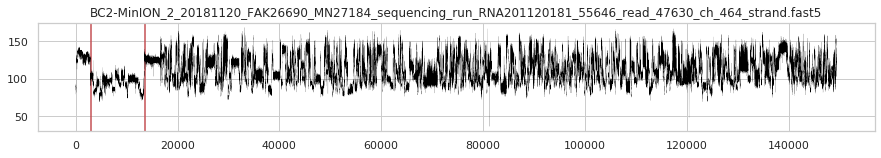

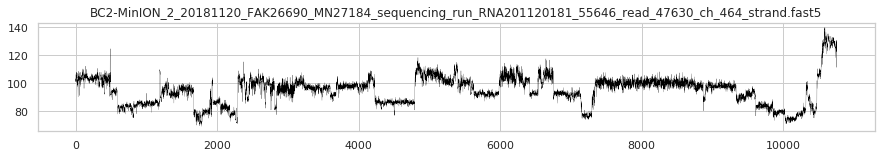

1.3890998363494873  seconds


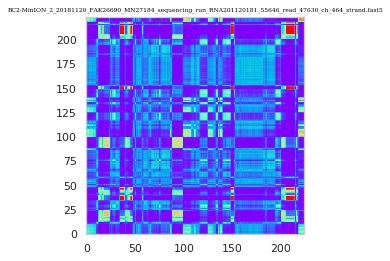

2.4922585487365723  seconds


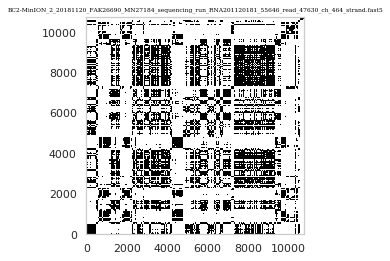

difference
0.006873607635498047  seconds


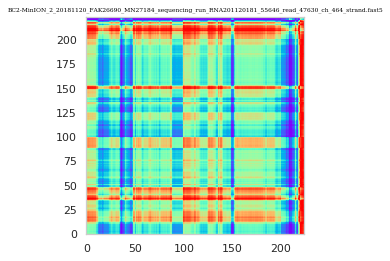

summation
0.008247137069702148  seconds


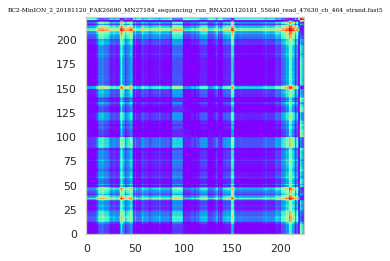

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47634_ch_501_strand.fast5


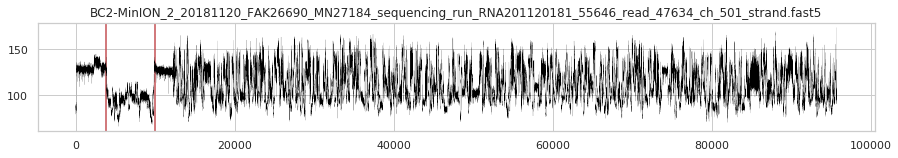

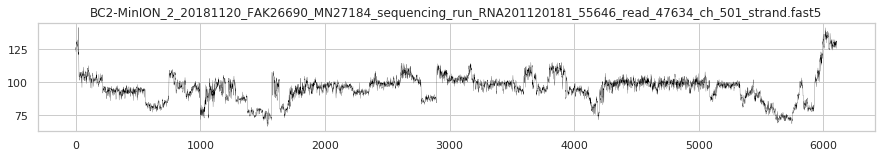

0.3511807918548584  seconds


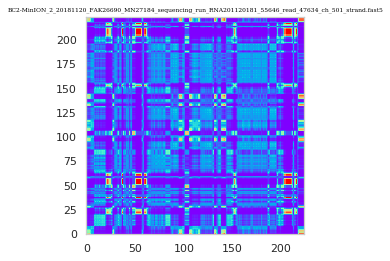

0.859123706817627  seconds


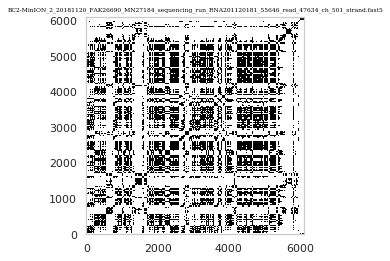

difference
0.0021610260009765625  seconds


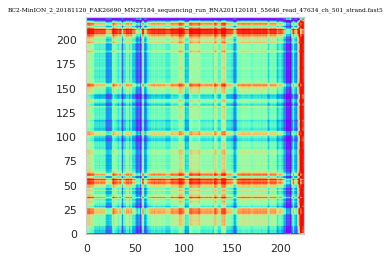

summation
0.002301931381225586  seconds


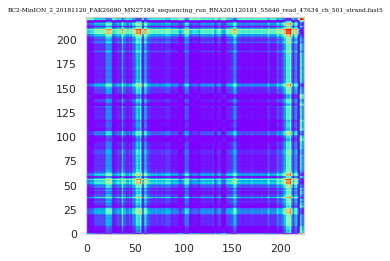

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47661_ch_489_strand.fast5


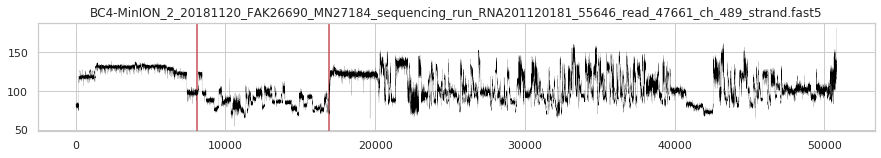

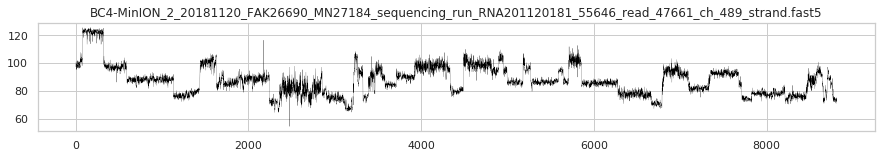

0.9117183685302734  seconds


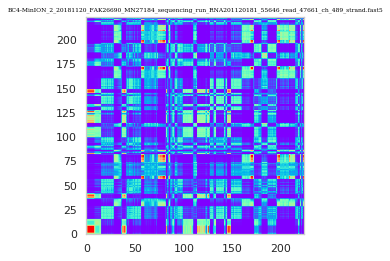

1.576024055480957  seconds


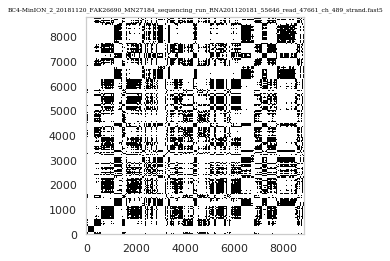

difference
0.0021660327911376953  seconds


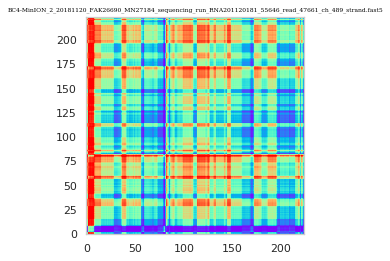

summation
0.0023832321166992188  seconds


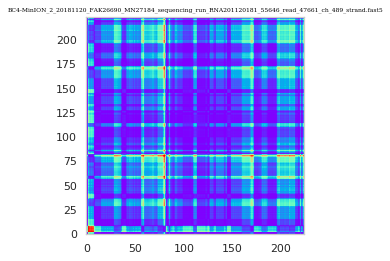

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47662_ch_412_strand.fast5


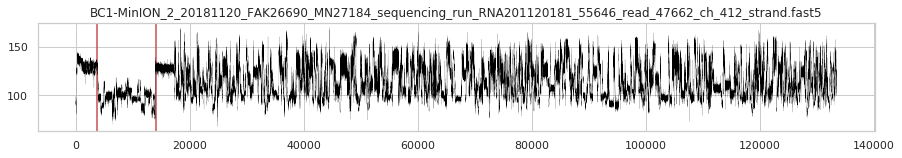

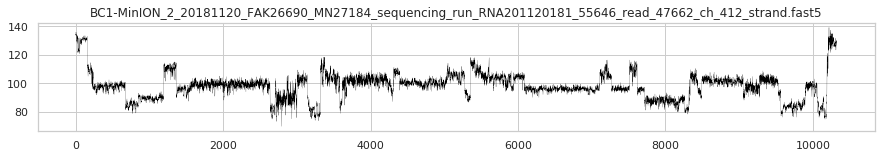

1.1620275974273682  seconds


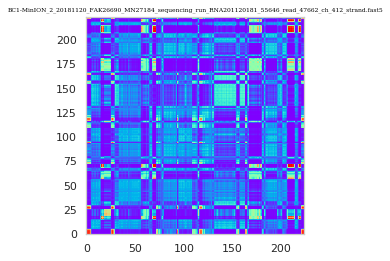

2.19325590133667  seconds


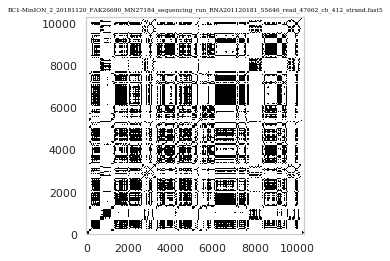

difference
0.005603790283203125  seconds


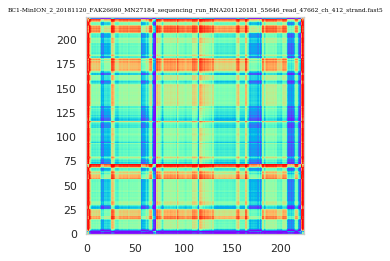

summation
0.009234905242919922  seconds


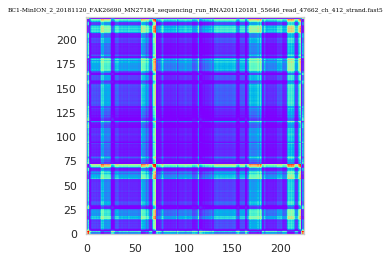

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47663_ch_474_strand.fast5


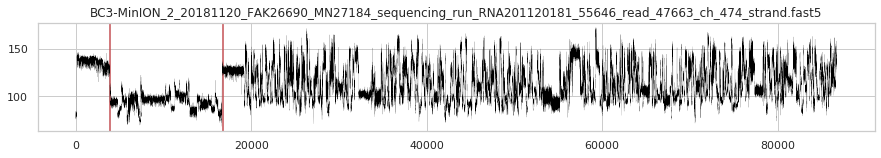

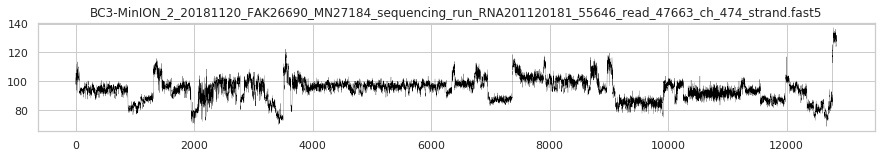

1.6117537021636963  seconds


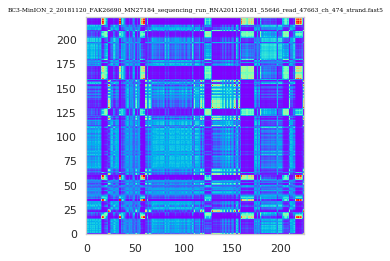

4.106885671615601  seconds


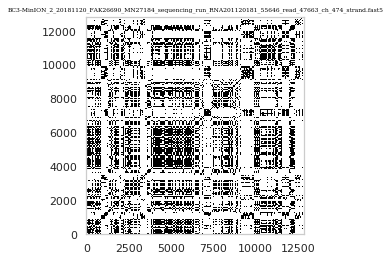

difference
0.0016307830810546875  seconds


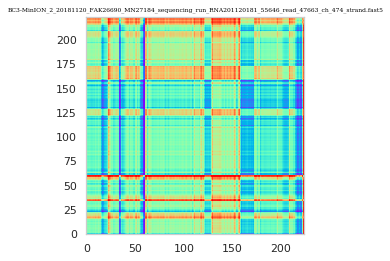

summation
0.0018193721771240234  seconds


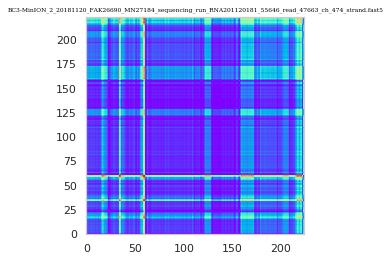

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47666_ch_474_strand.fast5


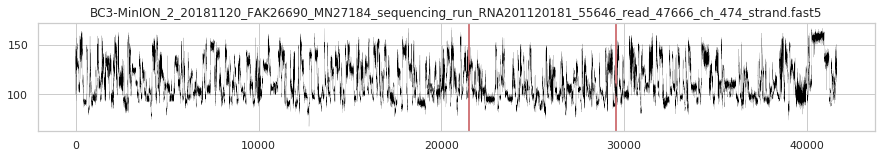

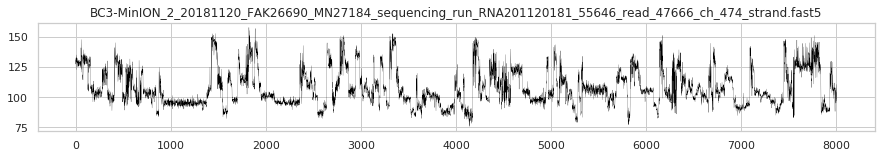

0.8099575042724609  seconds


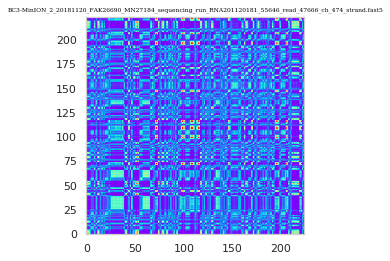

1.3964285850524902  seconds


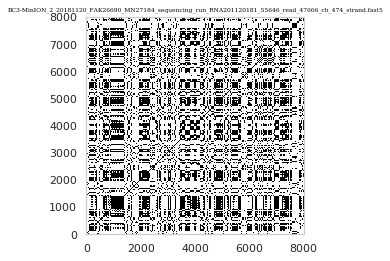

difference
0.005548238754272461  seconds


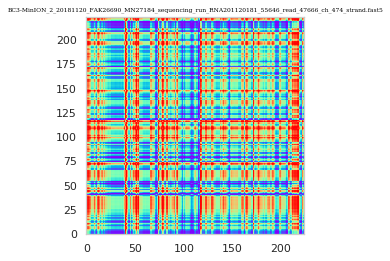

summation
0.002142667770385742  seconds


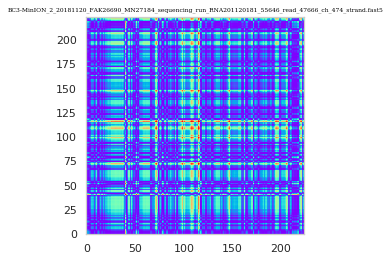

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47666_ch_489_strand.fast5


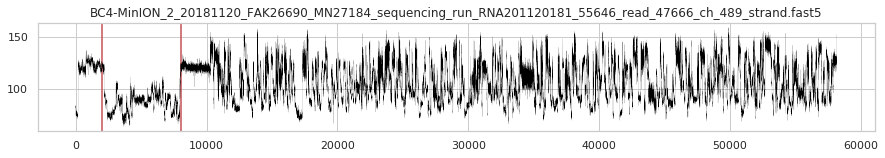

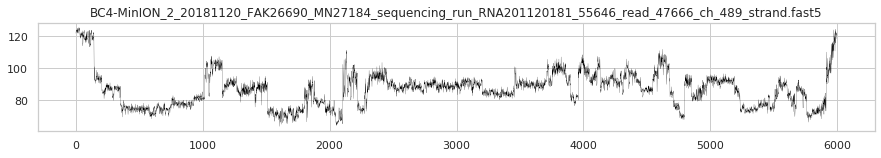

0.3496105670928955  seconds


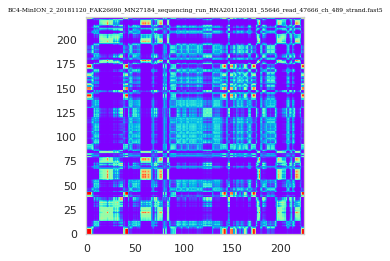

0.8054964542388916  seconds


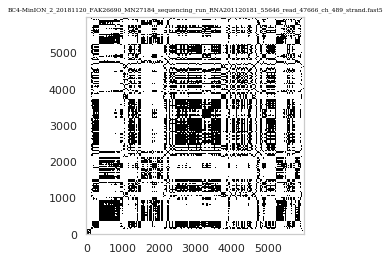

difference
0.00586700439453125  seconds


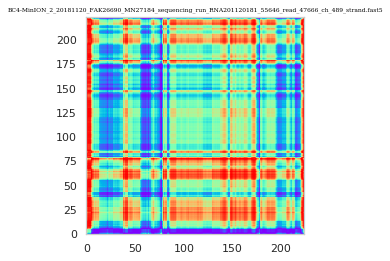

summation
0.009494781494140625  seconds


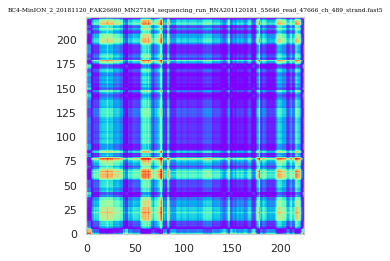

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47684_ch_376_strand.fast5


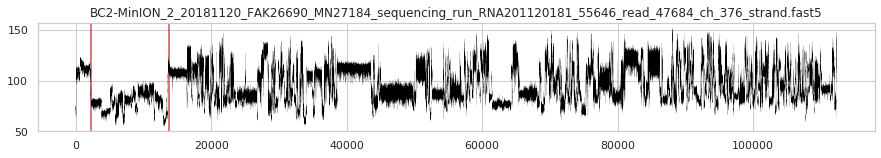

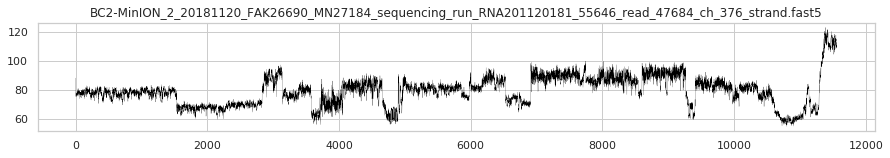

1.2547013759613037  seconds


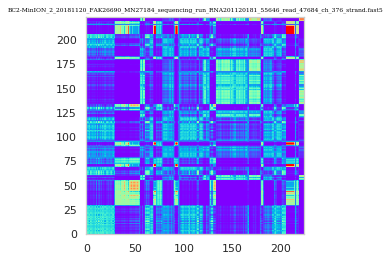

2.694859743118286  seconds


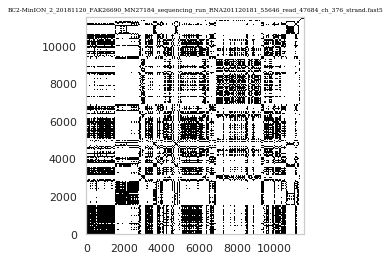

difference
0.005177974700927734  seconds


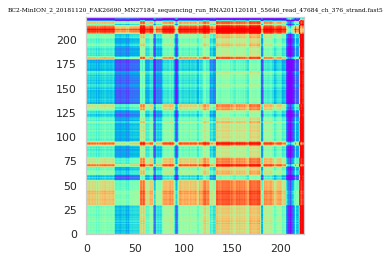

summation
0.00789189338684082  seconds


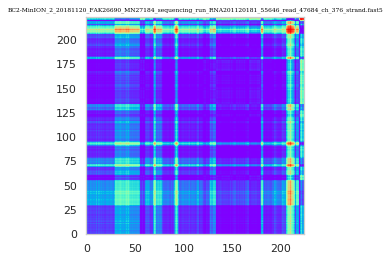

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47686_ch_376_strand.fast5


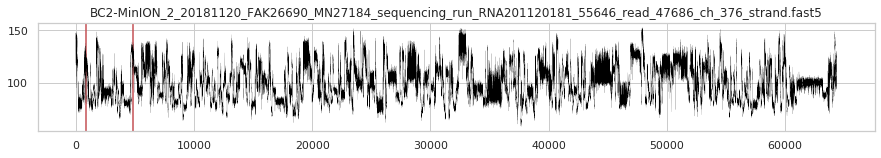

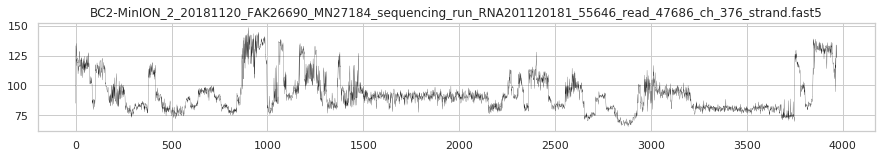

0.14315366744995117  seconds


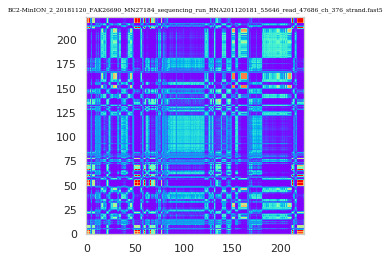

0.40226030349731445  seconds


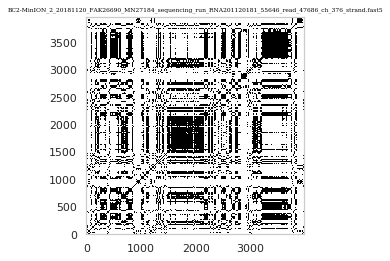

difference
0.04156827926635742  seconds


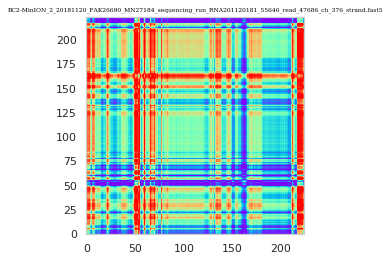

summation
0.006689786911010742  seconds


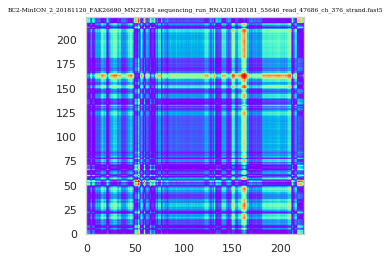

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47687_ch_380_strand.fast5


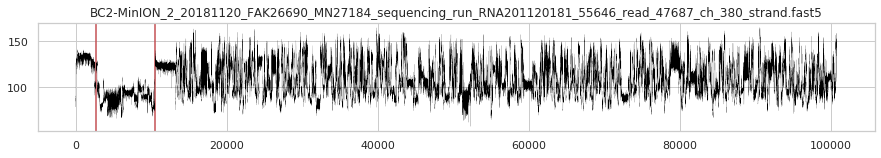

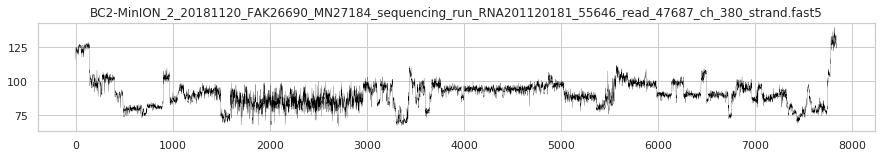

0.699286699295044  seconds


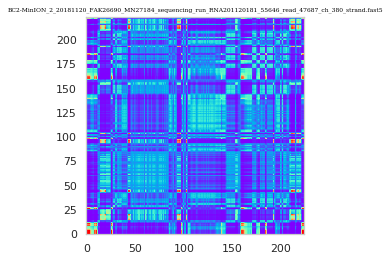

1.2275745868682861  seconds


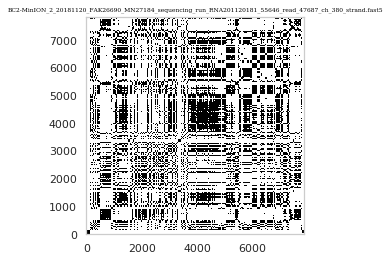

difference
0.004790544509887695  seconds


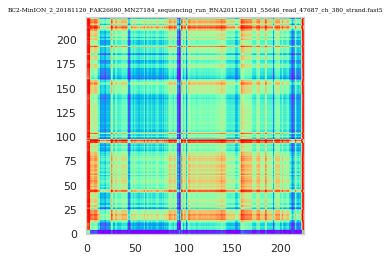

summation
0.0060672760009765625  seconds


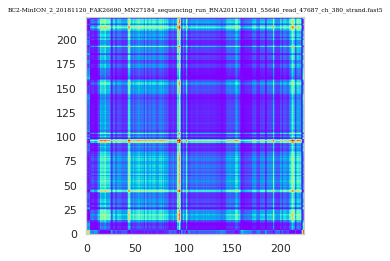

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47692_ch_464_strand.fast5


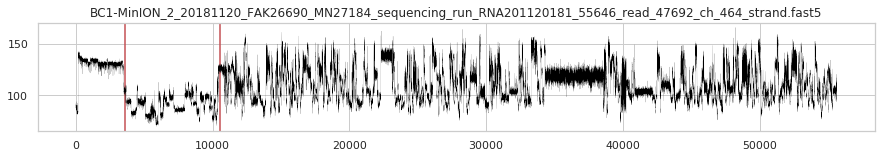

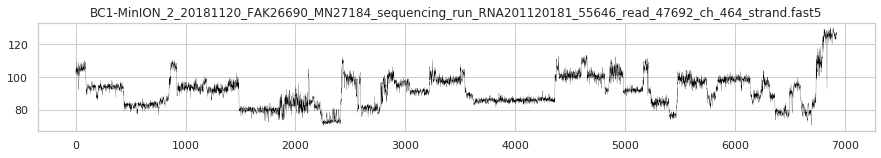

0.5631637573242188  seconds


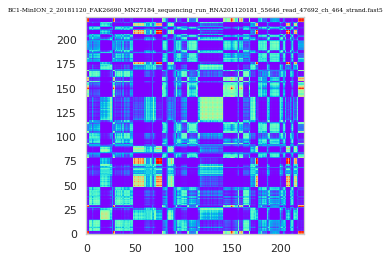

1.102193832397461  seconds


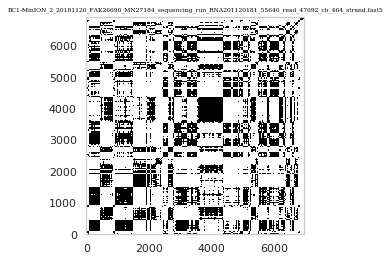

difference
0.0018129348754882812  seconds


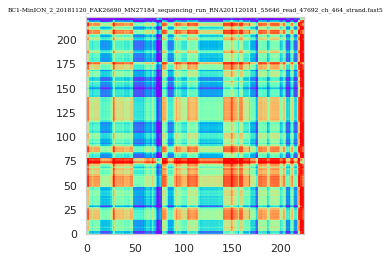

summation
0.007845163345336914  seconds


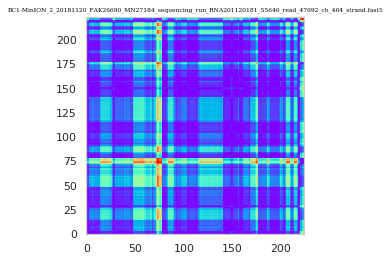

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47694_ch_474_strand.fast5


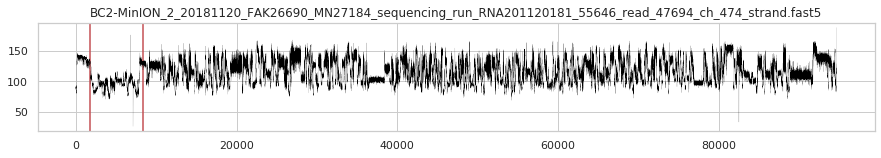

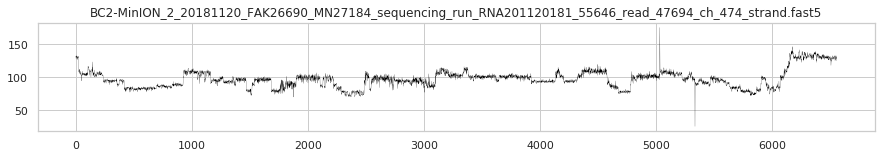

0.41031336784362793  seconds


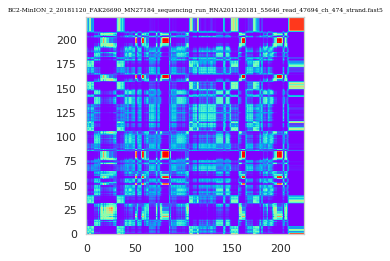

1.012666940689087  seconds


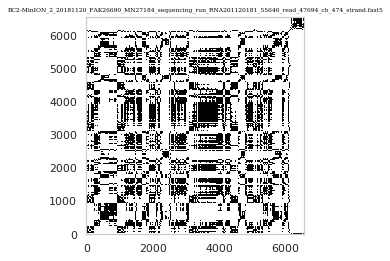

difference
0.004457235336303711  seconds


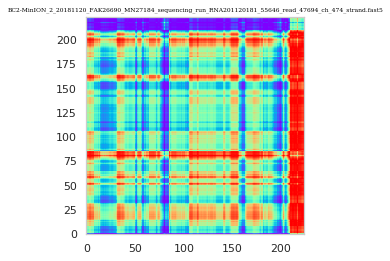

summation
0.008472442626953125  seconds


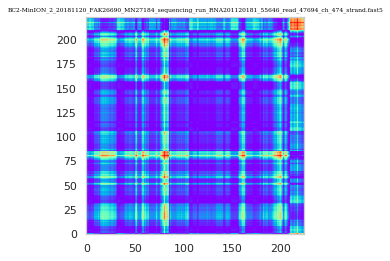

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47697_ch_420_strand.fast5


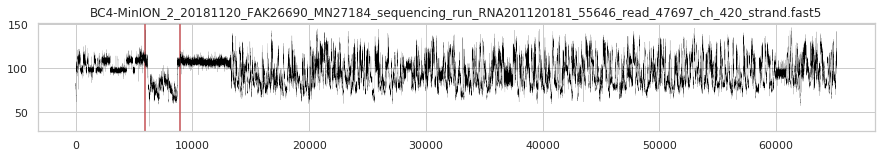

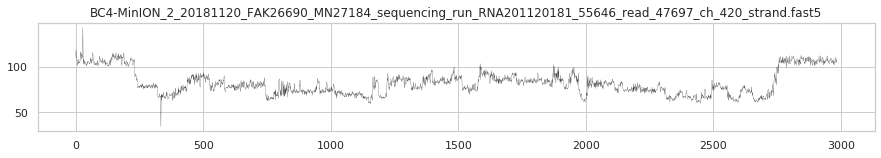

0.08643007278442383  seconds


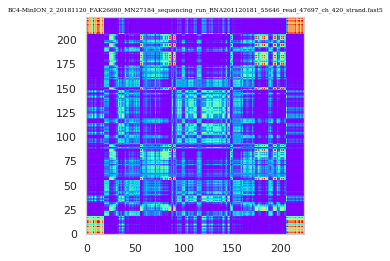

0.22060704231262207  seconds


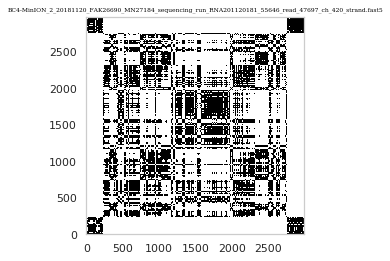

difference
0.0020296573638916016  seconds


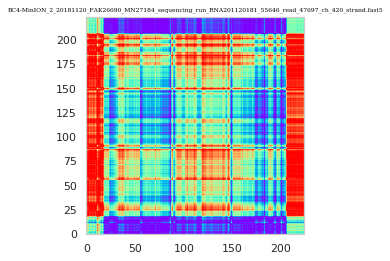

summation
0.0021626949310302734  seconds


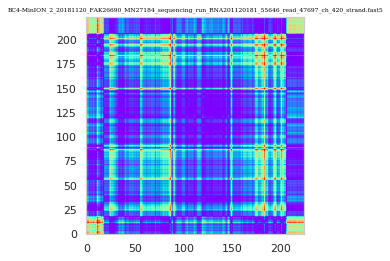

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47702_ch_390_strand.fast5


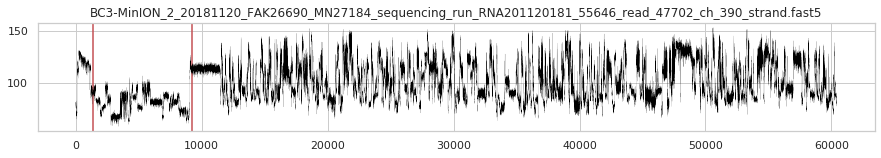

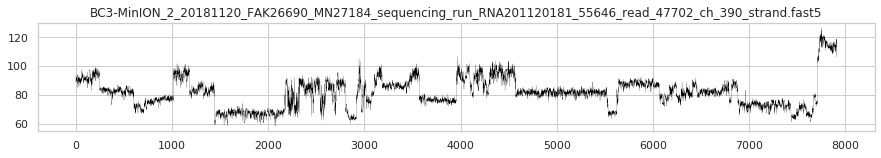

0.753725528717041  seconds


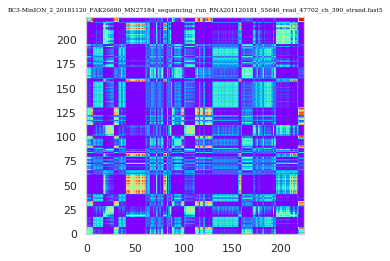

1.3927350044250488  seconds


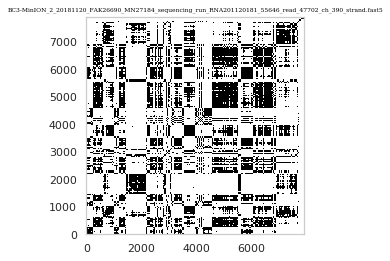

difference
0.005110263824462891  seconds


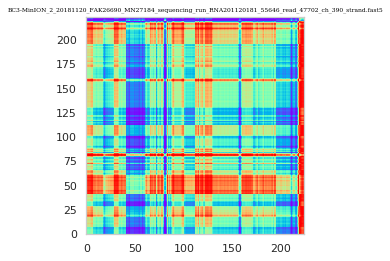

summation
0.007078886032104492  seconds


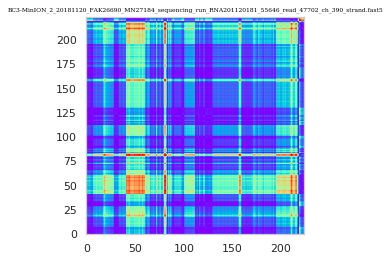

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47706_ch_167_strand.fast5


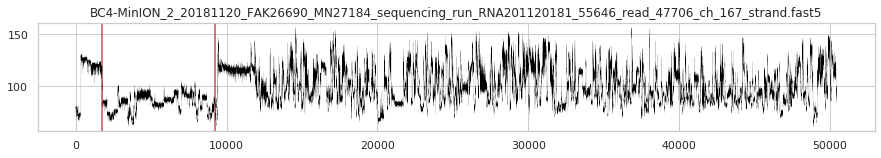

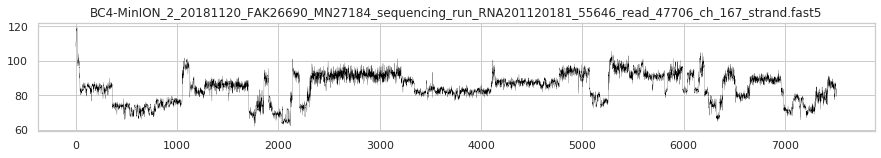

0.6186909675598145  seconds


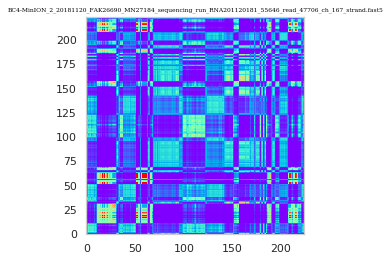

1.3799901008605957  seconds


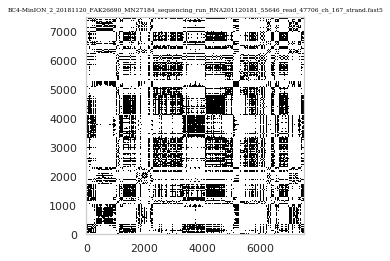

difference
0.004991054534912109  seconds


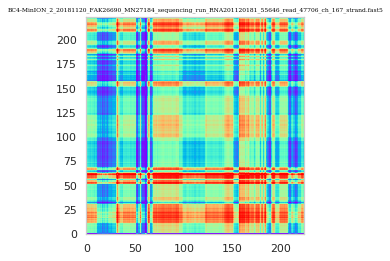

summation
0.002272367477416992  seconds


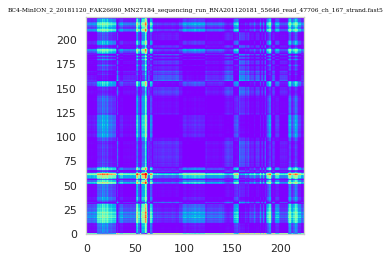

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47713_ch_464_strand.fast5


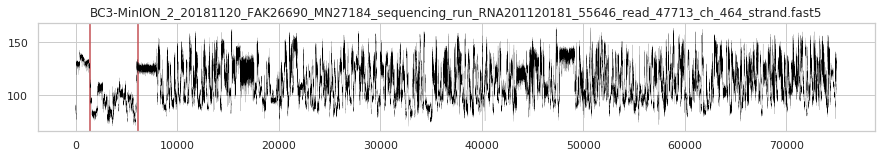

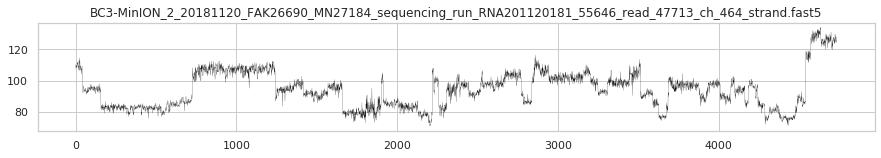

0.21129941940307617  seconds


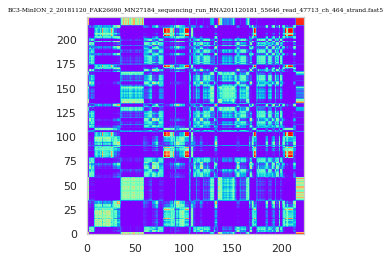

0.4774608612060547  seconds


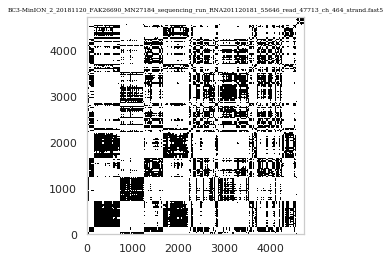

difference
0.0020024776458740234  seconds


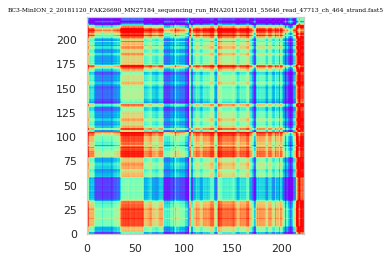

summation
0.0018014907836914062  seconds


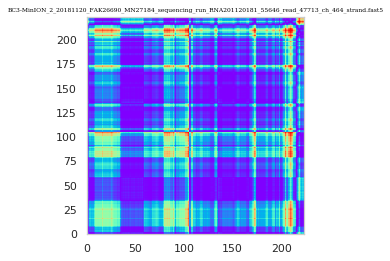

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47723_ch_182_strand.fast5


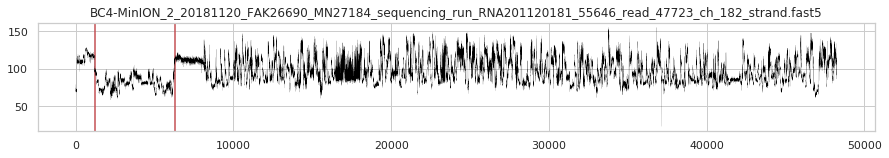

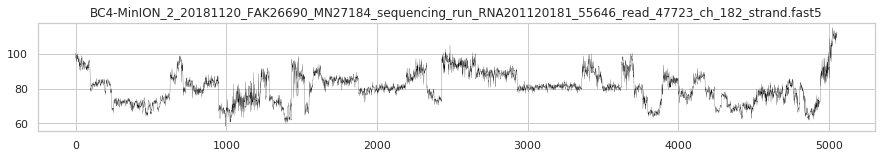

0.23716354370117188  seconds


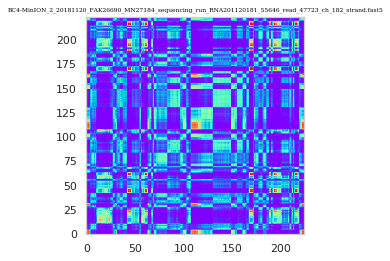

0.6306626796722412  seconds


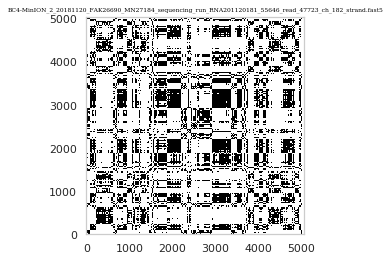

difference
0.005335092544555664  seconds


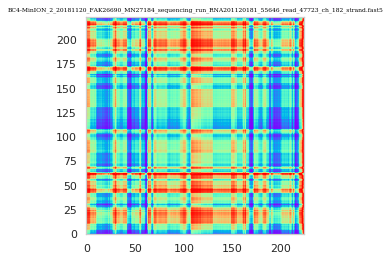

summation
0.009531974792480469  seconds


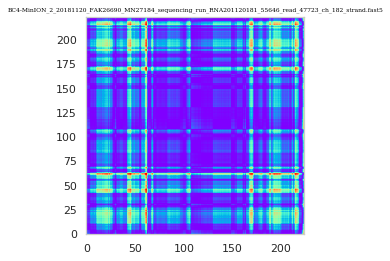

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47732_ch_167_strand.fast5


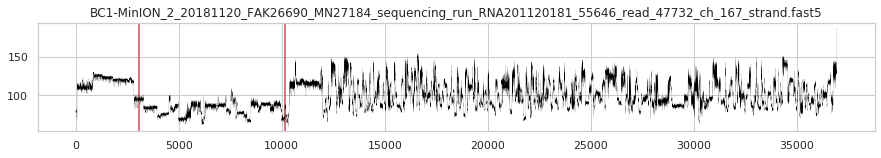

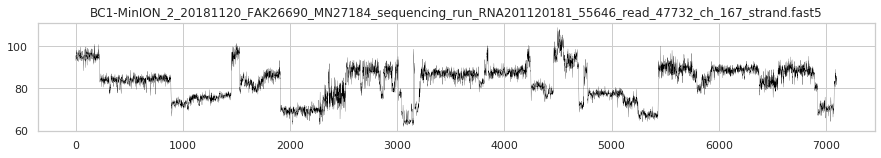

0.5833196640014648  seconds


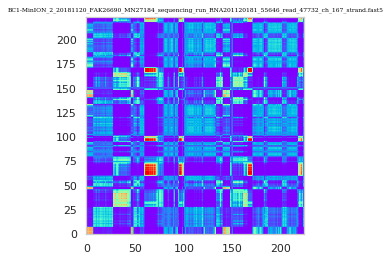

0.9521443843841553  seconds


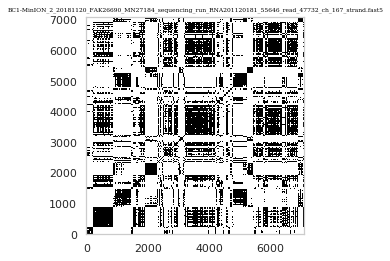

difference
0.0042722225189208984  seconds


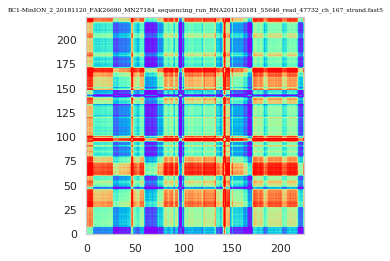

summation
0.005646944046020508  seconds


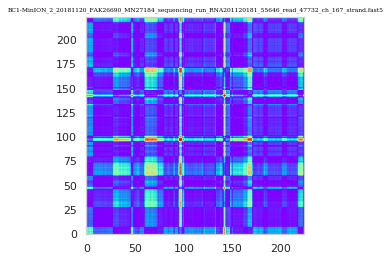

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47744_ch_464_strand.fast5


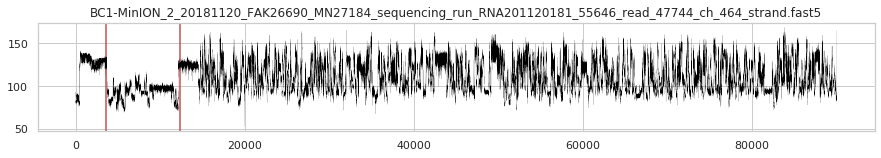

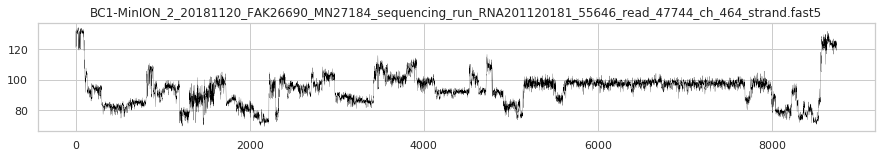

0.9304513931274414  seconds


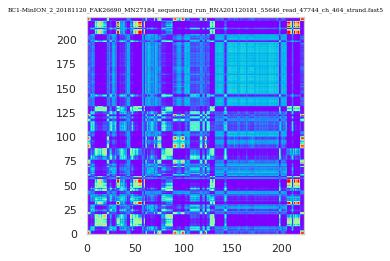

1.5976269245147705  seconds


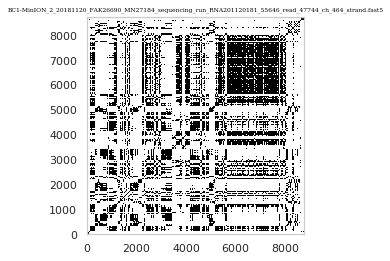

difference
0.0051424503326416016  seconds


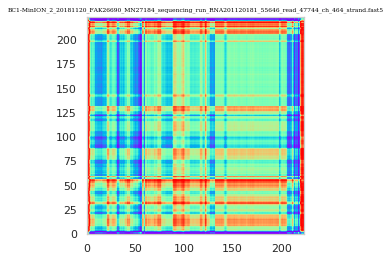

summation
0.006742000579833984  seconds


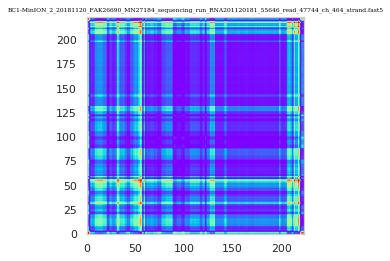

Reading: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_47756_ch_420_strand.fast5


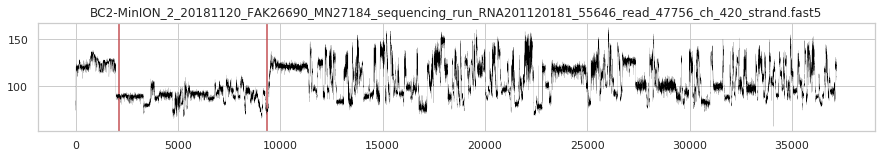

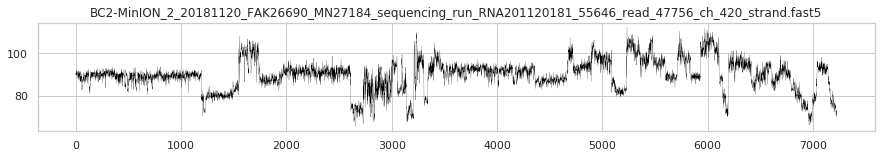

0.6278836727142334  seconds


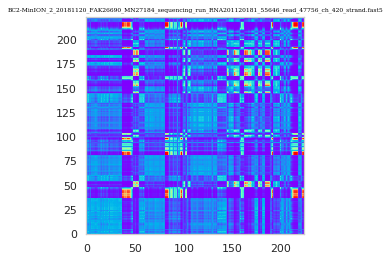

1.2367699146270752  seconds


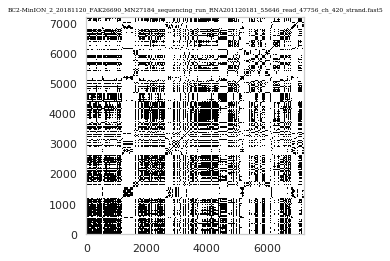

difference
0.0050084590911865234  seconds


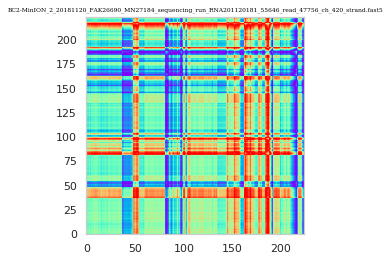

summation
0.008653879165649414  seconds


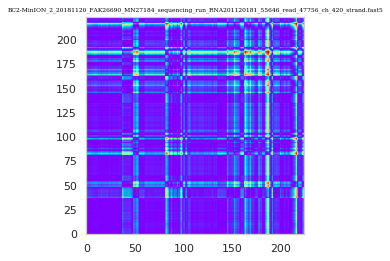

0.2725074291229248  seconds
0.620258092880249  seconds
difference
0.0030426979064941406  seconds
summation
0.0013172626495361328  seconds
0.12837433815002441  seconds
0.3187835216522217  seconds
difference
0.002671957015991211  seconds
summation
0.001352548599243164  seconds
0.21402192115783691  seconds
0.4369347095489502  seconds
difference
0.002803325653076172  seconds
summation
0.0016298294067382812  seconds
0.2523307800292969  seconds
0.5309293270111084  seconds
difference
0.002777099609375  seconds
summation
0.0016508102416992188  seconds
0.21553492546081543  seconds
0.4324071407318115  seconds
difference
0.0024261474609375  seconds
summation
0.001495361328125  seconds
0.5128500461578369  seconds
1.0042202472686768  seconds
difference
0.019368648529052734  seconds
summation
0.0012366771697998047  seconds
0.2556266784667969  seconds
0.5552957057952881  seconds
difference
0.002753019332885742  seconds
summation
0.0014355182647705078  seconds
1.108510971069336  seconds
1.682427167892

0.2732861042022705  seconds
difference
0.0027480125427246094  seconds
summation
0.0063018798828125  seconds
0.9195630550384521  seconds
1.3262951374053955  seconds
difference
0.0028107166290283203  seconds
summation
0.0016391277313232422  seconds
1.1371047496795654  seconds
1.9010727405548096  seconds
difference
0.0032236576080322266  seconds
summation
0.002127408981323242  seconds
0.1321580410003662  seconds
0.3253002166748047  seconds
difference
0.002633810043334961  seconds
summation
0.0011272430419921875  seconds
0.49527430534362793  seconds
0.9782571792602539  seconds
difference
0.0030372142791748047  seconds
summation
0.0016498565673828125  seconds
1.404517650604248  seconds
2.4310202598571777  seconds
difference
0.0028150081634521484  seconds
summation
0.001928091049194336  seconds
0.20748043060302734  seconds
0.40602779388427734  seconds
difference
0.002529621124267578  seconds
summation
0.0010116100311279297  seconds
1.2923312187194824  seconds
2.098114490509033  seconds
diffe

0.28999948501586914  seconds
0.5514876842498779  seconds
difference
0.002444028854370117  seconds
summation
0.0015730857849121094  seconds
0.7150239944458008  seconds
1.5039937496185303  seconds
difference
0.0028629302978515625  seconds
summation
0.0017206668853759766  seconds
1.6227810382843018  seconds
3.0548174381256104  seconds
difference
0.0026023387908935547  seconds
summation
0.0020856857299804688  seconds
0.8654587268829346  seconds
1.6971924304962158  seconds
difference
0.00853729248046875  seconds
summation
0.0015790462493896484  seconds
2.641932964324951  seconds
4.450879096984863  seconds
difference
0.003285646438598633  seconds
summation
0.0025315284729003906  seconds
0.7256786823272705  seconds
1.351830244064331  seconds
difference
0.008777379989624023  seconds
summation
0.0016477108001708984  seconds
1.5499985218048096  seconds
2.6133382320404053  seconds
difference
0.0031523704528808594  seconds
summation
0.0016362667083740234  seconds
0.27017807960510254  seconds
0.605

0.5111031532287598  seconds
difference
0.0027396678924560547  seconds
summation
0.001432657241821289  seconds
0.8424131870269775  seconds
1.4748406410217285  seconds
difference
0.010811805725097656  seconds
summation
0.002007007598876953  seconds
0.5991613864898682  seconds
1.1585440635681152  seconds
difference
0.0028231143951416016  seconds
summation
0.0015251636505126953  seconds
1.5157239437103271  seconds
2.5769708156585693  seconds
difference
0.0031120777130126953  seconds
summation
0.00208282470703125  seconds
0.10264325141906738  seconds
0.26860690116882324  seconds
difference
0.0026559829711914062  seconds
summation
0.0013222694396972656  seconds
0.866734504699707  seconds
1.5265390872955322  seconds
difference
0.002650737762451172  seconds
summation
0.0019609928131103516  seconds
0.17700934410095215  seconds
0.383331298828125  seconds
difference
0.002763509750366211  seconds
summation
0.0016102790832519531  seconds
0.4310770034790039  seconds
1.0719289779663086  seconds
diffe

1.7477436065673828  seconds
3.05336332321167  seconds
difference
0.010650873184204102  seconds
summation
0.0019714832305908203  seconds
0.5725786685943604  seconds
1.0311262607574463  seconds
difference
0.003072023391723633  seconds
summation
0.001836538314819336  seconds
0.15976810455322266  seconds
0.27532243728637695  seconds
difference
0.0026748180389404297  seconds
summation
0.0015034675598144531  seconds
2.10504150390625  seconds
3.756002187728882  seconds
difference
0.003263235092163086  seconds
summation
0.0022726058959960938  seconds
0.5454332828521729  seconds
1.2575430870056152  seconds
difference
0.0028848648071289062  seconds
summation
0.0015826225280761719  seconds
2.5438530445098877  seconds
4.341294527053833  seconds
difference
0.003288745880126953  seconds
summation
0.001993894577026367  seconds
0.31243395805358887  seconds
0.5436844825744629  seconds
difference
0.0028154850006103516  seconds
summation
0.0014843940734863281  seconds
0.4495406150817871  seconds
1.000213

1.4542908668518066  seconds
3.0950706005096436  seconds
difference
0.005177021026611328  seconds
summation
0.0020520687103271484  seconds
1.2449629306793213  seconds
1.9961357116699219  seconds
difference
0.0029783248901367188  seconds
summation
0.002117156982421875  seconds
1.7391111850738525  seconds
3.303041696548462  seconds
difference
0.003145456314086914  seconds
summation
0.0030698776245117188  seconds
1.5011353492736816  seconds
2.709219217300415  seconds
difference
0.0031244754791259766  seconds
summation
0.001987457275390625  seconds
0.2692844867706299  seconds
0.5616288185119629  seconds
difference
0.004998445510864258  seconds
summation
0.0015988349914550781  seconds
0.3170349597930908  seconds
0.5970325469970703  seconds
difference
0.0029201507568359375  seconds
summation
0.0015399456024169922  seconds
0.2695329189300537  seconds
0.5258080959320068  seconds
difference
0.0029239654541015625  seconds
summation
0.0015330314636230469  seconds
0.0884711742401123  seconds
0.1745

0.26375269889831543  seconds
0.5732419490814209  seconds
difference
0.0024149417877197266  seconds
summation
0.0014057159423828125  seconds
0.5326108932495117  seconds
1.107684850692749  seconds
difference
0.0030508041381835938  seconds
summation
0.00206756591796875  seconds
0.12413835525512695  seconds
0.2986288070678711  seconds
difference
0.002736330032348633  seconds
summation
0.0013782978057861328  seconds
2.1355583667755127  seconds
3.888517141342163  seconds
difference
0.003244161605834961  seconds
summation
0.0022802352905273438  seconds
2.0623831748962402  seconds
3.4644219875335693  seconds
difference
0.0025777816772460938  seconds
summation
0.0018284320831298828  seconds
0.16548848152160645  seconds
0.3557455539703369  seconds
difference
0.0026721954345703125  seconds
summation
0.0014622211456298828  seconds
0.29598402976989746  seconds
0.6845791339874268  seconds
difference
0.010222196578979492  seconds
summation
0.0015442371368408203  seconds
0.21702814102172852  seconds
0

0.2478961944580078  seconds
0.5288777351379395  seconds
difference
0.0026950836181640625  seconds
summation
0.0013661384582519531  seconds
0.14533567428588867  seconds
0.2398221492767334  seconds
difference
0.002802133560180664  seconds
summation
0.0015316009521484375  seconds
0.4913136959075928  seconds
0.9222192764282227  seconds
difference
0.0030684471130371094  seconds
summation
0.0018780231475830078  seconds
1.3157761096954346  seconds
2.1562623977661133  seconds
difference
0.010641813278198242  seconds
summation
0.0021431446075439453  seconds
0.12309551239013672  seconds
0.2872762680053711  seconds
difference
0.0026977062225341797  seconds
summation
0.001569509506225586  seconds
0.54667067527771  seconds
1.1798076629638672  seconds
difference
0.002981424331665039  seconds
summation
0.0019023418426513672  seconds
1.7173881530761719  seconds
2.8967347145080566  seconds
difference
0.002932310104370117  seconds
summation
0.002348661422729492  seconds
0.11969256401062012  seconds
0.24

0.9375655651092529  seconds
1.39210844039917  seconds
difference
0.00238800048828125  seconds
summation
0.001466512680053711  seconds
0.298215389251709  seconds
0.7090165615081787  seconds
difference
0.002646923065185547  seconds
summation
0.0013318061828613281  seconds
0.2972991466522217  seconds
0.7538011074066162  seconds
difference
0.003161907196044922  seconds
summation
0.0016765594482421875  seconds
3.531688690185547  seconds
5.586467504501343  seconds
difference
0.0033271312713623047  seconds
summation
0.0015194416046142578  seconds
1.019669771194458  seconds
1.8356454372406006  seconds
difference
0.006738185882568359  seconds
summation
0.0017774105072021484  seconds
0.28310513496398926  seconds
0.75901198387146  seconds
difference
0.003106832504272461  seconds
summation
0.0016887187957763672  seconds
0.31711411476135254  seconds
0.7084786891937256  seconds
difference
0.002658843994140625  seconds
summation
0.0016179084777832031  seconds
2.0660252571105957  seconds
3.77177929878

0.4236423969268799  seconds
0.8496284484863281  seconds
difference
0.010579824447631836  seconds
summation
0.0018639564514160156  seconds
0.6426012516021729  seconds
1.131641149520874  seconds
difference
0.0027260780334472656  seconds
summation
0.001756429672241211  seconds
0.34053754806518555  seconds
0.8453612327575684  seconds
difference
0.0031218528747558594  seconds
summation
0.0018267631530761719  seconds
0.4143521785736084  seconds
0.8628726005554199  seconds
difference
0.0029213428497314453  seconds
summation
0.001674652099609375  seconds
0.3069429397583008  seconds
0.8095705509185791  seconds
difference
0.015609979629516602  seconds
summation
0.001790761947631836  seconds
0.20181751251220703  seconds
0.3630208969116211  seconds
difference
0.0028951168060302734  seconds
summation
0.0013041496276855469  seconds
0.8741450309753418  seconds
1.5369677543640137  seconds
difference
0.010649442672729492  seconds
summation
0.0020096302032470703  seconds
1.4591379165649414  seconds
2.45

0.25266456604003906  seconds
0.5745284557342529  seconds
difference
0.002376556396484375  seconds
summation
0.0013890266418457031  seconds
0.34311890602111816  seconds
0.7591536045074463  seconds
difference
0.002367734909057617  seconds
summation
0.001621246337890625  seconds
0.2859489917755127  seconds
0.6734905242919922  seconds
difference
0.0022842884063720703  seconds
summation
0.0013849735260009766  seconds
0.9920990467071533  seconds
2.0151209831237793  seconds
difference
0.002973794937133789  seconds
summation
0.002062559127807617  seconds
0.25631260871887207  seconds
0.5577735900878906  seconds
difference
0.00394892692565918  seconds
summation
0.001142740249633789  seconds
0.2762725353240967  seconds
0.6818685531616211  seconds
difference
0.002913236618041992  seconds
summation
0.0016293525695800781  seconds
0.673591136932373  seconds
1.2171173095703125  seconds
difference
0.020911216735839844  seconds
summation
0.0019173622131347656  seconds
0.8172397613525391  seconds
1.87402

1.4386839866638184  seconds
2.5157437324523926  seconds
difference
0.002593517303466797  seconds
summation
0.0015914440155029297  seconds
1.4076604843139648  seconds
2.1724355220794678  seconds
difference
0.003497600555419922  seconds
summation
0.002096891403198242  seconds
0.08954215049743652  seconds
0.22935199737548828  seconds
difference
0.005525827407836914  seconds
summation
0.0027916431427001953  seconds
0.2158658504486084  seconds
0.5036115646362305  seconds
difference
0.0031006336212158203  seconds
summation
0.0014796257019042969  seconds
0.9586954116821289  seconds
1.7848598957061768  seconds
difference
0.01055598258972168  seconds
summation
0.0021643638610839844  seconds
0.9279754161834717  seconds
1.5629518032073975  seconds
difference
0.008924722671508789  seconds
summation
0.0016739368438720703  seconds
0.495938777923584  seconds
1.0589749813079834  seconds
difference
0.003012418746948242  seconds
summation
0.0014760494232177734  seconds
0.39068102836608887  seconds
0.878

0.9266715049743652  seconds
1.7535841464996338  seconds
difference
0.0027976036071777344  seconds
summation
0.001672506332397461  seconds
0.277848482131958  seconds
0.5728275775909424  seconds
difference
0.0030205249786376953  seconds
summation
0.001611948013305664  seconds
1.1071465015411377  seconds
1.7227671146392822  seconds
difference
0.002820730209350586  seconds
summation
0.0016674995422363281  seconds
0.3485398292541504  seconds
0.71872878074646  seconds
difference
0.0030896663665771484  seconds
summation
0.00164031982421875  seconds
1.2849383354187012  seconds
2.0760598182678223  seconds
difference
0.005036354064941406  seconds
summation
0.0013155937194824219  seconds
0.3629021644592285  seconds
0.874366044998169  seconds
difference
0.0026226043701171875  seconds
summation
0.0017428398132324219  seconds
0.4392414093017578  seconds
1.027278184890747  seconds
difference
0.003151416778564453  seconds
summation
0.0019643306732177734  seconds
0.2806556224822998  seconds
0.696820735

0.14373016357421875  seconds
0.3238551616668701  seconds
difference
0.0026862621307373047  seconds
summation
0.0015904903411865234  seconds
0.16127443313598633  seconds
0.3751387596130371  seconds
difference
0.002846240997314453  seconds
summation
0.001600503921508789  seconds
0.7312681674957275  seconds
1.1695034503936768  seconds
difference
0.010415077209472656  seconds
summation
0.0017478466033935547  seconds
0.7952516078948975  seconds
1.4823050498962402  seconds
difference
0.0030329227447509766  seconds
summation
0.002124309539794922  seconds
0.27497005462646484  seconds
0.5762906074523926  seconds
difference
0.0030813217163085938  seconds
summation
0.0017240047454833984  seconds
0.3405938148498535  seconds
0.8059110641479492  seconds
difference
0.0027451515197753906  seconds
summation
0.0018780231475830078  seconds
1.2800955772399902  seconds
2.2672297954559326  seconds
difference
0.006689548492431641  seconds
summation
0.0019457340240478516  seconds
4.3264453411102295  seconds
8

0.12371635437011719  seconds
0.2610311508178711  seconds
difference
0.002477884292602539  seconds
summation
0.001474142074584961  seconds
0.27017688751220703  seconds
0.5990033149719238  seconds
difference
0.0028562545776367188  seconds
summation
0.0017070770263671875  seconds
1.2986042499542236  seconds
2.196422815322876  seconds
difference
0.0031900405883789062  seconds
summation
0.0020940303802490234  seconds
0.7047567367553711  seconds
1.1743638515472412  seconds
difference
0.0053746700286865234  seconds
summation
0.0015301704406738281  seconds
0.7029683589935303  seconds
1.3067255020141602  seconds
difference
0.002847433090209961  seconds
summation
0.001682281494140625  seconds
0.2562284469604492  seconds
0.5677871704101562  seconds
difference
0.0028879642486572266  seconds
summation
0.001619577407836914  seconds
0.7534728050231934  seconds
1.431438684463501  seconds
difference
0.010518789291381836  seconds
summation
0.001786947250366211  seconds
0.86250901222229  seconds
1.569728

1.289762258529663  seconds
2.383815288543701  seconds
difference
0.002846240997314453  seconds
summation
0.0017635822296142578  seconds
3.147613286972046  seconds
4.801658868789673  seconds
difference
0.0028083324432373047  seconds
summation
0.002247333526611328  seconds
0.5987818241119385  seconds
1.2070941925048828  seconds
difference
0.010504484176635742  seconds
summation
0.0016756057739257812  seconds
0.4174525737762451  seconds
0.9360861778259277  seconds
difference
0.002857685089111328  seconds
summation
0.0018162727355957031  seconds
0.26768946647644043  seconds
0.5617687702178955  seconds
difference
0.002420663833618164  seconds
summation
0.0014209747314453125  seconds
0.3042476177215576  seconds
0.6914031505584717  seconds
difference
0.002628803253173828  seconds
summation
0.0017743110656738281  seconds
0.32010316848754883  seconds
0.7065212726593018  seconds
difference
0.002959728240966797  seconds
summation
0.001556396484375  seconds
0.6486108303070068  seconds
1.1414675712

0.35776495933532715  seconds
0.7535123825073242  seconds
difference
0.007959604263305664  seconds
summation
0.0019152164459228516  seconds
0.4112577438354492  seconds
0.8806383609771729  seconds
difference
0.002955913543701172  seconds
summation
0.0018646717071533203  seconds
0.15181779861450195  seconds
0.2825431823730469  seconds
difference
0.002569437026977539  seconds
summation
0.0013484954833984375  seconds
0.368804931640625  seconds
0.9048252105712891  seconds
difference
0.003916501998901367  seconds
summation
0.0017616748809814453  seconds
1.0725204944610596  seconds
1.43397855758667  seconds
difference
0.0029070377349853516  seconds
summation
0.002334117889404297  seconds
0.19027042388916016  seconds
0.3794584274291992  seconds
difference
0.002767801284790039  seconds
summation
0.001737356185913086  seconds
1.4098732471466064  seconds
2.5453603267669678  seconds
difference
0.004860877990722656  seconds
summation
0.0018050670623779297  seconds
0.6760237216949463  seconds
1.13764

0.8631048202514648  seconds
1.6428565979003906  seconds
difference
0.002547740936279297  seconds
summation
0.0019555091857910156  seconds
0.39736366271972656  seconds
0.9947183132171631  seconds
difference
0.003072977066040039  seconds
summation
0.0017654895782470703  seconds
0.27693605422973633  seconds
0.6616392135620117  seconds
difference
0.0022559165954589844  seconds
summation
0.0015451908111572266  seconds
0.2135775089263916  seconds
0.4787759780883789  seconds
difference
0.0024347305297851562  seconds
summation
0.0014913082122802734  seconds
0.3229835033416748  seconds
0.7948617935180664  seconds
difference
0.0027234554290771484  seconds
summation
0.0017900466918945312  seconds
1.971817970275879  seconds
3.572873592376709  seconds
difference
0.0031502246856689453  seconds
summation
0.002239227294921875  seconds
0.853243350982666  seconds
1.4690630435943604  seconds
difference
0.010561227798461914  seconds
summation
0.001874685287475586  seconds
0.1784963607788086  seconds
0.325

0.16495037078857422  seconds
difference
0.002884387969970703  seconds
summation
0.0021283626556396484  seconds
0.4750790596008301  seconds
0.9769947528839111  seconds
difference
0.0030410289764404297  seconds
summation
0.0019290447235107422  seconds
0.3957056999206543  seconds
0.9270479679107666  seconds
difference
0.003199338912963867  seconds
summation
0.002049684524536133  seconds
1.3430743217468262  seconds
2.110049247741699  seconds
difference
0.010425567626953125  seconds
summation
0.0014941692352294922  seconds
1.9133493900299072  seconds
3.311509132385254  seconds
difference
0.002916574478149414  seconds
summation
0.0016217231750488281  seconds
0.40910816192626953  seconds
1.0085265636444092  seconds
difference
0.003406047821044922  seconds
summation
0.0017347335815429688  seconds
0.9691176414489746  seconds
1.5499489307403564  seconds
difference
0.01209402084350586  seconds
summation
0.0015594959259033203  seconds
0.25281453132629395  seconds
0.6317610740661621  seconds
differ

0.21759653091430664  seconds
0.4504382610321045  seconds
difference
0.002475738525390625  seconds
summation
0.001142263412475586  seconds
0.2773897647857666  seconds
0.6066892147064209  seconds
difference
0.002733945846557617  seconds
summation
0.0014317035675048828  seconds
1.0196328163146973  seconds
1.4786348342895508  seconds
difference
0.0031380653381347656  seconds
summation
0.0019452571868896484  seconds
0.27803564071655273  seconds
0.5473449230194092  seconds
difference
0.0043871402740478516  seconds
summation
0.0016226768493652344  seconds
0.8783807754516602  seconds
1.631885290145874  seconds
difference
0.0029230117797851562  seconds
summation
0.002090930938720703  seconds
0.36240410804748535  seconds
0.7579166889190674  seconds
difference
0.003214597702026367  seconds
summation
0.0017158985137939453  seconds
1.2162113189697266  seconds
2.400956630706787  seconds
difference
0.00784921646118164  seconds
summation
0.0017669200897216797  seconds
0.1438145637512207  seconds
0.243

0.3517944812774658  seconds
0.7917020320892334  seconds
difference
0.003016948699951172  seconds
summation
0.001947164535522461  seconds
0.6614277362823486  seconds
1.2368028163909912  seconds
difference
0.011130571365356445  seconds
summation
0.002059459686279297  seconds
0.40024805068969727  seconds
0.8430616855621338  seconds
difference
0.006655216217041016  seconds
summation
0.001988649368286133  seconds
0.6712608337402344  seconds
1.2582552433013916  seconds
difference
0.003103494644165039  seconds
summation
0.002197742462158203  seconds
0.29099059104919434  seconds
0.6106154918670654  seconds
difference
0.0030503273010253906  seconds
summation
0.0022573471069335938  seconds
1.0435786247253418  seconds
1.8613154888153076  seconds
difference
0.003371000289916992  seconds
summation
0.0020940303802490234  seconds
3.000025987625122  seconds
4.539700984954834  seconds
difference
0.003316164016723633  seconds
summation
0.0019659996032714844  seconds
0.8500514030456543  seconds
1.3950333

0.6639840602874756  seconds
1.280367374420166  seconds
difference
0.003183126449584961  seconds
summation
0.0018622875213623047  seconds
0.2838747501373291  seconds
0.5364212989807129  seconds
difference
0.0031232833862304688  seconds
summation
0.001811981201171875  seconds
0.34133124351501465  seconds
0.8265295028686523  seconds
difference
0.003158092498779297  seconds
summation
0.0018837451934814453  seconds
0.4570162296295166  seconds
0.9383611679077148  seconds
difference
0.003154277801513672  seconds
summation
0.0019512176513671875  seconds
0.9972758293151855  seconds
1.878716230392456  seconds
difference
0.0054454803466796875  seconds
summation
0.0013594627380371094  seconds
0.26044559478759766  seconds
0.59842848777771  seconds
difference
0.003097057342529297  seconds
summation
0.0014421939849853516  seconds
0.4882969856262207  seconds
0.9848263263702393  seconds
difference
0.002435922622680664  seconds
summation
0.001705169677734375  seconds
0.5411388874053955  seconds
1.087540

0.9417901039123535  seconds
1.8013715744018555  seconds
difference
0.009426355361938477  seconds
summation
0.0013365745544433594  seconds
0.3368065357208252  seconds
0.7744147777557373  seconds
difference
0.0029129981994628906  seconds
summation
0.0015723705291748047  seconds
0.3107337951660156  seconds
0.6860778331756592  seconds
difference
0.0028505325317382812  seconds
summation
0.001554727554321289  seconds
0.4762716293334961  seconds
0.9109776020050049  seconds
difference
0.0029592514038085938  seconds
summation
0.0018565654754638672  seconds
0.3876926898956299  seconds
0.8048577308654785  seconds
difference
0.0031173229217529297  seconds
summation
0.001941680908203125  seconds
0.8567984104156494  seconds
1.3236103057861328  seconds
difference
0.008945465087890625  seconds
summation
0.0015668869018554688  seconds
0.9382383823394775  seconds
1.5821523666381836  seconds
difference
0.0023488998413085938  seconds
summation
0.0013782978057861328  seconds
0.4781205654144287  seconds
1.1

0.278759241104126  seconds
0.7015419006347656  seconds
difference
0.0028939247131347656  seconds
summation
0.0015864372253417969  seconds
0.19542312622070312  seconds
0.40868043899536133  seconds
difference
0.0024721622467041016  seconds
summation
0.0011076927185058594  seconds
1.1412842273712158  seconds
1.9177849292755127  seconds
difference
0.0027625560760498047  seconds
summation
0.001926422119140625  seconds
0.32654404640197754  seconds
0.721402645111084  seconds
difference
0.003044605255126953  seconds
summation
0.0019271373748779297  seconds
1.821563720703125  seconds
3.149285316467285  seconds
difference
0.002908468246459961  seconds
summation
0.001847982406616211  seconds
0.41307640075683594  seconds
0.9271509647369385  seconds
difference
0.0045087337493896484  seconds
summation
0.001550912857055664  seconds
0.21652650833129883  seconds
0.555800199508667  seconds
difference
0.004400014877319336  seconds
summation
0.0015418529510498047  seconds
2.786280632019043  seconds
3.7743

0.18038153648376465  seconds
0.4093773365020752  seconds
difference
0.0025348663330078125  seconds
summation
0.001470804214477539  seconds
1.068173885345459  seconds
1.6449899673461914  seconds
difference
0.010248661041259766  seconds
summation
0.0018808841705322266  seconds
0.5682938098907471  seconds
1.0082318782806396  seconds
difference
0.010669946670532227  seconds
summation
0.0018815994262695312  seconds
3.1135551929473877  seconds
4.888960599899292  seconds
difference
0.003277301788330078  seconds
summation
0.0018029212951660156  seconds
0.7418177127838135  seconds
1.315819501876831  seconds
difference
0.0033321380615234375  seconds
summation
0.0014777183532714844  seconds
0.7093172073364258  seconds
1.3869342803955078  seconds
difference
0.0056226253509521484  seconds
summation
0.0015337467193603516  seconds
0.9601974487304688  seconds
1.4007229804992676  seconds
difference
0.0025832653045654297  seconds
summation
0.0020973682403564453  seconds
1.1715075969696045  seconds
1.990

0.2957279682159424  seconds
0.5946388244628906  seconds
difference
0.0027480125427246094  seconds
summation
0.0017788410186767578  seconds
1.4936320781707764  seconds
2.6023380756378174  seconds
difference
0.0029501914978027344  seconds
summation
0.0015654563903808594  seconds
0.35471081733703613  seconds
0.7533707618713379  seconds
difference
0.010207891464233398  seconds
summation
0.002057790756225586  seconds
0.6838908195495605  seconds
1.4082860946655273  seconds
difference
0.010534048080444336  seconds
summation
0.0016334056854248047  seconds
1.2218871116638184  seconds
1.8861422538757324  seconds
difference
0.0038895606994628906  seconds
summation
0.00180816650390625  seconds
0.23201227188110352  seconds
0.46927356719970703  seconds
difference
0.0026378631591796875  seconds
summation
0.0014293193817138672  seconds
0.23553943634033203  seconds
0.43170785903930664  seconds
difference
0.0041234493255615234  seconds
summation
0.0013532638549804688  seconds
0.6282429695129395  seconds

0.4940464496612549  seconds
1.041661262512207  seconds
difference
0.010500192642211914  seconds
summation
0.001650094985961914  seconds
0.3192775249481201  seconds
0.7218914031982422  seconds
difference
0.003002643585205078  seconds
summation
0.0018911361694335938  seconds
0.7149350643157959  seconds
1.3083386421203613  seconds
difference
0.010737895965576172  seconds
summation
0.001645803451538086  seconds
0.22837018966674805  seconds
0.46788787841796875  seconds
difference
0.035411834716796875  seconds
summation
0.001600503921508789  seconds
0.29078149795532227  seconds
0.6198461055755615  seconds
difference
0.0027153491973876953  seconds
summation
0.0017685890197753906  seconds
0.7489404678344727  seconds
1.2889277935028076  seconds
difference
0.0030984878540039062  seconds
summation
0.002007722854614258  seconds
2.07724928855896  seconds
3.862840175628662  seconds
difference
0.002826690673828125  seconds
summation
0.0018961429595947266  seconds
0.18210887908935547  seconds
0.410134

0.15972161293029785  seconds
0.34512877464294434  seconds
difference
0.003371715545654297  seconds
summation
0.001567840576171875  seconds
0.7284655570983887  seconds
1.3585069179534912  seconds
difference
0.00299072265625  seconds
summation
0.0019040107727050781  seconds
0.9568369388580322  seconds
1.5811200141906738  seconds
difference
0.0028319358825683594  seconds
summation
0.0016591548919677734  seconds
0.18049001693725586  seconds
0.39692068099975586  seconds
difference
0.002352476119995117  seconds
summation
0.0012755393981933594  seconds
1.1623942852020264  seconds
2.133054494857788  seconds
difference
0.002534627914428711  seconds
summation
0.0014448165893554688  seconds
1.1865663528442383  seconds
2.229804754257202  seconds
difference
0.008879899978637695  seconds
summation
0.001987457275390625  seconds
0.8704841136932373  seconds
1.3985049724578857  seconds
difference
0.005724668502807617  seconds
summation
0.001422882080078125  seconds
0.4581770896911621  seconds
0.83585762

1.6062188148498535  seconds
3.0953516960144043  seconds
difference
0.00323486328125  seconds
summation
0.002355337142944336  seconds
0.436647891998291  seconds
0.9433186054229736  seconds
difference
0.0033032894134521484  seconds
summation
0.0019769668579101562  seconds
1.1411800384521484  seconds
1.5607471466064453  seconds
difference
0.010622978210449219  seconds
summation
0.0014889240264892578  seconds
0.36535215377807617  seconds
0.8177947998046875  seconds
difference
0.0027840137481689453  seconds
summation
0.0015592575073242188  seconds
1.3160700798034668  seconds
1.976071834564209  seconds
difference
0.007822036743164062  seconds
summation
0.0018334388732910156  seconds
0.17843270301818848  seconds
0.4101080894470215  seconds
difference
0.002582550048828125  seconds
summation
0.0011105537414550781  seconds
0.2999684810638428  seconds
0.5913050174713135  seconds
difference
0.0029478073120117188  seconds
summation
0.0015485286712646484  seconds
0.20821022987365723  seconds
0.44275

0.8487958908081055  seconds
1.5006766319274902  seconds
difference
0.003391742706298828  seconds
summation
0.002199888229370117  seconds
0.2021331787109375  seconds
0.40577030181884766  seconds
difference
0.0028858184814453125  seconds
summation
0.0014259815216064453  seconds
1.1193580627441406  seconds
2.1796352863311768  seconds
difference
0.008156538009643555  seconds
summation
0.002132892608642578  seconds
0.3847770690917969  seconds
0.9514985084533691  seconds
difference
0.010648965835571289  seconds
summation
0.0016036033630371094  seconds
0.4598698616027832  seconds
0.9610195159912109  seconds
difference
0.003099679946899414  seconds
summation
0.0017292499542236328  seconds
0.2635536193847656  seconds
0.572772741317749  seconds
difference
0.0029234886169433594  seconds
summation
0.0017120838165283203  seconds
0.3710060119628906  seconds
0.8081851005554199  seconds
difference
0.0029103755950927734  seconds
summation
0.0015177726745605469  seconds
0.26296138763427734  seconds
0.61

1.077211618423462  seconds
2.047877788543701  seconds
difference
0.014484167098999023  seconds
summation
0.0017595291137695312  seconds
0.6019318103790283  seconds
1.0235052108764648  seconds
difference
0.008653402328491211  seconds
summation
0.0018792152404785156  seconds
0.29034876823425293  seconds
0.7398440837860107  seconds
difference
0.0031003952026367188  seconds
summation
0.0017609596252441406  seconds
0.2830986976623535  seconds
0.5804266929626465  seconds
difference
0.0031158924102783203  seconds
summation
0.0017120838165283203  seconds
0.1815328598022461  seconds
0.349210262298584  seconds
difference
0.002655029296875  seconds
summation
0.0013630390167236328  seconds
1.7807185649871826  seconds
2.852954387664795  seconds
difference
0.005069732666015625  seconds
summation
0.002226591110229492  seconds
1.0253996849060059  seconds
1.7401700019836426  seconds
difference
0.014770269393920898  seconds
summation
0.0012285709381103516  seconds
0.9925286769866943  seconds
2.319236755

0.9700486660003662  seconds
1.625230073928833  seconds
difference
0.002897977828979492  seconds
summation
0.00174713134765625  seconds
1.1395149230957031  seconds
2.081380844116211  seconds
difference
0.010504722595214844  seconds
summation
0.0015232563018798828  seconds
0.3741953372955322  seconds
0.8451147079467773  seconds
difference
0.002969503402709961  seconds
summation
0.0017316341400146484  seconds
0.9167773723602295  seconds
1.3974475860595703  seconds
difference
0.0030815601348876953  seconds
summation
0.0021419525146484375  seconds
0.15973281860351562  seconds
0.3543872833251953  seconds
difference
0.003974437713623047  seconds
summation
0.0014681816101074219  seconds
0.09001517295837402  seconds
0.13546228408813477  seconds
difference
0.0027923583984375  seconds
summation
0.0016541481018066406  seconds
1.2167716026306152  seconds
1.9448142051696777  seconds
difference
0.0027008056640625  seconds
summation
0.0014607906341552734  seconds
1.051177740097046  seconds
1.732877969

0.2477717399597168  seconds
0.47478532791137695  seconds
difference
0.0030052661895751953  seconds
summation
0.0017163753509521484  seconds
0.5147085189819336  seconds
0.9376857280731201  seconds
difference
0.0030951499938964844  seconds
summation
0.0021207332611083984  seconds
1.941162109375  seconds
3.0862019062042236  seconds
difference
0.003706693649291992  seconds
summation
0.001989603042602539  seconds
0.19841957092285156  seconds
0.40282297134399414  seconds
difference
0.0027310848236083984  seconds
summation
0.0017290115356445312  seconds
1.325866460800171  seconds
2.729600667953491  seconds
difference
0.0052335262298583984  seconds
summation
0.0015532970428466797  seconds
0.09246158599853516  seconds
0.18695569038391113  seconds
difference
0.0029261112213134766  seconds
summation
0.0016570091247558594  seconds
0.3167908191680908  seconds
0.5646593570709229  seconds
difference
0.0032012462615966797  seconds
summation
0.0020494461059570312  seconds
0.6663615703582764  seconds
1.

0.16985678672790527  seconds
difference
0.0024340152740478516  seconds
summation
0.0014429092407226562  seconds
0.6083676815032959  seconds
1.435774326324463  seconds
difference
0.022817134857177734  seconds
summation
0.0020475387573242188  seconds
1.3758456707000732  seconds
2.5911574363708496  seconds
difference
0.0046825408935546875  seconds
summation
0.002292156219482422  seconds
1.196476936340332  seconds
2.2065486907958984  seconds
difference
0.008730649948120117  seconds
summation
0.001775503158569336  seconds
1.1129438877105713  seconds
2.1746158599853516  seconds
difference
0.002689361572265625  seconds
summation
0.00188446044921875  seconds
0.9017720222473145  seconds
1.399273157119751  seconds
difference
0.010534524917602539  seconds
summation
0.0017168521881103516  seconds
0.9675600528717041  seconds
1.5975797176361084  seconds
difference
0.008233070373535156  seconds
summation
0.0017795562744140625  seconds
1.1136620044708252  seconds
1.6877050399780273  seconds
difference

0.33594846725463867  seconds
0.8458454608917236  seconds
difference
0.0027742385864257812  seconds
summation
0.001611471176147461  seconds
0.29357433319091797  seconds
0.7416787147521973  seconds
difference
0.0028531551361083984  seconds
summation
0.001554250717163086  seconds
0.13835811614990234  seconds
0.33783817291259766  seconds
difference
0.002620220184326172  seconds
summation
0.001360177993774414  seconds
0.16704249382019043  seconds
0.34601402282714844  seconds
difference
0.0024566650390625  seconds
summation
0.001071929931640625  seconds
0.17754602432250977  seconds
0.40540003776550293  seconds
difference
0.0027048587799072266  seconds
summation
0.001338958740234375  seconds
0.25943636894226074  seconds
0.5753440856933594  seconds
difference
0.0028297901153564453  seconds
summation
0.0016946792602539062  seconds
0.8401117324829102  seconds
1.4880547523498535  seconds
difference
0.0030384063720703125  seconds
summation
0.0021033287048339844  seconds
1.45613431930542  seconds
3

0.31190013885498047  seconds
0.6550517082214355  seconds
difference
0.006438255310058594  seconds
summation
0.0014979839324951172  seconds
0.8370339870452881  seconds
1.4917852878570557  seconds
difference
0.002527475357055664  seconds
summation
0.001651763916015625  seconds
0.8283348083496094  seconds
1.287114143371582  seconds
difference
0.0031566619873046875  seconds
summation
0.0021009445190429688  seconds
1.3916683197021484  seconds
2.5461134910583496  seconds
difference
0.0041310787200927734  seconds
summation
0.0016930103302001953  seconds
1.2925410270690918  seconds
2.1978530883789062  seconds
difference
0.0028264522552490234  seconds
summation
0.002539396286010742  seconds
0.3782188892364502  seconds
0.8969731330871582  seconds
difference
0.010348320007324219  seconds
summation
0.0015742778778076172  seconds
0.6865220069885254  seconds
1.1914863586425781  seconds
difference
0.0029649734497070312  seconds
summation
0.0020318031311035156  seconds
1.1047821044921875  seconds
2.05

0.9333360195159912  seconds
1.5844085216522217  seconds
difference
0.008624076843261719  seconds
summation
0.0019063949584960938  seconds
2.7319066524505615  seconds
4.1617631912231445  seconds
difference
0.002576589584350586  seconds
summation
0.0020105838775634766  seconds
0.4379146099090576  seconds
1.1192858219146729  seconds
difference
0.010327816009521484  seconds
summation
0.0015249252319335938  seconds
1.2937684059143066  seconds
2.752408742904663  seconds
difference
0.0035905838012695312  seconds
summation
0.002407073974609375  seconds
1.7875351905822754  seconds
3.052440881729126  seconds
difference
0.003088712692260742  seconds
summation
0.0025136470794677734  seconds
0.44055914878845215  seconds
1.0166985988616943  seconds
difference
0.002894878387451172  seconds
summation
0.0017447471618652344  seconds
0.248549222946167  seconds
0.5226855278015137  seconds
difference
0.0026085376739501953  seconds
summation
0.0013477802276611328  seconds
0.6281535625457764  seconds
1.21713

1.365286111831665  seconds
2.287332773208618  seconds
difference
0.0026559829711914062  seconds
summation
0.0018529891967773438  seconds
0.1241006851196289  seconds
0.3105919361114502  seconds
difference
0.0021827220916748047  seconds
summation
0.001363992691040039  seconds
0.14529705047607422  seconds
0.2580084800720215  seconds
difference
0.0022046566009521484  seconds
summation
0.0013496875762939453  seconds
0.5214824676513672  seconds
1.233696699142456  seconds
difference
0.008392333984375  seconds
summation
0.0015900135040283203  seconds
0.8784434795379639  seconds
1.5205628871917725  seconds
difference
0.017247915267944336  seconds
summation
0.0021152496337890625  seconds
0.2958650588989258  seconds
0.6986329555511475  seconds
difference
0.002670764923095703  seconds
summation
0.0014219284057617188  seconds
1.2692277431488037  seconds
2.4703874588012695  seconds
difference
0.011027812957763672  seconds
summation
0.002062082290649414  seconds
0.5005853176116943  seconds
1.05761265

0.5381546020507812  seconds
1.042921543121338  seconds
difference
0.011004447937011719  seconds
summation
0.0023517608642578125  seconds
0.1976463794708252  seconds
0.38878655433654785  seconds
difference
0.002694845199584961  seconds
summation
0.0014128684997558594  seconds
1.9171981811523438  seconds
2.7612075805664062  seconds
difference
0.0025718212127685547  seconds
summation
0.0014443397521972656  seconds
0.1900033950805664  seconds
0.4285562038421631  seconds
difference
0.003711223602294922  seconds
summation
0.0013527870178222656  seconds
2.18949031829834  seconds
4.001215219497681  seconds
difference
0.010742664337158203  seconds
summation
0.0013821125030517578  seconds
0.42017650604248047  seconds
1.0345568656921387  seconds
difference
0.00979757308959961  seconds
summation
0.00167083740234375  seconds
0.2093820571899414  seconds
0.466860294342041  seconds
difference
0.002888917922973633  seconds
summation
0.0016980171203613281  seconds
0.7346570491790771  seconds
1.176429748

0.19999480247497559  seconds
0.4084937572479248  seconds
difference
0.0024955272674560547  seconds
summation
0.0014853477478027344  seconds
3.3923490047454834  seconds
6.512808799743652  seconds
difference
0.004023075103759766  seconds
summation
0.001966238021850586  seconds
0.4218621253967285  seconds
1.0122721195220947  seconds
difference
0.0029799938201904297  seconds
summation
0.001861572265625  seconds
0.2669515609741211  seconds
0.6473312377929688  seconds
difference
0.008382081985473633  seconds
summation
0.001974344253540039  seconds
0.6231944561004639  seconds
1.250516653060913  seconds
difference
0.0030202865600585938  seconds
summation
0.0018420219421386719  seconds
1.045659065246582  seconds
1.773674726486206  seconds
difference
0.0031478404998779297  seconds
summation
0.0022668838500976562  seconds
0.43043041229248047  seconds
0.8669276237487793  seconds
difference
0.0031075477600097656  seconds
summation
0.0017621517181396484  seconds
2.04481840133667  seconds
3.244656562

1.013617753982544  seconds
3.0486764907836914  seconds
difference
0.002799510955810547  seconds
summation
0.0019218921661376953  seconds
1.2350964546203613  seconds
2.247894048690796  seconds
difference
0.005732536315917969  seconds
summation
0.0020380020141601562  seconds
0.9229285717010498  seconds
1.3973255157470703  seconds
difference
0.010357141494750977  seconds
summation
0.0018160343170166016  seconds
0.29297423362731934  seconds
0.6772890090942383  seconds
difference
0.002319812774658203  seconds
summation
0.00141143798828125  seconds
0.2270655632019043  seconds
0.6264276504516602  seconds
difference
0.0030393600463867188  seconds
summation
0.0015554428100585938  seconds
1.021252155303955  seconds
1.6463985443115234  seconds
difference
0.006679058074951172  seconds
summation
0.0016033649444580078  seconds
0.15805912017822266  seconds
0.3016798496246338  seconds
difference
0.001971006393432617  seconds
summation
0.0012977123260498047  seconds
0.7363731861114502  seconds
1.409754

0.8817996978759766  seconds
1.6317412853240967  seconds
difference
0.009093523025512695  seconds
summation
0.0017614364624023438  seconds
1.8988206386566162  seconds
2.8234899044036865  seconds
difference
0.0029311180114746094  seconds
summation
0.001649618148803711  seconds
0.32443809509277344  seconds
0.8465940952301025  seconds
difference
0.0030367374420166016  seconds
summation
0.0017817020416259766  seconds
0.3072686195373535  seconds
0.7612528800964355  seconds
difference
0.002798795700073242  seconds
summation
0.0017104148864746094  seconds
0.6912252902984619  seconds
1.4016458988189697  seconds
difference
0.018437862396240234  seconds
summation
0.0019903182983398438  seconds
0.5803594589233398  seconds
1.064084529876709  seconds
difference
0.0027740001678466797  seconds
summation
0.0017359256744384766  seconds
0.8612492084503174  seconds
1.4860453605651855  seconds
difference
0.01038980484008789  seconds
summation
0.002046823501586914  seconds
0.8141653537750244  seconds
1.6464

1.2098500728607178  seconds
2.089930772781372  seconds
difference
0.0030486583709716797  seconds
summation
0.002477407455444336  seconds
1.901477336883545  seconds
3.490086793899536  seconds
difference
0.002682924270629883  seconds
summation
0.0014107227325439453  seconds
0.6421809196472168  seconds
1.5549440383911133  seconds
difference
0.0034999847412109375  seconds
summation
0.0020639896392822266  seconds
0.3435640335083008  seconds
0.859295129776001  seconds
difference
0.0031583309173583984  seconds
summation
0.002003192901611328  seconds
0.34897494316101074  seconds
0.7157094478607178  seconds
difference
0.0031435489654541016  seconds
summation
0.0015897750854492188  seconds
0.5652620792388916  seconds
1.1742675304412842  seconds
difference
0.006753683090209961  seconds
summation
0.0018405914306640625  seconds
0.29387807846069336  seconds
0.7039804458618164  seconds
difference
0.003043651580810547  seconds
summation
0.0019767284393310547  seconds
0.2730295658111572  seconds
0.6019

0.4308910369873047  seconds
0.9258162975311279  seconds
difference
0.008273124694824219  seconds
summation
0.001659393310546875  seconds
0.9281580448150635  seconds
1.4832594394683838  seconds
difference
0.009864091873168945  seconds
summation
0.0017333030700683594  seconds
0.10048532485961914  seconds
0.22753667831420898  seconds
difference
0.0026056766510009766  seconds
summation
0.0015130043029785156  seconds
0.6723558902740479  seconds
1.1989758014678955  seconds
difference
0.005235433578491211  seconds
summation
0.00217437744140625  seconds
0.7314293384552002  seconds
1.3122148513793945  seconds
difference
0.018546104431152344  seconds
summation
0.0016238689422607422  seconds
0.49790430068969727  seconds
1.1611814498901367  seconds
difference
0.0029320716857910156  seconds
summation
0.0020012855529785156  seconds
0.7642407417297363  seconds
1.5101087093353271  seconds
difference
0.00675654411315918  seconds
summation
0.0018525123596191406  seconds
1.7822518348693848  seconds
3.263

2.3072919845581055  seconds
4.0213916301727295  seconds
difference
0.003440380096435547  seconds
summation
0.0019872188568115234  seconds
1.762455940246582  seconds
2.920285224914551  seconds
difference
0.002690553665161133  seconds
summation
0.0017943382263183594  seconds
0.7231719493865967  seconds
1.125152826309204  seconds
difference
0.004255533218383789  seconds
summation
0.0018253326416015625  seconds
0.8908565044403076  seconds
1.5316526889801025  seconds
difference
0.002237081527709961  seconds
summation
0.0013637542724609375  seconds
0.5621097087860107  seconds
1.0967822074890137  seconds
difference
0.00797414779663086  seconds
summation
0.0018820762634277344  seconds
0.21916866302490234  seconds
0.5251963138580322  seconds
difference
0.0022592544555664062  seconds
summation
0.0014920234680175781  seconds
0.6292679309844971  seconds
1.1577446460723877  seconds
difference
0.002226591110229492  seconds
summation
0.0019178390502929688  seconds
0.677950382232666  seconds
1.3912212

0.33709168434143066  seconds
0.8215346336364746  seconds
difference
0.003198862075805664  seconds
summation
0.0016896724700927734  seconds
0.17365384101867676  seconds
0.34797000885009766  seconds
difference
0.0029408931732177734  seconds
summation
0.0014791488647460938  seconds
1.4313676357269287  seconds
2.337259531021118  seconds
difference
0.0030803680419921875  seconds
summation
0.0019381046295166016  seconds
0.44929003715515137  seconds
0.9654543399810791  seconds
difference
0.004655122756958008  seconds
summation
0.0018334388732910156  seconds
0.29080772399902344  seconds
0.723275899887085  seconds
difference
0.004427671432495117  seconds
summation
0.0016977787017822266  seconds
0.4421854019165039  seconds
1.1855597496032715  seconds
difference
0.003202676773071289  seconds
summation
0.0018534660339355469  seconds
0.22703027725219727  seconds
0.4507594108581543  seconds
difference
0.014540672302246094  seconds
summation
0.0021767616271972656  seconds
1.5084316730499268  seconds


0.9893858432769775  seconds
1.7895457744598389  seconds
difference
0.002794981002807617  seconds
summation
0.0018372535705566406  seconds
0.14450693130493164  seconds
0.2599484920501709  seconds
difference
0.002672910690307617  seconds
summation
0.001138925552368164  seconds
0.2629575729370117  seconds
0.5710179805755615  seconds
difference
0.002826213836669922  seconds
summation
0.0014774799346923828  seconds
0.3604745864868164  seconds
0.7785789966583252  seconds
difference
0.0029616355895996094  seconds
summation
0.0016682147979736328  seconds
0.2593522071838379  seconds
0.463716983795166  seconds
difference
0.0025293827056884766  seconds
summation
0.0014123916625976562  seconds
1.068354845046997  seconds
2.0040600299835205  seconds
difference
0.004293203353881836  seconds
summation
0.0015270709991455078  seconds
0.19148898124694824  seconds
0.43797779083251953  seconds
difference
0.005038261413574219  seconds
summation
0.0015377998352050781  seconds
0.29421138763427734  seconds
0.7

1.9481830596923828  seconds
3.0546298027038574  seconds
difference
0.0026922225952148438  seconds
summation
0.0023238658905029297  seconds
1.5619399547576904  seconds
2.578489303588867  seconds
difference
0.0032935142517089844  seconds
summation
0.0023643970489501953  seconds
0.28048086166381836  seconds
0.5743288993835449  seconds
difference
0.0033075809478759766  seconds
summation
0.0016980171203613281  seconds
3.3062961101531982  seconds
5.871959447860718  seconds
difference
0.01288151741027832  seconds
summation
0.0024199485778808594  seconds
0.5541434288024902  seconds
1.0443174839019775  seconds
difference
0.010482311248779297  seconds
summation
0.0013959407806396484  seconds
0.24992012977600098  seconds
0.6265344619750977  seconds
difference
0.002507448196411133  seconds
summation
0.001720428466796875  seconds
1.9653127193450928  seconds
3.5439367294311523  seconds
difference
0.002650737762451172  seconds
summation
0.0024499893188476562  seconds
0.7106533050537109  seconds
1.290

0.8273451328277588  seconds
1.457632064819336  seconds
difference
0.01056671142578125  seconds
summation
0.0018916130065917969  seconds
0.2868783473968506  seconds
0.6890501976013184  seconds
difference
0.0028738975524902344  seconds
summation
0.0015630722045898438  seconds
1.2944018840789795  seconds
2.2264599800109863  seconds
difference
0.0066680908203125  seconds
summation
0.0017621517181396484  seconds
1.682677984237671  seconds
3.035649061203003  seconds
difference
0.0031499862670898438  seconds
summation
0.0018434524536132812  seconds
No segment info for: MinION_2_20181120_FAK26690_MN27184_sequencing_run_RNA201120181_55646_read_38440_ch_39_strand.fast5
0.20184040069580078  seconds
0.402252197265625  seconds
difference
0.0026597976684570312  seconds
summation
0.0010843276977539062  seconds
0.4510536193847656  seconds
1.092099905014038  seconds
difference
0.003094196319580078  seconds
summation
0.0016400814056396484  seconds
1.456122636795044  seconds
2.755762815475464  seconds
di

1.5116701126098633  seconds
2.903744697570801  seconds
difference
0.002587556838989258  seconds
summation
0.0017535686492919922  seconds
1.1821765899658203  seconds
1.9508588314056396  seconds
difference
0.002535581588745117  seconds
summation
0.0021796226501464844  seconds
1.0852174758911133  seconds
1.8282859325408936  seconds
difference
0.009519338607788086  seconds
summation
0.0017771720886230469  seconds
0.5232424736022949  seconds
1.1970229148864746  seconds
difference
0.003155231475830078  seconds
summation
0.0025968551635742188  seconds
0.9375510215759277  seconds
1.35203218460083  seconds
difference
0.003244638442993164  seconds
summation
0.0019385814666748047  seconds
0.24567675590515137  seconds
0.532761812210083  seconds
difference
0.00561070442199707  seconds
summation
0.0013844966888427734  seconds
0.41156673431396484  seconds
0.8944945335388184  seconds
difference
0.002964019775390625  seconds
summation
0.0025267601013183594  seconds
0.3255469799041748  seconds
0.8180398

0.23046326637268066  seconds
0.5200433731079102  seconds
difference
0.002844572067260742  seconds
summation
0.001600503921508789  seconds
0.724191427230835  seconds
1.4867267608642578  seconds
difference
0.010200262069702148  seconds
summation
0.0021855831146240234  seconds
0.16710448265075684  seconds
0.3251187801361084  seconds
difference
0.0027799606323242188  seconds
summation
0.001522064208984375  seconds
0.6250748634338379  seconds
1.1712732315063477  seconds
difference
0.003075122833251953  seconds
summation
0.0021409988403320312  seconds
1.0445947647094727  seconds
1.7282025814056396  seconds
difference
0.006003141403198242  seconds
summation
0.0015752315521240234  seconds
0.09832954406738281  seconds
0.22622442245483398  seconds
difference
0.0025985240936279297  seconds
summation
0.0014274120330810547  seconds
0.21985816955566406  seconds
0.47943568229675293  seconds
difference
0.002880096435546875  seconds
summation
0.0015964508056640625  seconds
0.2894461154937744  seconds
0

0.3085169792175293  seconds
0.6908512115478516  seconds
difference
0.0031480789184570312  seconds
summation
0.0014071464538574219  seconds
0.24498343467712402  seconds
0.5156254768371582  seconds
difference
0.0028171539306640625  seconds
summation
0.001428842544555664  seconds
0.6747157573699951  seconds
1.3585739135742188  seconds
difference
0.003413677215576172  seconds
summation
0.0023238658905029297  seconds
0.51595139503479  seconds
1.014909267425537  seconds
difference
0.010702371597290039  seconds
summation
0.0015194416046142578  seconds
0.3531794548034668  seconds
0.784451961517334  seconds
difference
0.003185272216796875  seconds
summation
0.0021004676818847656  seconds
0.2149343490600586  seconds
0.475757360458374  seconds
difference
0.0033049583435058594  seconds
summation
0.0016720294952392578  seconds
0.6848981380462646  seconds
1.3715591430664062  seconds
difference
0.004652738571166992  seconds
summation
0.001890420913696289  seconds
0.12205052375793457  seconds
0.276492

0.4384951591491699  seconds
0.8559877872467041  seconds
difference
0.008108139038085938  seconds
summation
0.0017991065979003906  seconds
1.3763346672058105  seconds
2.4432435035705566  seconds
difference
0.00622868537902832  seconds
summation
0.00223541259765625  seconds
0.4295506477355957  seconds
0.9168541431427002  seconds
difference
0.010866880416870117  seconds
summation
0.00223541259765625  seconds
0.4094517230987549  seconds
0.7517154216766357  seconds
difference
0.0026006698608398438  seconds
summation
0.0013985633850097656  seconds
0.3525416851043701  seconds
1.0197923183441162  seconds
difference
0.0033152103424072266  seconds
summation
0.002017974853515625  seconds
1.8130052089691162  seconds
3.4546782970428467  seconds
difference
0.0033063888549804688  seconds
summation
0.0018799304962158203  seconds
0.19894051551818848  seconds
0.40720653533935547  seconds
difference
0.0028219223022460938  seconds
summation
0.0014107227325439453  seconds
0.27448368072509766  seconds
0.634

0.28009533882141113  seconds
difference
0.002932310104370117  seconds
summation
0.0016121864318847656  seconds
0.15333795547485352  seconds
0.27657246589660645  seconds
difference
0.0027735233306884766  seconds
summation
0.0017194747924804688  seconds
1.5395970344543457  seconds
2.8772220611572266  seconds
difference
0.004675626754760742  seconds
summation
0.002553224563598633  seconds
2.103114366531372  seconds
3.377467632293701  seconds
difference
0.002874135971069336  seconds
summation
0.002895355224609375  seconds
1.1910440921783447  seconds
2.4306843280792236  seconds
difference
0.003146648406982422  seconds
summation
0.0020017623901367188  seconds
0.11333799362182617  seconds
0.19326305389404297  seconds
difference
0.0025815963745117188  seconds
summation
0.0027997493743896484  seconds
0.2179560661315918  seconds
0.44945693016052246  seconds
difference
0.002834796905517578  seconds
summation
0.0015349388122558594  seconds
0.5112721920013428  seconds
1.0908172130584717  seconds
di

0.4103853702545166  seconds
0.9037010669708252  seconds
difference
0.0045850276947021484  seconds
summation
0.0015668869018554688  seconds
0.5782277584075928  seconds
1.233586072921753  seconds
difference
0.003015279769897461  seconds
summation
0.0016641616821289062  seconds
0.31201648712158203  seconds
0.756502628326416  seconds
difference
0.003231525421142578  seconds
summation
0.0014812946319580078  seconds
1.6717004776000977  seconds
3.1192338466644287  seconds
difference
0.0028967857360839844  seconds
summation
0.00186920166015625  seconds
0.31565260887145996  seconds
0.6472654342651367  seconds
difference
0.003022909164428711  seconds
summation
0.0015337467193603516  seconds
0.3901216983795166  seconds
0.8716566562652588  seconds
difference
0.0031256675720214844  seconds
summation
0.0018401145935058594  seconds
0.19145941734313965  seconds
0.47656989097595215  seconds
difference
0.0028879642486572266  seconds
summation
0.0016667842864990234  seconds
0.9261283874511719  seconds
1.

0.5747470855712891  seconds
1.1818957328796387  seconds
difference
0.0042266845703125  seconds
summation
0.0017783641815185547  seconds
0.3520998954772949  seconds
0.6979422569274902  seconds
difference
0.0027484893798828125  seconds
summation
0.0012989044189453125  seconds
0.23496556282043457  seconds
0.5329098701477051  seconds
difference
0.0027692317962646484  seconds
summation
0.0010828971862792969  seconds
0.34844326972961426  seconds
0.8478736877441406  seconds
difference
0.003197908401489258  seconds
summation
0.0015709400177001953  seconds
1.2049179077148438  seconds
2.3283050060272217  seconds
difference
0.0026314258575439453  seconds
summation
0.0014562606811523438  seconds
0.7392871379852295  seconds
1.5035874843597412  seconds
difference
0.008399724960327148  seconds
summation
0.0030858516693115234  seconds
0.665151834487915  seconds
1.2080810070037842  seconds
difference
0.003032207489013672  seconds
summation
0.0020499229431152344  seconds
0.2869563102722168  seconds
0.59

2.904345750808716  seconds
4.425288677215576  seconds
difference
0.002945423126220703  seconds
summation
0.0018095970153808594  seconds
0.8139324188232422  seconds
1.6153757572174072  seconds
difference
0.0024390220642089844  seconds
summation
0.0013737678527832031  seconds
0.6715998649597168  seconds
1.1879291534423828  seconds
difference
0.011371135711669922  seconds
summation
0.0018477439880371094  seconds
0.21543145179748535  seconds
0.43393445014953613  seconds
difference
0.0026884078979492188  seconds
summation
0.0013642311096191406  seconds
2.4437954425811768  seconds
3.731920003890991  seconds
difference
0.002923250198364258  seconds
summation
0.0019621849060058594  seconds
0.17238688468933105  seconds
0.3355686664581299  seconds
difference
0.003240346908569336  seconds
summation
0.0016758441925048828  seconds
0.6051576137542725  seconds
1.401984453201294  seconds
difference
0.008711814880371094  seconds
summation
0.0024564266204833984  seconds
0.09737086296081543  seconds
0.23

0.39083147048950195  seconds
0.8529748916625977  seconds
difference
0.0032787322998046875  seconds
summation
0.0019223690032958984  seconds
0.2104024887084961  seconds
0.43643975257873535  seconds
difference
0.002504587173461914  seconds
summation
0.0012881755828857422  seconds
0.3114895820617676  seconds
0.6932108402252197  seconds
difference
0.0025086402893066406  seconds
summation
0.0016140937805175781  seconds
0.07912588119506836  seconds
0.14338326454162598  seconds
difference
0.0023131370544433594  seconds
summation
0.0015201568603515625  seconds
0.36868834495544434  seconds
0.8210897445678711  seconds
difference
0.0024459362030029297  seconds
summation
0.0017118453979492188  seconds
1.2804765701293945  seconds
2.846177816390991  seconds
difference
0.0026073455810546875  seconds
summation
0.0015985965728759766  seconds
1.008070468902588  seconds
1.6902873516082764  seconds
difference
0.010063409805297852  seconds
summation
0.001855611801147461  seconds
0.9763298034667969  seconds

0.5464236736297607  seconds
0.9594111442565918  seconds
difference
0.002650022506713867  seconds
summation
0.0018839836120605469  seconds
0.6815359592437744  seconds
1.7325198650360107  seconds
difference
0.002777576446533203  seconds
summation
0.0021178722381591797  seconds
1.350745439529419  seconds
2.4765684604644775  seconds
difference
0.0027511119842529297  seconds
summation
0.0023343563079833984  seconds
0.5032918453216553  seconds
1.1079728603363037  seconds
difference
0.003215789794921875  seconds
summation
0.002039670944213867  seconds
0.7587869167327881  seconds
1.4261529445648193  seconds
difference
0.007966756820678711  seconds
summation
0.0022988319396972656  seconds
0.16121363639831543  seconds
0.3110532760620117  seconds
difference
0.00273895263671875  seconds
summation
0.0014083385467529297  seconds
0.7693920135498047  seconds
1.4425592422485352  seconds
difference
0.0032765865325927734  seconds
summation
0.002331972122192383  seconds
2.053255796432495  seconds
2.959784

0.5484838485717773  seconds
1.1866264343261719  seconds
difference
0.018422365188598633  seconds
summation
0.0018215179443359375  seconds
0.9090816974639893  seconds
1.7317485809326172  seconds
difference
0.007467508316040039  seconds
summation
0.0021636486053466797  seconds
0.2362213134765625  seconds
0.5337512493133545  seconds
difference
0.005457878112792969  seconds
summation
0.0018193721771240234  seconds
0.9341628551483154  seconds
1.4440715312957764  seconds
difference
0.004743337631225586  seconds
summation
0.002580404281616211  seconds
0.09864568710327148  seconds
0.17760014533996582  seconds
difference
0.0026290416717529297  seconds
summation
0.008120059967041016  seconds
1.6559123992919922  seconds
2.77270770072937  seconds
difference
0.0032346248626708984  seconds
summation
0.0023794174194335938  seconds
0.945361852645874  seconds
1.5780353546142578  seconds
difference
0.002987384796142578  seconds
summation
0.0020263195037841797  seconds
2.048828125  seconds
3.703876972198

0.7131071090698242  seconds
1.260338544845581  seconds
difference
0.010481834411621094  seconds
summation
0.0015845298767089844  seconds
0.9024255275726318  seconds
1.4856388568878174  seconds
difference
0.0035042762756347656  seconds
summation
0.0017294883728027344  seconds
0.22399425506591797  seconds
0.4690210819244385  seconds
difference
0.0027818679809570312  seconds
summation
0.0014476776123046875  seconds
1.4640400409698486  seconds
2.392122268676758  seconds
difference
0.0069789886474609375  seconds
summation
0.0021295547485351562  seconds
0.9932377338409424  seconds
1.7779693603515625  seconds
difference
0.0045223236083984375  seconds
summation
0.0014967918395996094  seconds
0.26418304443359375  seconds
0.6031417846679688  seconds
difference
0.0028884410858154297  seconds
summation
0.0015840530395507812  seconds
2.331108331680298  seconds
3.4832262992858887  seconds
difference
0.002916097640991211  seconds
summation
0.0020589828491210938  seconds
0.20750212669372559  seconds
0

0.14395809173583984  seconds
difference
0.0025568008422851562  seconds
summation
0.0015645027160644531  seconds
0.19345378875732422  seconds
0.39748144149780273  seconds
difference
0.0028014183044433594  seconds
summation
0.001546621322631836  seconds
0.9371480941772461  seconds
1.5362439155578613  seconds
difference
0.0029439926147460938  seconds
summation
0.0021402835845947266  seconds
1.6668739318847656  seconds
2.9364254474639893  seconds
difference
0.0029764175415039062  seconds
summation
0.0023756027221679688  seconds
3.8093690872192383  seconds
5.836443185806274  seconds
difference
0.0029134750366210938  seconds
summation
0.0022084712982177734  seconds
0.4223918914794922  seconds
1.0006217956542969  seconds
difference
0.010795116424560547  seconds
summation
0.0017764568328857422  seconds
1.0746865272521973  seconds
1.8020522594451904  seconds
difference
0.00897979736328125  seconds
summation
0.002321481704711914  seconds
0.9089360237121582  seconds
1.3814780712127686  seconds
di

0.8291854858398438  seconds
1.6334855556488037  seconds
difference
0.002977609634399414  seconds
summation
0.0018815994262695312  seconds
0.8052017688751221  seconds
1.4700477123260498  seconds
difference
0.007909297943115234  seconds
summation
0.0018923282623291016  seconds
0.6915619373321533  seconds
1.31669282913208  seconds
difference
0.02184009552001953  seconds
summation
0.002191781997680664  seconds
0.9126112461090088  seconds
1.3776426315307617  seconds
difference
0.009990453720092773  seconds
summation
0.0014164447784423828  seconds
1.4219303131103516  seconds
2.6004433631896973  seconds
difference
0.0029861927032470703  seconds
summation
0.0023567676544189453  seconds
1.1482362747192383  seconds
1.8591320514678955  seconds
difference
0.0029273033142089844  seconds
summation
0.0017924308776855469  seconds
0.6233501434326172  seconds
1.1349866390228271  seconds
difference
0.0025482177734375  seconds
summation
0.0018138885498046875  seconds
0.8773694038391113  seconds
1.43326163

0.5097060203552246  seconds
0.9758412837982178  seconds
difference
0.0031363964080810547  seconds
summation
0.0018126964569091797  seconds
1.1806707382202148  seconds
1.8381593227386475  seconds
difference
0.014858245849609375  seconds
summation
0.0019290447235107422  seconds
0.3507051467895508  seconds
0.7055163383483887  seconds
difference
0.0029425621032714844  seconds
summation
0.0018749237060546875  seconds
0.4104502201080322  seconds
0.9143671989440918  seconds
difference
0.002988576889038086  seconds
summation
0.0014159679412841797  seconds
0.3720860481262207  seconds
0.8530604839324951  seconds
difference
0.0030679702758789062  seconds
summation
0.0018448829650878906  seconds
0.4132835865020752  seconds
0.8618495464324951  seconds
difference
0.0027396678924560547  seconds
summation
0.0015499591827392578  seconds
0.17021656036376953  seconds
0.3665294647216797  seconds
difference
0.002872467041015625  seconds
summation
0.001603841781616211  seconds
0.7494494915008545  seconds
1.

0.7203989028930664  seconds
1.6755561828613281  seconds
difference
0.010161161422729492  seconds
summation
0.0020012855529785156  seconds
0.8181278705596924  seconds
1.5618269443511963  seconds
difference
0.005891323089599609  seconds
summation
0.002007722854614258  seconds
0.13520169258117676  seconds
0.32741808891296387  seconds
difference
0.019017696380615234  seconds
summation
0.0014314651489257812  seconds
0.31111836433410645  seconds
0.7054872512817383  seconds
difference
0.003178834915161133  seconds
summation
0.0016820430755615234  seconds
0.17861700057983398  seconds
0.3228020668029785  seconds
difference
0.002549886703491211  seconds
summation
0.0012936592102050781  seconds
0.28632092475891113  seconds
0.6019637584686279  seconds
difference
0.0032465457916259766  seconds
summation
0.0015368461608886719  seconds
1.098062515258789  seconds
1.8197479248046875  seconds
difference
0.0029311180114746094  seconds
summation
0.0017879009246826172  seconds
0.2807798385620117  seconds
0

1.0875024795532227  seconds
1.9570646286010742  seconds
difference
0.0033674240112304688  seconds
summation
0.0019431114196777344  seconds
2.398545980453491  seconds
4.5101096630096436  seconds
difference
0.010407209396362305  seconds
summation
0.0018401145935058594  seconds
0.3573038578033447  seconds
0.8725903034210205  seconds
difference
0.002798318862915039  seconds
summation
0.0018787384033203125  seconds
0.9760830402374268  seconds
2.067409038543701  seconds
difference
0.0031423568725585938  seconds
summation
0.002494335174560547  seconds
1.1458189487457275  seconds
1.9835433959960938  seconds
difference
0.0034284591674804688  seconds
summation
0.002536773681640625  seconds
0.8870940208435059  seconds
1.5164294242858887  seconds
difference
0.0028350353240966797  seconds
summation
0.0021207332611083984  seconds
1.0387835502624512  seconds
2.025738477706909  seconds
difference
0.003270387649536133  seconds
summation
0.0023069381713867188  seconds
0.26132726669311523  seconds
0.5481

0.6002695560455322  seconds
1.17673659324646  seconds
difference
0.018427610397338867  seconds
summation
0.0018854141235351562  seconds
0.08361554145812988  seconds
0.14703965187072754  seconds
difference
0.002479076385498047  seconds
summation
0.0016090869903564453  seconds
0.2158069610595703  seconds
0.5137789249420166  seconds
difference
0.01642441749572754  seconds
summation
0.0023374557495117188  seconds
1.691127061843872  seconds
2.7030065059661865  seconds
difference
0.003325939178466797  seconds
summation
0.0021986961364746094  seconds
0.9494457244873047  seconds
1.5350182056427002  seconds
difference
0.007666110992431641  seconds
summation
0.0025899410247802734  seconds
2.354766368865967  seconds
3.995626449584961  seconds
difference
0.005072593688964844  seconds
summation
0.002929210662841797  seconds
0.2554280757904053  seconds
0.5286571979522705  seconds
difference
0.0031909942626953125  seconds
summation
0.002329587936401367  seconds
1.4182324409484863  seconds
2.272607564

2.4935147762298584  seconds
4.170811414718628  seconds
difference
0.004578351974487305  seconds
summation
0.0016291141510009766  seconds
1.2053325176239014  seconds
2.3085711002349854  seconds
difference
0.0035653114318847656  seconds
summation
0.0023670196533203125  seconds
0.7359123229980469  seconds
1.3817541599273682  seconds
difference
0.0103607177734375  seconds
summation
0.002238750457763672  seconds
1.9662361145019531  seconds
3.2680249214172363  seconds
difference
0.0029914379119873047  seconds
summation
0.0024759769439697266  seconds
0.7090952396392822  seconds
1.2584190368652344  seconds
difference
0.0028247833251953125  seconds
summation
0.0018951892852783203  seconds
1.5156574249267578  seconds
3.854238510131836  seconds
difference
0.0031096935272216797  seconds
summation
0.0021309852600097656  seconds
0.32361745834350586  seconds
0.6726922988891602  seconds
difference
0.0031931400299072266  seconds
summation
0.0017552375793457031  seconds
0.24963808059692383  seconds
0.52

0.3507871627807617  seconds
0.7915389537811279  seconds
difference
0.0032167434692382812  seconds
summation
0.0020296573638916016  seconds
1.422654628753662  seconds
2.315669059753418  seconds
difference
0.003015756607055664  seconds
summation
0.0021407604217529297  seconds
1.0849072933197021  seconds
1.8653922080993652  seconds
difference
0.002901315689086914  seconds
summation
0.0022842884063720703  seconds
1.270301103591919  seconds
1.9333171844482422  seconds
difference
0.010845661163330078  seconds
summation
0.0014600753784179688  seconds
0.31378722190856934  seconds
0.7605297565460205  seconds
difference
0.0030879974365234375  seconds
summation
0.001682281494140625  seconds
0.8514409065246582  seconds
1.4382014274597168  seconds
difference
0.0027284622192382812  seconds
summation
0.0014493465423583984  seconds
0.794511079788208  seconds
1.537787914276123  seconds
difference
0.010499715805053711  seconds
summation
0.001432180404663086  seconds
0.3029305934906006  seconds
0.7048673

0.37105751037597656  seconds
0.9160275459289551  seconds
difference
0.002937793731689453  seconds
summation
0.0019409656524658203  seconds
0.34368157386779785  seconds
0.8314831256866455  seconds
difference
0.002923727035522461  seconds
summation
0.0019109249114990234  seconds
1.2918262481689453  seconds
2.2061550617218018  seconds
difference
0.003079652786254883  seconds
summation
0.0021512508392333984  seconds
0.4951000213623047  seconds
0.9978857040405273  seconds
difference
0.0028083324432373047  seconds
summation
0.0020194053649902344  seconds
3.4331626892089844  seconds
6.03012228012085  seconds
difference
0.0034415721893310547  seconds
summation
0.002658367156982422  seconds
0.15810179710388184  seconds
0.3475372791290283  seconds
difference
0.002597332000732422  seconds
summation
0.001276254653930664  seconds
1.615532398223877  seconds
2.6653549671173096  seconds
difference
0.0025827884674072266  seconds
summation
0.0016596317291259766  seconds
0.31557798385620117  seconds
0.87

0.2912471294403076  seconds
0.554387092590332  seconds
difference
0.00307464599609375  seconds
summation
0.00154876708984375  seconds
2.914280652999878  seconds
4.38388729095459  seconds
difference
0.0031592845916748047  seconds
summation
0.0021398067474365234  seconds
0.913339376449585  seconds
1.5834848880767822  seconds
difference
0.008209466934204102  seconds
summation
0.001463174819946289  seconds
0.20488333702087402  seconds
0.49086594581604004  seconds
difference
0.009812116622924805  seconds
summation
0.0017604827880859375  seconds
0.10983800888061523  seconds
0.26494526863098145  seconds
difference
0.002255678176879883  seconds
summation
0.0012364387512207031  seconds
1.6589391231536865  seconds
3.4779491424560547  seconds
difference
0.003243684768676758  seconds
summation
0.0015981197357177734  seconds
1.1745295524597168  seconds
2.098456621170044  seconds
difference
0.009825468063354492  seconds
summation
0.0024793148040771484  seconds
0.2540161609649658  seconds
0.540748119

0.4091362953186035  seconds
0.9478449821472168  seconds
difference
0.010690689086914062  seconds
summation
0.0015940666198730469  seconds
1.8487474918365479  seconds
3.7425873279571533  seconds
difference
0.002853870391845703  seconds
summation
0.0018684864044189453  seconds
0.7183864116668701  seconds
1.235349416732788  seconds
difference
0.0028831958770751953  seconds
summation
0.001939535140991211  seconds
0.7474124431610107  seconds
1.441159963607788  seconds
difference
0.009061813354492188  seconds
summation
0.0018503665924072266  seconds
1.0804970264434814  seconds
1.680253028869629  seconds
difference
0.00809478759765625  seconds
summation
0.0018401145935058594  seconds
0.3762078285217285  seconds
0.7452301979064941  seconds
difference
0.0027060508728027344  seconds
summation
0.0015802383422851562  seconds
0.4399535655975342  seconds
1.1062278747558594  seconds
difference
0.0028846263885498047  seconds
summation
0.0014939308166503906  seconds
0.26724743843078613  seconds
0.53123

1.2191336154937744  seconds
2.750112533569336  seconds
difference
0.0028352737426757812  seconds
summation
0.0016283988952636719  seconds
0.55257248878479  seconds
1.457165002822876  seconds
difference
0.003386974334716797  seconds
summation
0.0021681785583496094  seconds
0.22446608543395996  seconds
0.46848464012145996  seconds
difference
0.002818584442138672  seconds
summation
0.0014352798461914062  seconds
0.6565136909484863  seconds
1.2691657543182373  seconds
difference
0.0030977725982666016  seconds
summation
0.0018603801727294922  seconds
0.337263822555542  seconds
0.7936630249023438  seconds
difference
0.002768278121948242  seconds
summation
0.0020165443420410156  seconds
1.0472691059112549  seconds
1.6048548221588135  seconds
difference
0.00953221321105957  seconds
summation
0.0019779205322265625  seconds
0.5886075496673584  seconds
1.306187629699707  seconds
difference
0.003200531005859375  seconds
summation
0.0023040771484375  seconds
0.7139084339141846  seconds
1.4722454547

0.4311039447784424  seconds
0.9485652446746826  seconds
difference
0.009749650955200195  seconds
summation
0.0022068023681640625  seconds
1.1774709224700928  seconds
1.942314624786377  seconds
difference
0.010835647583007812  seconds
summation
0.0031709671020507812  seconds
0.18752813339233398  seconds
0.4111306667327881  seconds
difference
0.003092527389526367  seconds
summation
0.003112316131591797  seconds
1.2460732460021973  seconds
2.190512180328369  seconds
difference
0.004744768142700195  seconds
summation
0.0026056766510009766  seconds
0.57765793800354  seconds
1.0457558631896973  seconds
difference
0.0032198429107666016  seconds
summation
0.0018801689147949219  seconds
0.34184694290161133  seconds
0.8040783405303955  seconds
difference
0.0029828548431396484  seconds
summation
0.0015366077423095703  seconds
0.942307710647583  seconds
1.4496865272521973  seconds
difference
0.010242223739624023  seconds
summation
0.0016031265258789062  seconds
0.6094832420349121  seconds
1.078151

1.204408884048462  seconds
1.9487354755401611  seconds
difference
0.0062940120697021484  seconds
summation
0.001766204833984375  seconds
0.6963305473327637  seconds
1.1859312057495117  seconds
difference
0.01136159896850586  seconds
summation
0.0014934539794921875  seconds
0.23929357528686523  seconds
0.5446271896362305  seconds
difference
0.0026803016662597656  seconds
summation
0.0014271736145019531  seconds
2.0577423572540283  seconds
3.34094500541687  seconds
difference
0.002957582473754883  seconds
summation
0.0017018318176269531  seconds
0.13528871536254883  seconds
0.32421231269836426  seconds
difference
0.002232789993286133  seconds
summation
0.0012798309326171875  seconds
0.20609331130981445  seconds
0.44568634033203125  seconds
difference
0.0023899078369140625  seconds
summation
0.0015611648559570312  seconds
1.1028714179992676  seconds
2.8317370414733887  seconds
difference
0.008044719696044922  seconds
summation
0.0015444755554199219  seconds
1.2758126258850098  seconds
1.9

0.6000688076019287  seconds
1.4600245952606201  seconds
difference
0.0029022693634033203  seconds
summation
0.0017883777618408203  seconds
0.3807098865509033  seconds
0.7233226299285889  seconds
difference
0.008525609970092773  seconds
summation
0.0014317035675048828  seconds
0.6835956573486328  seconds
1.3398778438568115  seconds
difference
0.003184795379638672  seconds
summation
0.002007007598876953  seconds
0.441561222076416  seconds
0.9391300678253174  seconds
difference
0.0029413700103759766  seconds
summation
0.0016186237335205078  seconds
1.0700297355651855  seconds
1.719491958618164  seconds
difference
0.002949953079223633  seconds
summation
0.002225160598754883  seconds
0.2047569751739502  seconds
0.4279458522796631  seconds
difference
0.0027074813842773438  seconds
summation
0.0013654232025146484  seconds
0.23907876014709473  seconds
0.4900684356689453  seconds
difference
0.002413511276245117  seconds
summation
0.0014390945434570312  seconds
0.16528558731079102  seconds
0.343

1.5178678035736084  seconds
2.428574800491333  seconds
difference
0.0027718544006347656  seconds
summation
0.002355337142944336  seconds
0.8552267551422119  seconds
1.3714609146118164  seconds
difference
0.013401269912719727  seconds
summation
0.0018718242645263672  seconds
0.13913559913635254  seconds
0.29788899421691895  seconds
difference
0.0028972625732421875  seconds
summation
0.001584768295288086  seconds
0.2428569793701172  seconds
0.5754189491271973  seconds
difference
0.0029070377349853516  seconds
summation
0.0014166831970214844  seconds
0.8768491744995117  seconds
1.2731401920318604  seconds
difference
0.0041925907135009766  seconds
summation
0.0017385482788085938  seconds
0.140181303024292  seconds
0.31812262535095215  seconds
difference
0.003020763397216797  seconds
summation
0.0017442703247070312  seconds
0.7351193428039551  seconds
1.1766774654388428  seconds
difference
0.004990100860595703  seconds
summation
0.0022771358489990234  seconds
0.22146296501159668  seconds
0.

1.2246308326721191  seconds
2.2385342121124268  seconds
difference
0.00919795036315918  seconds
summation
0.0024385452270507812  seconds
0.25013256072998047  seconds
0.5167455673217773  seconds
difference
0.002587556838989258  seconds
summation
0.0018134117126464844  seconds
1.1987817287445068  seconds
2.1217875480651855  seconds
difference
0.0030362606048583984  seconds
summation
0.0023353099822998047  seconds
0.654656171798706  seconds
1.3036961555480957  seconds
difference
0.002773284912109375  seconds
summation
0.0017383098602294922  seconds
1.5550682544708252  seconds
2.9094362258911133  seconds
difference
0.0032994747161865234  seconds
summation
0.0022127628326416016  seconds
0.8803629875183105  seconds
1.4873955249786377  seconds
difference
0.003029346466064453  seconds
summation
0.002190113067626953  seconds
0.8322999477386475  seconds
1.4122583866119385  seconds
difference
0.010723352432250977  seconds
summation
0.0021076202392578125  seconds
0.3012995719909668  seconds
0.6742

0.7192504405975342  seconds
1.2284529209136963  seconds
difference
0.011282920837402344  seconds
summation
0.001699209213256836  seconds
0.10936856269836426  seconds
0.29622316360473633  seconds
difference
0.0023767948150634766  seconds
summation
0.0014426708221435547  seconds
0.3351891040802002  seconds
0.8482732772827148  seconds
difference
0.0025882720947265625  seconds
summation
0.001504659652709961  seconds
0.21529722213745117  seconds
0.6201775074005127  seconds
difference
0.005490541458129883  seconds
summation
0.0014984607696533203  seconds
0.664872407913208  seconds
1.4485654830932617  seconds
difference
0.0043506622314453125  seconds
summation
0.0021529197692871094  seconds
2.159813165664673  seconds
3.758754014968872  seconds
difference
0.0030794143676757812  seconds
summation
0.0017621517181396484  seconds
1.8562085628509521  seconds
3.207045078277588  seconds
difference
0.0031502246856689453  seconds
summation
0.002043008804321289  seconds
2.515822410583496  seconds
4.6261

0.22449994087219238  seconds
0.530895471572876  seconds
difference
0.003371000289916992  seconds
summation
0.0016613006591796875  seconds
0.7783348560333252  seconds
1.3362658023834229  seconds
difference
0.010170698165893555  seconds
summation
0.0018463134765625  seconds
0.7502646446228027  seconds
1.3934013843536377  seconds
difference
0.008879661560058594  seconds
summation
0.002405405044555664  seconds
0.11509275436401367  seconds
0.2928462028503418  seconds
difference
0.0024733543395996094  seconds
summation
0.0011751651763916016  seconds
0.9708945751190186  seconds
1.4305393695831299  seconds
difference
0.009506940841674805  seconds
summation
0.0017354488372802734  seconds
2.4213390350341797  seconds
4.582243204116821  seconds
difference
0.002962827682495117  seconds
summation
0.0018053054809570312  seconds
0.6012783050537109  seconds
1.401686429977417  seconds
difference
0.020580530166625977  seconds
summation
0.001965761184692383  seconds
1.0401811599731445  seconds
1.509229898

0.5259637832641602  seconds
1.0724537372589111  seconds
difference
0.010509014129638672  seconds
summation
0.0014946460723876953  seconds
0.20836281776428223  seconds
0.48481178283691406  seconds
difference
0.002765655517578125  seconds
summation
0.001430511474609375  seconds
0.2835111618041992  seconds
0.6371161937713623  seconds
difference
0.0032362937927246094  seconds
summation
0.0019321441650390625  seconds
0.305530309677124  seconds
0.7127690315246582  seconds
difference
0.003355264663696289  seconds
summation
0.0019502639770507812  seconds
0.6516201496124268  seconds
1.2051522731781006  seconds
difference
0.010999441146850586  seconds
summation
0.002128124237060547  seconds
0.5620112419128418  seconds
1.0404279232025146  seconds
difference
0.016196250915527344  seconds
summation
0.0021195411682128906  seconds
0.24387097358703613  seconds
0.47550153732299805  seconds
difference
0.0026154518127441406  seconds
summation
0.0012176036834716797  seconds
2.3570148944854736  seconds
4.5

0.49811792373657227  seconds
1.1756951808929443  seconds
difference
0.005208015441894531  seconds
summation
0.002396821975708008  seconds
0.36768555641174316  seconds
0.7260134220123291  seconds
difference
0.0029211044311523438  seconds
summation
0.0019121170043945312  seconds
0.39606809616088867  seconds
0.9940643310546875  seconds
difference
0.003129243850708008  seconds
summation
0.0020139217376708984  seconds
0.8629171848297119  seconds
1.462843656539917  seconds
difference
0.010701894760131836  seconds
summation
0.0021517276763916016  seconds
0.132401704788208  seconds
0.30793142318725586  seconds
difference
0.0029909610748291016  seconds
summation
0.001657247543334961  seconds
0.5763413906097412  seconds
0.9054327011108398  seconds
difference
0.0028810501098632812  seconds
summation
0.0014345645904541016  seconds
1.1309123039245605  seconds
2.281036138534546  seconds
difference
0.002964019775390625  seconds
summation
0.002393484115600586  seconds
0.4429476261138916  seconds
0.952

2.026472806930542  seconds
3.1872973442077637  seconds
difference
0.005124568939208984  seconds
summation
0.0016484260559082031  seconds
0.9037795066833496  seconds
1.930328607559204  seconds
difference
0.008296966552734375  seconds
summation
0.001493692398071289  seconds
0.11248397827148438  seconds
0.36765575408935547  seconds
difference
0.0026433467864990234  seconds
summation
0.0014374256134033203  seconds
0.14999175071716309  seconds
0.2947092056274414  seconds
difference
0.0026237964630126953  seconds
summation
0.0014629364013671875  seconds
0.2644474506378174  seconds
0.5343594551086426  seconds
difference
0.0026688575744628906  seconds
summation
0.0016522407531738281  seconds
0.7748637199401855  seconds
1.5996651649475098  seconds
difference
0.0035762786865234375  seconds
summation
0.0025839805603027344  seconds
1.109379529953003  seconds
1.7465221881866455  seconds
difference
0.010841608047485352  seconds
summation
0.002374887466430664  seconds
1.181978464126587  seconds
1.799

0.8306694030761719  seconds
1.3620545864105225  seconds
difference
0.008127689361572266  seconds
summation
0.002270221710205078  seconds
1.1322133541107178  seconds
1.8686697483062744  seconds
difference
0.0034627914428710938  seconds
summation
0.0025048255920410156  seconds
0.5618495941162109  seconds
0.989372968673706  seconds
difference
0.0060596466064453125  seconds
summation
0.0018773078918457031  seconds
0.670905351638794  seconds
1.299243450164795  seconds
difference
0.0030095577239990234  seconds
summation
0.0021648406982421875  seconds
1.1375155448913574  seconds
1.9551146030426025  seconds
difference
0.009947776794433594  seconds
summation
0.0023000240325927734  seconds
0.7611250877380371  seconds
1.294583797454834  seconds
difference
0.003119230270385742  seconds
summation
0.00226593017578125  seconds
1.2087514400482178  seconds
2.576356887817383  seconds
difference
0.010546684265136719  seconds
summation
0.0022704601287841797  seconds
0.21059441566467285  seconds
0.42920923

1.3770723342895508  seconds
2.1283061504364014  seconds
difference
0.002775430679321289  seconds
summation
0.0019469261169433594  seconds
0.38788580894470215  seconds
0.7561943531036377  seconds
difference
0.003021717071533203  seconds
summation
0.0019164085388183594  seconds
0.08899331092834473  seconds
0.14467644691467285  seconds
difference
0.002865314483642578  seconds
summation
0.001611471176147461  seconds
0.10258173942565918  seconds
0.20186543464660645  seconds
difference
0.0024826526641845703  seconds
summation
0.001224517822265625  seconds
0.7113173007965088  seconds
1.2257399559020996  seconds
difference
0.003066539764404297  seconds
summation
0.001819610595703125  seconds
0.6400885581970215  seconds
0.9600183963775635  seconds
difference
0.0031647682189941406  seconds
summation
0.002176523208618164  seconds
0.6134746074676514  seconds
1.0463099479675293  seconds
difference
0.004675149917602539  seconds
summation
0.0016930103302001953  seconds
0.5861749649047852  seconds
1.1

1.4284136295318604  seconds
2.498478651046753  seconds
difference
0.0034575462341308594  seconds
summation
0.001947164535522461  seconds
0.2814054489135742  seconds
0.5356075763702393  seconds
difference
0.004012584686279297  seconds
summation
0.0017740726470947266  seconds
0.2276477813720703  seconds
0.5353941917419434  seconds
difference
0.0024886131286621094  seconds
summation
0.0014247894287109375  seconds
0.9709835052490234  seconds
1.71793532371521  seconds
difference
0.003413677215576172  seconds
summation
0.0019609928131103516  seconds
1.0471820831298828  seconds
1.9103546142578125  seconds
difference
0.009284496307373047  seconds
summation
0.0016264915466308594  seconds
0.11318755149841309  seconds
0.2877354621887207  seconds
difference
0.003117799758911133  seconds
summation
0.0015482902526855469  seconds
0.7823350429534912  seconds
1.6462838649749756  seconds
difference
0.003522157669067383  seconds
summation
0.002347707748413086  seconds
1.626744031906128  seconds
2.7302415

0.5752263069152832  seconds
1.185535192489624  seconds
difference
0.010827779769897461  seconds
summation
0.0020194053649902344  seconds
0.23630785942077637  seconds
0.5432236194610596  seconds
difference
0.0028793811798095703  seconds
summation
0.0014994144439697266  seconds
0.23371267318725586  seconds
0.48456549644470215  seconds
difference
0.0028688907623291016  seconds
summation
0.0015687942504882812  seconds
0.6173982620239258  seconds
1.3437132835388184  seconds
difference
0.017796039581298828  seconds
summation
0.0016722679138183594  seconds
0.07772707939147949  seconds
0.21070337295532227  seconds
difference
0.0031235218048095703  seconds
summation
0.0016758441925048828  seconds
1.2235596179962158  seconds
2.1409778594970703  seconds
difference
0.012725591659545898  seconds
summation
0.001554250717163086  seconds
0.14493560791015625  seconds
0.3221757411956787  seconds
difference
0.0036084651947021484  seconds
summation
0.001714944839477539  seconds
0.6723117828369141  seconds

0.724398136138916  seconds
1.208036184310913  seconds
difference
0.009289741516113281  seconds
summation
0.0019283294677734375  seconds
0.22074365615844727  seconds
0.4189612865447998  seconds
difference
0.0029754638671875  seconds
summation
0.0014598369598388672  seconds
1.3534507751464844  seconds
2.8294990062713623  seconds
difference
0.00549769401550293  seconds
summation
0.0022668838500976562  seconds
1.0555448532104492  seconds
1.6011099815368652  seconds
difference
0.0032074451446533203  seconds
summation
0.002220630645751953  seconds
0.33934545516967773  seconds
0.6842937469482422  seconds
difference
0.0028040409088134766  seconds
summation
0.0017943382263183594  seconds
0.39354801177978516  seconds
0.9450409412384033  seconds
difference
0.003268003463745117  seconds
summation
0.0016968250274658203  seconds
1.9972343444824219  seconds
3.6588637828826904  seconds
difference
0.0025920867919921875  seconds
summation
0.001653909683227539  seconds
1.2255380153656006  seconds
2.15942

0.2522716522216797  seconds
difference
0.0028808116912841797  seconds
summation
0.0013806819915771484  seconds
1.2544922828674316  seconds
2.0829267501831055  seconds
difference
0.0029311180114746094  seconds
summation
0.0018422603607177734  seconds
1.712740182876587  seconds
3.130028486251831  seconds
difference
0.01093745231628418  seconds
summation
0.0020880699157714844  seconds
0.7398984432220459  seconds
1.1593236923217773  seconds
difference
0.002881765365600586  seconds
summation
0.0015316009521484375  seconds
0.7482554912567139  seconds
1.215791940689087  seconds
difference
0.003312349319458008  seconds
summation
0.0017960071563720703  seconds
0.714099645614624  seconds
1.4240202903747559  seconds
difference
0.003284931182861328  seconds
summation
0.002134084701538086  seconds
1.1628587245941162  seconds
1.9810197353363037  seconds
difference
0.002696514129638672  seconds
summation
0.0016355514526367188  seconds
1.0152583122253418  seconds
1.6342267990112305  seconds
difference

0.44499969482421875  seconds
1.0214943885803223  seconds
difference
0.002866029739379883  seconds
summation
0.001455545425415039  seconds
0.3123900890350342  seconds
0.6215260028839111  seconds
difference
0.0029878616333007812  seconds
summation
0.0015490055084228516  seconds
0.8150100708007812  seconds
1.5045571327209473  seconds
difference
0.005800485610961914  seconds
summation
0.0020368099212646484  seconds
1.2601289749145508  seconds
2.632944345474243  seconds
difference
0.0029137134552001953  seconds
summation
0.001886129379272461  seconds
2.446924924850464  seconds
4.378139972686768  seconds
difference
0.0036711692810058594  seconds
summation
0.0020971298217773438  seconds
2.809281349182129  seconds
4.96148157119751  seconds
difference
0.003201723098754883  seconds
summation
0.0016469955444335938  seconds
0.19913339614868164  seconds
0.3875281810760498  seconds
difference
0.002480030059814453  seconds
summation
0.0010762214660644531  seconds
0.8972420692443848  seconds
1.4725410

1.0093159675598145  seconds
1.559328556060791  seconds
difference
0.003018617630004883  seconds
summation
0.0020897388458251953  seconds
1.2028453350067139  seconds
2.090088367462158  seconds
difference
0.005991697311401367  seconds
summation
0.0018889904022216797  seconds
0.4404463768005371  seconds
0.8902490139007568  seconds
difference
0.014363288879394531  seconds
summation
0.001987457275390625  seconds
0.2733902931213379  seconds
0.48151397705078125  seconds
difference
0.0026636123657226562  seconds
summation
0.001627206802368164  seconds
1.2996647357940674  seconds
2.102776527404785  seconds
difference
0.003398418426513672  seconds
summation
0.0020494461059570312  seconds
0.4293248653411865  seconds
0.9136559963226318  seconds
difference
0.0032050609588623047  seconds
summation
0.0018029212951660156  seconds
0.5077874660491943  seconds
1.0733270645141602  seconds
difference
0.0030345916748046875  seconds
summation
0.0016207695007324219  seconds
1.5438816547393799  seconds
2.72126

0.6765162944793701  seconds
1.2329864501953125  seconds
difference
0.002683877944946289  seconds
summation
0.0015714168548583984  seconds
0.20517659187316895  seconds
0.43136119842529297  seconds
difference
0.002389192581176758  seconds
summation
0.0014755725860595703  seconds
0.30719494819641113  seconds
0.8330354690551758  seconds
difference
0.002702474594116211  seconds
summation
0.001550436019897461  seconds
0.6123619079589844  seconds
1.0783662796020508  seconds
difference
0.002977132797241211  seconds
summation
0.0018169879913330078  seconds
0.21755623817443848  seconds
0.4204695224761963  seconds
difference
0.0028498172760009766  seconds
summation
0.0013325214385986328  seconds
0.646557092666626  seconds
1.082517385482788  seconds
difference
0.005102396011352539  seconds
summation
0.0017211437225341797  seconds
0.3447387218475342  seconds
0.7507269382476807  seconds
difference
0.0029032230377197266  seconds
summation
0.0015952587127685547  seconds
1.2127907276153564  seconds
2.3

0.34263086318969727  seconds
0.8505473136901855  seconds
difference
0.00274658203125  seconds
summation
0.0021047592163085938  seconds
0.2669684886932373  seconds
0.6646983623504639  seconds
difference
0.0032203197479248047  seconds
summation
0.0019752979278564453  seconds
0.9666175842285156  seconds
1.799121618270874  seconds
difference
0.010134458541870117  seconds
summation
0.0021588802337646484  seconds
0.1819014549255371  seconds
0.40409064292907715  seconds
difference
0.0032498836517333984  seconds
summation
0.0014827251434326172  seconds
0.9144704341888428  seconds
1.79524827003479  seconds
difference
0.002677440643310547  seconds
summation
0.001466512680053711  seconds
0.411562442779541  seconds
0.974724292755127  seconds
difference
0.0032434463500976562  seconds
summation
0.002173900604248047  seconds
0.5958609580993652  seconds
1.2355294227600098  seconds
difference
0.00316619873046875  seconds
summation
0.0015823841094970703  seconds
0.4695165157318115  seconds
1.06599116325

2.327676296234131  seconds
3.937023401260376  seconds
difference
0.003076791763305664  seconds
summation
0.0015256404876708984  seconds
0.5770611763000488  seconds
1.1108684539794922  seconds
difference
0.002452850341796875  seconds
summation
0.0017120838165283203  seconds
0.2042090892791748  seconds
0.45762181282043457  seconds
difference
0.009720087051391602  seconds
summation
0.001649618148803711  seconds
0.19527935981750488  seconds
0.4198176860809326  seconds
difference
0.0021572113037109375  seconds
summation
0.0014104843139648438  seconds
0.30529356002807617  seconds
0.7919249534606934  seconds
difference
0.014610767364501953  seconds
summation
0.0016133785247802734  seconds
0.3093428611755371  seconds
0.7297000885009766  seconds
difference
0.0034019947052001953  seconds
summation
0.0021240711212158203  seconds
1.3363373279571533  seconds
2.3695461750030518  seconds
difference
0.0032973289489746094  seconds
summation
0.0028154850006103516  seconds
1.0631277561187744  seconds
1.8

0.41939496994018555  seconds
0.9783365726470947  seconds
difference
0.0036411285400390625  seconds
summation
0.0019023418426513672  seconds
0.8679037094116211  seconds
1.5855412483215332  seconds
difference
0.0026483535766601562  seconds
summation
0.0014567375183105469  seconds
0.67954421043396  seconds
1.2537856101989746  seconds
difference
0.0030829906463623047  seconds
summation
0.0025033950805664062  seconds
0.22858405113220215  seconds
0.49393606185913086  seconds
difference
0.0026268959045410156  seconds
summation
0.0012056827545166016  seconds
0.3848230838775635  seconds
0.8067328929901123  seconds
difference
0.003126382827758789  seconds
summation
0.0016171932220458984  seconds
0.7871835231781006  seconds
1.3418819904327393  seconds
difference
0.00933980941772461  seconds
summation
0.001977682113647461  seconds
1.3324494361877441  seconds
2.638381242752075  seconds
difference
0.002679586410522461  seconds
summation
0.0021207332611083984  seconds
0.24248743057250977  seconds
0.6

0.2500135898590088  seconds
0.5516712665557861  seconds
difference
0.0028946399688720703  seconds
summation
0.0015063285827636719  seconds
0.2178356647491455  seconds
0.46425652503967285  seconds
difference
0.0029273033142089844  seconds
summation
0.0015652179718017578  seconds
0.34597349166870117  seconds
0.8095128536224365  seconds
difference
0.0037064552307128906  seconds
summation
0.0014884471893310547  seconds
0.19572806358337402  seconds
0.373309850692749  seconds
difference
0.002627134323120117  seconds
summation
0.0010976791381835938  seconds
1.2966985702514648  seconds
2.2101454734802246  seconds
difference
0.010256052017211914  seconds
summation
0.0015172958374023438  seconds
0.7012863159179688  seconds
1.4877574443817139  seconds
difference
0.006900310516357422  seconds
summation
0.0020494461059570312  seconds
0.2664954662322998  seconds
0.6938369274139404  seconds
difference
0.006049633026123047  seconds
summation
0.0015454292297363281  seconds
0.3126966953277588  seconds
0

0.3577744960784912  seconds
0.8264181613922119  seconds
difference
0.0029082298278808594  seconds
summation
0.0017349720001220703  seconds
0.2863335609436035  seconds
0.6360197067260742  seconds
difference
0.0030841827392578125  seconds
summation
0.0013234615325927734  seconds
0.3068060874938965  seconds
0.7436039447784424  seconds
difference
0.0030548572540283203  seconds
summation
0.0017600059509277344  seconds
0.39392566680908203  seconds
0.9660675525665283  seconds
difference
0.002629995346069336  seconds
summation
0.0014426708221435547  seconds
0.3132765293121338  seconds
0.7716712951660156  seconds
difference
0.008118867874145508  seconds
summation
0.0014653205871582031  seconds
0.5970802307128906  seconds
1.0706331729888916  seconds
difference
0.0027153491973876953  seconds
summation
0.0017652511596679688  seconds
0.40099239349365234  seconds
0.8512060642242432  seconds
difference
0.0025675296783447266  seconds
summation
0.0017592906951904297  seconds
0.3404715061187744  seconds

2.5605556964874268  seconds
4.740302324295044  seconds
difference
0.0026655197143554688  seconds
summation
0.0017199516296386719  seconds
1.2885053157806396  seconds
2.2331345081329346  seconds
difference
0.0029981136322021484  seconds
summation
0.002239704132080078  seconds
1.9360449314117432  seconds
3.9414870738983154  seconds
difference
0.0028548240661621094  seconds
summation
0.0014734268188476562  seconds
0.6423139572143555  seconds
1.2731797695159912  seconds
difference
0.004194021224975586  seconds
summation
0.001829385757446289  seconds
0.32760143280029297  seconds
0.664027214050293  seconds
difference
0.003164529800415039  seconds
summation
0.0019304752349853516  seconds
0.3652365207672119  seconds
0.8593165874481201  seconds
difference
0.002974987030029297  seconds
summation
0.0016818046569824219  seconds
0.7086989879608154  seconds
1.3096096515655518  seconds
difference
0.0031385421752929688  seconds
summation
0.00170135498046875  seconds
1.700000524520874  seconds
2.895585

1.5367469787597656  seconds
3.187171220779419  seconds
difference
0.002273082733154297  seconds
summation
0.0013496875762939453  seconds
1.2557103633880615  seconds
2.228400230407715  seconds
difference
0.003342866897583008  seconds
summation
0.002135753631591797  seconds
0.0772402286529541  seconds
0.1800239086151123  seconds
difference
0.002887725830078125  seconds
summation
0.0017027854919433594  seconds
0.3870115280151367  seconds
0.7522311210632324  seconds
difference
0.002584218978881836  seconds
summation
0.0014531612396240234  seconds
0.872753381729126  seconds
1.919884443283081  seconds
difference
0.007526397705078125  seconds
summation
0.0016360282897949219  seconds
1.0956511497497559  seconds
2.683845043182373  seconds
difference
0.008178949356079102  seconds
summation
0.0019428730010986328  seconds
0.49442481994628906  seconds
1.0724248886108398  seconds
difference
0.002948760986328125  seconds
summation
0.0018885135650634766  seconds
0.29432010650634766  seconds
0.62692284

0.4180738925933838  seconds
1.0236623287200928  seconds
difference
0.002907991409301758  seconds
summation
0.00152587890625  seconds
0.5301592350006104  seconds
1.1425447463989258  seconds
difference
0.0033462047576904297  seconds
summation
0.0019145011901855469  seconds
0.31122422218322754  seconds
0.6262774467468262  seconds
difference
0.0031363964080810547  seconds
summation
0.0014085769653320312  seconds
0.19084644317626953  seconds
0.4266939163208008  seconds
difference
0.0035495758056640625  seconds
summation
0.0019180774688720703  seconds
0.15490007400512695  seconds
0.33139896392822266  seconds
difference
0.003000020980834961  seconds
summation
0.0014340877532958984  seconds
0.243333101272583  seconds
0.5326590538024902  seconds
difference
0.0045566558837890625  seconds
summation
0.002045154571533203  seconds
0.10111618041992188  seconds
0.2331230640411377  seconds
difference
0.0029463768005371094  seconds
summation
0.0014650821685791016  seconds
0.20076489448547363  seconds
0.

0.4576287269592285  seconds
1.018214225769043  seconds
difference
0.0034050941467285156  seconds
summation
0.0027136802673339844  seconds
2.1888298988342285  seconds
3.4758405685424805  seconds
difference
0.008989095687866211  seconds
summation
0.0025260448455810547  seconds
1.3530967235565186  seconds
2.4324324131011963  seconds
difference
0.02230072021484375  seconds
summation
0.0022475719451904297  seconds
1.400885820388794  seconds
2.616427183151245  seconds
difference
0.004904747009277344  seconds
summation
0.0020208358764648438  seconds
0.8781602382659912  seconds
1.559622049331665  seconds
difference
0.009815216064453125  seconds
summation
0.002281665802001953  seconds
1.295353651046753  seconds
2.063420057296753  seconds
difference
0.011922359466552734  seconds
summation
0.002101898193359375  seconds
0.7068495750427246  seconds
1.3297936916351318  seconds
difference
0.0034563541412353516  seconds
summation
0.002043008804321289  seconds
0.7896826267242432  seconds
1.492264032363

0.29642724990844727  seconds
0.771909236907959  seconds
difference
0.0024013519287109375  seconds
summation
0.0011594295501708984  seconds
1.3936402797698975  seconds
2.4356772899627686  seconds
difference
0.002888202667236328  seconds
summation
0.0023899078369140625  seconds
0.34568357467651367  seconds
0.8356814384460449  seconds
difference
0.0024721622467041016  seconds
summation
0.0014483928680419922  seconds
1.0830345153808594  seconds
2.2130050659179688  seconds
difference
0.0030744075775146484  seconds
summation
0.0018155574798583984  seconds
2.2558867931365967  seconds
3.938689708709717  seconds
difference
0.003004312515258789  seconds
summation
0.0015668869018554688  seconds
0.16387462615966797  seconds
0.27872443199157715  seconds
difference
0.002970457077026367  seconds
summation
0.0017800331115722656  seconds
0.4014744758605957  seconds
0.8232908248901367  seconds
difference
0.003168344497680664  seconds
summation
0.0020232200622558594  seconds
0.12921452522277832  seconds


0.9900739192962646  seconds
1.695518970489502  seconds
difference
0.010861635208129883  seconds
summation
0.0018551349639892578  seconds
1.0349702835083008  seconds
1.5868172645568848  seconds
difference
0.0074999332427978516  seconds
summation
0.002117156982421875  seconds
0.43753886222839355  seconds
1.0578713417053223  seconds
difference
0.0029969215393066406  seconds
summation
0.0017206668853759766  seconds
1.914496660232544  seconds
3.9705281257629395  seconds
difference
0.018839120864868164  seconds
summation
0.002038717269897461  seconds
0.583287239074707  seconds
1.066037654876709  seconds
difference
0.010675668716430664  seconds
summation
0.0014410018920898438  seconds
2.1849851608276367  seconds
3.40456485748291  seconds
difference
0.003571748733520508  seconds
summation
0.002228975296020508  seconds
0.8669435977935791  seconds
1.3278937339782715  seconds
difference
0.002435922622680664  seconds
summation
0.0013916492462158203  seconds
2.431696653366089  seconds
4.01057505607

0.2754535675048828  seconds
difference
0.0026159286499023438  seconds
summation
0.001264810562133789  seconds
0.31755590438842773  seconds
0.7560248374938965  seconds
difference
0.00228118896484375  seconds
summation
0.0013358592987060547  seconds
0.2659797668457031  seconds
0.5655479431152344  seconds
difference
0.002427816390991211  seconds
summation
0.0014204978942871094  seconds
0.8405947685241699  seconds
1.635751724243164  seconds
difference
0.03606891632080078  seconds
summation
0.002359628677368164  seconds
0.07259154319763184  seconds
0.12241411209106445  seconds
difference
0.002512216567993164  seconds
summation
0.0015943050384521484  seconds
0.7838010787963867  seconds
1.3765435218811035  seconds
difference
0.0030469894409179688  seconds
summation
0.0020592212677001953  seconds
0.6908864974975586  seconds
1.1620347499847412  seconds
difference
0.014072895050048828  seconds
summation
0.0018527507781982422  seconds
0.3307960033416748  seconds
0.6841323375701904  seconds
differ

0.5960166454315186  seconds
1.069045066833496  seconds
difference
0.003073453903198242  seconds
summation
0.001489400863647461  seconds
0.7265908718109131  seconds
1.2927868366241455  seconds
difference
0.021837234497070312  seconds
summation
0.0018031597137451172  seconds
1.067995309829712  seconds
1.8766398429870605  seconds
difference
0.005244731903076172  seconds
summation
0.001979827880859375  seconds
0.5131752490997314  seconds
1.029836893081665  seconds
difference
0.010880231857299805  seconds
summation
0.0015974044799804688  seconds
0.8504176139831543  seconds
1.698737621307373  seconds
difference
0.011433601379394531  seconds
summation
0.0018358230590820312  seconds
0.6474411487579346  seconds
1.2312476634979248  seconds
difference
0.010279655456542969  seconds
summation
0.0015408992767333984  seconds
0.13538432121276855  seconds
0.3505268096923828  seconds
difference
0.0024552345275878906  seconds
summation
0.001361846923828125  seconds
0.9405570030212402  seconds
1.584840297

0.9231576919555664  seconds
1.2360568046569824  seconds
difference
0.011725187301635742  seconds
summation
0.001581430435180664  seconds
0.20244383811950684  seconds
0.37624263763427734  seconds
difference
0.0029098987579345703  seconds
summation
0.0014150142669677734  seconds
0.3668696880340576  seconds
0.8764729499816895  seconds
difference
0.0031137466430664062  seconds
summation
0.0017774105072021484  seconds
0.38457393646240234  seconds
0.8426518440246582  seconds
difference
0.0031354427337646484  seconds
summation
0.0019631385803222656  seconds
0.4220559597015381  seconds
1.0449817180633545  seconds
difference
0.004315853118896484  seconds
summation
0.0018274784088134766  seconds
0.19330787658691406  seconds
0.3521080017089844  seconds
difference
0.0028121471405029297  seconds
summation
0.0013699531555175781  seconds
0.28777217864990234  seconds
0.6702866554260254  seconds
difference
0.0030519962310791016  seconds
summation
0.0015726089477539062  seconds
0.43012237548828125  seco

1.0432474613189697  seconds
2.296806812286377  seconds
difference
0.003543853759765625  seconds
summation
0.002017974853515625  seconds
2.0215847492218018  seconds
4.189000606536865  seconds
difference
0.003111600875854492  seconds
summation
0.001428365707397461  seconds
0.3760554790496826  seconds
0.8253827095031738  seconds
difference
0.002795696258544922  seconds
summation
0.0016443729400634766  seconds
0.41682934761047363  seconds
0.8554251194000244  seconds
difference
0.0031697750091552734  seconds
summation
0.0021462440490722656  seconds
1.4656541347503662  seconds
2.41068172454834  seconds
difference
0.00939035415649414  seconds
summation
0.0022804737091064453  seconds
0.33643531799316406  seconds
0.6439838409423828  seconds
difference
0.002719402313232422  seconds
summation
0.0014820098876953125  seconds
0.5249557495117188  seconds
1.1797544956207275  seconds
difference
0.0033750534057617188  seconds
summation
0.002188444137573242  seconds
0.2802717685699463  seconds
0.64497828

1.152329683303833  seconds
1.8801825046539307  seconds
difference
0.002360820770263672  seconds
summation
0.0016062259674072266  seconds
0.11035442352294922  seconds
0.2211287021636963  seconds
difference
0.0025634765625  seconds
summation
0.0015087127685546875  seconds
0.2884256839752197  seconds
0.6498539447784424  seconds
difference
0.002780914306640625  seconds
summation
0.0014727115631103516  seconds
0.324077844619751  seconds
0.753432035446167  seconds
difference
0.002664804458618164  seconds
summation
0.0014801025390625  seconds
0.276292085647583  seconds
0.5987091064453125  seconds
difference
0.00457763671875  seconds
summation
0.0017924308776855469  seconds
1.2934341430664062  seconds
2.242130994796753  seconds
difference
0.006314277648925781  seconds
summation
0.0016658306121826172  seconds
1.8609206676483154  seconds
3.692110300064087  seconds
difference
0.0035407543182373047  seconds
summation
0.0019636154174804688  seconds
1.1580679416656494  seconds
2.1257059574127197  se

1.2329816818237305  seconds
2.0031490325927734  seconds
difference
0.003129243850708008  seconds
summation
0.0020418167114257812  seconds
0.20335841178894043  seconds
0.43891429901123047  seconds
difference
0.0030634403228759766  seconds
summation
0.0013775825500488281  seconds
0.8725597858428955  seconds
1.709184169769287  seconds
difference
0.003290414810180664  seconds
summation
0.0021920204162597656  seconds
0.2518434524536133  seconds
0.5619590282440186  seconds
difference
0.0031418800354003906  seconds
summation
0.0014286041259765625  seconds
0.205458402633667  seconds
0.4643595218658447  seconds
difference
0.0028409957885742188  seconds
summation
0.0016045570373535156  seconds
1.8071329593658447  seconds
3.6150858402252197  seconds
difference
0.0031239986419677734  seconds
summation
0.0020503997802734375  seconds
1.734574317932129  seconds
3.0564911365509033  seconds
difference
0.0027163028717041016  seconds
summation
0.0019943714141845703  seconds
0.7738950252532959  seconds
1.

0.20589995384216309  seconds
difference
0.002607107162475586  seconds
summation
0.0015757083892822266  seconds
0.40468931198120117  seconds
0.8792836666107178  seconds
difference
0.010552406311035156  seconds
summation
0.001661539077758789  seconds
0.8658268451690674  seconds
1.3581457138061523  seconds
difference
0.010412216186523438  seconds
summation
0.001689910888671875  seconds
1.1735327243804932  seconds
2.178964853286743  seconds
difference
0.006505727767944336  seconds
summation
0.0022797584533691406  seconds
0.4931964874267578  seconds
0.9841208457946777  seconds
difference
0.010460138320922852  seconds
summation
0.001718282699584961  seconds
0.20626449584960938  seconds
0.4650602340698242  seconds
difference
0.0037043094635009766  seconds
summation
0.0016055107116699219  seconds
0.22214078903198242  seconds
0.4630708694458008  seconds
difference
0.0033719539642333984  seconds
summation
0.0017104148864746094  seconds
0.642021656036377  seconds
1.1234664916992188  seconds
diffe

0.3051114082336426  seconds
0.7184321880340576  seconds
difference
0.003057718276977539  seconds
summation
0.0015676021575927734  seconds
0.4231758117675781  seconds
1.031097173690796  seconds
difference
0.002767324447631836  seconds
summation
0.0016655921936035156  seconds
0.22535204887390137  seconds
0.49332737922668457  seconds
difference
0.0028448104858398438  seconds
summation
0.0014164447784423828  seconds
0.3544433116912842  seconds
0.8841903209686279  seconds
difference
0.00769352912902832  seconds
summation
0.0016028881072998047  seconds
0.3145616054534912  seconds
0.6459300518035889  seconds
difference
0.003046274185180664  seconds
summation
0.0015411376953125  seconds
0.1518998146057129  seconds
0.30985569953918457  seconds
difference
0.0029709339141845703  seconds
summation
0.002002716064453125  seconds
0.5031659603118896  seconds
1.0258088111877441  seconds
difference
0.0031239986419677734  seconds
summation
0.0014350414276123047  seconds
0.8629415035247803  seconds
1.5506

0.653911828994751  seconds
difference
0.003351449966430664  seconds
summation
0.0016274452209472656  seconds
0.291978120803833  seconds
0.6486148834228516  seconds
difference
0.003047943115234375  seconds
summation
0.0012440681457519531  seconds
0.3792145252227783  seconds
0.8680019378662109  seconds
difference
0.003127574920654297  seconds
summation
0.0017473697662353516  seconds
0.47103452682495117  seconds
1.0506649017333984  seconds
difference
0.003126382827758789  seconds
summation
0.0017771720886230469  seconds
0.1670398712158203  seconds
0.39131903648376465  seconds
difference
0.0027992725372314453  seconds
summation
0.0014388561248779297  seconds
0.4217681884765625  seconds
1.0180058479309082  seconds
difference
0.015288114547729492  seconds
summation
0.0018818378448486328  seconds
0.24068117141723633  seconds
0.5590331554412842  seconds
difference
0.002737283706665039  seconds
summation
0.0013773441314697266  seconds
0.9111313819885254  seconds
1.817213773727417  seconds
diffe

2.0798966884613037  seconds
3.5872349739074707  seconds
difference
0.0029337406158447266  seconds
summation
0.0017137527465820312  seconds
0.20844483375549316  seconds
0.4365193843841553  seconds
difference
0.002182483673095703  seconds
summation
0.0015027523040771484  seconds
0.42250728607177734  seconds
0.9703803062438965  seconds
difference
0.002281665802001953  seconds
summation
0.0016210079193115234  seconds
0.5401532649993896  seconds
0.9068739414215088  seconds
difference
0.01022481918334961  seconds
summation
0.0015273094177246094  seconds
0.2763693332672119  seconds
0.6225669384002686  seconds
difference
0.002568483352661133  seconds
summation
0.0013880729675292969  seconds
0.28046441078186035  seconds
0.6876966953277588  seconds
difference
0.0029201507568359375  seconds
summation
0.0015268325805664062  seconds
0.35347723960876465  seconds
0.7360072135925293  seconds
difference
0.003589630126953125  seconds
summation
0.0017542839050292969  seconds
0.15129470825195312  seconds


0.2544431686401367  seconds
0.4863290786743164  seconds
difference
0.002615690231323242  seconds
summation
0.0016467571258544922  seconds
0.32172179222106934  seconds
0.7317953109741211  seconds
difference
0.0030329227447509766  seconds
summation
0.0013971328735351562  seconds
0.28434109687805176  seconds
0.60491943359375  seconds
difference
0.003021240234375  seconds
summation
0.001905202865600586  seconds
1.573523759841919  seconds
3.003899097442627  seconds
difference
0.003311634063720703  seconds
summation
0.0017485618591308594  seconds
0.30677366256713867  seconds
0.7173233032226562  seconds
difference
0.007433891296386719  seconds
summation
0.0015647411346435547  seconds
0.2941615581512451  seconds
0.7042138576507568  seconds
difference
0.0027205944061279297  seconds
summation
0.0017762184143066406  seconds
0.2749159336090088  seconds
0.6457648277282715  seconds
difference
0.0030944347381591797  seconds
summation
0.0018711090087890625  seconds
0.2556600570678711  seconds
0.571612

0.2290959358215332  seconds
0.4955132007598877  seconds
difference
0.003305673599243164  seconds
summation
0.0019114017486572266  seconds
0.6419336795806885  seconds
1.1061151027679443  seconds
difference
0.0033698081970214844  seconds
summation
0.002201080322265625  seconds
0.9518752098083496  seconds
1.6230056285858154  seconds
difference
0.004423856735229492  seconds
summation
0.0020787715911865234  seconds
1.5397872924804688  seconds
2.791804075241089  seconds
difference
0.003392934799194336  seconds
summation
0.002706289291381836  seconds
0.8488256931304932  seconds
1.4936838150024414  seconds
difference
0.010714530944824219  seconds
summation
0.002001047134399414  seconds
0.2894172668457031  seconds
0.6528615951538086  seconds
difference
0.00964045524597168  seconds
summation
0.002213001251220703  seconds
0.8542828559875488  seconds
1.378725528717041  seconds
difference
0.00799107551574707  seconds
summation
0.0014948844909667969  seconds
0.3862035274505615  seconds
0.79396557807

0.2900574207305908  seconds
0.5775649547576904  seconds
difference
0.002408266067504883  seconds
summation
0.0014643669128417969  seconds
0.24837636947631836  seconds
0.49575138092041016  seconds
difference
0.002619028091430664  seconds
summation
0.0017752647399902344  seconds
0.21114826202392578  seconds
0.4773573875427246  seconds
difference
0.0023908615112304688  seconds
summation
0.0013878345489501953  seconds
0.9036746025085449  seconds
1.901862382888794  seconds
difference
0.003417491912841797  seconds
summation
0.0016324520111083984  seconds
0.27121734619140625  seconds
0.5861525535583496  seconds
difference
0.0027680397033691406  seconds
summation
0.0018084049224853516  seconds
0.16489672660827637  seconds
0.34024620056152344  seconds
difference
0.002446413040161133  seconds
summation
0.00145721435546875  seconds
0.2459123134613037  seconds
0.46314167976379395  seconds
difference
0.002417325973510742  seconds
summation
0.0014443397521972656  seconds
0.5600106716156006  seconds


0.2954750061035156  seconds
0.6858482360839844  seconds
difference
0.0030126571655273438  seconds
summation
0.0015683174133300781  seconds
0.3364369869232178  seconds
0.7777018547058105  seconds
difference
0.0036764144897460938  seconds
summation
0.0019674301147460938  seconds
0.38281941413879395  seconds
0.8828701972961426  seconds
difference
0.0038254261016845703  seconds
summation
0.0018465518951416016  seconds
0.2438673973083496  seconds
0.5265121459960938  seconds
difference
0.0028018951416015625  seconds
summation
0.0013790130615234375  seconds
0.3097264766693115  seconds
0.6264379024505615  seconds
difference
0.0030298233032226562  seconds
summation
0.0016298294067382812  seconds
0.3968205451965332  seconds
0.8797228336334229  seconds
difference
0.0028693675994873047  seconds
summation
0.0019164085388183594  seconds
0.904597282409668  seconds
1.6600475311279297  seconds
difference
0.0028753280639648438  seconds
summation
0.0018680095672607422  seconds
0.38200998306274414  second

0.4014894962310791  seconds
0.9251594543457031  seconds
difference
0.003027200698852539  seconds
summation
0.0016591548919677734  seconds
0.4217991828918457  seconds
0.8579652309417725  seconds
difference
0.0032014846801757812  seconds
summation
0.0020012855529785156  seconds
1.0657901763916016  seconds
1.6148533821105957  seconds
difference
0.0030989646911621094  seconds
summation
0.002248048782348633  seconds
0.2933194637298584  seconds
0.6529614925384521  seconds
difference
0.003153085708618164  seconds
summation
0.0015254020690917969  seconds
0.4665830135345459  seconds
0.9452123641967773  seconds
difference
0.0031766891479492188  seconds
summation
0.0018832683563232422  seconds
0.09795355796813965  seconds
0.23199748992919922  seconds
difference
0.0029425621032714844  seconds
summation
0.0013456344604492188  seconds
0.28141355514526367  seconds
0.6652131080627441  seconds
difference
0.003084421157836914  seconds
summation
0.0015192031860351562  seconds
0.2357158660888672  seconds


3.889770984649658  seconds
difference
0.008072137832641602  seconds
summation
0.0020766258239746094  seconds
0.27480602264404297  seconds
0.618067741394043  seconds
difference
0.004600048065185547  seconds
summation
0.0016181468963623047  seconds
0.25968050956726074  seconds
0.5126047134399414  seconds
difference
0.0030891895294189453  seconds
summation
0.0016894340515136719  seconds
1.5720019340515137  seconds
2.895965814590454  seconds
difference
0.003231048583984375  seconds
summation
0.001878976821899414  seconds
0.2260453701019287  seconds
0.5429675579071045  seconds
difference
0.002970457077026367  seconds
summation
0.001706838607788086  seconds
0.29099392890930176  seconds
0.6951305866241455  seconds
difference
0.003136157989501953  seconds
summation
0.0015017986297607422  seconds
0.37881898880004883  seconds
0.7493317127227783  seconds
difference
0.0030100345611572266  seconds
summation
0.001378774642944336  seconds
0.9499125480651855  seconds
1.3951082229614258  seconds
differ

0.20244455337524414  seconds
0.4568619728088379  seconds
difference
0.0026445388793945312  seconds
summation
0.0013720989227294922  seconds
1.9748857021331787  seconds
3.9164702892303467  seconds
difference
0.0026853084564208984  seconds
summation
0.0024061203002929688  seconds
0.6467244625091553  seconds
1.0396325588226318  seconds
difference
0.009819984436035156  seconds
summation
0.0019669532775878906  seconds
0.34548449516296387  seconds
0.813366174697876  seconds
difference
0.0027937889099121094  seconds
summation
0.0013000965118408203  seconds
0.5833876132965088  seconds
0.9575941562652588  seconds
difference
0.0027871131896972656  seconds
summation
0.0017321109771728516  seconds
0.294994592666626  seconds
0.6082944869995117  seconds
difference
0.02143263816833496  seconds
summation
0.001657247543334961  seconds
0.5347230434417725  seconds
1.3070743083953857  seconds
difference
0.010711193084716797  seconds
summation
0.0014362335205078125  seconds
1.1205310821533203  seconds
1.91

1.4119439125061035  seconds
2.674886465072632  seconds
difference
0.003493070602416992  seconds
summation
0.0015392303466796875  seconds
0.8775980472564697  seconds
1.474484920501709  seconds
difference
0.0028302669525146484  seconds
summation
0.0014081001281738281  seconds
0.3452465534210205  seconds
0.7747392654418945  seconds
difference
0.0033452510833740234  seconds
summation
0.0018758773803710938  seconds
0.24044537544250488  seconds
0.5280733108520508  seconds
difference
0.002794504165649414  seconds
summation
0.0014369487762451172  seconds
0.6665139198303223  seconds
1.16276216506958  seconds
difference
0.0036399364471435547  seconds
summation
0.002172708511352539  seconds
0.6824672222137451  seconds
1.1037957668304443  seconds
difference
0.003172636032104492  seconds
summation
0.0016908645629882812  seconds
0.9354691505432129  seconds
1.7314865589141846  seconds
difference
0.0030372142791748047  seconds
summation
0.0021250247955322266  seconds
1.187208652496338  seconds
1.95385

1.1267611980438232  seconds
1.969465970993042  seconds
difference
0.012710809707641602  seconds
summation
0.0021584033966064453  seconds
0.24518728256225586  seconds
0.6021332740783691  seconds
difference
0.002960205078125  seconds
summation
0.0015671253204345703  seconds
1.4279849529266357  seconds
2.388505220413208  seconds
difference
0.005767345428466797  seconds
summation
0.0025491714477539062  seconds
0.8639178276062012  seconds
1.4163320064544678  seconds
difference
0.0030183792114257812  seconds
summation
0.0032052993774414062  seconds
0.4452202320098877  seconds
1.1369729042053223  seconds
difference
0.003191232681274414  seconds
summation
0.0014786720275878906  seconds
0.33334779739379883  seconds
0.7073836326599121  seconds
difference
0.005070209503173828  seconds
summation
0.002090930938720703  seconds
0.31960320472717285  seconds
0.730938196182251  seconds
difference
0.003930807113647461  seconds
summation
0.0017852783203125  seconds
0.9817438125610352  seconds
1.5398178100

0.7699918746948242  seconds
1.584629774093628  seconds
difference
0.0031523704528808594  seconds
summation
0.0018310546875  seconds
0.35362720489501953  seconds
0.7681589126586914  seconds
difference
0.002965688705444336  seconds
summation
0.0016837120056152344  seconds
0.9423816204071045  seconds
1.1893978118896484  seconds
difference
0.011939525604248047  seconds
summation
0.0025300979614257812  seconds
0.10091400146484375  seconds
0.22819209098815918  seconds
difference
0.0024995803833007812  seconds
summation
0.001577615737915039  seconds
0.22141528129577637  seconds
0.5240721702575684  seconds
difference
0.002458333969116211  seconds
summation
0.0013303756713867188  seconds
0.3343088626861572  seconds
0.8821001052856445  seconds
difference
0.003219127655029297  seconds
summation
0.002073526382446289  seconds
1.0716724395751953  seconds
1.8728814125061035  seconds
difference
0.007014751434326172  seconds
summation
0.002007007598876953  seconds
1.2182726860046387  seconds
2.16500401

0.24682283401489258  seconds
0.5159928798675537  seconds
difference
0.0026335716247558594  seconds
summation
0.001439809799194336  seconds
0.3034520149230957  seconds
0.6738488674163818  seconds
difference
0.0029418468475341797  seconds
summation
0.0016961097717285156  seconds
0.40180063247680664  seconds
1.0634722709655762  seconds
difference
0.0030519962310791016  seconds
summation
0.002032041549682617  seconds
0.3205559253692627  seconds
0.7210476398468018  seconds
difference
0.0031239986419677734  seconds
summation
0.001726388931274414  seconds
0.9812397956848145  seconds
1.7871713638305664  seconds
difference
0.003772258758544922  seconds
summation
0.002035379409790039  seconds
2.0065362453460693  seconds
2.7855629920959473  seconds
difference
0.0042057037353515625  seconds
summation
0.002129793167114258  seconds
0.22254037857055664  seconds
0.4694552421569824  seconds
difference
0.002827167510986328  seconds
summation
0.0013594627380371094  seconds
0.7180805206298828  seconds
1.3

0.8613603115081787  seconds
1.4881441593170166  seconds
difference
0.002792835235595703  seconds
summation
0.0015456676483154297  seconds
0.8633217811584473  seconds
1.4873192310333252  seconds
difference
0.01037907600402832  seconds
summation
0.0015194416046142578  seconds
1.1326875686645508  seconds
1.9026243686676025  seconds
difference
0.005492448806762695  seconds
summation
0.001828908920288086  seconds
0.592395544052124  seconds
1.2366502285003662  seconds
difference
0.004777669906616211  seconds
summation
0.0017192363739013672  seconds
0.1639552116394043  seconds
0.36402058601379395  seconds
difference
0.002798318862915039  seconds
summation
0.0014142990112304688  seconds
0.8815617561340332  seconds
1.5417132377624512  seconds
difference
0.0053386688232421875  seconds
summation
0.002024412155151367  seconds
0.639815092086792  seconds
1.173064947128296  seconds
difference
0.002851247787475586  seconds
summation
0.001814126968383789  seconds
0.48157548904418945  seconds
0.89221310

0.7601327896118164  seconds
1.3138020038604736  seconds
difference
0.007073402404785156  seconds
summation
0.0019562244415283203  seconds
0.24338769912719727  seconds
0.4498012065887451  seconds
difference
0.002562284469604492  seconds
summation
0.001138448715209961  seconds
2.766813278198242  seconds
4.111070871353149  seconds
difference
0.0033347606658935547  seconds
summation
0.002279996871948242  seconds
0.23071718215942383  seconds
0.6313154697418213  seconds
difference
0.013577699661254883  seconds
summation
0.0013585090637207031  seconds
0.7852756977081299  seconds
1.2825706005096436  seconds
difference
0.006086826324462891  seconds
summation
0.0018906593322753906  seconds
0.365797758102417  seconds
0.8342599868774414  seconds
difference
0.002946138381958008  seconds
summation
0.001787424087524414  seconds
0.1583418846130371  seconds
0.3064236640930176  seconds
difference
0.0029153823852539062  seconds
summation
0.0014119148254394531  seconds
1.50816011428833  seconds
2.56706666

0.866161584854126  seconds
1.416588544845581  seconds
difference
0.002897977828979492  seconds
summation
0.002125263214111328  seconds
1.7689757347106934  seconds
2.4606525897979736  seconds
difference
0.003261566162109375  seconds
summation
0.0025887489318847656  seconds
0.41778111457824707  seconds
1.0437016487121582  seconds
difference
0.0029850006103515625  seconds
summation
0.0019245147705078125  seconds
0.5455508232116699  seconds
0.9301896095275879  seconds
difference
0.010717391967773438  seconds
summation
0.0018007755279541016  seconds
0.72444748878479  seconds
1.2241184711456299  seconds
difference
0.0026502609252929688  seconds
summation
0.0015671253204345703  seconds
2.8209047317504883  seconds
3.6263620853424072  seconds
difference
0.002851724624633789  seconds
summation
0.0013654232025146484  seconds
0.8745007514953613  seconds
1.565518856048584  seconds
difference
0.004930257797241211  seconds
summation
0.0016818046569824219  seconds
1.0555882453918457  seconds
2.1112236

0.3845705986022949  seconds
0.8048031330108643  seconds
difference
0.002968311309814453  seconds
summation
0.0017538070678710938  seconds
0.3120906352996826  seconds
0.813892126083374  seconds
difference
0.023094654083251953  seconds
summation
0.001956462860107422  seconds
0.09913206100463867  seconds
0.19780755043029785  seconds
difference
0.0030846595764160156  seconds
summation
0.0014104843139648438  seconds
0.9247510433197021  seconds
1.4949700832366943  seconds
difference
0.010701179504394531  seconds
summation
0.00226593017578125  seconds
0.1556079387664795  seconds
0.3424382209777832  seconds
difference
0.0028367042541503906  seconds
summation
0.0013933181762695312  seconds
0.8809263706207275  seconds
1.4328956604003906  seconds
difference
0.010524272918701172  seconds
summation
0.0014872550964355469  seconds
0.4204087257385254  seconds
0.9512159824371338  seconds
difference
0.010040521621704102  seconds
summation
0.002165079116821289  seconds
1.0896873474121094  seconds
1.76021

1.1105315685272217  seconds
2.0106608867645264  seconds
difference
0.0026214122772216797  seconds
summation
0.0019843578338623047  seconds
1.1698462963104248  seconds
3.0920982360839844  seconds
difference
0.0031871795654296875  seconds
summation
0.0025353431701660156  seconds
0.20647454261779785  seconds
0.42617106437683105  seconds
difference
0.0029845237731933594  seconds
summation
0.0018427371978759766  seconds
2.269031047821045  seconds
3.796372652053833  seconds
difference
0.0030527114868164062  seconds
summation
0.00168609619140625  seconds
1.3983516693115234  seconds
2.9585318565368652  seconds
difference
0.003833293914794922  seconds
summation
0.0017359256744384766  seconds
1.0231809616088867  seconds
1.8372278213500977  seconds
difference
0.007822751998901367  seconds
summation
0.002029895782470703  seconds
2.1670329570770264  seconds
3.1974594593048096  seconds
difference
0.005506753921508789  seconds
summation
0.0023593902587890625  seconds
0.726262092590332  seconds
1.2554

0.6172254085540771  seconds
0.8490993976593018  seconds
difference
0.0026738643646240234  seconds
summation
0.0016946792602539062  seconds
0.4618833065032959  seconds
0.9008452892303467  seconds
difference
0.0025691986083984375  seconds
summation
0.0017707347869873047  seconds
0.1676931381225586  seconds
0.39716196060180664  seconds
difference
0.0023627281188964844  seconds
summation
0.0017037391662597656  seconds
2.676006317138672  seconds
6.396421432495117  seconds
difference
0.0033986568450927734  seconds
summation
0.0023577213287353516  seconds
0.0851891040802002  seconds
0.16851544380187988  seconds
difference
0.002864837646484375  seconds
summation
0.00180816650390625  seconds
1.4785428047180176  seconds
2.461883068084717  seconds
difference
0.01058340072631836  seconds
summation
0.0015625953674316406  seconds
0.9925553798675537  seconds
1.4662704467773438  seconds
difference
0.012993574142456055  seconds
summation
0.0019097328186035156  seconds
0.41192007064819336  seconds
0.851

0.6769685745239258  seconds
1.208003282546997  seconds
difference
0.0033490657806396484  seconds
summation
0.0021750926971435547  seconds
0.3645665645599365  seconds
0.8397941589355469  seconds
difference
0.003565549850463867  seconds
summation
0.0018534660339355469  seconds
1.4165089130401611  seconds
2.3700878620147705  seconds
difference
0.0029218196868896484  seconds
summation
0.0017879009246826172  seconds
1.8141071796417236  seconds
3.445424795150757  seconds
difference
0.0033643245697021484  seconds
summation
0.0017881393432617188  seconds
0.6485412120819092  seconds
1.1052055358886719  seconds
difference
0.010063409805297852  seconds
summation
0.0020742416381835938  seconds
0.45079898834228516  seconds
0.9642424583435059  seconds
difference
0.007650613784790039  seconds
summation
0.0017180442810058594  seconds
0.45796990394592285  seconds
1.0467073917388916  seconds
difference
0.010620832443237305  seconds
summation
0.0013628005981445312  seconds
1.3291161060333252  seconds
2.5

1.3044407367706299  seconds
3.038668394088745  seconds
difference
0.002874612808227539  seconds
summation
0.0020971298217773438  seconds
2.369922637939453  seconds
3.225848913192749  seconds
difference
0.0034410953521728516  seconds
summation
0.002149820327758789  seconds
1.015371322631836  seconds
1.6314029693603516  seconds
difference
0.0028760433197021484  seconds
summation
0.0021741390228271484  seconds
1.6066007614135742  seconds
2.585507392883301  seconds
difference
0.003251791000366211  seconds
summation
0.0025873184204101562  seconds
1.4888978004455566  seconds
2.2840728759765625  seconds
difference
0.0028276443481445312  seconds
summation
0.001959085464477539  seconds
0.3149592876434326  seconds
0.6944019794464111  seconds
difference
0.002944469451904297  seconds
summation
0.001813650131225586  seconds
0.20975708961486816  seconds
0.43530774116516113  seconds
difference
0.0029549598693847656  seconds
summation
0.0016512870788574219  seconds
0.8889734745025635  seconds
1.773032

0.27587294578552246  seconds
0.5968763828277588  seconds
difference
0.003060579299926758  seconds
summation
0.001741647720336914  seconds
0.23010468482971191  seconds
0.4845702648162842  seconds
difference
0.0025320053100585938  seconds
summation
0.0011706352233886719  seconds
2.7594101428985596  seconds
5.3249351978302  seconds
difference
0.003192901611328125  seconds
summation
0.0022635459899902344  seconds
0.4639766216278076  seconds
0.9770619869232178  seconds
difference
0.0031135082244873047  seconds
summation
0.001708984375  seconds
0.16011404991149902  seconds
0.3206300735473633  seconds
difference
0.002762317657470703  seconds
summation
0.0017910003662109375  seconds
3.8590502738952637  seconds
6.029845952987671  seconds
difference
0.003309011459350586  seconds
summation
0.002467632293701172  seconds
1.2060763835906982  seconds
2.6792798042297363  seconds
difference
0.010647773742675781  seconds
summation
0.0021660327911376953  seconds
1.1537621021270752  seconds
1.864842653274

0.912304162979126  seconds
1.4746828079223633  seconds
difference
0.011010885238647461  seconds
summation
0.0017681121826171875  seconds
0.09441971778869629  seconds
0.25870275497436523  seconds
difference
0.002776622772216797  seconds
summation
0.0013535022735595703  seconds
0.14224028587341309  seconds
0.3499903678894043  seconds
difference
0.002908945083618164  seconds
summation
0.001390218734741211  seconds
0.6755125522613525  seconds
1.3288562297821045  seconds
difference
0.0031690597534179688  seconds
summation
0.0018243789672851562  seconds
0.3194403648376465  seconds
0.6953005790710449  seconds
difference
0.0029201507568359375  seconds
summation
0.001615285873413086  seconds
0.44826650619506836  seconds
0.9722690582275391  seconds
difference
0.002867460250854492  seconds
summation
0.0016922950744628906  seconds
0.3215796947479248  seconds
0.7272865772247314  seconds
difference
0.017131805419921875  seconds
summation
0.002046346664428711  seconds
1.2233731746673584  seconds
2.11

KeyboardInterrupt: 

In [106]:
#files_to_process=all_files_in_path( input_data_path,'ivt_raw_','.tsv')

result={}
for data_path in input_data_paths:
    print(data_path)
    for fn in all_files_in_path(data_path,'','.tsv'):
        file_name=data_path+'/'+fn
        print('File name=',file_name)
        summary=process_file(data_path,fn, 5, 10)
        for label, squiggle_label, img in summary:
            if label not in result:
                result[label]=[]
            result[label].append([squiggle_label,img])
        for key,value in result.items():
            print(key, '=',len(value), 'samples now')
#segments=None #No need after conversion

In [81]:
print(samples)

{'BC1': 10, 'BC2': 10, 'BC3': 10, 'BC4': 10}


In [85]:
for i,v in times.items():
    print(i, sum(v), len(v),sum(v)/len(v))

GramianAngularField-difference 2.5231733322143555 676 0.003732504929311177
GramianAngularField-summation 1.788696050643921 676 0.0026460000749170425
RecurrencePlot 816.8403627872467 676 1.2083437319337968
MarkovTransitionField 425.528954744339 676 0.6294807022845251


In [45]:
#%%time
#import pickle
#with open('images.px', 'wb') as fp:
#    pickle.dump(result, fp, protocol=4) 

4.248104572296143  seconds


In [48]:
#%%time
#with open ('images.px', 'rb') as fp:
#    result = pickle.load(fp, encoding="bytes") 

0.46711015701293945  seconds


In [ ]:
print([len(val) for val in result.values()])

In [ ]:
for key,value in result.items():
    print(key,len(value))
    
#SH1= 75685  SH2= 82725  SH3= 60041  SH4= 80367 Previous runs
#SH1= 75034  SH2= 154149  SH3= 62744  SH4= 165525 Previous runs

In [35]:
from sklearn.utils import shuffle

train_size=47000
test_size=15000
test_val_split=0.5
def prep_data(in_labels,raw_data,desired_size,y_value,shuffle_data=False,):
    data=deepcopy(raw_data)
    labels=deepcopy(in_labels)
    if shuffle_data:
        labels,data=shuffle(in_labels,data)
    data=data[0:desired_size]
    labels=labels[0:desired_size]
    results = np.empty((len(data),num_classes))
    results[0:len(data)]=y_value
    return(labels,data,results)
    
sh1=np.array(result['BC1'])
sh2=np.array(result['BC2'])
sh3=np.array(result['BC3'])
sh4=np.array(result['BC4'])
sh1d=np.vstack(sh1[:,1])
sh2d=np.vstack(sh2[:,1])
sh3d=np.vstack(sh3[:,1])
sh4d=np.vstack(sh4[:,1])
#result=None
labels,data,exp_values=prep_data(sh1[:,0],sh1d,train_size,[1,0,0,0],shuffle_data=True)
LX=labels
X=np.array(data)
y=exp_values
labels,data,exp_values=prep_data(sh1[:,0][train_size:],sh1d[train_size:],test_size,[1,0,0,0],shuffle_data=False)
LX_test=labels
X_test=np.array(data)
Y_test=exp_values
print ( 'lx,x,y,labels, lxt, x_test y_test shapes=', LX.shape, X.shape,y.shape,len(labels), len(LX_test),X_test.shape, Y_test.shape)

labels,data,exp_values=prep_data(sh2[:,0],sh2d,train_size,[0,1,0,0],shuffle_data=True)
LX=np.append(LX,labels, axis=0)
X=np.append(X,data,axis=0)
y = np.append(y,exp_values,axis=0)
labels,data,exp_values=prep_data(sh2[:,0][train_size:],sh2d[train_size:],test_size,[0,1,0,0],shuffle_data=False)
LX_test=np.append(LX_test,labels,axis=0)
X_test=np.append(X_test,data,axis=0)
Y_test = np.append(Y_test,exp_values,axis=0)
print ( 'lx,x,y,labels, lxt, x_test y_test shapes=', len(LX), X.shape,y.shape,len(labels), len(LX_test),X_test.shape, Y_test.shape)

labels,data,exp_values=prep_data(sh3[:,0],sh3d,train_size,[0,0,1,0],shuffle_data=True)
LX=np.append(LX,labels, axis=0)
X=np.append(X,data,axis=0)
y = np.append(y,exp_values,axis=0)
labels,data,exp_values=prep_data(sh3[:,0][train_size:],sh3d[train_size:],test_size,[0,0,1,0],shuffle_data=False)
LX_test=np.append(LX_test,labels,axis=0)
X_test=np.append(X_test,data,axis=0)
Y_test =np.append(Y_test,exp_values,axis=0)
print ( 'lx,x,y,labels, lxt, x_test y_test shapes=', len(LX), X.shape,y.shape,len(labels), len(LX_test),X_test.shape, Y_test.shape)

labels,data,exp_values=prep_data(sh4[:,0],sh4d,train_size,[0,0,0,1],shuffle_data=True)
LX=np.append(LX,labels, axis=0)
X=np.append(X,data,axis=0)
y = np.append(y,exp_values,axis=0)
labels,data,exp_values=prep_data(sh4[:,0][train_size:],sh4d[train_size:],test_size,[0,0,0,1],shuffle_data=True)
LX_test=np.append(LX_test,labels,axis=0)
X_test=np.append(X_test,data,axis=0)
Y_test = np.append(Y_test,exp_values,axis=0)
print ( 'lx,x,y,labels, lxt, x_test y_test shapes=', len(LX), X.shape,y.shape,len(labels), len(LX_test),X_test.shape, Y_test.shape)

del result,sh1,sh2,sh3,sh4,sh1d,sh2d,sh3d,sh4d
#X_test_labels, X_test, Y_test=
#X_validation_labels, X_validation, Y_validation =train_test_split(X_test, y_test, test_size=0.5, shuffle=True)
LX_test, X_test, Y_test=shuffle(LX_test, X_test, Y_test)
split_point=int(len(X_test)*test_val_split)
print("splitting at=",split_point)
LX_validation=LX_test[split_point:]
X_validation=X_test[split_point:]
Y_validation=Y_test[split_point:]
LX_test=LX_test[0:split_point]
X_test=X_test[0:split_point]
Y_test=Y_test[0:split_point]

print('Tst LX=', len(LX_test))
print('Tst X=', X_test.shape)
print('Tst y=',Y_test.shape)
print('Val LX=', len(LX_validation))
print('Val X=', X_validation.shape)
print('Val y=',Y_validation.shape)


lx,x,y,labels, lxt, x_test y_test shapes= (42000,) (42000, 1, 224, 224) (42000, 4) 20000 20000 (20000, 1, 224, 224) (20000, 4)
lx,x,y,labels, lxt, x_test y_test shapes= 84000 (84000, 1, 224, 224) (84000, 4) 20000 40000 (40000, 1, 224, 224) (40000, 4)
lx,x,y,labels, lxt, x_test y_test shapes= 126000 (126000, 1, 224, 224) (126000, 4) 20000 60000 (60000, 1, 224, 224) (60000, 4)
lx,x,y,labels, lxt, x_test y_test shapes= 168000 (168000, 1, 224, 224) (168000, 4) 20000 80000 (80000, 1, 224, 224) (80000, 4)
splitting at= 40000
Tst LX= 40000
Tst X= (40000, 1, 224, 224)
Tst y= (40000, 4)
Val LX= 40000
Val X= (40000, 1, 224, 224)
Val y= (40000, 4)


In [36]:
"""Defines a ResNet on the nanopore dataset.

ResNet v1
[a] Deep Residual Learning for Image Recognition
https://arxiv.org/pdf/1512.03385.pdf

ResNet v2
[b] Identity Mappings in Deep Residual Networks
https://arxiv.org/pdf/1603.05027.pdf
"""
tensorboard = keras.callbacks.TensorBoard(log_dir="log-full/{}".format(time.time()), histogram_freq=20, write_graph=True)

# Training parameters
batch_size = 32*gpus  # multiply by number of GPUs 
data_augmentation = False

# Subtracting pixel mean improves accuracy
subtract_pixel_mean = True

# Model parameter
# ----------------------------------------------------------------------------
#           |      | 200-epoch | Orig Paper| 200-epoch | Orig Paper| sec/epoch
# Model     |  n   | ResNet v1 | ResNet v1 | ResNet v2 | ResNet v2 | GTX1080Ti
#           |v1(v2)| %Accuracy | %Accuracy | %Accuracy | %Accuracy | v1 (v2)
# ----------------------------------------------------------------------------
# ResNet20  | 3 (2)| 92.16     | 91.25     | -----     | -----     | 35 (---)
# ResNet32  | 5(NA)| 92.46     | 92.49     | NA        | NA        | 50 ( NA)
# ResNet44  | 7(NA)| 92.50     | 92.83     | NA        | NA        | 70 ( NA)
# ResNet56  | 9 (6)| 92.71     | 93.03     | 93.01     | NA        | 90 (100)
# ResNet110 |18(12)| 92.65     | 93.39+-.16| 93.15     | 93.63     | 165(180)
# ResNet164 |27(18)| -----     | 94.07     | -----     | 94.54     | ---(---)
# ResNet1001| (111)| -----     | 92.39     | -----     | 95.08+-.14| ---(---)
# ---------------------------------------------------------------------------
n = 2

# Model version
# Orig paper: version = 1 (ResNet v1), Improved ResNet: version = 2 (ResNet v2)
version = 2

# Computed depth from supplied model parameter n
if version == 1:
    depth = n * 6 + 2
elif version == 2:
    depth = n * 9 + 2
    
X_train=X
Y_train=y

In [37]:
print(X_train.shape)

(168000, 1, 224, 224)


In [38]:
# Model name, depth and version
model_type = 'UResNet%dv%d' % (depth, version)
print('model_type=',model_type)
# Input image dimensions.

input_shape = X_train.shape[1:]
print('input_shape=',input_shape)
# Normalize data.
x_train = X_train.astype('float32') / 255
x_test = X_test.astype('float32') / 255
x_validation = X_validation.astype('float32') / 255

# If subtract pixel mean is enabled
if subtract_pixel_mean:
    x_train_mean = np.mean(x_train, axis=0)
    print (x_train_mean)
    x_train -= x_train_mean
    x_test -= x_train_mean
    x_validation -= x_train_mean
    

print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')
print(x_validation.shape[0], 'validation samples')
print('y_train shape:', Y_train.shape)

# Convert class vectors to binary class matrices.
y_train = Y_train #keras.utils.to_categorical(Y_train, num_classes)
y_test = Y_test #keras.utils.to_categorical(Y_test, num_classes)
y_validation=Y_validation

model_type= UResNet20v2
input_shape= (1, 224, 224)
[[[-8.9326396e-04 -1.1995825e-03 -1.5041581e-03 ... -1.6617888e-03
   -1.3290952e-03 -7.3202199e-04]
  [-1.1995825e-03 -1.5241272e-03 -1.7793499e-03 ... -1.8657584e-03
   -1.5884490e-03 -1.0421497e-03]
  [-1.5041581e-03 -1.7793499e-03 -1.9579595e-03 ... -1.9979258e-03
   -1.7689125e-03 -1.2704377e-03]
  ...
  [-1.6617888e-03 -1.8657584e-03 -1.9979258e-03 ... -1.8669720e-05
    1.6195243e-05 -6.4740758e-05]
  [-1.3290952e-03 -1.5884490e-03 -1.7689125e-03 ...  1.6195243e-05
    3.1816578e-04  5.5705168e-04]
  [-7.3202199e-04 -1.0421497e-03 -1.2704377e-03 ... -6.4740758e-05
    5.5705168e-04  9.8121469e-04]]]
x_train shape: (168000, 1, 224, 224)
168000 train samples
40000 test samples
40000 validation samples
y_train shape: (168000, 4)


In [39]:
# Train
from keras.utils.vis_utils import plot_model
def lr_schedule(epoch):
    """Learning Rate Schedule

    Learning rate is scheduled to be reduced after 10, 20, 30, 50 epochs.
    Called automatically every epoch as part of callbacks during training.

    # Arguments
        epoch (int): The number of epochs

    # Returns
        lr (float32): learning rate
    """
    lr = 1e-3
    if epoch > 50:
        lr *= 0.5e-3
    elif epoch > 30:
        lr *= 1e-3
    elif epoch > 20:
        lr *= 1e-2
    elif epoch > 10:
        lr *= 1e-1
    print('Learning rate: ', lr)
    return lr


def resnet_layer(inputs,
                 num_filters=16,
                 kernel_size=3,
                 strides=1,
                 activation='relu',
                 batch_normalization=True,
                 conv_first=True):
    """2D Convolution-Batch Normalization-Activation stack builder

    # Arguments
        inputs (tensor): input tensor from input image or previous layer
        num_filters (int): Conv2D number of filters
        kernel_size (int): Conv2D square kernel dimensions
        strides (int): Conv2D square stride dimensions
        activation (string): activation name
        batch_normalization (bool): whether to include batch normalization
        conv_first (bool): conv-bn-activation (True) or
            bn-activation-conv (False)

    # Returns
        x (tensor): tensor as input to the next layer
    """
    conv = Conv2D(num_filters,
                  kernel_size=kernel_size,
                  strides=strides,
                  padding='same',
                  kernel_initializer='he_normal',
                  data_format='channels_first',
                  kernel_regularizer=l2(1e-4))

    x = inputs
    if conv_first:
        x = conv(x)
        print("Convolution name= ",x.name, " numfilters=", num_filters, " kernel_size=", kernel_size, " strides=", strides)
        if batch_normalization:
            x = BatchNormalization()(x)
            print("Batch normalisation")
        if activation is not None:
            x = Activation(activation)(x)
            print("Activation")
    else:
        if batch_normalization:
            x = BatchNormalization()(x)
            print("Batch normalisation")
        if activation is not None:
            x = Activation(activation)(x)
            print("Activation")
        x = conv(x)
        print("Convolution name= ",x.name, " numfilters=", num_filters, " kernel_size=", kernel_size, " strides=", strides)
    conv.name=conv.name+'_'+str(kernel_size)+'x'+str(kernel_size)+'_'+str(num_filters)+'_'+str(strides)
    return x


def resnet_v1(input_shape, depth, num_classes=4):
    """ResNet Version 1 Model builder [a]

    Stacks of 2 x (3 x 3) Conv2D-BN-ReLU
    Last ReLU is after the shortcut connection.
    At the beginning of each stage, the feature map size is halved (downsampled)
    by a convolutional layer with strides=2, while the number of filters is
    doubled. Within each stage, the layers have the same number filters and the
    same number of filters.
    Features maps sizes:
    stage 0: 32x32, 16
    stage 1: 16x16, 32
    stage 2:  8x8,  64
    The Number of parameters is approx the same as Table 6 of [a]:
    ResNet20 0.27M
    ResNet32 0.46M
    ResNet44 0.66M
    ResNet56 0.85M
    ResNet110 1.7M

    # Arguments
        input_shape (tensor): shape of input image tensor
        depth (int): number of core convolutional layers
        num_classes (int): number of classes (CIFAR10 has 10)

    # Returns
        model (Model): Keras model instance
    """
    if (depth - 2) % 6 != 0:
        raise ValueError('depth should be 6n+2 (eg 20, 32, 44 in [a])')
    # Start model definition.
    num_filters = 16
    num_res_blocks = int((depth - 2) / 6)

    inputs = Input(shape=input_shape)
    x = resnet_layer(inputs=inputs)
    # Instantiate the stack of residual units
    for stack in range(3):
        for res_block in range(num_res_blocks):
            strides = 1
            if stack > 0 and res_block == 0:  # first layer but not first stack
                strides = 2  # downsample
            y = resnet_layer(inputs=x,
                             num_filters=num_filters,
                             strides=strides)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters,
                             activation=None)
            if stack > 0 and res_block == 0:  # first layer but not first stack
                # linear projection residual shortcut connection to match
                # changed dims
                x = resnet_layer(inputs=x,
                                 num_filters=num_filters,
                                 kernel_size=1,
                                 strides=strides,
                                 activation=None,
                                 batch_normalization=False)
            x = keras.layers.add([x, y])
            x = Activation('relu')(x)
        num_filters *= 2

    # Add classifier on top.
    # v1 does not use BN after last shortcut connection-ReLU
    x = AveragePooling2D(pool_size=8)(x)
    y = Flatten()(x)
    outputs = Dense(num_classes,
                    activation='softmax',
                    kernel_initializer='he_normal')(y)

    # Instantiate model.
    model = Model(inputs=inputs, outputs=outputs)
    return model


def resnet_v2(input_shape, depth, num_classes=4):
    """ResNet Version 2 Model builder [b]

    Stacks of (1 x 1)-(3 x 3)-(1 x 1) BN-ReLU-Conv2D or also known as
    bottleneck layer
    First shortcut connection per layer is 1 x 1 Conv2D.
    Second and onwards shortcut connection is identity.
    At the beginning of each stage, the feature map size is halved (downsampled)
    by a convolutional layer with strides=2, while the number of filter maps is
    doubled. Within each stage, the layers have the same number filters and the
    same filter map sizes.
    Features maps sizes:
    conv1  : 32x32,  16
    stage 0: 32x32,  64
    stage 1: 16x16, 128
    stage 2:  8x8,  256

    # Arguments
        input_shape (tensor): shape of input image tensor
        depth (int): number of core convolutional layers
        num_classes (int): number of classes (CIFAR10 has 10)

    # Returns
        model (Model): Keras model instance
    """
    if (depth - 2) % 9 != 0:
        raise ValueError('depth should be 9n+2 (eg 56 or 110 in [b])')
    # Start model definition.
    num_filters_in = 16
    num_res_blocks = int((depth - 2) / 9)

    inputs = Input(shape=input_shape)
    # v2 performs Conv2D with BN-ReLU on input before splitting into 2 paths
    x = resnet_layer(inputs=inputs,
                     num_filters=num_filters_in,
                     conv_first=True)

    # Instantiate the stack of residual units
    for stage in range(3):
        for res_block in range(num_res_blocks):
            activation = 'relu'
            batch_normalization = True
            strides = 1
            if stage == 0:
                num_filters_out = num_filters_in * 4
                if res_block == 0:  # first layer and first stage
                    activation = None
                    batch_normalization = False
            else:
                num_filters_out = num_filters_in * 2
                if res_block == 0:  # first layer but not first stage
                    strides = 2    # downsample

            # bottleneck residual unit
            y = resnet_layer(inputs=x,
                             num_filters=num_filters_in,
                             kernel_size=1,
                             strides=strides,
                             activation=activation,
                             batch_normalization=batch_normalization,
                             conv_first=False)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters_in,
                             conv_first=False)
            y = resnet_layer(inputs=y,
                             num_filters=num_filters_out,
                             kernel_size=1,
                             conv_first=False)
            if res_block == 0:
                # linear projection residual shortcut connection to match
                # changed dims
                x = resnet_layer(inputs=x,
                                 num_filters=num_filters_out,
                                 kernel_size=1,
                                 strides=strides,
                                 activation=None,
                                 batch_normalization=False)
            x = keras.layers.add([x, y])

        num_filters_in = num_filters_out

    # Add classifier on top.
    # v2 has BN-ReLU before Pooling
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = AveragePooling2D(pool_size=8)(x)
    y = Flatten()(x)
    outputs = Dense(num_classes,
                    activation='softmax',
                    kernel_initializer='he_normal')(y)

    # Instantiate model.
    model = Model(inputs=inputs, outputs=outputs)
    return model
try:
    with tf.device("/cpu:0"):
        if version == 2:
            model = resnet_v2(input_shape=input_shape, depth=depth)
        else:
            model = resnet_v1(input_shape=input_shape, depth=depth)
    model.summary()
    plot_model(model, to_file='model_plot.svg', show_shapes=True, show_layer_names=True)
    model = multi_gpu_model(model, gpus=gpus, cpu_merge=False)
    model.compile(loss='categorical_crossentropy',
                  optimizer=Adam(lr=lr_schedule(0)),
                  metrics=['accuracy'])
    print(model_type)

    # Prepare model model saving directory.
    save_dir = os.path.join(os.getcwd(), 'saved_models')
    model_name = run+'_newdata_nanopore_%s_model.{epoch:03d}.h5' % model_type
    if not os.path.isdir(save_dir):
        os.makedirs(save_dir)
    filepath = os.path.join(save_dir, model_name)

    # Prepare callbacks for model saving and for learning rate adjustment.
    checkpoint = ModelCheckpoint(filepath=filepath,
                                 monitor='val_acc',
                                 verbose=1,
                                 save_best_only=True)

    lr_scheduler = LearningRateScheduler(lr_schedule)

    lr_reducer = ReduceLROnPlateau(factor=np.sqrt(0.1),
                                   cooldown=0,
                                   patience=5,
                                   min_lr=0.5e-6)

    callbacks = [tensorboard, checkpoint, lr_reducer, lr_scheduler]

    # Run training, with or without data augmentation.
    if not data_augmentation:
        print('Not using data augmentation.')
        history=model.fit(x_train, y_train,
                  batch_size=batch_size,
                  epochs=epochs,
    #              steps_per_epoch=batch_size,
                  validation_data=(x_test, y_test),
    #              validation_steps=1,
                  shuffle=True,
                  callbacks=callbacks)
    else:
        print('Using real-time data augmentation.')
        # This will do preprocessing and realtime data augmentation:
        datagen = ImageDataGenerator(
            # set input mean to 0 over the dataset
            featurewise_center=False,
            # set each sample mean to 0
            samplewise_center=False,
            # divide inputs by std of dataset
            featurewise_std_normalization=False,
            # divide each input by its std
            samplewise_std_normalization=False,
            # apply ZCA whitening
            zca_whitening=False,
            # epsilon for ZCA whitening
            zca_epsilon=0,
            # randomly rotate images in the range (deg 0 to 180)
            rotation_range=0,
            # randomly shift images horizontally
            width_shift_range=0.1,
            # randomly shift images vertically
            height_shift_range=0.1,
            # set range for random shear
            shear_range=0.,
            # set range for random zoom
            zoom_range=0.,
            # set range for random channel shifts
            channel_shift_range=0.,
            # set mode for filling points outside the input boundaries
            fill_mode='nearest',
            # value used for fill_mode = "constant"
            cval=0.,
            # randomly flip images
            horizontal_flip=False,
            # randomly flip images
            vertical_flip=False,
            # set rescaling factor (applied before any other transformation)
            rescale=None,
            # set function that will be applied on each input
            preprocessing_function=None,
            # image data format, either "channels_first" or "channels_last"
            data_format=None,
            # fraction of images reserved for validation (strictly between 0 and 1)
            validation_split=0.0)

        # Compute quantities required for featurewise normalization
        # (std, mean, and principal components if ZCA whitening is applied).
        datagen.fit(x_train)

        # Fit the model on the batches generated by datagen.flow().
        history=model.fit_generator(datagen.flow(x_train, y_train, batch_size=batch_size),
                            validation_data=(x_test, y_test),
                            epochs=epochs, verbose=1, workers=4,
                            steps_per_epoch=batch_size,
                            callbacks=callbacks)
except Exception as e:
    print('Error:', str(e))
    let_tansel_know("Training error="+str(e)[0:1300])
let_tansel_know("Training finished")



Instructions for updating:
Colocations handled automatically by placer.
Convolution name=  conv2d_1/add:0  numfilters= 16  kernel_size= 3  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_2/add:0  numfilters= 16  kernel_size= 1  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_3/add:0  numfilters= 16  kernel_size= 3  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_4/add:0  numfilters= 64  kernel_size= 1  strides= 1
Convolution name=  conv2d_5/add:0  numfilters= 64  kernel_size= 1  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_6/add:0  numfilters= 16  kernel_size= 1  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_7/add:0  numfilters= 16  kernel_size= 3  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_8/add:0  numfilters= 64  kernel_size= 1  strides= 1
Batch normalisation
Activation
Convolution name=  conv2d_9/add:0  numfilters= 64  kernel_size= 1  strides= 2
Batch nor

Learning rate:  0.001
UResNet20v2
Not using data augmentation.
Instructions for updating:
Use tf.cast instead.
Train on 168000 samples, validate on 40000 samples
Epoch 1/40
Learning rate:  0.001
168000/168000 [==============================] - 397s 2ms/step - loss: 1.2685 - acc: 0.5540 - val_loss: 1.1435 - val_acc: 0.5978

Epoch 00001: val_acc improved from -inf to 0.59785, saving model to /data/nanopore/James/Barcodes/saved_models/pAmps-final-actrun3_newdata_nanopore_UResNet20v2_model.001.h5
Epoch 2/40
Learning rate:  0.001
168000/168000 [==============================] - 351s 2ms/step - loss: 0.8368 - acc: 0.7219 - val_loss: 0.6023 - val_acc: 0.8320

Epoch 00002: val_acc improved from 0.59785 to 0.83205, saving model to /data/nanopore/James/Barcodes/saved_models/pAmps-final-actrun3_newdata_nanopore_UResNet20v2_model.002.h5
Epoch 3/40
Learning rate:  0.001
168000/168000 [==============================] - 347s 2ms/step - loss: 0.7166 - acc: 0.7651 - val_loss: 0.5420 - val_acc: 0.8479



168000/168000 [==============================] - 352s 2ms/step - loss: 0.3311 - acc: 0.9045 - val_loss: 0.3060 - val_acc: 0.9200

Epoch 00030: val_acc did not improve from 0.92002
Epoch 31/40
Learning rate:  1e-05
168000/168000 [==============================] - 350s 2ms/step - loss: 0.3298 - acc: 0.9047 - val_loss: 0.3118 - val_acc: 0.9173

Epoch 00031: val_acc did not improve from 0.92002
Epoch 32/40
Learning rate:  1e-06
168000/168000 [==============================] - 365s 2ms/step - loss: 0.3263 - acc: 0.9063 - val_loss: 0.3081 - val_acc: 0.9194

Epoch 00032: val_acc did not improve from 0.92002
Epoch 33/40
Learning rate:  1e-06
168000/168000 [==============================] - 373s 2ms/step - loss: 0.3259 - acc: 0.9065 - val_loss: 0.3085 - val_acc: 0.9189

Epoch 00033: val_acc did not improve from 0.92002
Epoch 34/40
Learning rate:  1e-06
168000/168000 [==============================] - 374s 2ms/step - loss: 0.3255 - acc: 0.9068 - val_loss: 0.3092 - val_acc: 0.9188

Epoch 00034: v

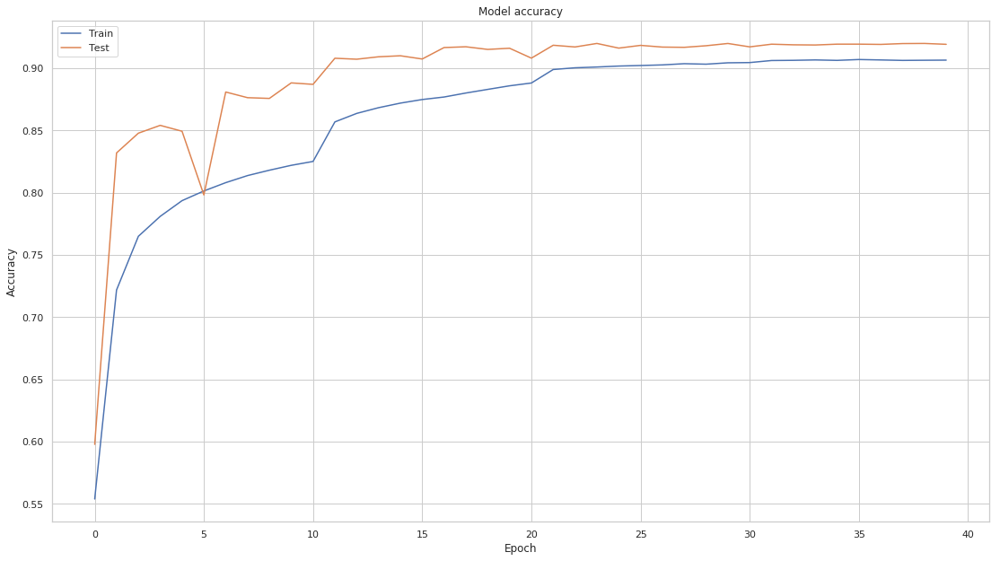

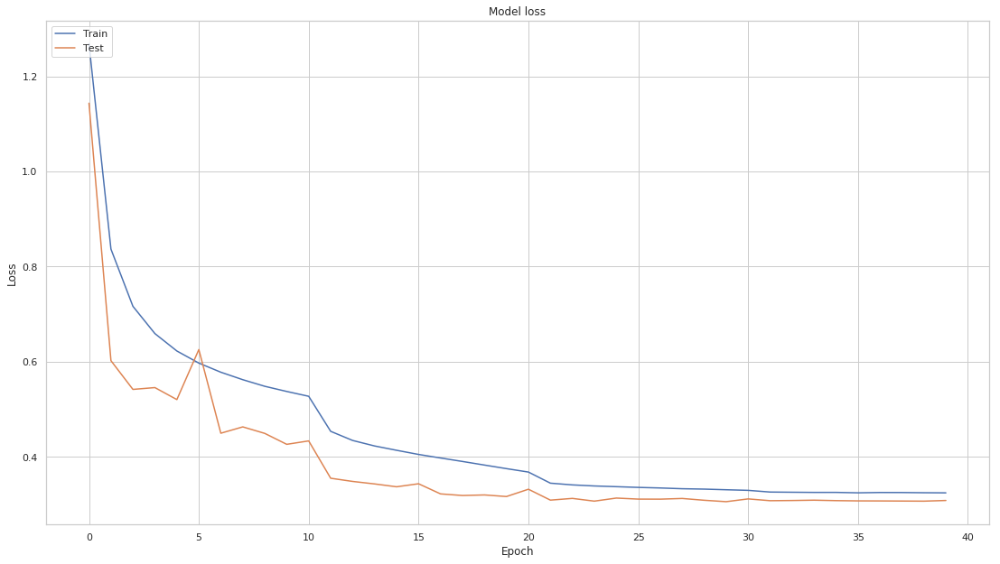

In [40]:
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.savefig("traintest.svg", format="svg")
plt.show()

In [ ]:
from keras.models import load_model
model = load_model('/data/nanopore/James/Barcodes/saved_models/pAmps-final-actrun2_newdata_nanopore_UResNet20v2_model.023.h5')
#model = load_model('saved_models/run03_nanopore_UResNet20v2_model.045.h5')

In [41]:
# Validate trained model.
scores = model.evaluate(x_validation, y_validation, verbose=1)
print('Validation loss:', scores[0])
print('Validation accuracy:', scores[1])
#print(scores) 0.950775

40000/40000 [==============================] - 54s 1ms/step
Validation loss: 0.30806087840795515
Validation accuracy: 0.92045


In [42]:
# Test trained model.
test_scores = model.evaluate(x_test, y_test, verbose=1)
print('Test loss:', test_scores[0])
print('Test accuracy:', test_scores[1])
#print(test_scores)
#Test loss: 0.2965975133061409
#Test accuracy: 0.951825


40000/40000 [==============================] - 45s 1ms/step
Test loss: 0.3085556981682777
Test accuracy: 0.919325


In [43]:
y_predicted = model.predict(x_validation, verbose=1)


40000/40000 [==============================] - 44s 1ms/step


In [44]:
y_val_pred=np.round(y_predicted,decimals=2)
y_val_act=np.round(y_validation,decimals=2)
print(y_val_pred)
print(y_val_act)
y_val_pred_act=np.concatenate((y_val_pred,y_val_act), axis = 1 )

[[0.   0.01 0.   0.99]
 [0.09 0.91 0.   0.  ]
 [0.08 0.91 0.   0.  ]
 ...
 [0.24 0.   0.   0.76]
 [0.03 0.97 0.   0.  ]
 [0.   1.   0.   0.  ]]
[[0. 0. 0. 1.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 ...
 [1. 0. 0. 0.]
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]]


In [96]:
def  spectifity(true_negatives,false_positives):
    return(true_negatives/(true_negatives+false_positives))

def sensitivity(true_positives,false_negatives):
    return(true_positives/(true_positives+false_negatives))

def confidence_margin(npa):
    sorted=np.sort(npa)[::-1]    #return sort in reverse, i.e. descending
    return(sorted[0]-sorted[1])
#print(confidence_margin([0.0, 1.0, 0.5, 0.0]))

def result_for(npa):
    half=len(npa)//2
    return(np.argmax(npa[0:half])==np.argmax(npa[half:]))

#print(result_for(np.array([0.0, 1.0, 0.5, 0.0, 0.8,0.1, 0.2, 0.1])))

def confidence_corr(npa):
    half=len(npa)//2
    res=result_for(npa)
    cm=confidence_margin(npa[0:half])
    return(res,cm)

def totals_for(combined_results,treshold=0.5 ):
    tt,tf,th,tl,fh,fl=0,0,0,0,0,0
    for y in y_val_pred_act:
        res,cm=confidence_corr(y)
        if res:
            tt=tt+1
            if cm>treshold:
                th=th+1
            else:
                tl=tl+1
        else:
            tf=tf+1
            if cm>treshold:
                fh=fh+1
            else:
                fl=fl+1
    return(tt,tf,th,tl,fh,fl)

def vectorise_with_threshold(predictions,threshold):
    vectorised=[]
    for pred in predictions:
        if confidence_margin(pred)>threshold:
            vectorised.append(np.argmax(pred)+1)
        else:
            vectorised.append(0)
    return(np.array(vectorised))

def vectorise_selected_with_threshold(predictions,actuals, threshold):
    vectorised=[]
    vect_act=[]
    for index,pred in enumerate(predictions):
        if confidence_margin(pred)>threshold:
            vectorised.append(np.argmax(pred)+1)
            vect_act.append(np.argmax(actuals[index])+1)
    return(np.array(vectorised),np.array(vect_act))

def vectorise_and_select_with_threshold(labels,predictions,actuals, threshold):
    sel_labels=[]
    vectorised=[]
    vect_act=[]
    for index,pred in enumerate(predictions):
        if confidence_margin(pred)>threshold:
            sel_labels.append(labels[index])
            vectorised.append(np.argmax(pred)+1)
            vect_act.append(np.argmax(actuals[index])+1)
    return(sel_labels,np.array(vectorised),np.array(vect_act))

In [47]:
y_test_predicted = model.predict(x_test, verbose=1)

40000/40000 [==============================] - 42s 1ms/step


In [48]:
y_predicted = model.predict(x_validation, verbose=1)

40000/40000 [==============================] - 42s 1ms/step


In [49]:
def keys_numbers_to_strings(dict):
    dict={}
    for key, name in dict.iteritems():
        strdict[str(key)] = dict[key]

In [146]:
def export_errors(file_name,labels, predictions, actuals):
    with open(file_name, "w") as file:
        for index,pred in enumerate(predictions):
            if actuals[index]!=pred:
                file.write(labels[index]+','+ str(pred)+ ','+str(actuals[index])+'\n')
                
def export_matrix(file_name,labels, matrix):
    with open(file_name, "w") as file:
        for index,mat_row in enumerate(matrix):
            file.write(labels[index])
            for elem in mat_row:
                file.write(','+ str(elem))
            file.write('\n')
                
# export predictions and actuals


In [148]:
export_matrix('test_predictions.csv',LX_test, y_test_predicted)
export_matrix('test_actuals.csv',LX_test, y_test)
export_matrix('val_predictions.csv',LX_validation, y_predicted)
export_matrix('val_actuals.csv',LX_test, y_validation)

In [98]:
def totals_for(cm_table):
    correct,incorrect=0,0
    for i in range(1,5):
        for j in range(1,5):
            if i==j:
                correct=correct+cm_table[i][j]
            else:
                incorrect=incorrect+cm_table[i][j]
    total=correct+incorrect
    return([total,correct,incorrect])

def cm_heatmap_for(cm_table, threshold):
    df_cm = pd.DataFrame(cm_table, index =[1,2,3,4],columns = [1,2,3,4])
    plt.figure(figsize = (4,3))
    ax = plt.axes()
    ax.set_title("Confidence="+str(threshold))
    sn.heatmap(df_cm, annot=True,fmt='g', ax = ax)#,annot_kws=annot_kws)# ,mask=mask)
    plt.savefig('confusion_matrix_'+str(threshold)+'.svg', format="svg")
    plt.show()
    
def cm_for_threshold(labels,predicted,actual,threshold=0.5,dump_errors=False):
    result={}
#    pv=vectorise_with_threshold(predicted,threshold)
#    av=vectorise_with_threshold(actual,threshold) 
    sel_labels,pv,av=vectorise_and_select_with_threshold(labels,predicted,actual, threshold)
    result['total']=len(predicted)
    result['recovered']=len(pv)
    result['discarded']=len(predicted)-result['recovered']  
    cm = ConfusionMatrix(actual_vector=av, predict_vector=pv)
    result['cm']=cm
    total,correct,incorrect=totals_for(cm.table)
    result['correct']=correct
    result['incorrect']=incorrect
    if dump_errors: 
        export_errors('classification_errors_'+str(threshold),labels, pv, av)
    return(result)
#        for index,pred in enumerate(pv):
#            if av[index]!=pred:
#                print(labels[index],',', pred, ',',av[index])

Total= 40000  Classified= 40000 Discarded= 0 recovered percent= 100.0 discarded percent= 0.0
Correct= 36773 Incorrect= 3227 Correct %= 91.93249999999999 Incorrect %= 8.067499999999999


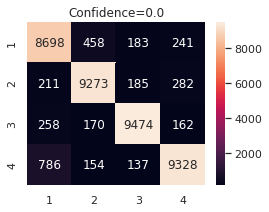

Predict          1       2       3       4       
Actual
1                8698    211     258     786     

2                458     9273    170     154     

3                183     185     9474    137     

4                241     282     162     9328    





Overall Statistics : 

95% CI                                                           (0.91666,0.92199)
AUNP                                                             0.94622
AUNU                                                             0.94619
Bennett S                                                        0.89243
CBA                                                              0.9085
Chi-Squared                                                      95761.97456
Chi-Squared DF                                                   9
Conditional Entropy                                              0.51248
Cramer V                                                         0.89332
Cross Entropy                                   

Total= 40000  Classified= 39405 Discarded= 595 recovered percent= 98.5125 discarded percent= 1.4874999999999998
Correct= 36512 Incorrect= 2893 Correct %= 92.65829209491181 Incorrect %= 7.341707905088186


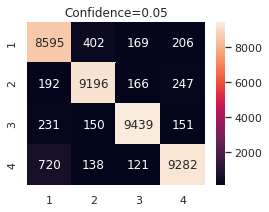

Predict          1       2       3       4       
Actual
1                8595    192     231     720     

2                402     9196    150     138     

3                169     166     9439    121     

4                206     247     151     9282    





Overall Statistics : 

95% CI                                                           (0.92401,0.92916)
AUNP                                                             0.95106
AUNU                                                             0.95097
Bennett S                                                        0.90211
CBA                                                              0.91602
Chi-Squared                                                      96341.92224
Chi-Squared DF                                                   9
Conditional Entropy                                              0.47621
Cramer V                                                         0.90276
Cross Entropy                                  

Total= 40000  Classified= 38846 Discarded= 1154 recovered percent= 97.115 discarded percent= 2.8850000000000002
Correct= 36238 Incorrect= 2608 Correct %= 93.28631004479226 Incorrect %= 6.713689955207744


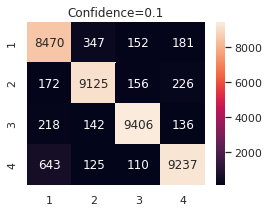

Predict          1       2       3       4       
Actual
1                8470    172     218     643     

2                347     9125    142     125     

3                152     156     9406    110     

4                181     226     136     9237    





Overall Statistics : 

95% CI                                                           (0.93037,0.93535)
AUNP                                                             0.95525
AUNU                                                             0.95508
Bennett S                                                        0.91048
CBA                                                              0.92284
Chi-Squared                                                      96685.77687
Chi-Squared DF                                                   9
Conditional Entropy                                              0.44497
Cramer V                                                         0.91085
Cross Entropy                                  

Total= 40000  Classified= 38251 Discarded= 1749 recovered percent= 95.6275 discarded percent= 4.3725
Correct= 35908 Incorrect= 2343 Correct %= 93.87466994326947 Incorrect %= 6.125330056730543


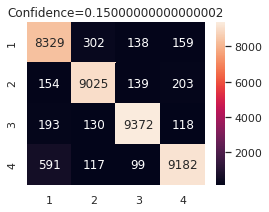

Predict          1       2       3       4       
Actual
1                8329    154     193     591     

2                302     9025    130     117     

3                138     139     9372    99      

4                159     203     118     9182    





Overall Statistics : 

95% CI                                                           (0.93634,0.94115)
AUNP                                                             0.95917
AUNU                                                             0.95894
Bennett S                                                        0.91833
CBA                                                              0.92893
Chi-Squared                                                      96815.27926
Chi-Squared DF                                                   9
Conditional Entropy                                              0.41379
Cramer V                                                         0.91852
Cross Entropy                                  

Total= 40000  Classified= 37723 Discarded= 2277 recovered percent= 94.3075 discarded percent= 5.692500000000001
Correct= 35629 Incorrect= 2094 Correct %= 94.44900988786682 Incorrect %= 5.5509901121331815


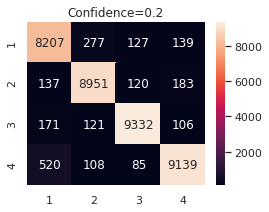

Predict          1       2       3       4       
Actual
1                8207    137     171     520     

2                277     8951    121     108     

3                127     120     9332    85      

4                139     183     106     9139    





Overall Statistics : 

95% CI                                                           (0.94218,0.9468)
AUNP                                                             0.963
AUNU                                                             0.96272
Bennett S                                                        0.92599
CBA                                                              0.93539
Chi-Squared                                                      97037.25966
Chi-Squared DF                                                   9
Conditional Entropy                                              0.38319
Cramer V                                                         0.92599
Cross Entropy                                     

Total= 40000  Classified= 37176 Discarded= 2824 recovered percent= 92.94 discarded percent= 7.06
Correct= 35306 Incorrect= 1870 Correct %= 94.96987303636755 Incorrect %= 5.030126963632451


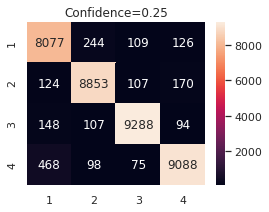

Predict          1       2       3       4       
Actual
1                8077    124     148     468     

2                244     8853    107     98      

3                109     107     9288    75      

4                126     170     94      9088    





Overall Statistics : 

95% CI                                                           (0.94748,0.95192)
AUNP                                                             0.96647
AUNU                                                             0.96615
Bennett S                                                        0.93293
CBA                                                              0.94143
Chi-Squared                                                      97044.14855
Chi-Squared DF                                                   9
Conditional Entropy                                              0.35425
Cramer V                                                         0.93281
Cross Entropy                                  

Total= 40000  Classified= 36623 Discarded= 3377 recovered percent= 91.5575 discarded percent= 8.4425
Correct= 34962 Incorrect= 1661 Correct %= 95.46459874941976 Incorrect %= 4.535401250580237


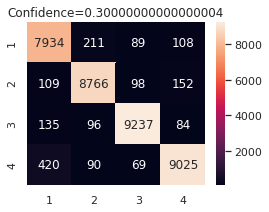

Predict          1       2       3       4       
Actual
1                7934    109     135     420     

2                211     8766    96      90      

3                89      98      9237    69      

4                108     152     84      9025    





Overall Statistics : 

95% CI                                                           (0.95251,0.95678)
AUNP                                                             0.96976
AUNU                                                             0.96941
Bennett S                                                        0.93953
CBA                                                              0.94655
Chi-Squared                                                      96936.73193
Chi-Squared DF                                                   9
Conditional Entropy                                              0.32611
Cramer V                                                         0.9393
Cross Entropy                                   

Total= 40000  Classified= 36055 Discarded= 3945 recovered percent= 90.1375 discarded percent= 9.8625
Correct= 34568 Incorrect= 1487 Correct %= 95.87574538898905 Incorrect %= 4.124254611010955


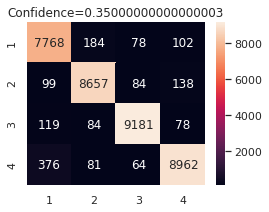

Predict          1       2       3       4       
Actual
1                7768    99      119     376     

2                184     8657    84      81      

3                78      84      9181    64      

4                102     138     78      8962    





Overall Statistics : 

95% CI                                                           (0.9567,0.96081)
AUNP                                                             0.97249
AUNU                                                             0.97211
Bennett S                                                        0.94501
CBA                                                              0.95139
Chi-Squared                                                      96529.59063
Chi-Squared DF                                                   9
Conditional Entropy                                              0.30231
Cramer V                                                         0.94468
Cross Entropy                                   

Total= 40000  Classified= 35447 Discarded= 4553 recovered percent= 88.6175 discarded percent= 11.3825
Correct= 34131 Incorrect= 1316 Correct %= 96.2874150139645 Incorrect %= 3.7125849860354894


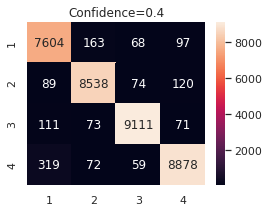

Predict          1       2       3       4       
Actual
1                7604    89      111     319     

2                163     8538    73      72      

3                68      74      9111    59      

4                97      120     71      8878    





Overall Statistics : 

95% CI                                                           (0.96091,0.96484)
AUNP                                                             0.97524
AUNU                                                             0.97485
Bennett S                                                        0.9505
CBA                                                              0.95646
Chi-Squared                                                      95986.97614
Chi-Squared DF                                                   9
Conditional Entropy                                              0.27851
Cramer V                                                         0.95007
Cross Entropy                                   

Total= 40000  Classified= 34876 Discarded= 5124 recovered percent= 87.19 discarded percent= 12.809999999999999
Correct= 33702 Incorrect= 1174 Correct %= 96.6337882784723 Incorrect %= 3.3662117215276983


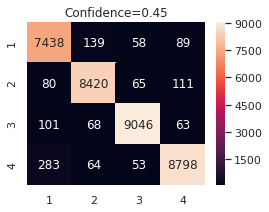

Predict          1       2       3       4       
Actual
1                7438    80      101     283     

2                139     8420    68      64      

3                58      65      9046    53      

4                89      111     63      8798    





Overall Statistics : 

95% CI                                                           (0.96444,0.96823)
AUNP                                                             0.97754
AUNU                                                             0.97713
Bennett S                                                        0.95512
CBA                                                              0.9604
Chi-Squared                                                      95350.15777
Chi-Squared DF                                                   9
Conditional Entropy                                              0.25738
Cramer V                                                         0.95463
Cross Entropy                                   

Total= 40000  Classified= 34254 Discarded= 5746 recovered percent= 85.63499999999999 discarded percent= 14.365
Correct= 33219 Incorrect= 1035 Correct %= 96.97845507094061 Incorrect %= 3.02154492905938


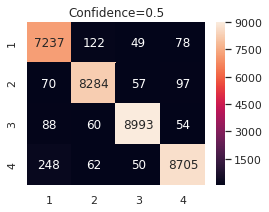

Predict          1       2       3       4       
Actual
1                7237    70      88      248     

2                122     8284    60      62      

3                49      57      8993    50      

4                78      97      54      8705    





Overall Statistics : 

95% CI                                                           (0.96797,0.9716)
AUNP                                                             0.97984
AUNU                                                             0.97941
Bennett S                                                        0.95971
CBA                                                              0.96415
Chi-Squared                                                      94540.5076
Chi-Squared DF                                                   9
Conditional Entropy                                              0.23582
Cramer V                                                         0.95916
Cross Entropy                                    

Total= 40000  Classified= 33547 Discarded= 6453 recovered percent= 83.86749999999999 discarded percent= 16.1325
Correct= 32637 Incorrect= 910 Correct %= 97.28738784392047 Incorrect %= 2.71261215607953


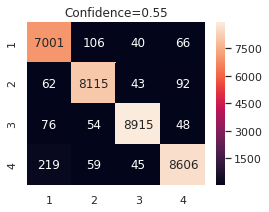

Predict          1       2       3       4       
Actual
1                7001    62      76      219     

2                106     8115    54      59      

3                40      43      8915    45      

4                66      92      48      8606    





Overall Statistics : 

95% CI                                                           (0.97114,0.97461)
AUNP                                                             0.98188
AUNU                                                             0.98143
Bennett S                                                        0.96383
CBA                                                              0.96736
Chi-Squared                                                      93376.05641
Chi-Squared DF                                                   9
Conditional Entropy                                              0.21561
Cramer V                                                         0.96323
Cross Entropy                                  

Total= 40000  Classified= 32767 Discarded= 7233 recovered percent= 81.9175 discarded percent= 18.082500000000003
Correct= 31993 Incorrect= 774 Correct %= 97.63786736655781 Incorrect %= 2.362132633442183


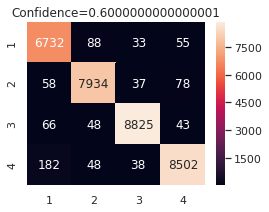

Predict          1       2       3       4       
Actual
1                6732    58      66      182     

2                88      7934    48      48      

3                33      37      8825    38      

4                55      78      43      8502    





Overall Statistics : 

95% CI                                                           (0.97473,0.97802)
AUNP                                                             0.98421
AUNU                                                             0.98374
Bennett S                                                        0.9685
CBA                                                              0.97145
Chi-Squared                                                      92079.66656
Chi-Squared DF                                                   9
Conditional Entropy                                              0.19261
Cramer V                                                         0.96784
Cross Entropy                                   

Total= 40000  Classified= 31968 Discarded= 8032 recovered percent= 79.92 discarded percent= 20.080000000000002
Correct= 31299 Incorrect= 669 Correct %= 97.90728228228228 Incorrect %= 2.0927177177177176


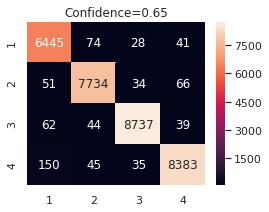

Predict          1       2       3       4       
Actual
1                6445    51      62      150     

2                74      7734    44      45      

3                28      34      8737    35      

4                41      66      39      8383    





Overall Statistics : 

95% CI                                                           (0.9775,0.98064)
AUNP                                                             0.98599
AUNU                                                             0.9855
Bennett S                                                        0.9721
CBA                                                              0.97428
Chi-Squared                                                      90497.50611
Chi-Squared DF                                                   9
Conditional Entropy                                              0.17464
Cramer V                                                         0.9714
Cross Entropy                                      

Total= 40000  Classified= 31026 Discarded= 8974 recovered percent= 77.565 discarded percent= 22.435
Correct= 30479 Incorrect= 547 Correct %= 98.23696254754077 Incorrect %= 1.7630374524592276


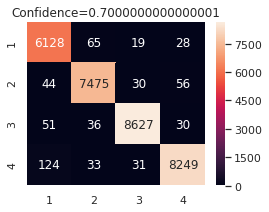

Predict          1       2       3       4       
Actual
1                6128    44      51      124     

2                65      7475    36      33      

3                19      30      8627    31      

4                28      56      30      8249    





Overall Statistics : 

95% CI                                                           (0.98091,0.98383)
AUNP                                                             0.98819
AUNU                                                             0.98768
Bennett S                                                        0.97649
CBA                                                              0.97806
Chi-Squared                                                      88620.05075
Chi-Squared DF                                                   9
Conditional Entropy                                              0.15092
Cramer V                                                         0.97576
Cross Entropy                                  

Total= 40000  Classified= 29926 Discarded= 10074 recovered percent= 74.815 discarded percent= 25.185000000000002
Correct= 29476 Incorrect= 450 Correct %= 98.49629085076522 Incorrect %= 1.5037091492347792


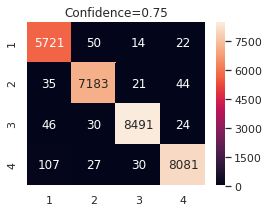

Predict          1       2       3       4       
Actual
1                5721    35      46      107     

2                50      7183    30      27      

3                14      21      8491    30      

4                22      44      24      8081    





Overall Statistics : 

95% CI                                                           (0.98358,0.98634)
AUNP                                                             0.98989
AUNU                                                             0.98933
Bennett S                                                        0.97995
CBA                                                              0.98049
Chi-Squared                                                      86075.23562
Chi-Squared DF                                                   9
Conditional Entropy                                              0.13152
Cramer V                                                         0.97916
Cross Entropy                                  

Total= 40000  Classified= 28566 Discarded= 11434 recovered percent= 71.41499999999999 discarded percent= 28.585
Correct= 28220 Incorrect= 346 Correct %= 98.78876986627459 Incorrect %= 1.2112301337254077


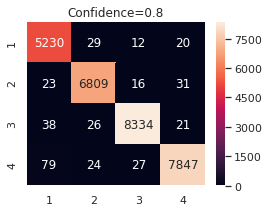

Predict          1       2       3       4       
Actual
1                5230    23      38      79      

2                29      6809    26      24      

3                12      16      8334    27      

4                20      31      21      7847    





Overall Statistics : 

95% CI                                                           (0.98662,0.98916)
AUNP                                                             0.99182
AUNU                                                             0.99131
Bennett S                                                        0.98385
CBA                                                              0.98402
Chi-Squared                                                      82830.97258
Chi-Squared DF                                                   9
Conditional Entropy                                              0.11007
Cramer V                                                         0.98313
Cross Entropy                                  

Total= 40000  Classified= 26871 Discarded= 13129 recovered percent= 67.1775 discarded percent= 32.8225
Correct= 26602 Incorrect= 269 Correct %= 98.99892076960292 Incorrect %= 1.0010792303970824


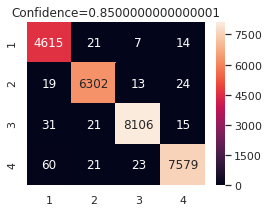

Predict          1       2       3       4       
Actual
1                4615    19      31      60      

2                21      6302    21      21      

3                7       13      8106    23      

4                14      24      15      7579    





Overall Statistics : 

95% CI                                                           (0.9888,0.99118)
AUNP                                                             0.99319
AUNU                                                             0.99262
Bennett S                                                        0.98665
CBA                                                              0.98627
Chi-Squared                                                      78347.15075
Chi-Squared DF                                                   9
Conditional Entropy                                              0.0933
Cramer V                                                         0.98585
Cross Entropy                                    

Total= 40000  Classified= 24515 Discarded= 15485 recovered percent= 61.287499999999994 discarded percent= 38.7125
Correct= 24318 Incorrect= 197 Correct %= 99.19641036100346 Incorrect %= 0.8035896389965328


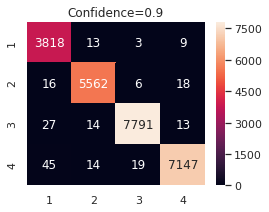

Predict          1       2       3       4       
Actual
1                3818    16      27      45      

2                13      5562    14      14      

3                3       6       7791    19      

4                9       18      13      7147    





Overall Statistics : 

95% CI                                                           (0.99085,0.99308)
AUNP                                                             0.99447
AUNU                                                             0.99374
Bennett S                                                        0.98929
CBA                                                              0.98812
Chi-Squared                                                      71831.67116
Chi-Squared DF                                                   9
Conditional Entropy                                              0.0763
Cramer V                                                         0.98828
Cross Entropy                                   

Total= 40000  Classified= 20541 Discarded= 19459 recovered percent= 51.3525 discarded percent= 48.6475
Correct= 20426 Incorrect= 115 Correct %= 99.44014410203982 Incorrect %= 0.5598558979601772


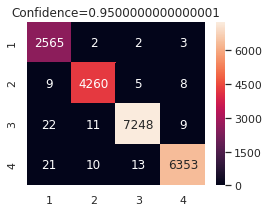

Predict          1       2       3       4       
Actual
1                2565    9       22      21      

2                2       4260    11      10      

3                2       5       7248    13      

4                3       8       9       6353    





Overall Statistics : 

95% CI                                                           (0.99338,0.99542)
AUNP                                                             0.99599
AUNU                                                             0.99511
Bennett S                                                        0.99254
CBA                                                              0.99053
Chi-Squared                                                      60566.4964
Chi-Squared DF                                                   9
Conditional Entropy                                              0.05506
Cramer V                                                         0.99139
Cross Entropy                                   

In [138]:
stats={}
for threshold in np.arange(0,1,0.05):
    result=cm_for_threshold(LX_test,y_test_predicted,y_test,threshold=threshold,dump_errors=True)
    print("Total=",result['total']," Classified=", result['recovered'], 
          "Discarded=",result['discarded'], "recovered percent=",result['recovered']/result['total'] *100, "discarded percent=",(result['total']-result['recovered'])/result['total']*100)
    print('Correct=',result['correct'],'Incorrect=',result['incorrect'], 
          'Correct %=',result['correct']/result['recovered'] * 100,'Incorrect %=',result['incorrect']/result['recovered'] * 100) 
    cm=result['cm']
    cm_heatmap_for(cm.table, threshold)
    print(cm)
    stats[str(threshold)]=result

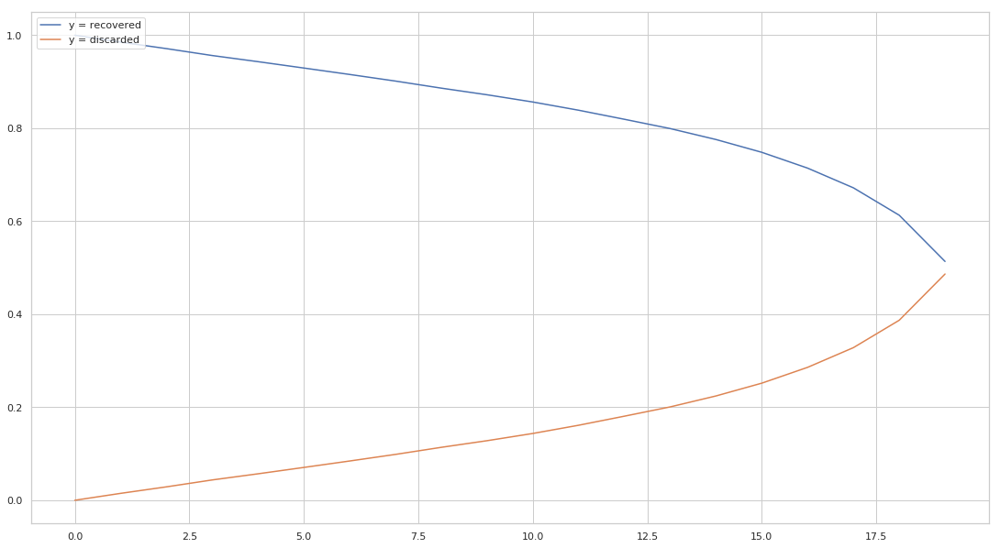

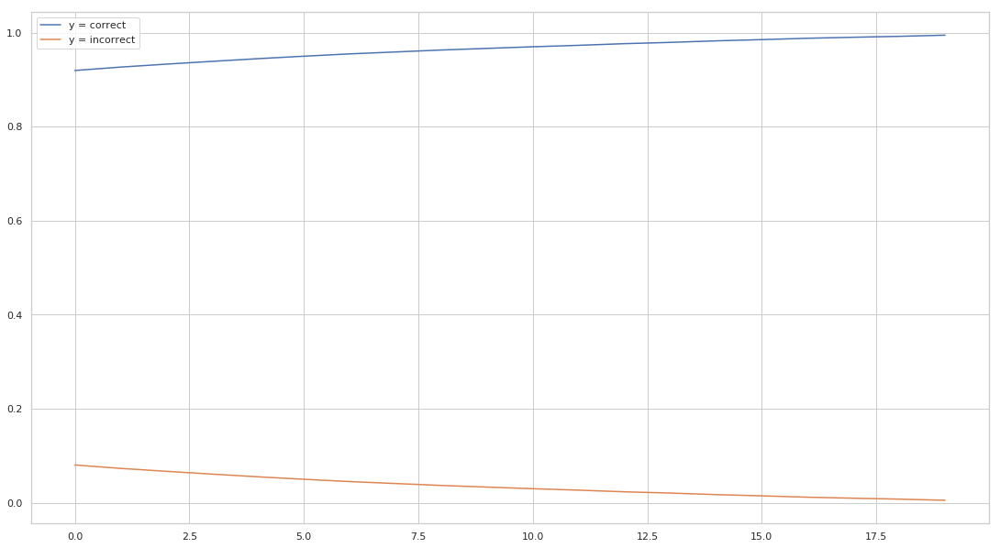

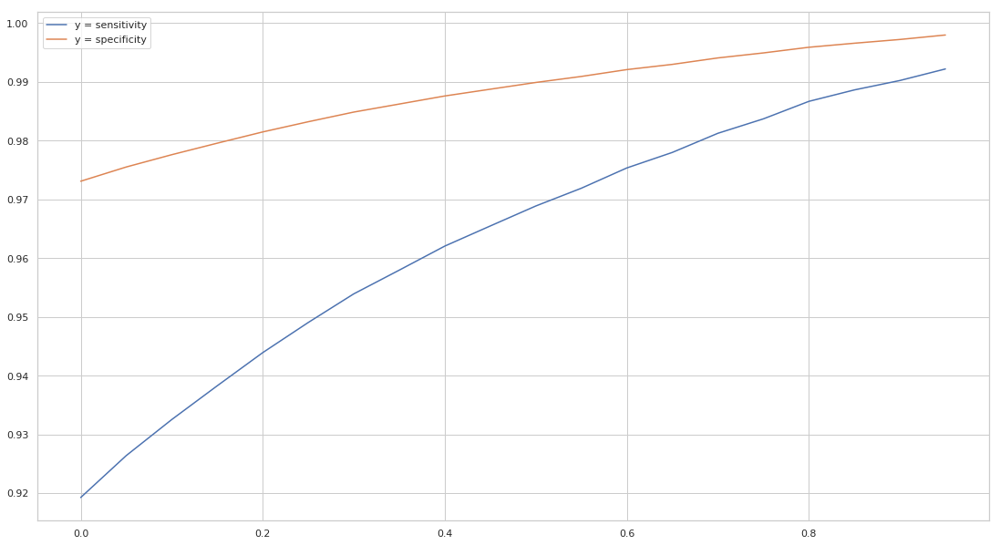

[0.0, 0.05, 0.1, 0.15000000000000002, 0.2, 0.25, 0.30000000000000004, 0.35000000000000003, 0.4, 0.45, 0.5, 0.55, 0.6000000000000001, 0.65, 0.7000000000000001, 0.75, 0.8, 0.8500000000000001, 0.9, 0.9500000000000001] [1.0, 0.985125, 0.97115, 0.956275, 0.943075, 0.9294, 0.915575, 0.901375, 0.886175, 0.8719, 0.85635, 0.838675, 0.819175, 0.7992, 0.77565, 0.74815, 0.71415, 0.671775, 0.612875, 0.513525] [0.0, 0.014875, 0.02885, 0.043725, 0.056925, 0.0706, 0.084425, 0.098625, 0.113825, 0.1281, 0.14365, 0.161325, 0.180825, 0.2008, 0.22435, 0.25185, 0.28585, 0.328225, 0.387125, 0.486475] [0.919325, 0.9265829209491181, 0.9328631004479225, 0.9387466994326946, 0.9444900988786682, 0.9496987303636755, 0.9546459874941976, 0.9587574538898904, 0.9628741501396451, 0.966337882784723, 0.9697845507094062, 0.9728738784392047, 0.9763786736655782, 0.9790728228228228, 0.9823696254754077, 0.9849629085076522, 0.987887698662746, 0.9899892076960292, 0.9919641036100346, 0.9944014410203982] [0.080675, 0.0734170790508

In [142]:
def calc_avg(dict):
    vals=np.array(list(dict.values()))
    return(np.mean(vals))

def calculate_stats(result):
    confidence=[]
    recovered=[]
    discarded=[]
    correct=[]
    incorrect=[]
    accuracy=[]    
    sensitivity=[]
    specificity=[]
    roc=[]
    for conf,scores in result.items():
        confidence.append(float(conf))
        recovered.append(scores['recovered']/scores['total'])
        discarded.append(scores['discarded']/scores['total'])
        correct.append(scores['correct']/scores['recovered'])
        incorrect.append(scores['incorrect']/scores['recovered'])
        accuracy.append(scores['cm'].Overall_ACC)
        sensitivity.append(calc_avg(scores['cm'].TPR))
        specificity.append(calc_avg(scores['cm'].TNR))
        roc.append(calc_avg(scores['cm'].AUC))    
    return(confidence,recovered,discarded,correct,incorrect,accuracy,sensitivity,specificity,roc)
        
    plt.gca().set_color_cycle(['red', 'green', 'blue', 'yellow'])

def graph_summary_for(result):
    confidence,recovered,discarded,correct,incorrect,accuracy,sensitivity,specificity,roc=calculate_stats(result)
    plt.plot(recovered)
    plt.plot(discarded)
    plt.legend(['y = recovered', 'y = discarded'], loc='upper left')
    plt.show()
    
    plt.plot(correct)
    plt.plot(incorrect)
    plt.legend(['y = correct', 'y = incorrect'], loc='upper left')
    plt.show()
    
    plt.plot(confidence,sensitivity)
    plt.plot(confidence,specificity)
    plt.legend(['y = sensitivity', 'y = specificity'], loc='upper left')
    plt.show()
    print(confidence,recovered,discarded,correct,incorrect,accuracy)
    for index,cf in enumerate(confidence):
        print(cf,recovered[index],discarded[index],correct[index],incorrect[index])

graph_summary_for(stats)

[2584, 2304, 280, 0.891640866873065, 0.10835913312693499]
Predict          1      2      3      4      
Actual
1                516    43     20     15     

2                121    271    12     7      

3                4      12     762    13     

4                7      11     15     755    





Overall Statistics : 

95% CI                                                           (0.87966,0.90363)
AUNP                                                             0.9288
AUNU                                                             0.91339
Bennett S                                                        0.85552
CBA                                                              0.83832
Chi-Squared                                                      5459.63637
Chi-Squared DF                                                   9
Conditional Entropy                                              0.53897
Cramer V                                                         0.83922
Cross Entro

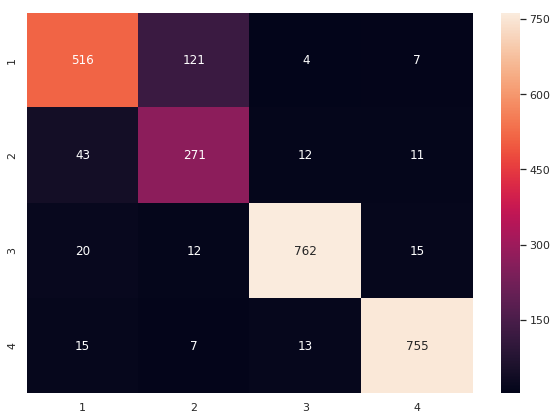

In [42]:
cm = ConfusionMatrix(actual_vector=av, predict_vector=pv)
cm_table=cm.table
print(totals_for(cm_table))
print(cm)
#cm.relabel(mapping={0:"117",1:"63",2:"81",3:"103",4:"999"})
df_cm = pd.DataFrame(cm.table, index =[1,2,3,4],
                  columns = [1,2,3,4])
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True,fmt='g' )

In [ ]:
threshold=0.9
pv,av=vectorise_selected_with_threshold(y_test_predicted,y_test,threshold)
recognised=np.count_nonzero(pv)


In [ ]:
cm = ConfusionMatrix(actual_vector=av, predict_vector=pv)
cm_table=cm.table
print(totals_for(cm_table))
print(cm)
#cm.relabel(mapping={0:"117",1:"63",2:"81",3:"103",4:"999"})
df_cm = pd.DataFrame(cm.table, index =[1,2,3,4],
                  columns = [1,2,3,4])
plt.figure(figsize = (10,7))
sn.heatmap(df_cm, annot=True,fmt='g' )